In [1]:
%load_ext autoreload
%autoreload 2

In [2]:
import optuna

c:\Users\Max\anaconda3\envs\sdypy_dev\Lib\site-packages\tqdm\auto.py:21: TqdmWarning: IProgress not found. Please update jupyter and ipywidgets. See https://ipywidgets.readthedocs.io/en/stable/user_install.html
  from .autonotebook import tqdm as notebook_tqdm


In [3]:
import numpy as np
from scipy.signal import gausspulse
import matplotlib.pyplot as plt

from filter_tc.sensitivity_analysis.data_generation import *

In [4]:
loading = 'compression'

event_to_trend_amplitudes = np.arange(0.1, 0.7, 0.1)
event_length_to_trend_periods = np.arange(0.1, 0.7, 0.1)
time_shifts = np.arange(0.005, 0.025, 0.005)

amplitude_shift = 0.5

datasets = {}

for event_to_trend_amplitude in event_to_trend_amplitudes:
    for event_length_to_trend_period in event_length_to_trend_periods:
        for time_shift in time_shifts:
            trend, events, noise_amplitude, no_samples = \
                create_inputs(
                    event_to_trend_amplitude,
                    event_length_to_trend_period,
                    noise_to_trend = 1/50,
                    no_samples = 1000,
                    trend_freq = 4.0,
                    trend_amplitude = 200
                )
            t, y_measurements, input_, y_lf, y_events, y_noise = \
                generate_test_data(
                    trend,
                    events,
                    no_samples,
                    noise_amplitude,
                    loading,
                    amplitude_shift,
                    time_shift
                )
            datasets[(event_to_trend_amplitude, event_length_to_trend_period, time_shift)] = {
                't':t,
                'y_measurements':y_measurements,
                'input_':input_,
                'y_lf':y_lf,
                'y_events':y_events,
                'y_noise':y_noise
            }

In [5]:
import optuna
from filter_tc.particle_filter import ParticleFilter
from filter_tc.utils import learn_alpha
from sklearn.metrics import mean_squared_error, r2_score



def evaluate_pf(pf, inputs, measurement, y_lf):
    predictions = pf.filter(measurement, inputs, loading=loading)
    return r2_score(predictions, y_lf)

def objective(trial, measurement, inputs, y_lf):
    pf_alpha = learn_alpha(inputs[0].reshape(-1, 1), measurement)
    # Suggest values for the hyperparameters
    num_particles = 1000 #trial.suggest_int('num_particles', 100, 2000)
    r_measurement_noise = trial.suggest_float('r_measurement_noise', 1e-1, 1e2, log=True)
    q_process_noise_0 = trial.suggest_float('q_process_noise_0',1e-1, 1e2, log=True)
    loc = trial.suggest_float('loc', 1e-1, 1e2, log=True)

    # Create an instance of the Particle Filter with these parameters
    
    pf = ParticleFilter(
        num_particles=num_particles,
        r_measurement_noise=r_measurement_noise,
        q_process_noise=np.array([q_process_noise_0, 1]),
        loc=-loc,
        alpha=pf_alpha
    )
    

    # Evaluate your Particle Filter
    try:
        metric = evaluate_pf(pf, inputs, measurement, y_lf)  # You'll need to define this function
    except:
        print('failed metric for parameters: ', 'num_particles:', num_particles, 'r_measurement_noise:', r_measurement_noise, 'q_process_noise_0:', q_process_noise_0, 'loc:', loc)
        metric = np.inf
    return metric

In [6]:
from functools import partial

studies = {}
best_params = {}
for key_ in list(datasets.keys()):
    inputs = np.vstack([datasets[key_]['input_'], np.insert(np.diff(datasets[key_]['input_']),0,0)])
    measurement = datasets[key_]['y_measurements']
    y_lf = datasets[key_]['y_lf']
    objective_partial = partial(objective, measurement=measurement, inputs=inputs, y_lf=y_lf)
    study = optuna.create_study(direction='maximize')
    study.optimize(objective_partial, n_trials=100)  # Adjust n_trials to your preference
    best_params[key_] = study.best_params
    studies[key_] = study
    print("Best parameters for event_to_trend_amplitude:",key_[0],
          ' and event_length_to_trend_period:',key_[1],
          ': ', best_params[key_])

[I 2024-03-12 21:55:10,497] A new study created in memory with name: no-name-bddb30bc-f3fe-4175-b759-ffa8a6307754
[I 2024-03-12 21:55:11,109] Trial 0 finished with value: 0.9939074076624087 and parameters: {'r_measurement_noise': 5.061767072621033, 'q_process_noise_0': 15.77075588330311, 'loc': 2.510998659595207}. Best is trial 0 with value: 0.9939074076624087.
[I 2024-03-12 21:55:11,603] Trial 1 finished with value: 0.3252073727523779 and parameters: {'r_measurement_noise': 0.7803991029177816, 'q_process_noise_0': 0.13811927715206818, 'loc': 78.65858665280423}. Best is trial 0 with value: 0.9939074076624087.
[I 2024-03-12 21:55:12,078] Trial 2 finished with value: 0.967609812798534 and parameters: {'r_measurement_noise': 18.040263642453944, 'q_process_noise_0': 0.5524956191001885, 'loc': 0.8614384745359726}. Best is trial 0 with value: 0.9939074076624087.
[I 2024-03-12 21:55:12,524] Trial 3 finished with value: 0.9933868322054138 and parameters: {'r_measurement_noise': 3.4180885334988

Best parameters for event_to_trend_amplitude: 0.1  and event_length_to_trend_period: 0.1 :  {'r_measurement_noise': 0.2899651205290279, 'q_process_noise_0': 0.6350395459994023, 'loc': 1.8083847903295251}


[I 2024-03-12 21:55:56,892] Trial 0 finished with value: 0.995089199818342 and parameters: {'r_measurement_noise': 0.3036096413153619, 'q_process_noise_0': 90.87099996367688, 'loc': 0.2552018635167911}. Best is trial 0 with value: 0.995089199818342.
[I 2024-03-12 21:55:57,386] Trial 1 finished with value: 0.8458730662884215 and parameters: {'r_measurement_noise': 24.311511362616308, 'q_process_noise_0': 0.2599774445177981, 'loc': 0.2902902854101655}. Best is trial 0 with value: 0.995089199818342.
[I 2024-03-12 21:55:57,838] Trial 2 finished with value: 0.8762478332634331 and parameters: {'r_measurement_noise': 6.399697368573469, 'q_process_noise_0': 3.4619114785612055, 'loc': 30.597436975564904}. Best is trial 0 with value: 0.995089199818342.
[I 2024-03-12 21:55:58,286] Trial 3 finished with value: -0.5045595640670475 and parameters: {'r_measurement_noise': 0.8143237477137365, 'q_process_noise_0': 5.616159019846603, 'loc': 88.92473483262361}. Best is trial 0 with value: 0.9950891998183

Best parameters for event_to_trend_amplitude: 0.1  and event_length_to_trend_period: 0.1 :  {'r_measurement_noise': 0.5404730331121539, 'q_process_noise_0': 0.9838272497466721, 'loc': 1.8412141891388467}


[I 2024-03-12 21:56:43,304] Trial 0 finished with value: -0.3369985861989151 and parameters: {'r_measurement_noise': 0.13490532843511988, 'q_process_noise_0': 0.2670714482983778, 'loc': 52.8465697066238}. Best is trial 0 with value: -0.3369985861989151.
[I 2024-03-12 21:56:43,790] Trial 1 finished with value: 0.754305198017279 and parameters: {'r_measurement_noise': 35.8141219119874, 'q_process_noise_0': 65.85747862410132, 'loc': 66.1023798735007}. Best is trial 1 with value: 0.754305198017279.
[I 2024-03-12 21:56:44,245] Trial 2 finished with value: 0.8818414073268023 and parameters: {'r_measurement_noise': 2.685454705559177, 'q_process_noise_0': 2.018411625595203, 'loc': 27.668460491915145}. Best is trial 2 with value: 0.8818414073268023.
[I 2024-03-12 21:56:44,598] Trial 3 finished with value: 0.6001295067559954 and parameters: {'r_measurement_noise': 0.3248344797460937, 'q_process_noise_0': 0.43467380038761105, 'loc': 0.6432392970291826}. Best is trial 2 with value: 0.8818414073268

Best parameters for event_to_trend_amplitude: 0.1  and event_length_to_trend_period: 0.1 :  {'r_measurement_noise': 1.2228323334848075, 'q_process_noise_0': 1.1786531734533312, 'loc': 2.0076036451076207}


[I 2024-03-12 21:57:30,000] Trial 0 finished with value: 0.6933005845848099 and parameters: {'r_measurement_noise': 1.0678603360845609, 'q_process_noise_0': 0.7827187124831297, 'loc': 3.365634867530968}. Best is trial 0 with value: 0.6933005845848099.
[I 2024-03-12 21:57:30,391] Trial 1 finished with value: -1.0533805889664638 and parameters: {'r_measurement_noise': 0.3207640852615106, 'q_process_noise_0': 0.44686380186119995, 'loc': 53.840869355590506}. Best is trial 0 with value: 0.6933005845848099.
[I 2024-03-12 21:57:30,859] Trial 2 finished with value: 0.9217527701155107 and parameters: {'r_measurement_noise': 18.570141330285093, 'q_process_noise_0': 21.272933399271125, 'loc': 34.8042791861628}. Best is trial 2 with value: 0.9217527701155107.
[I 2024-03-12 21:57:31,461] Trial 3 finished with value: 0.9950830161359386 and parameters: {'r_measurement_noise': 4.102770657159438, 'q_process_noise_0': 85.96675964876441, 'loc': 4.7107620579813405}. Best is trial 3 with value: 0.995083016

Best parameters for event_to_trend_amplitude: 0.1  and event_length_to_trend_period: 0.1 :  {'r_measurement_noise': 78.14145858357746, 'q_process_noise_0': 5.6110255174171355, 'loc': 41.22495680752746}


[I 2024-03-12 21:58:21,085] Trial 0 finished with value: 0.42294039522523164 and parameters: {'r_measurement_noise': 1.626742351175956, 'q_process_noise_0': 0.21477558774670155, 'loc': 61.18595138850754}. Best is trial 0 with value: 0.42294039522523164.
[I 2024-03-12 21:58:21,684] Trial 1 finished with value: 0.8845176171634827 and parameters: {'r_measurement_noise': 3.534473741922275, 'q_process_noise_0': 0.2948838392706914, 'loc': 29.293468763584663}. Best is trial 1 with value: 0.8845176171634827.
[I 2024-03-12 21:58:22,148] Trial 2 finished with value: 0.9694296942880738 and parameters: {'r_measurement_noise': 0.6664211177852503, 'q_process_noise_0': 0.1998794044456019, 'loc': 0.8875830653337315}. Best is trial 2 with value: 0.9694296942880738.
[I 2024-03-12 21:58:22,697] Trial 3 finished with value: 0.99316804474407 and parameters: {'r_measurement_noise': 1.1772019115408623, 'q_process_noise_0': 2.844188527654785, 'loc': 0.3636205495833136}. Best is trial 3 with value: 0.993168044

Best parameters for event_to_trend_amplitude: 0.1  and event_length_to_trend_period: 0.2 :  {'r_measurement_noise': 0.1512211106105369, 'q_process_noise_0': 0.8703064077201051, 'loc': 0.5025121202596897}


[I 2024-03-12 21:59:13,127] Trial 0 finished with value: 0.9958342243257012 and parameters: {'r_measurement_noise': 0.14660007346337486, 'q_process_noise_0': 1.0093443270387938, 'loc': 1.2770831384238164}. Best is trial 0 with value: 0.9958342243257012.
[I 2024-03-12 21:59:13,670] Trial 1 finished with value: 0.9686079914496025 and parameters: {'r_measurement_noise': 41.7225787628549, 'q_process_noise_0': 12.432866624716553, 'loc': 16.458978115134933}. Best is trial 0 with value: 0.9958342243257012.
[I 2024-03-12 21:59:14,063] Trial 2 finished with value: 0.7611919607992113 and parameters: {'r_measurement_noise': 0.8938402325307427, 'q_process_noise_0': 0.3171640256853527, 'loc': 14.748519405074894}. Best is trial 0 with value: 0.9958342243257012.
[I 2024-03-12 21:59:14,505] Trial 3 finished with value: 0.993013292360762 and parameters: {'r_measurement_noise': 0.5791903551127527, 'q_process_noise_0': 11.838231427254739, 'loc': 0.7024475754807535}. Best is trial 0 with value: 0.99583422

Best parameters for event_to_trend_amplitude: 0.1  and event_length_to_trend_period: 0.2 :  {'r_measurement_noise': 0.17164651447663612, 'q_process_noise_0': 1.0225680925222422, 'loc': 1.0643593629921115}


[I 2024-03-12 21:59:58,479] Trial 0 finished with value: 0.9918086293773607 and parameters: {'r_measurement_noise': 5.512134923050631, 'q_process_noise_0': 2.358782696139495, 'loc': 2.1088610995951758}. Best is trial 0 with value: 0.9918086293773607.
[I 2024-03-12 21:59:58,987] Trial 1 finished with value: 0.9722657000361499 and parameters: {'r_measurement_noise': 0.10486828446371418, 'q_process_noise_0': 2.592247875355113, 'loc': 12.15073627879587}. Best is trial 0 with value: 0.9918086293773607.
[I 2024-03-12 21:59:59,474] Trial 2 finished with value: 0.8931628068734103 and parameters: {'r_measurement_noise': 36.93869057619727, 'q_process_noise_0': 1.1870677143038484, 'loc': 0.6122141777743704}. Best is trial 0 with value: 0.9918086293773607.
[I 2024-03-12 21:59:59,860] Trial 3 finished with value: 0.7822615600830607 and parameters: {'r_measurement_noise': 10.530917969320951, 'q_process_noise_0': 0.26292882405133305, 'loc': 4.526535086536744}. Best is trial 0 with value: 0.9918086293

Best parameters for event_to_trend_amplitude: 0.1  and event_length_to_trend_period: 0.2 :  {'r_measurement_noise': 0.17298986959448168, 'q_process_noise_0': 1.3072374499652668, 'loc': 0.3182189864272279}


[I 2024-03-12 22:00:44,407] Trial 0 finished with value: 0.9933233540547364 and parameters: {'r_measurement_noise': 1.107328572985127, 'q_process_noise_0': 36.16066869921811, 'loc': 0.5442929767462514}. Best is trial 0 with value: 0.9933233540547364.
[I 2024-03-12 22:00:44,893] Trial 1 finished with value: 0.9052321097521164 and parameters: {'r_measurement_noise': 23.993569847016563, 'q_process_noise_0': 0.8494172037048692, 'loc': 0.7110661727518315}. Best is trial 0 with value: 0.9933233540547364.
[I 2024-03-12 22:00:45,411] Trial 2 finished with value: 0.7042382120249866 and parameters: {'r_measurement_noise': 0.6619292653814383, 'q_process_noise_0': 2.774245621058958, 'loc': 40.42337853605458}. Best is trial 0 with value: 0.9933233540547364.
[I 2024-03-12 22:00:45,865] Trial 3 finished with value: 0.9941306371293509 and parameters: {'r_measurement_noise': 0.7192663808917267, 'q_process_noise_0': 1.2677398631929846, 'loc': 0.8409982550042342}. Best is trial 3 with value: 0.9941306371

Best parameters for event_to_trend_amplitude: 0.1  and event_length_to_trend_period: 0.2 :  {'r_measurement_noise': 0.8894890151810974, 'q_process_noise_0': 1.2871905044644596, 'loc': 3.0512543494061015}


[I 2024-03-12 22:01:29,397] Trial 0 finished with value: 0.9863647592265268 and parameters: {'r_measurement_noise': 4.445592436857773, 'q_process_noise_0': 51.83259273794529, 'loc': 0.7900067603877234}. Best is trial 0 with value: 0.9863647592265268.
[I 2024-03-12 22:01:29,888] Trial 1 finished with value: 0.9902691733960833 and parameters: {'r_measurement_noise': 12.25968942553942, 'q_process_noise_0': 0.6559883403959168, 'loc': 6.947194244771378}. Best is trial 1 with value: 0.9902691733960833.
[I 2024-03-12 22:01:30,304] Trial 2 finished with value: 0.9919007519436526 and parameters: {'r_measurement_noise': 0.13076573385147022, 'q_process_noise_0': 26.422088966802832, 'loc': 0.2429880797885902}. Best is trial 2 with value: 0.9919007519436526.
[I 2024-03-12 22:01:30,687] Trial 3 finished with value: 0.9816271793279033 and parameters: {'r_measurement_noise': 2.211725657408199, 'q_process_noise_0': 0.12377671192674956, 'loc': 0.2460365981625067}. Best is trial 2 with value: 0.991900751

Best parameters for event_to_trend_amplitude: 0.1  and event_length_to_trend_period: 0.30000000000000004 :  {'r_measurement_noise': 0.18246028178202678, 'q_process_noise_0': 0.6072211965793414, 'loc': 1.476226604461597}


[I 2024-03-12 22:02:13,783] Trial 0 finished with value: 0.9902272726114068 and parameters: {'r_measurement_noise': 27.554326306443365, 'q_process_noise_0': 1.3418705165956288, 'loc': 13.469423282486106}. Best is trial 0 with value: 0.9902272726114068.
[I 2024-03-12 22:02:14,327] Trial 1 finished with value: 0.9942403529981187 and parameters: {'r_measurement_noise': 0.25225240137794147, 'q_process_noise_0': 1.1391064301063687, 'loc': 0.1554069244297243}. Best is trial 1 with value: 0.9942403529981187.
[I 2024-03-12 22:02:14,803] Trial 2 finished with value: 0.8303409099065345 and parameters: {'r_measurement_noise': 22.896559531163923, 'q_process_noise_0': 0.40259084317842975, 'loc': 44.92916036194742}. Best is trial 1 with value: 0.9942403529981187.
[I 2024-03-12 22:02:15,319] Trial 3 finished with value: 0.9750002323697099 and parameters: {'r_measurement_noise': 11.344976615558949, 'q_process_noise_0': 4.83306955430136, 'loc': 0.32145552375591646}. Best is trial 1 with value: 0.994240

Best parameters for event_to_trend_amplitude: 0.1  and event_length_to_trend_period: 0.30000000000000004 :  {'r_measurement_noise': 0.25225240137794147, 'q_process_noise_0': 1.1391064301063687, 'loc': 0.1554069244297243}


[I 2024-03-12 22:02:59,216] Trial 0 finished with value: 0.8736253346508764 and parameters: {'r_measurement_noise': 51.03594316077379, 'q_process_noise_0': 12.268091397591022, 'loc': 9.04896258035092}. Best is trial 0 with value: 0.8736253346508764.
[I 2024-03-12 22:02:59,685] Trial 1 finished with value: 0.828760541934998 and parameters: {'r_measurement_noise': 2.846908534445945, 'q_process_noise_0': 57.854891504880996, 'loc': 33.44344064781165}. Best is trial 0 with value: 0.8736253346508764.
[I 2024-03-12 22:03:00,168] Trial 2 finished with value: 0.9024843434263373 and parameters: {'r_measurement_noise': 22.35117345107356, 'q_process_noise_0': 45.964878699415955, 'loc': 0.21444003706224912}. Best is trial 2 with value: 0.9024843434263373.
[I 2024-03-12 22:03:00,656] Trial 3 finished with value: 0.9304214545560558 and parameters: {'r_measurement_noise': 0.6864760884365675, 'q_process_noise_0': 84.3445161771477, 'loc': 20.364506612651283}. Best is trial 3 with value: 0.93042145455605

Best parameters for event_to_trend_amplitude: 0.1  and event_length_to_trend_period: 0.30000000000000004 :  {'r_measurement_noise': 6.4965094065456706, 'q_process_noise_0': 1.5292339334089462, 'loc': 7.594859720342298}


[I 2024-03-12 22:03:45,635] Trial 0 finished with value: 0.04178086054949859 and parameters: {'r_measurement_noise': 8.59330360041011, 'q_process_noise_0': 2.802917068470077, 'loc': 77.71251155533163}. Best is trial 0 with value: 0.04178086054949859.
[I 2024-03-12 22:03:46,018] Trial 1 finished with value: 0.19606510683809575 and parameters: {'r_measurement_noise': 0.25026068937816287, 'q_process_noise_0': 0.10719153403873685, 'loc': 3.273495850333055}. Best is trial 1 with value: 0.19606510683809575.
[I 2024-03-12 22:03:46,410] Trial 2 finished with value: -1.9614381876099305 and parameters: {'r_measurement_noise': 1.4827485481917655, 'q_process_noise_0': 0.6945243859103364, 'loc': 94.6227743004749}. Best is trial 1 with value: 0.19606510683809575.
[I 2024-03-12 22:03:46,810] Trial 3 finished with value: 0.9915845289754209 and parameters: {'r_measurement_noise': 0.1310012281210589, 'q_process_noise_0': 80.18249874648477, 'loc': 0.3390192043518071}. Best is trial 3 with value: 0.991584

Best parameters for event_to_trend_amplitude: 0.1  and event_length_to_trend_period: 0.30000000000000004 :  {'r_measurement_noise': 4.1482176540804385, 'q_process_noise_0': 2.7521525680807097, 'loc': 5.9739503843619906}


[I 2024-03-12 22:04:32,489] Trial 0 finished with value: 0.980227695337161 and parameters: {'r_measurement_noise': 2.095811465002526, 'q_process_noise_0': 0.31895082586342205, 'loc': 8.173228182915786}. Best is trial 0 with value: 0.980227695337161.
[I 2024-03-12 22:04:32,921] Trial 1 finished with value: 0.631318272845759 and parameters: {'r_measurement_noise': 0.88118921626905, 'q_process_noise_0': 0.24345579671269513, 'loc': 44.169992244972775}. Best is trial 0 with value: 0.980227695337161.
[I 2024-03-12 22:04:33,358] Trial 2 finished with value: 0.9918605472544842 and parameters: {'r_measurement_noise': 0.6480856366756274, 'q_process_noise_0': 2.0473029366809596, 'loc': 2.6822772431114568}. Best is trial 2 with value: 0.9918605472544842.
[I 2024-03-12 22:04:33,831] Trial 3 finished with value: 0.5181628012299403 and parameters: {'r_measurement_noise': 12.413576342442196, 'q_process_noise_0': 0.4905267262585844, 'loc': 62.63540206345085}. Best is trial 2 with value: 0.9918605472544

Best parameters for event_to_trend_amplitude: 0.1  and event_length_to_trend_period: 0.4 :  {'r_measurement_noise': 0.18922775815579168, 'q_process_noise_0': 0.5810853708512433, 'loc': 1.0117690226887377}


[I 2024-03-12 22:05:26,289] Trial 0 finished with value: 0.9887463855848811 and parameters: {'r_measurement_noise': 2.0001708884415272, 'q_process_noise_0': 48.12766990847156, 'loc': 1.2000989076913102}. Best is trial 0 with value: 0.9887463855848811.
[I 2024-03-12 22:05:26,777] Trial 1 finished with value: 0.6790154322725674 and parameters: {'r_measurement_noise': 73.05158563912623, 'q_process_noise_0': 1.2604967822047626, 'loc': 2.8297947312109355}. Best is trial 0 with value: 0.9887463855848811.
[I 2024-03-12 22:05:27,275] Trial 2 finished with value: 0.7674213441343822 and parameters: {'r_measurement_noise': 44.366766437843495, 'q_process_noise_0': 0.1735647900174748, 'loc': 2.319061492877719}. Best is trial 0 with value: 0.9887463855848811.
[I 2024-03-12 22:05:27,746] Trial 3 finished with value: 0.6752153751336809 and parameters: {'r_measurement_noise': 0.21593845700914593, 'q_process_noise_0': 11.907495157074457, 'loc': 42.45616707935113}. Best is trial 0 with value: 0.988746385

Best parameters for event_to_trend_amplitude: 0.1  and event_length_to_trend_period: 0.4 :  {'r_measurement_noise': 31.099574849942233, 'q_process_noise_0': 1.9301854763997954, 'loc': 18.79246799160183}


[I 2024-03-12 22:06:16,911] Trial 0 finished with value: 0.6208322381635775 and parameters: {'r_measurement_noise': 42.480954462967325, 'q_process_noise_0': 0.44159464645404467, 'loc': 3.708289101423244}. Best is trial 0 with value: 0.6208322381635775.
[I 2024-03-12 22:06:17,349] Trial 1 finished with value: 0.9203063196732223 and parameters: {'r_measurement_noise': 1.9781485090670894, 'q_process_noise_0': 0.5951317613476782, 'loc': 0.28592517717512217}. Best is trial 1 with value: 0.9203063196732223.
[I 2024-03-12 22:06:17,799] Trial 2 finished with value: 0.7231037004738431 and parameters: {'r_measurement_noise': 0.4340492764679763, 'q_process_noise_0': 2.1137678822437524, 'loc': 40.13732513157524}. Best is trial 1 with value: 0.9203063196732223.
[I 2024-03-12 22:06:18,229] Trial 3 finished with value: 0.795819785141279 and parameters: {'r_measurement_noise': 11.907991206692842, 'q_process_noise_0': 0.30501095031780184, 'loc': 1.9384687341860334}. Best is trial 1 with value: 0.920306

Best parameters for event_to_trend_amplitude: 0.1  and event_length_to_trend_period: 0.4 :  {'r_measurement_noise': 0.3767546813244099, 'q_process_noise_0': 1.4613086282581595, 'loc': 4.051390626231187}


[I 2024-03-12 22:07:21,573] Trial 0 finished with value: 0.8616863773907242 and parameters: {'r_measurement_noise': 22.526040878580297, 'q_process_noise_0': 58.747486147423764, 'loc': 48.20992424986244}. Best is trial 0 with value: 0.8616863773907242.
[I 2024-03-12 22:07:22,289] Trial 1 finished with value: 0.8908609013106449 and parameters: {'r_measurement_noise': 50.443623631741055, 'q_process_noise_0': 77.80717026797525, 'loc': 22.579459765046987}. Best is trial 1 with value: 0.8908609013106449.
[I 2024-03-12 22:07:22,858] Trial 2 finished with value: 0.5671637471196487 and parameters: {'r_measurement_noise': 17.989607124854963, 'q_process_noise_0': 0.21324502021601124, 'loc': 2.3259731946566857}. Best is trial 1 with value: 0.8908609013106449.
[I 2024-03-12 22:07:23,441] Trial 3 finished with value: 0.38982194586815 and parameters: {'r_measurement_noise': 2.446630060177652, 'q_process_noise_0': 0.2994128545541483, 'loc': 0.49558062423431226}. Best is trial 1 with value: 0.890860901

Best parameters for event_to_trend_amplitude: 0.1  and event_length_to_trend_period: 0.4 :  {'r_measurement_noise': 6.1598588050075325, 'q_process_noise_0': 2.3860206580910392, 'loc': 8.313356546507098}


[I 2024-03-12 22:08:23,035] Trial 0 finished with value: 0.8342385928440276 and parameters: {'r_measurement_noise': 33.10686702971563, 'q_process_noise_0': 59.9503977359202, 'loc': 3.5181688709559347}. Best is trial 0 with value: 0.8342385928440276.
[I 2024-03-12 22:08:23,613] Trial 1 finished with value: 0.7766926933012988 and parameters: {'r_measurement_noise': 52.69999906966469, 'q_process_noise_0': 7.632904409889493, 'loc': 0.618429938549223}. Best is trial 0 with value: 0.8342385928440276.
[I 2024-03-12 22:08:24,267] Trial 2 finished with value: 0.9885132578075151 and parameters: {'r_measurement_noise': 7.822523305182163, 'q_process_noise_0': 23.329871676063885, 'loc': 13.130653634418438}. Best is trial 2 with value: 0.9885132578075151.
[I 2024-03-12 22:08:24,852] Trial 3 finished with value: 0.9745823693011043 and parameters: {'r_measurement_noise': 14.168111772680158, 'q_process_noise_0': 44.034288608576, 'loc': 7.065459124498344}. Best is trial 2 with value: 0.9885132578075151.

Best parameters for event_to_trend_amplitude: 0.1  and event_length_to_trend_period: 0.5 :  {'r_measurement_noise': 0.4358656822786377, 'q_process_noise_0': 0.6400610308444202, 'loc': 2.9296530630643614}


[I 2024-03-12 22:09:23,303] Trial 0 finished with value: 0.977107953316474 and parameters: {'r_measurement_noise': 6.930535079776866, 'q_process_noise_0': 11.612412721144029, 'loc': 0.6873228284384056}. Best is trial 0 with value: 0.977107953316474.
[I 2024-03-12 22:09:23,833] Trial 1 finished with value: 0.9715036567923105 and parameters: {'r_measurement_noise': 0.19545585267002327, 'q_process_noise_0': 0.7791690743268803, 'loc': 0.4152327321882183}. Best is trial 0 with value: 0.977107953316474.
[I 2024-03-12 22:09:24,409] Trial 2 finished with value: 0.9849297057548807 and parameters: {'r_measurement_noise': 2.3144165589273507, 'q_process_noise_0': 53.88613214238622, 'loc': 0.24875670664262228}. Best is trial 2 with value: 0.9849297057548807.
[I 2024-03-12 22:09:25,091] Trial 3 finished with value: 0.8848277214596428 and parameters: {'r_measurement_noise': 36.05595554168162, 'q_process_noise_0': 1.738855869351927, 'loc': 0.32059450457988525}. Best is trial 2 with value: 0.9849297057

Best parameters for event_to_trend_amplitude: 0.1  and event_length_to_trend_period: 0.5 :  {'r_measurement_noise': 0.574822991909829, 'q_process_noise_0': 1.0697254769020517, 'loc': 5.321200915694872}


[I 2024-03-12 22:10:23,375] Trial 0 finished with value: 0.9732217455333579 and parameters: {'r_measurement_noise': 6.746627585757113, 'q_process_noise_0': 86.43350387771197, 'loc': 0.5203959928446372}. Best is trial 0 with value: 0.9732217455333579.
[I 2024-03-12 22:10:23,973] Trial 1 finished with value: 0.9865308461727772 and parameters: {'r_measurement_noise': 9.348617619139143, 'q_process_noise_0': 23.59113674757255, 'loc': 6.876021124298285}. Best is trial 1 with value: 0.9865308461727772.
[I 2024-03-12 22:10:24,463] Trial 2 finished with value: 0.9882202894937991 and parameters: {'r_measurement_noise': 0.2500195824480037, 'q_process_noise_0': 54.54915613132325, 'loc': 0.12260271171891304}. Best is trial 2 with value: 0.9882202894937991.
[I 2024-03-12 22:10:25,067] Trial 3 finished with value: 0.38274569103852407 and parameters: {'r_measurement_noise': 7.958197180041351, 'q_process_noise_0': 1.7364540745276449, 'loc': 65.04270168085269}. Best is trial 2 with value: 0.988220289493

Best parameters for event_to_trend_amplitude: 0.1  and event_length_to_trend_period: 0.5 :  {'r_measurement_noise': 6.032202700759114, 'q_process_noise_0': 1.4484102622904915, 'loc': 8.158860834157364}


[I 2024-03-12 22:11:25,248] Trial 0 finished with value: 0.9630100821727411 and parameters: {'r_measurement_noise': 19.356332511221186, 'q_process_noise_0': 28.518022450199705, 'loc': 7.528554069202926}. Best is trial 0 with value: 0.9630100821727411.
[I 2024-03-12 22:11:25,915] Trial 1 finished with value: 0.9101634136351181 and parameters: {'r_measurement_noise': 10.68926286388399, 'q_process_noise_0': 1.8779944076391588, 'loc': 31.299158647091534}. Best is trial 0 with value: 0.9630100821727411.
[I 2024-03-12 22:11:26,478] Trial 2 finished with value: 0.9867684654912448 and parameters: {'r_measurement_noise': 5.88308521044318, 'q_process_noise_0': 15.07092984355493, 'loc': 12.957925881564288}. Best is trial 2 with value: 0.9867684654912448.
[I 2024-03-12 22:11:27,028] Trial 3 finished with value: 0.4677443567677225 and parameters: {'r_measurement_noise': 0.1751323878737419, 'q_process_noise_0': 36.020988973710736, 'loc': 54.73432226919206}. Best is trial 2 with value: 0.986768465491

Best parameters for event_to_trend_amplitude: 0.1  and event_length_to_trend_period: 0.5 :  {'r_measurement_noise': 10.647817480781173, 'q_process_noise_0': 1.6731922459591255, 'loc': 11.5024516389259}


[I 2024-03-12 22:12:25,767] Trial 0 finished with value: 0.9782446381088912 and parameters: {'r_measurement_noise': 24.159373288688627, 'q_process_noise_0': 0.13292713312440277, 'loc': 16.888572270180234}. Best is trial 0 with value: 0.9782446381088912.
[I 2024-03-12 22:12:26,518] Trial 1 finished with value: 0.4871673695940323 and parameters: {'r_measurement_noise': 58.01030645893417, 'q_process_noise_0': 0.1758046618365024, 'loc': 95.26394294342069}. Best is trial 0 with value: 0.9782446381088912.
[I 2024-03-12 22:12:27,177] Trial 2 finished with value: 0.9890979263535091 and parameters: {'r_measurement_noise': 11.184694371094352, 'q_process_noise_0': 64.53843140078376, 'loc': 13.906307125398822}. Best is trial 2 with value: 0.9890979263535091.
[I 2024-03-12 22:12:27,775] Trial 3 finished with value: 0.9885562940524114 and parameters: {'r_measurement_noise': 2.830583215724241, 'q_process_noise_0': 54.99344580552144, 'loc': 4.7095833519941355}. Best is trial 2 with value: 0.9890979263

Best parameters for event_to_trend_amplitude: 0.1  and event_length_to_trend_period: 0.6 :  {'r_measurement_noise': 0.8852032248453696, 'q_process_noise_0': 0.42131411291930676, 'loc': 4.335557026645683}


[I 2024-03-12 22:13:26,352] Trial 0 finished with value: 0.9845054014183716 and parameters: {'r_measurement_noise': 1.180428157780672, 'q_process_noise_0': 2.2084957873104876, 'loc': 0.10172192253392266}. Best is trial 0 with value: 0.9845054014183716.
[I 2024-03-12 22:13:26,959] Trial 1 finished with value: 0.9659452047867515 and parameters: {'r_measurement_noise': 1.7792162054679277, 'q_process_noise_0': 0.5317219793886607, 'loc': 7.43686337317354}. Best is trial 0 with value: 0.9845054014183716.
[I 2024-03-12 22:13:27,538] Trial 2 finished with value: 0.9260329214393611 and parameters: {'r_measurement_noise': 2.573017289886038, 'q_process_noise_0': 15.240288500715154, 'loc': 23.91831869429592}. Best is trial 0 with value: 0.9845054014183716.
[I 2024-03-12 22:13:28,132] Trial 3 finished with value: 0.9889658708857885 and parameters: {'r_measurement_noise': 1.0851706257720233, 'q_process_noise_0': 16.3749659735129, 'loc': 3.772613955205535}. Best is trial 3 with value: 0.9889658708857

Best parameters for event_to_trend_amplitude: 0.1  and event_length_to_trend_period: 0.6 :  {'r_measurement_noise': 3.579251353682076, 'q_process_noise_0': 1.0249015337073382, 'loc': 7.945972878266188}


[I 2024-03-12 22:14:26,731] Trial 0 finished with value: 0.6197686853790034 and parameters: {'r_measurement_noise': 0.24482272420455833, 'q_process_noise_0': 0.18230035405778333, 'loc': 0.34581425753042705}. Best is trial 0 with value: 0.6197686853790034.
[I 2024-03-12 22:14:27,375] Trial 1 finished with value: 0.6969579823302512 and parameters: {'r_measurement_noise': 7.448750183336965, 'q_process_noise_0': 2.703730572726664, 'loc': 48.0944978301361}. Best is trial 1 with value: 0.6969579823302512.
[I 2024-03-12 22:14:27,985] Trial 2 finished with value: -0.4831774205801267 and parameters: {'r_measurement_noise': 0.17115202780370875, 'q_process_noise_0': 72.79235799607306, 'loc': 90.24238199620613}. Best is trial 1 with value: 0.6969579823302512.
[I 2024-03-12 22:14:28,583] Trial 3 finished with value: 0.9834211068126272 and parameters: {'r_measurement_noise': 0.909570811096606, 'q_process_noise_0': 4.392189644263033, 'loc': 10.128805740111309}. Best is trial 3 with value: 0.983421106

Best parameters for event_to_trend_amplitude: 0.1  and event_length_to_trend_period: 0.6 :  {'r_measurement_noise': 0.13900179688609657, 'q_process_noise_0': 1.2601190416345733, 'loc': 3.5579655744019556}


[I 2024-03-12 22:15:29,368] Trial 0 finished with value: 0.7835856170011399 and parameters: {'r_measurement_noise': 52.78791203243823, 'q_process_noise_0': 67.83306594712171, 'loc': 79.10040238331551}. Best is trial 0 with value: 0.7835856170011399.
[I 2024-03-12 22:15:30,072] Trial 1 finished with value: 0.9804197443060781 and parameters: {'r_measurement_noise': 4.767571368272871, 'q_process_noise_0': 6.299910634781889, 'loc': 14.50915925780141}. Best is trial 1 with value: 0.9804197443060781.
[I 2024-03-12 22:15:30,814] Trial 2 finished with value: 0.9876050627238292 and parameters: {'r_measurement_noise': 0.2819613999372822, 'q_process_noise_0': 22.105395675815455, 'loc': 1.0328065556497397}. Best is trial 2 with value: 0.9876050627238292.
[I 2024-03-12 22:15:31,512] Trial 3 finished with value: 0.8555045445480596 and parameters: {'r_measurement_noise': 28.771608804351743, 'q_process_noise_0': 27.138611483275916, 'loc': 0.13928950912979532}. Best is trial 2 with value: 0.98760506272

Best parameters for event_to_trend_amplitude: 0.1  and event_length_to_trend_period: 0.6 :  {'r_measurement_noise': 3.9180030751535897, 'q_process_noise_0': 2.0852113608494345, 'loc': 7.2108687367175675}


[I 2024-03-12 22:16:31,051] Trial 0 finished with value: 0.7842922747472187 and parameters: {'r_measurement_noise': 1.4713728643895856, 'q_process_noise_0': 6.824766788637973, 'loc': 34.82785810574603}. Best is trial 0 with value: 0.7842922747472187.
[I 2024-03-12 22:16:31,738] Trial 1 finished with value: 0.7414662610200546 and parameters: {'r_measurement_noise': 30.218692065836265, 'q_process_noise_0': 0.3019259816582095, 'loc': 56.2221716976583}. Best is trial 0 with value: 0.7842922747472187.
[I 2024-03-12 22:16:32,316] Trial 2 finished with value: 0.7690981280133524 and parameters: {'r_measurement_noise': 59.23588112989858, 'q_process_noise_0': 8.1853790426897, 'loc': 1.7723311379873354}. Best is trial 0 with value: 0.7842922747472187.
[I 2024-03-12 22:16:32,864] Trial 3 finished with value: 0.1867426051755957 and parameters: {'r_measurement_noise': 0.6184647818410569, 'q_process_noise_0': 36.487476475947524, 'loc': 65.49044032246697}. Best is trial 0 with value: 0.784292274747218

Best parameters for event_to_trend_amplitude: 0.2  and event_length_to_trend_period: 0.1 :  {'r_measurement_noise': 0.1727530732429883, 'q_process_noise_0': 0.8285010027996554, 'loc': 0.4455977519655964}


[I 2024-03-12 22:17:33,318] Trial 0 finished with value: 0.9956396292557074 and parameters: {'r_measurement_noise': 1.4542364048526804, 'q_process_noise_0': 1.7714047245415219, 'loc': 0.5769180883923253}. Best is trial 0 with value: 0.9956396292557074.
[I 2024-03-12 22:17:33,967] Trial 1 finished with value: 0.9858605779207001 and parameters: {'r_measurement_noise': 6.3086321960052985, 'q_process_noise_0': 14.334253742226421, 'loc': 1.5556551991354346}. Best is trial 0 with value: 0.9956396292557074.
[I 2024-03-12 22:17:34,561] Trial 2 finished with value: 0.9906220114039855 and parameters: {'r_measurement_noise': 0.9706702989740077, 'q_process_noise_0': 3.9896637440355383, 'loc': 0.5984402271823667}. Best is trial 0 with value: 0.9956396292557074.
[I 2024-03-12 22:17:35,133] Trial 3 finished with value: 0.9740746705773561 and parameters: {'r_measurement_noise': 2.6650758982825526, 'q_process_noise_0': 0.42802628849046565, 'loc': 0.11666041136707639}. Best is trial 0 with value: 0.9956

Best parameters for event_to_trend_amplitude: 0.2  and event_length_to_trend_period: 0.1 :  {'r_measurement_noise': 3.620142238049522, 'q_process_noise_0': 0.7590468077354692, 'loc': 5.198438574551541}


[I 2024-03-12 22:18:33,243] Trial 0 finished with value: 0.07775998334859802 and parameters: {'r_measurement_noise': 0.30681080277381273, 'q_process_noise_0': 0.44542742532033835, 'loc': 32.75728987603769}. Best is trial 0 with value: 0.07775998334859802.
[I 2024-03-12 22:18:33,904] Trial 1 finished with value: 0.8153974551864879 and parameters: {'r_measurement_noise': 46.71037055425375, 'q_process_noise_0': 0.5696839383306228, 'loc': 13.128096150324874}. Best is trial 1 with value: 0.8153974551864879.
[I 2024-03-12 22:18:34,517] Trial 2 finished with value: 0.9880851837110993 and parameters: {'r_measurement_noise': 5.382778911693608, 'q_process_noise_0': 1.1202717784757392, 'loc': 1.7023514326859492}. Best is trial 2 with value: 0.9880851837110993.
[I 2024-03-12 22:18:35,092] Trial 3 finished with value: 0.9897971921876775 and parameters: {'r_measurement_noise': 2.0787051368704748, 'q_process_noise_0': 6.9904326023193555, 'loc': 5.429730818957671}. Best is trial 3 with value: 0.989797

Best parameters for event_to_trend_amplitude: 0.2  and event_length_to_trend_period: 0.1 :  {'r_measurement_noise': 1.123637392931436, 'q_process_noise_0': 0.9728704438187908, 'loc': 3.8689718801056725}


[I 2024-03-12 22:19:32,291] Trial 0 finished with value: 0.9912195380722714 and parameters: {'r_measurement_noise': 4.106362953133146, 'q_process_noise_0': 2.642906528987675, 'loc': 3.7922265209566826}. Best is trial 0 with value: 0.9912195380722714.
[I 2024-03-12 22:19:32,853] Trial 1 finished with value: 0.9898846241170944 and parameters: {'r_measurement_noise': 0.38111084386445016, 'q_process_noise_0': 11.365541293363645, 'loc': 0.37514753891424896}. Best is trial 0 with value: 0.9912195380722714.
[I 2024-03-12 22:19:33,444] Trial 2 finished with value: 0.9849509147586243 and parameters: {'r_measurement_noise': 9.50448025475142, 'q_process_noise_0': 6.967477930693635, 'loc': 3.1080784762634397}. Best is trial 0 with value: 0.9912195380722714.
[I 2024-03-12 22:19:34,009] Trial 3 finished with value: 0.439007876231052 and parameters: {'r_measurement_noise': 76.40752527565569, 'q_process_noise_0': 30.611268667968222, 'loc': 0.1578670494433829}. Best is trial 0 with value: 0.99121953807

Best parameters for event_to_trend_amplitude: 0.2  and event_length_to_trend_period: 0.1 :  {'r_measurement_noise': 3.9741315194415012, 'q_process_noise_0': 1.6857452868795066, 'loc': 7.2406493160689225}


[I 2024-03-12 22:20:32,043] Trial 0 finished with value: 0.9832581581732577 and parameters: {'r_measurement_noise': 0.33348108395374965, 'q_process_noise_0': 3.3451180104141724, 'loc': 5.974010131396959}. Best is trial 0 with value: 0.9832581581732577.
[I 2024-03-12 22:20:32,555] Trial 1 finished with value: 0.9271232175117304 and parameters: {'r_measurement_noise': 24.99719486478851, 'q_process_noise_0': 0.14801611885190086, 'loc': 0.4234614876510303}. Best is trial 0 with value: 0.9832581581732577.
[I 2024-03-12 22:20:33,225] Trial 2 finished with value: 0.8888491411755579 and parameters: {'r_measurement_noise': 42.99160757420822, 'q_process_noise_0': 0.527650537220914, 'loc': 4.905056576811519}. Best is trial 0 with value: 0.9832581581732577.
[I 2024-03-12 22:20:33,843] Trial 3 finished with value: 0.9901131879793093 and parameters: {'r_measurement_noise': 14.98985639955133, 'q_process_noise_0': 0.4133618477102511, 'loc': 6.631631509379276}. Best is trial 3 with value: 0.99011318797

Best parameters for event_to_trend_amplitude: 0.2  and event_length_to_trend_period: 0.2 :  {'r_measurement_noise': 0.15612076020579685, 'q_process_noise_0': 0.6044549457073429, 'loc': 0.18237790958678585}


[I 2024-03-12 22:21:29,496] Trial 0 finished with value: 0.8742136679528739 and parameters: {'r_measurement_noise': 22.904403278549125, 'q_process_noise_0': 13.835453487088358, 'loc': 42.7888377769274}. Best is trial 0 with value: 0.8742136679528739.
[I 2024-03-12 22:21:30,052] Trial 1 finished with value: 0.9816624623565725 and parameters: {'r_measurement_noise': 1.368147854506623, 'q_process_noise_0': 89.37174352980819, 'loc': 0.12249118524918713}. Best is trial 1 with value: 0.9816624623565725.
[I 2024-03-12 22:21:30,523] Trial 2 finished with value: 0.6506623747116178 and parameters: {'r_measurement_noise': 0.5012106698919404, 'q_process_noise_0': 0.13777247590267186, 'loc': 24.88177901289772}. Best is trial 1 with value: 0.9816624623565725.
[I 2024-03-12 22:21:31,140] Trial 3 finished with value: 0.7092360618831235 and parameters: {'r_measurement_noise': 0.12147827433761721, 'q_process_noise_0': 14.169860826805674, 'loc': 39.83122616935307}. Best is trial 1 with value: 0.981662462

Best parameters for event_to_trend_amplitude: 0.2  and event_length_to_trend_period: 0.2 :  {'r_measurement_noise': 0.4624836891617439, 'q_process_noise_0': 1.0545114712363914, 'loc': 0.40755034791370404}


[I 2024-03-12 22:22:29,976] Trial 0 finished with value: 0.9848578359947427 and parameters: {'r_measurement_noise': 0.13040169744200245, 'q_process_noise_0': 33.86149642078626, 'loc': 2.1357930617317713}. Best is trial 0 with value: 0.9848578359947427.
[I 2024-03-12 22:22:30,606] Trial 1 finished with value: 0.9855421230559412 and parameters: {'r_measurement_noise': 1.6194692529039256, 'q_process_noise_0': 1.0183259190513694, 'loc': 0.22668665689133746}. Best is trial 1 with value: 0.9855421230559412.
[I 2024-03-12 22:22:31,162] Trial 2 finished with value: 0.7671232782100965 and parameters: {'r_measurement_noise': 9.398066197428061, 'q_process_noise_0': 54.2010533442096, 'loc': 44.721622211629494}. Best is trial 1 with value: 0.9855421230559412.
[I 2024-03-12 22:22:31,718] Trial 3 finished with value: 0.97729322634516 and parameters: {'r_measurement_noise': 0.8013336062487281, 'q_process_noise_0': 1.9094010707756293, 'loc': 11.321934308989432}. Best is trial 1 with value: 0.9855421230

Best parameters for event_to_trend_amplitude: 0.2  and event_length_to_trend_period: 0.2 :  {'r_measurement_noise': 0.22556504201727767, 'q_process_noise_0': 1.3642986506615742, 'loc': 4.876176844064067}


[I 2024-03-12 22:23:27,757] Trial 0 finished with value: 0.29335424789095943 and parameters: {'r_measurement_noise': 0.9609875992693023, 'q_process_noise_0': 0.15113121807843155, 'loc': 0.21274272303923197}. Best is trial 0 with value: 0.29335424789095943.
[I 2024-03-12 22:23:28,295] Trial 1 finished with value: 0.24287053675857384 and parameters: {'r_measurement_noise': 0.1369667466374764, 'q_process_noise_0': 0.49427691314991873, 'loc': 0.15441355577760066}. Best is trial 0 with value: 0.29335424789095943.
[I 2024-03-12 22:23:28,959] Trial 2 finished with value: 0.9558434484018798 and parameters: {'r_measurement_noise': 43.152005940448106, 'q_process_noise_0': 2.7515497775268245, 'loc': 14.980650996688427}. Best is trial 2 with value: 0.9558434484018798.
[I 2024-03-12 22:23:29,509] Trial 3 finished with value: 0.9774020105800986 and parameters: {'r_measurement_noise': 4.738268705545712, 'q_process_noise_0': 68.0957510465293, 'loc': 1.4039059180873819}. Best is trial 3 with value: 0.9

Best parameters for event_to_trend_amplitude: 0.2  and event_length_to_trend_period: 0.2 :  {'r_measurement_noise': 0.3047031492212024, 'q_process_noise_0': 1.4200135542120451, 'loc': 0.3744489177687476}


[I 2024-03-12 22:24:28,321] Trial 0 finished with value: 0.9648432225535405 and parameters: {'r_measurement_noise': 0.12799986658395193, 'q_process_noise_0': 3.927324585720696, 'loc': 12.697456762843704}. Best is trial 0 with value: 0.9648432225535405.
[I 2024-03-12 22:24:28,918] Trial 1 finished with value: 0.5437229525071454 and parameters: {'r_measurement_noise': 4.084150317841061, 'q_process_noise_0': 4.109549561661155, 'loc': 54.81733759323436}. Best is trial 0 with value: 0.9648432225535405.
[I 2024-03-12 22:24:29,438] Trial 2 finished with value: 0.9761800965252982 and parameters: {'r_measurement_noise': 0.6426778584865244, 'q_process_noise_0': 27.217051641776546, 'loc': 0.10295213885015277}. Best is trial 2 with value: 0.9761800965252982.
[I 2024-03-12 22:24:30,069] Trial 3 finished with value: 0.9795568900099023 and parameters: {'r_measurement_noise': 0.2300264264372707, 'q_process_noise_0': 57.217339998003666, 'loc': 2.9740748692521968}. Best is trial 3 with value: 0.97955689

Best parameters for event_to_trend_amplitude: 0.2  and event_length_to_trend_period: 0.30000000000000004 :  {'r_measurement_noise': 7.287118361547488, 'q_process_noise_0': 0.35274344795189744, 'loc': 9.652659169213097}


[I 2024-03-12 22:25:26,927] Trial 0 finished with value: 0.8886836629799184 and parameters: {'r_measurement_noise': 0.7577718207278223, 'q_process_noise_0': 0.33905796442445996, 'loc': 1.4120225701833418}. Best is trial 0 with value: 0.8886836629799184.
[I 2024-03-12 22:25:27,503] Trial 1 finished with value: 0.9525149866305405 and parameters: {'r_measurement_noise': 12.179951398935074, 'q_process_noise_0': 0.5761454920570424, 'loc': 0.18156885466630596}. Best is trial 1 with value: 0.9525149866305405.
[I 2024-03-12 22:25:28,136] Trial 2 finished with value: -0.10725675392998135 and parameters: {'r_measurement_noise': 5.873320040440925, 'q_process_noise_0': 46.55311050150833, 'loc': 83.65072540242406}. Best is trial 1 with value: 0.9525149866305405.
[I 2024-03-12 22:25:28,736] Trial 3 finished with value: 0.28515622569875676 and parameters: {'r_measurement_noise': 32.880893000602306, 'q_process_noise_0': 75.81134816579625, 'loc': 92.24687435220156}. Best is trial 1 with value: 0.952514

Best parameters for event_to_trend_amplitude: 0.2  and event_length_to_trend_period: 0.30000000000000004 :  {'r_measurement_noise': 0.46619033088705203, 'q_process_noise_0': 1.093218679776398, 'loc': 1.4770467422141602}


[I 2024-03-12 22:26:25,035] Trial 0 finished with value: 0.5406756970492697 and parameters: {'r_measurement_noise': 0.6450220030321324, 'q_process_noise_0': 0.2145760889186964, 'loc': 9.362853706756193}. Best is trial 0 with value: 0.5406756970492697.
[I 2024-03-12 22:26:25,619] Trial 1 finished with value: 0.2937147627731791 and parameters: {'r_measurement_noise': 3.2818460950301143, 'q_process_noise_0': 0.9512772936991233, 'loc': 65.17786683842026}. Best is trial 0 with value: 0.5406756970492697.
[I 2024-03-12 22:26:26,269] Trial 2 finished with value: 0.6919809578691622 and parameters: {'r_measurement_noise': 62.14386908112544, 'q_process_noise_0': 6.937352903316656, 'loc': 0.39138727977493076}. Best is trial 2 with value: 0.6919809578691622.
[I 2024-03-12 22:26:26,804] Trial 3 finished with value: 0.7640473224042306 and parameters: {'r_measurement_noise': 15.538151984791869, 'q_process_noise_0': 0.1535060619552117, 'loc': 4.060381491003553}. Best is trial 3 with value: 0.7640473224

Best parameters for event_to_trend_amplitude: 0.2  and event_length_to_trend_period: 0.30000000000000004 :  {'r_measurement_noise': 2.995578827794707, 'q_process_noise_0': 1.146863090852696, 'loc': 4.607159195449225}


[I 2024-03-12 22:27:25,656] Trial 0 finished with value: 0.9779181587950364 and parameters: {'r_measurement_noise': 1.0396558877236428, 'q_process_noise_0': 8.551023723775424, 'loc': 1.7974067106093428}. Best is trial 0 with value: 0.9779181587950364.
[I 2024-03-12 22:27:26,227] Trial 1 finished with value: -0.1864103975528566 and parameters: {'r_measurement_noise': 12.872390069693814, 'q_process_noise_0': 3.15117613637405, 'loc': 90.02436134549082}. Best is trial 0 with value: 0.9779181587950364.
[I 2024-03-12 22:27:26,646] Trial 2 finished with value: 0.26295012929478634 and parameters: {'r_measurement_noise': 6.247437034043902, 'q_process_noise_0': 0.13645811236003755, 'loc': 7.265371847501872}. Best is trial 0 with value: 0.9779181587950364.
[I 2024-03-12 22:27:27,310] Trial 3 finished with value: 0.9779690555124393 and parameters: {'r_measurement_noise': 27.605496751813497, 'q_process_noise_0': 6.29239292087656, 'loc': 24.803349271313472}. Best is trial 3 with value: 0.97796905551

Best parameters for event_to_trend_amplitude: 0.2  and event_length_to_trend_period: 0.30000000000000004 :  {'r_measurement_noise': 0.25159986985349125, 'q_process_noise_0': 1.4097223439732742, 'loc': 1.3543830165462842}


[I 2024-03-12 22:28:24,238] Trial 0 finished with value: 0.9747732117998662 and parameters: {'r_measurement_noise': 6.311005741829667, 'q_process_noise_0': 0.6174040078004046, 'loc': 2.0917598446253476}. Best is trial 0 with value: 0.9747732117998662.
[I 2024-03-12 22:28:24,777] Trial 1 finished with value: 0.9742526177681075 and parameters: {'r_measurement_noise': 0.15079006680297768, 'q_process_noise_0': 27.36988462879785, 'loc': 6.5147247199492275}. Best is trial 0 with value: 0.9747732117998662.
[I 2024-03-12 22:28:25,398] Trial 2 finished with value: 0.9393432776537419 and parameters: {'r_measurement_noise': 21.282608353763653, 'q_process_noise_0': 8.021131269205414, 'loc': 5.741692020542474}. Best is trial 0 with value: 0.9747732117998662.
[I 2024-03-12 22:28:26,043] Trial 3 finished with value: 0.9674216081535418 and parameters: {'r_measurement_noise': 1.476071004297612, 'q_process_noise_0': 3.461797974071969, 'loc': 0.24557061678796455}. Best is trial 0 with value: 0.9747732117

Best parameters for event_to_trend_amplitude: 0.2  and event_length_to_trend_period: 0.4 :  {'r_measurement_noise': 0.1962691882838914, 'q_process_noise_0': 0.5963950629442596, 'loc': 0.2123823207876935}


[I 2024-03-12 22:29:22,059] Trial 0 finished with value: 0.8705388509634072 and parameters: {'r_measurement_noise': 1.7887128699369257, 'q_process_noise_0': 0.2818084226054108, 'loc': 4.466109157074236}. Best is trial 0 with value: 0.8705388509634072.
[I 2024-03-12 22:29:22,570] Trial 1 finished with value: 0.26154496458349075 and parameters: {'r_measurement_noise': 0.6203759286481043, 'q_process_noise_0': 10.219579769961268, 'loc': 65.64573006775547}. Best is trial 0 with value: 0.8705388509634072.
[I 2024-03-12 22:29:23,206] Trial 2 finished with value: 0.694808084500971 and parameters: {'r_measurement_noise': 42.4586456432575, 'q_process_noise_0': 0.2641683119634267, 'loc': 0.21916801486582624}. Best is trial 0 with value: 0.8705388509634072.
[I 2024-03-12 22:29:23,856] Trial 3 finished with value: -0.1994288820824044 and parameters: {'r_measurement_noise': 8.419589021219638, 'q_process_noise_0': 2.1662768689579432, 'loc': 89.99900848144111}. Best is trial 0 with value: 0.8705388509

Best parameters for event_to_trend_amplitude: 0.2  and event_length_to_trend_period: 0.4 :  {'r_measurement_noise': 0.31573344615483423, 'q_process_noise_0': 0.9739144555562181, 'loc': 2.6501515941983977}


[I 2024-03-12 22:30:20,577] Trial 0 finished with value: -0.6172072713795687 and parameters: {'r_measurement_noise': 12.068870083435923, 'q_process_noise_0': 0.3998740925830177, 'loc': 99.44256880011099}. Best is trial 0 with value: -0.6172072713795687.
[I 2024-03-12 22:30:21,124] Trial 1 finished with value: 0.1807483334473825 and parameters: {'r_measurement_noise': 0.8409173517456408, 'q_process_noise_0': 0.13011255909901837, 'loc': 66.12505132137812}. Best is trial 1 with value: 0.1807483334473825.
[I 2024-03-12 22:30:21,670] Trial 2 finished with value: 0.9738372093805359 and parameters: {'r_measurement_noise': 21.133585316410535, 'q_process_noise_0': 71.56736486971955, 'loc': 27.157901164970276}. Best is trial 2 with value: 0.9738372093805359.
[I 2024-03-12 22:30:22,323] Trial 3 finished with value: 0.5636890752354595 and parameters: {'r_measurement_noise': 54.20358382357261, 'q_process_noise_0': 54.71471000630874, 'loc': 2.1750714135203966}. Best is trial 2 with value: 0.97383720

Best parameters for event_to_trend_amplitude: 0.2  and event_length_to_trend_period: 0.4 :  {'r_measurement_noise': 4.6525727585846095, 'q_process_noise_0': 7.919846928694721, 'loc': 9.709328102295947}


[I 2024-03-12 22:31:20,265] Trial 0 finished with value: 0.24657143679121052 and parameters: {'r_measurement_noise': 0.26897154849292565, 'q_process_noise_0': 0.34672747706782703, 'loc': 0.32708099978832106}. Best is trial 0 with value: 0.24657143679121052.
[I 2024-03-12 22:31:20,805] Trial 1 finished with value: 0.22083910926458894 and parameters: {'r_measurement_noise': 0.10467733673462758, 'q_process_noise_0': 0.1252189997739628, 'loc': 0.18220227306147724}. Best is trial 0 with value: 0.24657143679121052.
[I 2024-03-12 22:31:21,360] Trial 2 finished with value: 0.8624925764361788 and parameters: {'r_measurement_noise': 2.5839901755319197, 'q_process_noise_0': 1.2252361078998615, 'loc': 28.17365205022061}. Best is trial 2 with value: 0.8624925764361788.
[I 2024-03-12 22:31:21,896] Trial 3 finished with value: 0.9717976435854889 and parameters: {'r_measurement_noise': 0.23185831623889747, 'q_process_noise_0': 37.25342671833267, 'loc': 1.0030448062784965}. Best is trial 3 with value: 

Best parameters for event_to_trend_amplitude: 0.2  and event_length_to_trend_period: 0.4 :  {'r_measurement_noise': 0.2560759903911452, 'q_process_noise_0': 1.5029494609289893, 'loc': 3.4985586313712145}


[I 2024-03-12 22:32:17,709] Trial 0 finished with value: 0.963382696723888 and parameters: {'r_measurement_noise': 0.8663777314943522, 'q_process_noise_0': 28.260301729955007, 'loc': 0.39629539834797967}. Best is trial 0 with value: 0.963382696723888.
[I 2024-03-12 22:32:18,268] Trial 1 finished with value: 0.8142125783367898 and parameters: {'r_measurement_noise': 24.843245955749392, 'q_process_noise_0': 71.12726833218353, 'loc': 0.24743764523633233}. Best is trial 0 with value: 0.963382696723888.
[I 2024-03-12 22:32:18,875] Trial 2 finished with value: 0.8316398727845179 and parameters: {'r_measurement_noise': 1.758250218727379, 'q_process_noise_0': 0.1722610564856572, 'loc': 34.079488904016806}. Best is trial 0 with value: 0.963382696723888.
[I 2024-03-12 22:32:19,475] Trial 3 finished with value: 0.9668812339601974 and parameters: {'r_measurement_noise': 0.18280243228091345, 'q_process_noise_0': 70.81536162025166, 'loc': 1.4267035007113322}. Best is trial 3 with value: 0.9668812339

Best parameters for event_to_trend_amplitude: 0.2  and event_length_to_trend_period: 0.5 :  {'r_measurement_noise': 1.5265215480573178, 'q_process_noise_0': 0.5633248005039245, 'loc': 6.010494336600348}


[I 2024-03-12 22:33:15,104] Trial 0 finished with value: 0.9710228056453667 and parameters: {'r_measurement_noise': 0.6884025373468105, 'q_process_noise_0': 0.9862966487870926, 'loc': 0.866564403718903}. Best is trial 0 with value: 0.9710228056453667.
[I 2024-03-12 22:33:15,542] Trial 1 finished with value: 0.8424715801340212 and parameters: {'r_measurement_noise': 0.3763962837176037, 'q_process_noise_0': 0.12822548297187397, 'loc': 1.094330044086271}. Best is trial 0 with value: 0.9710228056453667.
[I 2024-03-12 22:33:16,038] Trial 2 finished with value: 0.8482189098112503 and parameters: {'r_measurement_noise': 0.5671706657059924, 'q_process_noise_0': 75.5669723885916, 'loc': 31.796110021015416}. Best is trial 0 with value: 0.9710228056453667.
[I 2024-03-12 22:33:16,590] Trial 3 finished with value: 0.6148551893451506 and parameters: {'r_measurement_noise': 56.89938589614556, 'q_process_noise_0': 10.490760854921932, 'loc': 82.54953612605699}. Best is trial 0 with value: 0.97102280564

Best parameters for event_to_trend_amplitude: 0.2  and event_length_to_trend_period: 0.5 :  {'r_measurement_noise': 0.16176828735331822, 'q_process_noise_0': 0.8893214490196555, 'loc': 4.795108186396453}


[I 2024-03-12 22:34:11,597] Trial 0 finished with value: 0.9487871383914394 and parameters: {'r_measurement_noise': 0.5599877345714036, 'q_process_noise_0': 2.5376036203548202, 'loc': 17.696166346769676}. Best is trial 0 with value: 0.9487871383914394.
[I 2024-03-12 22:34:12,134] Trial 1 finished with value: 0.9625233675901317 and parameters: {'r_measurement_noise': 1.9636074860971091, 'q_process_noise_0': 29.378124862049326, 'loc': 1.338997153733955}. Best is trial 1 with value: 0.9625233675901317.
[I 2024-03-12 22:34:12,659] Trial 2 finished with value: 0.9319560963965591 and parameters: {'r_measurement_noise': 10.333423867332636, 'q_process_noise_0': 38.44665985408888, 'loc': 1.366111470998303}. Best is trial 1 with value: 0.9625233675901317.
[I 2024-03-12 22:34:13,346] Trial 3 finished with value: 0.5347725849761461 and parameters: {'r_measurement_noise': 83.14954265039846, 'q_process_noise_0': 3.0157360835408857, 'loc': 3.9472968603557077}. Best is trial 1 with value: 0.9625233675

Best parameters for event_to_trend_amplitude: 0.2  and event_length_to_trend_period: 0.5 :  {'r_measurement_noise': 1.366127236382491, 'q_process_noise_0': 1.0670106626853275, 'loc': 3.86457794855593}


[I 2024-03-12 22:35:12,778] Trial 0 finished with value: 0.9633780783680705 and parameters: {'r_measurement_noise': 0.9211713178758913, 'q_process_noise_0': 29.24265848553528, 'loc': 0.11529629010381794}. Best is trial 0 with value: 0.9633780783680705.
[I 2024-03-12 22:35:13,377] Trial 1 finished with value: 0.31358227791822246 and parameters: {'r_measurement_noise': 92.49435385121704, 'q_process_noise_0': 14.087240018006172, 'loc': 1.5709517706465896}. Best is trial 0 with value: 0.9633780783680705.
[I 2024-03-12 22:35:14,049] Trial 2 finished with value: -0.574278661148943 and parameters: {'r_measurement_noise': 82.60505398068044, 'q_process_noise_0': 0.6728822669786955, 'loc': 1.2346065859426956}. Best is trial 0 with value: 0.9633780783680705.
[I 2024-03-12 22:35:14,619] Trial 3 finished with value: 0.9665121598435081 and parameters: {'r_measurement_noise': 0.24950320929122466, 'q_process_noise_0': 2.1483715334566695, 'loc': 1.0174356511438594}. Best is trial 3 with value: 0.966512

Best parameters for event_to_trend_amplitude: 0.2  and event_length_to_trend_period: 0.5 :  {'r_measurement_noise': 0.1478879264186114, 'q_process_noise_0': 1.6691911113412106, 'loc': 3.4250325571216678}


[I 2024-03-12 22:36:11,077] Trial 0 finished with value: 0.7697886264825945 and parameters: {'r_measurement_noise': 0.4725109478503235, 'q_process_noise_0': 2.821018893926404, 'loc': 40.23103516166036}. Best is trial 0 with value: 0.7697886264825945.
[I 2024-03-12 22:36:11,665] Trial 1 finished with value: 0.9567260452191338 and parameters: {'r_measurement_noise': 10.385103524183009, 'q_process_noise_0': 60.5459007127232, 'loc': 9.414395290213543}. Best is trial 1 with value: 0.9567260452191338.
[I 2024-03-12 22:36:12,247] Trial 2 finished with value: 0.9673952078465669 and parameters: {'r_measurement_noise': 12.460772578825443, 'q_process_noise_0': 0.21473809981207037, 'loc': 22.61079848702019}. Best is trial 2 with value: 0.9673952078465669.
[I 2024-03-12 22:36:12,873] Trial 3 finished with value: 0.9672781473557016 and parameters: {'r_measurement_noise': 0.5884533318992314, 'q_process_noise_0': 18.68673379369748, 'loc': 5.901547770132805}. Best is trial 2 with value: 0.9673952078465

Best parameters for event_to_trend_amplitude: 0.2  and event_length_to_trend_period: 0.6 :  {'r_measurement_noise': 0.6153276171367164, 'q_process_noise_0': 0.5463551357436591, 'loc': 0.11631134043787235}


[I 2024-03-12 22:37:08,759] Trial 0 finished with value: 0.9132167070326948 and parameters: {'r_measurement_noise': 24.671261197974797, 'q_process_noise_0': 8.02428053807953, 'loc': 6.727048427673805}. Best is trial 0 with value: 0.9132167070326948.
[I 2024-03-12 22:37:09,289] Trial 1 finished with value: 0.965697715569352 and parameters: {'r_measurement_noise': 89.92956010186293, 'q_process_noise_0': 65.5521071819788, 'loc': 71.53137787967373}. Best is trial 1 with value: 0.965697715569352.
[I 2024-03-12 22:37:09,766] Trial 2 finished with value: 0.8392548835993612 and parameters: {'r_measurement_noise': 0.3174219556950528, 'q_process_noise_0': 0.32343918039082115, 'loc': 9.887729472425706}. Best is trial 1 with value: 0.965697715569352.
[I 2024-03-12 22:37:10,239] Trial 3 finished with value: 0.8735662332076339 and parameters: {'r_measurement_noise': 0.5186729222463542, 'q_process_noise_0': 0.16431305165418544, 'loc': 2.306554692371142}. Best is trial 1 with value: 0.965697715569352.

Best parameters for event_to_trend_amplitude: 0.2  and event_length_to_trend_period: 0.6 :  {'r_measurement_noise': 0.2711743531066191, 'q_process_noise_0': 12.451882363824309, 'loc': 7.294636429659948}


[I 2024-03-12 22:38:30,551] Trial 0 finished with value: 0.5541845824192209 and parameters: {'r_measurement_noise': 71.00591176703718, 'q_process_noise_0': 0.16357905195286412, 'loc': 8.213256846984208}. Best is trial 0 with value: 0.5541845824192209.
[I 2024-03-12 22:38:31,538] Trial 1 finished with value: 0.9579548853584864 and parameters: {'r_measurement_noise': 1.1161045391844486, 'q_process_noise_0': 83.62416456245342, 'loc': 15.578837529291935}. Best is trial 1 with value: 0.9579548853584864.
[I 2024-03-12 22:38:32,533] Trial 2 finished with value: 0.9663838635333775 and parameters: {'r_measurement_noise': 0.800005634760043, 'q_process_noise_0': 5.320373056765743, 'loc': 5.2234788645247665}. Best is trial 2 with value: 0.9663838635333775.
[I 2024-03-12 22:38:33,631] Trial 3 finished with value: 0.9487663216672523 and parameters: {'r_measurement_noise': 46.309932792914125, 'q_process_noise_0': 1.3049171010632787, 'loc': 25.60035140177325}. Best is trial 2 with value: 0.96638386353

Best parameters for event_to_trend_amplitude: 0.2  and event_length_to_trend_period: 0.6 :  {'r_measurement_noise': 6.250115977198637, 'q_process_noise_0': 3.172872125703215, 'loc': 12.872717467510057}


[I 2024-03-12 22:40:07,616] Trial 0 finished with value: 0.9577199398229674 and parameters: {'r_measurement_noise': 0.10683856227967255, 'q_process_noise_0': 56.86412612537127, 'loc': 0.7063501081400241}. Best is trial 0 with value: 0.9577199398229674.
[I 2024-03-12 22:40:08,073] Trial 1 finished with value: 0.09150927740281245 and parameters: {'r_measurement_noise': 0.15988749700251886, 'q_process_noise_0': 0.15300504312298943, 'loc': 14.181705389153313}. Best is trial 0 with value: 0.9577199398229674.
[I 2024-03-12 22:40:08,629] Trial 2 finished with value: 0.8896650207461237 and parameters: {'r_measurement_noise': 0.5332950468093928, 'q_process_noise_0': 1.4342021038204675, 'loc': 25.399808556737277}. Best is trial 0 with value: 0.9577199398229674.
[I 2024-03-12 22:40:09,098] Trial 3 finished with value: 0.6285301082154424 and parameters: {'r_measurement_noise': 16.981711093393287, 'q_process_noise_0': 0.3219917804702036, 'loc': 0.3269850111774491}. Best is trial 0 with value: 0.957

Best parameters for event_to_trend_amplitude: 0.2  and event_length_to_trend_period: 0.6 :  {'r_measurement_noise': 3.5249867347662196, 'q_process_noise_0': 1.3014278847979281, 'loc': 11.062180092203102}


[I 2024-03-12 22:41:07,413] Trial 0 finished with value: 0.9732502752042294 and parameters: {'r_measurement_noise': 21.523033094104647, 'q_process_noise_0': 12.55773699736177, 'loc': 24.60303480517206}. Best is trial 0 with value: 0.9732502752042294.
[I 2024-03-12 22:41:08,181] Trial 1 finished with value: 0.9847813199345763 and parameters: {'r_measurement_noise': 83.82886867484972, 'q_process_noise_0': 0.5113690177240795, 'loc': 50.429161460681165}. Best is trial 1 with value: 0.9847813199345763.
[I 2024-03-12 22:41:08,732] Trial 2 finished with value: 0.9823642733631011 and parameters: {'r_measurement_noise': 0.3059923137217798, 'q_process_noise_0': 56.580812356092856, 'loc': 2.824978366117031}. Best is trial 1 with value: 0.9847813199345763.
[I 2024-03-12 22:41:09,253] Trial 3 finished with value: 0.9924733817484253 and parameters: {'r_measurement_noise': 1.7128892502464586, 'q_process_noise_0': 3.150274014312078, 'loc': 2.5730190936781843}. Best is trial 3 with value: 0.99247338174

Best parameters for event_to_trend_amplitude: 0.30000000000000004  and event_length_to_trend_period: 0.1 :  {'r_measurement_noise': 0.4541026478589626, 'q_process_noise_0': 0.6479052480693256, 'loc': 1.519468299010011}


[I 2024-03-12 22:42:05,522] Trial 0 finished with value: 0.06805820668427587 and parameters: {'r_measurement_noise': 0.11127375909419882, 'q_process_noise_0': 0.28938541535815576, 'loc': 54.28330836207528}. Best is trial 0 with value: 0.06805820668427587.
[I 2024-03-12 22:42:06,143] Trial 1 finished with value: 0.8671459179410806 and parameters: {'r_measurement_noise': 30.74972731443363, 'q_process_noise_0': 20.266200464897807, 'loc': 0.3096926809126353}. Best is trial 1 with value: 0.8671459179410806.
[I 2024-03-12 22:42:06,738] Trial 2 finished with value: 0.9816742853104676 and parameters: {'r_measurement_noise': 1.3779187224637226, 'q_process_noise_0': 9.8270495302897, 'loc': 0.8421571264038455}. Best is trial 2 with value: 0.9816742853104676.
[I 2024-03-12 22:42:07,284] Trial 3 finished with value: 0.9662172982703364 and parameters: {'r_measurement_noise': 0.8377973625159998, 'q_process_noise_0': 0.48961201864688053, 'loc': 0.6464411417877041}. Best is trial 2 with value: 0.981674

Best parameters for event_to_trend_amplitude: 0.30000000000000004  and event_length_to_trend_period: 0.1 :  {'r_measurement_noise': 0.25513662505583967, 'q_process_noise_0': 1.1412918399543208, 'loc': 1.2530608793544018}


[I 2024-03-12 22:43:03,406] Trial 0 finished with value: 0.7491180889526778 and parameters: {'r_measurement_noise': 55.30963065485692, 'q_process_noise_0': 0.13031325408758887, 'loc': 0.9270451449441734}. Best is trial 0 with value: 0.7491180889526778.
[I 2024-03-12 22:43:03,933] Trial 1 finished with value: 0.98294678184456 and parameters: {'r_measurement_noise': 1.6252888096777094, 'q_process_noise_0': 9.688089838498188, 'loc': 3.69928927016358}. Best is trial 1 with value: 0.98294678184456.
[I 2024-03-12 22:43:04,553] Trial 2 finished with value: 0.9839091918586557 and parameters: {'r_measurement_noise': 0.3792048778317733, 'q_process_noise_0': 1.1466717665723252, 'loc': 0.1197749155199025}. Best is trial 2 with value: 0.9839091918586557.
[I 2024-03-12 22:43:05,179] Trial 3 finished with value: 0.8235471146224133 and parameters: {'r_measurement_noise': 44.920984925931066, 'q_process_noise_0': 7.436641135917066, 'loc': 0.13017352126770063}. Best is trial 2 with value: 0.9839091918586

Best parameters for event_to_trend_amplitude: 0.30000000000000004  and event_length_to_trend_period: 0.1 :  {'r_measurement_noise': 0.33716292390492436, 'q_process_noise_0': 1.40649643557541, 'loc': 0.9541396382189665}


[I 2024-03-12 22:44:00,481] Trial 0 finished with value: 0.7054166783145713 and parameters: {'r_measurement_noise': 21.59840437622392, 'q_process_noise_0': 39.45279366220601, 'loc': 57.87420711776592}. Best is trial 0 with value: 0.7054166783145713.
[I 2024-03-12 22:44:01,021] Trial 1 finished with value: 0.8913190322583273 and parameters: {'r_measurement_noise': 0.4044368525304715, 'q_process_noise_0': 1.4134374004155035, 'loc': 12.675135627563106}. Best is trial 1 with value: 0.8913190322583273.
[I 2024-03-12 22:44:01,543] Trial 2 finished with value: 0.9825188383892308 and parameters: {'r_measurement_noise': 0.40690168658057335, 'q_process_noise_0': 21.61637224501669, 'loc': 1.2972186390606106}. Best is trial 2 with value: 0.9825188383892308.
[I 2024-03-12 22:44:02,094] Trial 3 finished with value: 0.2186712473740109 and parameters: {'r_measurement_noise': 52.38414962750656, 'q_process_noise_0': 0.38017721045678105, 'loc': 0.3514420157277062}. Best is trial 2 with value: 0.982518838

Best parameters for event_to_trend_amplitude: 0.30000000000000004  and event_length_to_trend_period: 0.1 :  {'r_measurement_noise': 0.48469147482365127, 'q_process_noise_0': 1.8941584064221113, 'loc': 1.0537213554296618}


[I 2024-03-12 22:44:58,830] Trial 0 finished with value: 0.4392509639561487 and parameters: {'r_measurement_noise': 10.063441642990322, 'q_process_noise_0': 1.5679269686829653, 'loc': 62.512954214295604}. Best is trial 0 with value: 0.4392509639561487.
[I 2024-03-12 22:44:59,396] Trial 1 finished with value: 0.9716875912707397 and parameters: {'r_measurement_noise': 5.400976111897558, 'q_process_noise_0': 0.11839735407820111, 'loc': 0.9342716646306707}. Best is trial 1 with value: 0.9716875912707397.
[I 2024-03-12 22:44:59,940] Trial 2 finished with value: 0.968170692949346 and parameters: {'r_measurement_noise': 0.2068049405445999, 'q_process_noise_0': 6.3957069808961435, 'loc': 0.3081024397953907}. Best is trial 1 with value: 0.9716875912707397.
[I 2024-03-12 22:45:00,515] Trial 3 finished with value: 0.7538980738708895 and parameters: {'r_measurement_noise': 4.197931215956459, 'q_process_noise_0': 0.219897050658703, 'loc': 43.32434037949189}. Best is trial 1 with value: 0.9716875912

Best parameters for event_to_trend_amplitude: 0.30000000000000004  and event_length_to_trend_period: 0.2 :  {'r_measurement_noise': 0.2368143372533002, 'q_process_noise_0': 0.7451529164764882, 'loc': 0.8873812990218108}


[I 2024-03-12 22:45:56,170] Trial 0 finished with value: 0.696856044895251 and parameters: {'r_measurement_noise': 0.4012752405445147, 'q_process_noise_0': 2.41230892785445, 'loc': 41.472246269694566}. Best is trial 0 with value: 0.696856044895251.
[I 2024-03-12 22:45:56,768] Trial 1 finished with value: -0.024753987363685948 and parameters: {'r_measurement_noise': 0.14791430715579693, 'q_process_noise_0': 40.36924803147549, 'loc': 75.38222303228362}. Best is trial 0 with value: 0.696856044895251.
[I 2024-03-12 22:45:57,429] Trial 2 finished with value: 0.3028437672055462 and parameters: {'r_measurement_noise': 0.28708315092943654, 'q_process_noise_0': 0.12054454531643968, 'loc': 56.15537642754239}. Best is trial 0 with value: 0.696856044895251.
[I 2024-03-12 22:45:58,014] Trial 3 finished with value: 0.3452874969693497 and parameters: {'r_measurement_noise': 91.75967168246719, 'q_process_noise_0': 1.1103346170217538, 'loc': 0.39115730791604825}. Best is trial 0 with value: 0.696856044

Best parameters for event_to_trend_amplitude: 0.30000000000000004  and event_length_to_trend_period: 0.2 :  {'r_measurement_noise': 0.22423772045479953, 'q_process_noise_0': 1.1377529677924263, 'loc': 0.7702783687857259}


[I 2024-03-12 22:46:53,960] Trial 0 finished with value: 0.6016122948181877 and parameters: {'r_measurement_noise': 0.6162345332601555, 'q_process_noise_0': 0.224523604710109, 'loc': 2.34139031390469}. Best is trial 0 with value: 0.6016122948181877.
[I 2024-03-12 22:46:54,534] Trial 1 finished with value: 0.9689686768844233 and parameters: {'r_measurement_noise': 0.3553283188387991, 'q_process_noise_0': 34.22957550516308, 'loc': 5.066203397377315}. Best is trial 1 with value: 0.9689686768844233.
[I 2024-03-12 22:46:55,225] Trial 2 finished with value: 0.9491176954860306 and parameters: {'r_measurement_noise': 29.671197530848485, 'q_process_noise_0': 22.1681969650117, 'loc': 15.867279454314717}. Best is trial 1 with value: 0.9689686768844233.
[I 2024-03-12 22:46:55,820] Trial 3 finished with value: 0.5325978081231408 and parameters: {'r_measurement_noise': 95.1180184455645, 'q_process_noise_0': 20.336032115125974, 'loc': 14.15956089973605}. Best is trial 1 with value: 0.9689686768844233

Best parameters for event_to_trend_amplitude: 0.30000000000000004  and event_length_to_trend_period: 0.2 :  {'r_measurement_noise': 0.10343791388911126, 'q_process_noise_0': 1.9425369293349124, 'loc': 1.4926316026477247}


[I 2024-03-12 22:47:51,908] Trial 0 finished with value: 0.9522707996178701 and parameters: {'r_measurement_noise': 6.0605050323668905, 'q_process_noise_0': 87.06160756348775, 'loc': 0.3320417522136568}. Best is trial 0 with value: 0.9522707996178701.
[I 2024-03-12 22:47:52,457] Trial 1 finished with value: 0.9672615383002606 and parameters: {'r_measurement_noise': 1.5325282414498345, 'q_process_noise_0': 54.78531703791623, 'loc': 1.6635162530846397}. Best is trial 1 with value: 0.9672615383002606.
[I 2024-03-12 22:47:53,051] Trial 2 finished with value: 0.5483318252790425 and parameters: {'r_measurement_noise': 70.95561180735395, 'q_process_noise_0': 19.358102294331744, 'loc': 1.9582058251072876}. Best is trial 1 with value: 0.9672615383002606.
[I 2024-03-12 22:47:53,707] Trial 3 finished with value: 0.9630404800519192 and parameters: {'r_measurement_noise': 6.817465225696061, 'q_process_noise_0': 21.45099445378618, 'loc': 3.922789687006111}. Best is trial 1 with value: 0.967261538300

Best parameters for event_to_trend_amplitude: 0.30000000000000004  and event_length_to_trend_period: 0.2 :  {'r_measurement_noise': 0.3445681953308095, 'q_process_noise_0': 1.8458293165290867, 'loc': 3.220126298707626}


[I 2024-03-12 22:48:49,264] Trial 0 finished with value: 0.9007637766075989 and parameters: {'r_measurement_noise': 72.9144702298387, 'q_process_noise_0': 2.565174219896197, 'loc': 26.989669657963145}. Best is trial 0 with value: 0.9007637766075989.
[I 2024-03-12 22:48:49,774] Trial 1 finished with value: 0.9291666295733211 and parameters: {'r_measurement_noise': 36.17204267892943, 'q_process_noise_0': 0.8980290033568271, 'loc': 15.40576854277529}. Best is trial 1 with value: 0.9291666295733211.
[I 2024-03-12 22:48:50,210] Trial 2 finished with value: 0.12533862110661464 and parameters: {'r_measurement_noise': 0.8852566277999542, 'q_process_noise_0': 0.8429489054242463, 'loc': 72.72121377076263}. Best is trial 1 with value: 0.9291666295733211.
[I 2024-03-12 22:48:50,631] Trial 3 finished with value: 0.9910063441288992 and parameters: {'r_measurement_noise': 0.32013776695883395, 'q_process_noise_0': 1.2349904190933148, 'loc': 1.4315633288742153}. Best is trial 3 with value: 0.9910063441

Best parameters for event_to_trend_amplitude: 0.30000000000000004  and event_length_to_trend_period: 0.30000000000000004 :  {'r_measurement_noise': 0.11530548012293966, 'q_process_noise_0': 0.6588871217685375, 'loc': 1.1887718739176687}


[I 2024-03-12 22:49:35,677] Trial 0 finished with value: 0.9805762262678154 and parameters: {'r_measurement_noise': 1.9773314087290432, 'q_process_noise_0': 1.209078583955611, 'loc': 1.6924570576849636}. Best is trial 0 with value: 0.9805762262678154.
[I 2024-03-12 22:49:36,170] Trial 1 finished with value: 0.6848649320716609 and parameters: {'r_measurement_noise': 38.18699899601063, 'q_process_noise_0': 96.6189629943451, 'loc': 2.056931594577808}. Best is trial 0 with value: 0.9805762262678154.
[I 2024-03-12 22:49:36,579] Trial 2 finished with value: 0.39570956202985763 and parameters: {'r_measurement_noise': 1.0581474147333767, 'q_process_noise_0': 0.44030284103829986, 'loc': 54.202327248702936}. Best is trial 0 with value: 0.9805762262678154.
[I 2024-03-12 22:49:37,043] Trial 3 finished with value: 0.6685162821355126 and parameters: {'r_measurement_noise': 56.54277991496535, 'q_process_noise_0': 9.434488926974634, 'loc': 0.12397627695906688}. Best is trial 0 with value: 0.9805762262

Best parameters for event_to_trend_amplitude: 0.30000000000000004  and event_length_to_trend_period: 0.30000000000000004 :  {'r_measurement_noise': 2.3972801979740814, 'q_process_noise_0': 0.8951667143484149, 'loc': 4.873437789410732}


[I 2024-03-12 22:50:23,923] Trial 0 finished with value: 0.7662355853289731 and parameters: {'r_measurement_noise': 46.29935446860464, 'q_process_noise_0': 6.841454149258954, 'loc': 1.2332648403295174}. Best is trial 0 with value: 0.7662355853289731.
[I 2024-03-12 22:50:24,476] Trial 1 finished with value: 0.04411114231258595 and parameters: {'r_measurement_noise': 94.1200508790458, 'q_process_noise_0': 45.86212948575125, 'loc': 2.1071615828721395}. Best is trial 0 with value: 0.7662355853289731.
[I 2024-03-12 22:50:24,852] Trial 2 finished with value: 0.5697785115392522 and parameters: {'r_measurement_noise': 0.1503598930641155, 'q_process_noise_0': 0.31245468634533863, 'loc': 6.087908978555697}. Best is trial 0 with value: 0.7662355853289731.
[I 2024-03-12 22:50:25,408] Trial 3 finished with value: 0.9572095783302171 and parameters: {'r_measurement_noise': 0.11338096140784357, 'q_process_noise_0': 25.763479556316863, 'loc': 3.7033494301101633}. Best is trial 3 with value: 0.957209578

Best parameters for event_to_trend_amplitude: 0.30000000000000004  and event_length_to_trend_period: 0.30000000000000004 :  {'r_measurement_noise': 0.13758824018932134, 'q_process_noise_0': 1.8670482955289478, 'loc': 2.5449894100763966}


[I 2024-03-12 22:51:09,247] Trial 0 finished with value: 0.6993767042915997 and parameters: {'r_measurement_noise': 38.91407783017627, 'q_process_noise_0': 61.69919885523905, 'loc': 1.712843330560128}. Best is trial 0 with value: 0.6993767042915997.
[I 2024-03-12 22:51:09,693] Trial 1 finished with value: 0.7914230593958391 and parameters: {'r_measurement_noise': 28.429969683728014, 'q_process_noise_0': 47.386715039067845, 'loc': 0.15567345340676722}. Best is trial 1 with value: 0.7914230593958391.
[I 2024-03-12 22:51:10,191] Trial 2 finished with value: -0.25114011846469153 and parameters: {'r_measurement_noise': 1.5115156728750252, 'q_process_noise_0': 2.2925312011128036, 'loc': 84.74351523810182}. Best is trial 1 with value: 0.7914230593958391.
[I 2024-03-12 22:51:10,735] Trial 3 finished with value: 0.9280047240856447 and parameters: {'r_measurement_noise': 9.7516017037485, 'q_process_noise_0': 20.567595268985844, 'loc': 1.2205317232024206}. Best is trial 3 with value: 0.9280047240

Best parameters for event_to_trend_amplitude: 0.30000000000000004  and event_length_to_trend_period: 0.30000000000000004 :  {'r_measurement_noise': 1.5893253851598597, 'q_process_noise_0': 1.590782172644142, 'loc': 5.159542236536196}


[I 2024-03-12 22:51:57,456] Trial 0 finished with value: 0.9457012550998833 and parameters: {'r_measurement_noise': 12.206621001726072, 'q_process_noise_0': 15.407247898167117, 'loc': 13.011657272245925}. Best is trial 0 with value: 0.9457012550998833.
[I 2024-03-12 22:51:57,934] Trial 1 finished with value: 0.9206233860052799 and parameters: {'r_measurement_noise': 10.875358306482921, 'q_process_noise_0': 4.193180069165575, 'loc': 27.86896334804088}. Best is trial 0 with value: 0.9457012550998833.
[I 2024-03-12 22:51:58,369] Trial 2 finished with value: 0.9489649229234648 and parameters: {'r_measurement_noise': 4.395408132959183, 'q_process_noise_0': 33.737278588525584, 'loc': 10.919952940720423}. Best is trial 2 with value: 0.9489649229234648.
[I 2024-03-12 22:51:58,781] Trial 3 finished with value: 0.9860195319845031 and parameters: {'r_measurement_noise': 0.31335843082472664, 'q_process_noise_0': 0.5095457269708807, 'loc': 3.47170299510149}. Best is trial 3 with value: 0.9860195319

Best parameters for event_to_trend_amplitude: 0.30000000000000004  and event_length_to_trend_period: 0.4 :  {'r_measurement_noise': 1.2505297947399783, 'q_process_noise_0': 0.48621103165212776, 'loc': 1.9141967237562474}


[I 2024-03-12 22:52:43,518] Trial 0 finished with value: 0.8553426152847181 and parameters: {'r_measurement_noise': 0.4959853145911781, 'q_process_noise_0': 7.52753231499602, 'loc': 29.53128785801701}. Best is trial 0 with value: 0.8553426152847181.
[I 2024-03-12 22:52:44,017] Trial 1 finished with value: 0.9053995690360399 and parameters: {'r_measurement_noise': 11.692119276371995, 'q_process_noise_0': 2.3929475732219365, 'loc': 1.0256368565690177}. Best is trial 1 with value: 0.9053995690360399.
[I 2024-03-12 22:52:44,560] Trial 2 finished with value: 0.7320813258454983 and parameters: {'r_measurement_noise': 44.18792010963485, 'q_process_noise_0': 38.87283061775535, 'loc': 7.532586892862889}. Best is trial 1 with value: 0.9053995690360399.
[I 2024-03-12 22:52:45,016] Trial 3 finished with value: 0.8082415890601908 and parameters: {'r_measurement_noise': 1.177963994763346, 'q_process_noise_0': 0.6184674147522845, 'loc': 27.764491620037052}. Best is trial 1 with value: 0.9053995690360

Best parameters for event_to_trend_amplitude: 0.30000000000000004  and event_length_to_trend_period: 0.4 :  {'r_measurement_noise': 0.12140949544627466, 'q_process_noise_0': 1.164324090669422, 'loc': 2.1189575500375355}


[I 2024-03-12 22:53:28,731] Trial 0 finished with value: 0.9384659858110802 and parameters: {'r_measurement_noise': 35.214203782253364, 'q_process_noise_0': 2.741677426069329, 'loc': 33.95206489807776}. Best is trial 0 with value: 0.9384659858110802.
[I 2024-03-12 22:53:29,171] Trial 1 finished with value: 0.9371788856574723 and parameters: {'r_measurement_noise': 0.46352412263889636, 'q_process_noise_0': 7.019678007899043, 'loc': 0.10302950686171783}. Best is trial 0 with value: 0.9384659858110802.
[I 2024-03-12 22:53:29,645] Trial 2 finished with value: 0.74986627519751 and parameters: {'r_measurement_noise': 13.608455097502256, 'q_process_noise_0': 0.4769949748561748, 'loc': 0.44106752536091265}. Best is trial 0 with value: 0.9384659858110802.
[I 2024-03-12 22:53:30,112] Trial 3 finished with value: 0.5747046409971286 and parameters: {'r_measurement_noise': 1.1118570426988306, 'q_process_noise_0': 0.9795977355019743, 'loc': 47.394800987938844}. Best is trial 0 with value: 0.93846598

Best parameters for event_to_trend_amplitude: 0.30000000000000004  and event_length_to_trend_period: 0.4 :  {'r_measurement_noise': 2.750614876084796, 'q_process_noise_0': 1.3804628246817967, 'loc': 9.001520623286112}


[I 2024-03-12 22:54:14,322] Trial 0 finished with value: 0.9416866851355463 and parameters: {'r_measurement_noise': 1.7855267543513051, 'q_process_noise_0': 2.672980983008246, 'loc': 3.265856435254973}. Best is trial 0 with value: 0.9416866851355463.
[I 2024-03-12 22:54:14,742] Trial 1 finished with value: 0.9487338089567725 and parameters: {'r_measurement_noise': 0.15436336025669942, 'q_process_noise_0': 15.043516470414758, 'loc': 6.123927496094014}. Best is trial 1 with value: 0.9487338089567725.
[I 2024-03-12 22:54:15,210] Trial 2 finished with value: 0.4741573068060263 and parameters: {'r_measurement_noise': 22.296146889031704, 'q_process_noise_0': 4.1824604959929985, 'loc': 71.05516121033217}. Best is trial 1 with value: 0.9487338089567725.
[I 2024-03-12 22:54:15,594] Trial 3 finished with value: 0.32093107694315604 and parameters: {'r_measurement_noise': 1.1324658965931105, 'q_process_noise_0': 0.20997036711542696, 'loc': 0.7344370014226145}. Best is trial 1 with value: 0.9487338

Best parameters for event_to_trend_amplitude: 0.30000000000000004  and event_length_to_trend_period: 0.4 :  {'r_measurement_noise': 9.630754648344583, 'q_process_noise_0': 5.49568335844278, 'loc': 14.405869022067138}


[I 2024-03-12 22:55:01,596] Trial 0 finished with value: -0.026355031199883694 and parameters: {'r_measurement_noise': 0.4852435063266923, 'q_process_noise_0': 6.95874183974113, 'loc': 81.6350061220344}. Best is trial 0 with value: -0.026355031199883694.
[I 2024-03-12 22:55:02,096] Trial 1 finished with value: 0.974137557078999 and parameters: {'r_measurement_noise': 5.034073840451691, 'q_process_noise_0': 0.162238991125804, 'loc': 15.10220585883369}. Best is trial 1 with value: 0.974137557078999.
[I 2024-03-12 22:55:02,530] Trial 2 finished with value: 0.9761331977202793 and parameters: {'r_measurement_noise': 2.009965363914195, 'q_process_noise_0': 0.18521383275102907, 'loc': 8.3032061729015}. Best is trial 2 with value: 0.9761331977202793.
[I 2024-03-12 22:55:02,985] Trial 3 finished with value: 0.8172920737004896 and parameters: {'r_measurement_noise': 20.114407247292956, 'q_process_noise_0': 28.51625379251536, 'loc': 0.15703236434412363}. Best is trial 2 with value: 0.976133197720

Best parameters for event_to_trend_amplitude: 0.30000000000000004  and event_length_to_trend_period: 0.5 :  {'r_measurement_noise': 0.30295833097888086, 'q_process_noise_0': 0.4343536193474708, 'loc': 3.3984858660765322}


[I 2024-03-12 22:55:46,561] Trial 0 finished with value: 0.6928832638185789 and parameters: {'r_measurement_noise': 0.597273407188467, 'q_process_noise_0': 0.15962812536420573, 'loc': 25.11231414327085}. Best is trial 0 with value: 0.6928832638185789.
[I 2024-03-12 22:55:47,074] Trial 1 finished with value: 0.6563141943721651 and parameters: {'r_measurement_noise': 41.38255387747056, 'q_process_noise_0': 0.6762046214206654, 'loc': 1.2482771893817788}. Best is trial 0 with value: 0.6928832638185789.
[I 2024-03-12 22:55:47,486] Trial 2 finished with value: 0.8008473500602332 and parameters: {'r_measurement_noise': 29.727106855918638, 'q_process_noise_0': 0.15074046711990327, 'loc': 0.6926536077541409}. Best is trial 2 with value: 0.8008473500602332.
[I 2024-03-12 22:55:47,949] Trial 3 finished with value: 0.9407693431484621 and parameters: {'r_measurement_noise': 4.259338896321126, 'q_process_noise_0': 11.209392024558495, 'loc': 12.010649884560474}. Best is trial 3 with value: 0.94076934

Best parameters for event_to_trend_amplitude: 0.30000000000000004  and event_length_to_trend_period: 0.5 :  {'r_measurement_noise': 0.2579892634095884, 'q_process_noise_0': 1.5634914080496516, 'loc': 8.539587027986519}


[I 2024-03-12 22:56:32,829] Trial 0 finished with value: 0.925082408584563 and parameters: {'r_measurement_noise': 0.16080972452172082, 'q_process_noise_0': 37.520929901447516, 'loc': 0.12541313856576716}. Best is trial 0 with value: 0.925082408584563.
[I 2024-03-12 22:56:33,290] Trial 1 finished with value: 0.6746853978220899 and parameters: {'r_measurement_noise': 36.72045224405267, 'q_process_noise_0': 35.44302599501154, 'loc': 0.20990532087121938}. Best is trial 0 with value: 0.925082408584563.
[I 2024-03-12 22:56:33,728] Trial 2 finished with value: 0.643967788445134 and parameters: {'r_measurement_noise': 2.1040989125433676, 'q_process_noise_0': 1.819179426448008, 'loc': 51.18110051915214}. Best is trial 0 with value: 0.925082408584563.
[I 2024-03-12 22:56:34,088] Trial 3 finished with value: 0.5539818013088852 and parameters: {'r_measurement_noise': 0.19316119150576605, 'q_process_noise_0': 0.3466810855398972, 'loc': 6.127329280414225}. Best is trial 0 with value: 0.925082408584

Best parameters for event_to_trend_amplitude: 0.30000000000000004  and event_length_to_trend_period: 0.5 :  {'r_measurement_noise': 5.662537061770361, 'q_process_noise_0': 55.74161245055455, 'loc': 14.82954992100919}


[I 2024-03-12 22:57:19,643] Trial 0 finished with value: 0.9199959632510285 and parameters: {'r_measurement_noise': 32.4287653056233, 'q_process_noise_0': 2.9502508151549387, 'loc': 37.9722600304264}. Best is trial 0 with value: 0.9199959632510285.
[I 2024-03-12 22:57:20,110] Trial 1 finished with value: 0.5501508614565296 and parameters: {'r_measurement_noise': 41.744845442070904, 'q_process_noise_0': 0.7534119661387084, 'loc': 17.506222551306276}. Best is trial 0 with value: 0.9199959632510285.
[I 2024-03-12 22:57:20,664] Trial 2 finished with value: 0.3273257825803071 and parameters: {'r_measurement_noise': 87.0073209933629, 'q_process_noise_0': 2.9653450316134977, 'loc': 0.8366108900690035}. Best is trial 0 with value: 0.9199959632510285.
[I 2024-03-12 22:57:21,128] Trial 3 finished with value: 0.9253745321494997 and parameters: {'r_measurement_noise': 0.31702287001204654, 'q_process_noise_0': 7.043819993684469, 'loc': 0.5082595932080011}. Best is trial 3 with value: 0.925374532149

Best parameters for event_to_trend_amplitude: 0.30000000000000004  and event_length_to_trend_period: 0.5 :  {'r_measurement_noise': 0.5678890195078955, 'q_process_noise_0': 1.6201221188199233, 'loc': 7.416217814064789}


[I 2024-03-12 22:58:07,000] Trial 0 finished with value: 0.2917047447450878 and parameters: {'r_measurement_noise': 65.84808929184682, 'q_process_noise_0': 46.8857742953195, 'loc': 1.146996627496987}. Best is trial 0 with value: 0.2917047447450878.
[I 2024-03-12 22:58:07,588] Trial 1 finished with value: 0.7339414210497498 and parameters: {'r_measurement_noise': 35.07921363913909, 'q_process_noise_0': 23.61452856937675, 'loc': 3.978242406914579}. Best is trial 1 with value: 0.7339414210497498.
[I 2024-03-12 22:58:08,154] Trial 2 finished with value: 0.5930586481103456 and parameters: {'r_measurement_noise': 51.97706704599468, 'q_process_noise_0': 11.980284455775257, 'loc': 0.10564522417147122}. Best is trial 1 with value: 0.7339414210497498.
[I 2024-03-12 22:58:08,580] Trial 3 finished with value: 0.983742990547088 and parameters: {'r_measurement_noise': 0.7152856800248398, 'q_process_noise_0': 0.5395867531079375, 'loc': 7.534096740761027}. Best is trial 3 with value: 0.983742990547088

Best parameters for event_to_trend_amplitude: 0.30000000000000004  and event_length_to_trend_period: 0.6 :  {'r_measurement_noise': 0.18134120386896668, 'q_process_noise_0': 0.8946748461002535, 'loc': 0.22551784218219295}


[I 2024-03-12 22:58:51,817] Trial 0 finished with value: 0.8931681106261198 and parameters: {'r_measurement_noise': 29.746354693017594, 'q_process_noise_0': 9.330354398678393, 'loc': 15.58040346628882}. Best is trial 0 with value: 0.8931681106261198.
[I 2024-03-12 22:58:52,305] Trial 1 finished with value: 0.7820144907788941 and parameters: {'r_measurement_noise': 46.58445381612278, 'q_process_noise_0': 1.1807921057043986, 'loc': 12.144181045147668}. Best is trial 0 with value: 0.8931681106261198.
[I 2024-03-12 22:58:52,802] Trial 2 finished with value: 0.9158296456602275 and parameters: {'r_measurement_noise': 0.15719701967358263, 'q_process_noise_0': 24.825152192332318, 'loc': 1.4082189384512902}. Best is trial 2 with value: 0.9158296456602275.
[I 2024-03-12 22:58:53,299] Trial 3 finished with value: 0.6393949810960639 and parameters: {'r_measurement_noise': 51.930134120220686, 'q_process_noise_0': 3.354854262341103, 'loc': 0.16804522237014932}. Best is trial 2 with value: 0.91582964

Best parameters for event_to_trend_amplitude: 0.30000000000000004  and event_length_to_trend_period: 0.6 :  {'r_measurement_noise': 36.961181123613414, 'q_process_noise_0': 4.722860931219842, 'loc': 32.41824803888524}


[I 2024-03-12 22:59:39,664] Trial 0 finished with value: 0.9047200786380455 and parameters: {'r_measurement_noise': 1.4409589235312383, 'q_process_noise_0': 2.564488241165078, 'loc': 0.17969674999950083}. Best is trial 0 with value: 0.9047200786380455.
[I 2024-03-12 22:59:40,135] Trial 1 finished with value: 0.503038442267317 and parameters: {'r_measurement_noise': 1.475178803748827, 'q_process_noise_0': 0.23340334066080332, 'loc': 14.590291633715402}. Best is trial 0 with value: 0.9047200786380455.
[I 2024-03-12 22:59:40,595] Trial 2 finished with value: 0.933200784051929 and parameters: {'r_measurement_noise': 7.148373168332479, 'q_process_noise_0': 20.311893060428783, 'loc': 15.906625152787347}. Best is trial 2 with value: 0.933200784051929.
[I 2024-03-12 22:59:41,043] Trial 3 finished with value: 0.8300324678947244 and parameters: {'r_measurement_noise': 31.375747673895365, 'q_process_noise_0': 23.502950550926275, 'loc': 10.764738501551667}. Best is trial 2 with value: 0.9332007840

Best parameters for event_to_trend_amplitude: 0.30000000000000004  and event_length_to_trend_period: 0.6 :  {'r_measurement_noise': 7.271534567292601, 'q_process_noise_0': 9.143327717836305, 'loc': 15.579094653716814}


[I 2024-03-12 23:00:25,873] Trial 0 finished with value: -1.1676835153708707 and parameters: {'r_measurement_noise': 0.758138413367674, 'q_process_noise_0': 0.5043847547586529, 'loc': 72.11147618748029}. Best is trial 0 with value: -1.1676835153708707.
[I 2024-03-12 23:00:26,310] Trial 1 finished with value: 0.6168086803617139 and parameters: {'r_measurement_noise': 0.1703161965314691, 'q_process_noise_0': 7.607428394804959, 'loc': 52.32805201585984}. Best is trial 1 with value: 0.6168086803617139.
[I 2024-03-12 23:00:26,733] Trial 2 finished with value: 0.9111084900462193 and parameters: {'r_measurement_noise': 0.3127262647106602, 'q_process_noise_0': 3.2291055834834927, 'loc': 0.3148542768716351}. Best is trial 2 with value: 0.9111084900462193.
[I 2024-03-12 23:00:27,153] Trial 3 finished with value: 0.19602635933349088 and parameters: {'r_measurement_noise': 1.0634107755500353, 'q_process_noise_0': 12.926821601700608, 'loc': 74.86747963030544}. Best is trial 2 with value: 0.91110849

Best parameters for event_to_trend_amplitude: 0.30000000000000004  and event_length_to_trend_period: 0.6 :  {'r_measurement_noise': 5.666255771230122, 'q_process_noise_0': 6.142740467164589, 'loc': 14.865167961283062}


[I 2024-03-12 23:01:12,328] Trial 0 finished with value: 0.9645638205064269 and parameters: {'r_measurement_noise': 15.656917831771965, 'q_process_noise_0': 0.47281036354380923, 'loc': 24.5975034524147}. Best is trial 0 with value: 0.9645638205064269.
[I 2024-03-12 23:01:12,780] Trial 1 finished with value: 0.9397968895733155 and parameters: {'r_measurement_noise': 11.312594394069126, 'q_process_noise_0': 58.716137703670825, 'loc': 0.5716337149050622}. Best is trial 0 with value: 0.9645638205064269.
[I 2024-03-12 23:01:13,216] Trial 2 finished with value: 0.7966534303202514 and parameters: {'r_measurement_noise': 3.6630559141116836, 'q_process_noise_0': 10.564871215887566, 'loc': 35.71914670638579}. Best is trial 0 with value: 0.9645638205064269.
[I 2024-03-12 23:01:13,703] Trial 3 finished with value: 0.9947866591540366 and parameters: {'r_measurement_noise': 0.5870436442227909, 'q_process_noise_0': 1.8028757936004847, 'loc': 0.12395733473748644}. Best is trial 3 with value: 0.9947866

Best parameters for event_to_trend_amplitude: 0.4  and event_length_to_trend_period: 0.1 :  {'r_measurement_noise': 2.6386819394633316, 'q_process_noise_0': 0.5566733163049943, 'loc': 4.656023633269876}


[I 2024-03-12 23:01:58,540] Trial 0 finished with value: 0.9695223522824663 and parameters: {'r_measurement_noise': 1.8274381247992533, 'q_process_noise_0': 63.59334485917777, 'loc': 1.8172990336204378}. Best is trial 0 with value: 0.9695223522824663.
[I 2024-03-12 23:01:58,988] Trial 1 finished with value: 0.984554421507384 and parameters: {'r_measurement_noise': 4.5374185027425495, 'q_process_noise_0': 3.141004708200404, 'loc': 0.7424757176927567}. Best is trial 1 with value: 0.984554421507384.
[I 2024-03-12 23:01:59,428] Trial 2 finished with value: 0.9601361971560916 and parameters: {'r_measurement_noise': 6.142181947226002, 'q_process_noise_0': 1.7711579614018917, 'loc': 19.933907821346597}. Best is trial 1 with value: 0.984554421507384.
[I 2024-03-12 23:01:59,962] Trial 3 finished with value: 0.5758187751514349 and parameters: {'r_measurement_noise': 68.27972418174164, 'q_process_noise_0': 0.43862627601453846, 'loc': 4.115647425747574}. Best is trial 1 with value: 0.9845544215073

Best parameters for event_to_trend_amplitude: 0.4  and event_length_to_trend_period: 0.1 :  {'r_measurement_noise': 0.24226592876039113, 'q_process_noise_0': 1.2144581403305028, 'loc': 0.7338700452904514}


[I 2024-03-12 23:02:43,541] Trial 0 finished with value: 0.5504788636613457 and parameters: {'r_measurement_noise': 1.272693103397719, 'q_process_noise_0': 21.91498344294022, 'loc': 50.16340723441883}. Best is trial 0 with value: 0.5504788636613457.
[I 2024-03-12 23:02:43,955] Trial 1 finished with value: 0.6657347230714966 and parameters: {'r_measurement_noise': 0.8216672781418265, 'q_process_noise_0': 0.31194401881869954, 'loc': 0.1428574881066082}. Best is trial 1 with value: 0.6657347230714966.
[I 2024-03-12 23:02:44,402] Trial 2 finished with value: 0.8053632024191236 and parameters: {'r_measurement_noise': 32.382575036925026, 'q_process_noise_0': 50.886425726037935, 'loc': 0.5435970071810488}. Best is trial 2 with value: 0.8053632024191236.
[I 2024-03-12 23:02:44,832] Trial 3 finished with value: 0.9834411611386338 and parameters: {'r_measurement_noise': 0.7169957668866966, 'q_process_noise_0': 3.290368066168132, 'loc': 7.573302869064006}. Best is trial 3 with value: 0.9834411611

Best parameters for event_to_trend_amplitude: 0.4  and event_length_to_trend_period: 0.1 :  {'r_measurement_noise': 3.8157444139577223, 'q_process_noise_0': 1.3510231920566398, 'loc': 4.950581491338954}


[I 2024-03-12 23:03:29,417] Trial 0 finished with value: 0.4377296265351929 and parameters: {'r_measurement_noise': 1.0367581790714635, 'q_process_noise_0': 5.159094342108407, 'loc': 55.458995492898644}. Best is trial 0 with value: 0.4377296265351929.
[I 2024-03-12 23:03:29,910] Trial 1 finished with value: 0.9925677238486077 and parameters: {'r_measurement_noise': 0.19156826906213195, 'q_process_noise_0': 2.3837833408691327, 'loc': 0.4857768366852333}. Best is trial 1 with value: 0.9925677238486077.
[I 2024-03-12 23:03:30,387] Trial 2 finished with value: 0.9546723670446614 and parameters: {'r_measurement_noise': 17.30677049810464, 'q_process_noise_0': 7.868126304719647, 'loc': 23.770204494724315}. Best is trial 1 with value: 0.9925677238486077.
[I 2024-03-12 23:03:30,815] Trial 3 finished with value: 0.9702684832827054 and parameters: {'r_measurement_noise': 0.19485237946618283, 'q_process_noise_0': 16.152415593503132, 'loc': 0.9071468659650948}. Best is trial 1 with value: 0.9925677

Best parameters for event_to_trend_amplitude: 0.4  and event_length_to_trend_period: 0.1 :  {'r_measurement_noise': 1.703094719662892, 'q_process_noise_0': 1.5974994973118197, 'loc': 1.7270748085573235}


[I 2024-03-12 23:04:14,156] Trial 0 finished with value: 0.9882569299654453 and parameters: {'r_measurement_noise': 1.0220551550963792, 'q_process_noise_0': 0.9491383477053816, 'loc': 10.154529581043683}. Best is trial 0 with value: 0.9882569299654453.
[I 2024-03-12 23:04:14,576] Trial 1 finished with value: -0.3585515260566592 and parameters: {'r_measurement_noise': 0.16978638288165684, 'q_process_noise_0': 80.73759668022464, 'loc': 88.17763263764878}. Best is trial 0 with value: 0.9882569299654453.
[I 2024-03-12 23:04:15,085] Trial 2 finished with value: 0.9961639592404538 and parameters: {'r_measurement_noise': 0.34322153710829334, 'q_process_noise_0': 0.58179648316488, 'loc': 1.096065101584832}. Best is trial 2 with value: 0.9961639592404538.
[I 2024-03-12 23:04:15,546] Trial 3 finished with value: 0.8880476427328652 and parameters: {'r_measurement_noise': 16.54602924490075, 'q_process_noise_0': 21.658140507699432, 'loc': 0.29276397900068474}. Best is trial 2 with value: 0.99616395

Best parameters for event_to_trend_amplitude: 0.4  and event_length_to_trend_period: 0.2 :  {'r_measurement_noise': 7.948222354089882, 'q_process_noise_0': 0.5317823646891803, 'loc': 8.465674382307837}


[I 2024-03-12 23:05:00,589] Trial 0 finished with value: 0.992130949836725 and parameters: {'r_measurement_noise': 0.12404288353280571, 'q_process_noise_0': 1.0036617415233022, 'loc': 4.805731698313419}. Best is trial 0 with value: 0.992130949836725.
[I 2024-03-12 23:05:00,944] Trial 1 finished with value: 0.823914512166639 and parameters: {'r_measurement_noise': 0.1861435219623734, 'q_process_noise_0': 0.13181293918280126, 'loc': 0.14313395741930426}. Best is trial 0 with value: 0.992130949836725.
[I 2024-03-12 23:05:01,352] Trial 2 finished with value: 0.6228999573757861 and parameters: {'r_measurement_noise': 0.1578820494421746, 'q_process_noise_0': 1.168832732887427, 'loc': 43.580950885448075}. Best is trial 0 with value: 0.992130949836725.
[I 2024-03-12 23:05:01,776] Trial 3 finished with value: 0.9449404694475289 and parameters: {'r_measurement_noise': 0.1051213891070912, 'q_process_noise_0': 7.787598826694227, 'loc': 0.32874710185637074}. Best is trial 0 with value: 0.9921309498

Best parameters for event_to_trend_amplitude: 0.4  and event_length_to_trend_period: 0.2 :  {'r_measurement_noise': 0.33413215462126533, 'q_process_noise_0': 1.3804068060718326, 'loc': 0.4047578847904455}


[I 2024-03-12 23:05:46,199] Trial 0 finished with value: 0.8802798553920788 and parameters: {'r_measurement_noise': 15.406764261278012, 'q_process_noise_0': 64.01667889510492, 'loc': 0.29120440208371096}. Best is trial 0 with value: 0.8802798553920788.
[I 2024-03-12 23:05:46,654] Trial 1 finished with value: 0.9447948204408297 and parameters: {'r_measurement_noise': 1.4560446352578715, 'q_process_noise_0': 14.322634433121909, 'loc': 0.7342598792909553}. Best is trial 1 with value: 0.9447948204408297.
[I 2024-03-12 23:05:47,231] Trial 2 finished with value: 0.825498389656822 and parameters: {'r_measurement_noise': 46.38790281455726, 'q_process_noise_0': 24.546297840181968, 'loc': 12.210516040754204}. Best is trial 1 with value: 0.9447948204408297.
[I 2024-03-12 23:05:47,694] Trial 3 finished with value: 0.8356364006989099 and parameters: {'r_measurement_noise': 36.17943671575811, 'q_process_noise_0': 1.0754627658656435, 'loc': 0.5118684769885276}. Best is trial 1 with value: 0.944794820

Best parameters for event_to_trend_amplitude: 0.4  and event_length_to_trend_period: 0.2 :  {'r_measurement_noise': 0.49752507743000224, 'q_process_noise_0': 1.6679136340838017, 'loc': 2.3707192044863303}


[I 2024-03-12 23:06:31,544] Trial 0 finished with value: 0.8894217404222965 and parameters: {'r_measurement_noise': 13.249087588223636, 'q_process_noise_0': 9.50717483832428, 'loc': 32.56025223472346}. Best is trial 0 with value: 0.8894217404222965.
[I 2024-03-12 23:06:32,042] Trial 1 finished with value: 0.3555988384385692 and parameters: {'r_measurement_noise': 59.3278705386567, 'q_process_noise_0': 0.19981526594322754, 'loc': 85.61477919421351}. Best is trial 0 with value: 0.8894217404222965.
[I 2024-03-12 23:06:32,561] Trial 2 finished with value: 0.9037080883274048 and parameters: {'r_measurement_noise': 13.464485488914613, 'q_process_noise_0': 2.8246391331477305, 'loc': 1.3163643024136114}. Best is trial 2 with value: 0.9037080883274048.
[I 2024-03-12 23:06:33,012] Trial 3 finished with value: 0.8624616872654622 and parameters: {'r_measurement_noise': 2.629672666421204, 'q_process_noise_0': 26.285832074374124, 'loc': 28.632513049612214}. Best is trial 2 with value: 0.903708088327

Best parameters for event_to_trend_amplitude: 0.4  and event_length_to_trend_period: 0.2 :  {'r_measurement_noise': 0.1593032054810554, 'q_process_noise_0': 1.5719685272698303, 'loc': 0.36980032088032233}


[I 2024-03-12 23:07:16,953] Trial 0 finished with value: 0.8344192688082008 and parameters: {'r_measurement_noise': 28.821164225176144, 'q_process_noise_0': 19.28619476110918, 'loc': 5.583933905383211}. Best is trial 0 with value: 0.8344192688082008.
[I 2024-03-12 23:07:17,488] Trial 1 finished with value: 0.9062371690769577 and parameters: {'r_measurement_noise': 5.323230415098503, 'q_process_noise_0': 13.776321456783373, 'loc': 0.2797869180792326}. Best is trial 1 with value: 0.9062371690769577.
[I 2024-03-12 23:07:17,937] Trial 2 finished with value: 0.9301474411089188 and parameters: {'r_measurement_noise': 0.8629018307440912, 'q_process_noise_0': 8.918319708999823, 'loc': 5.220128497123566}. Best is trial 2 with value: 0.9301474411089188.
[I 2024-03-12 23:07:18,458] Trial 3 finished with value: 0.5649112893019723 and parameters: {'r_measurement_noise': 19.498553930373983, 'q_process_noise_0': 16.187192553376402, 'loc': 66.72074228859034}. Best is trial 2 with value: 0.930147441108

Best parameters for event_to_trend_amplitude: 0.4  and event_length_to_trend_period: 0.30000000000000004 :  {'r_measurement_noise': 0.26847988158489106, 'q_process_noise_0': 0.591825902210885, 'loc': 1.600631653654293}


[I 2024-03-12 23:08:02,365] Trial 0 finished with value: 0.9891425438533223 and parameters: {'r_measurement_noise': 0.3520087674521237, 'q_process_noise_0': 1.4724014646830614, 'loc': 5.981024535592485}. Best is trial 0 with value: 0.9891425438533223.
[I 2024-03-12 23:08:02,824] Trial 1 finished with value: 0.87709988092607 and parameters: {'r_measurement_noise': 14.263095856402991, 'q_process_noise_0': 3.9210129877768964, 'loc': 0.12565469808712307}. Best is trial 0 with value: 0.9891425438533223.
[I 2024-03-12 23:08:03,336] Trial 2 finished with value: 0.9172968971463913 and parameters: {'r_measurement_noise': 3.290205907296493, 'q_process_noise_0': 10.492700074685702, 'loc': 1.166693805875972}. Best is trial 0 with value: 0.9891425438533223.
[I 2024-03-12 23:08:03,759] Trial 3 finished with value: 0.844449990280267 and parameters: {'r_measurement_noise': 1.1297542027049088, 'q_process_noise_0': 0.30360957206044603, 'loc': 10.689525579601847}. Best is trial 0 with value: 0.9891425438

Best parameters for event_to_trend_amplitude: 0.4  and event_length_to_trend_period: 0.30000000000000004 :  {'r_measurement_noise': 1.1941990908403064, 'q_process_noise_0': 1.0155402500513853, 'loc': 4.2295450838442905}


[I 2024-03-12 23:08:47,379] Trial 0 finished with value: 0.9184947714786907 and parameters: {'r_measurement_noise': 2.3595218008511463, 'q_process_noise_0': 12.527634314385192, 'loc': 1.0520684644251594}. Best is trial 0 with value: 0.9184947714786907.
[I 2024-03-12 23:08:47,805] Trial 1 finished with value: 0.5741413528283201 and parameters: {'r_measurement_noise': 58.646553761432116, 'q_process_noise_0': 0.1982810384246074, 'loc': 4.392205797810339}. Best is trial 0 with value: 0.9184947714786907.
[I 2024-03-12 23:08:48,263] Trial 2 finished with value: 0.4845730733369633 and parameters: {'r_measurement_noise': 3.8479720623210776, 'q_process_noise_0': 0.8567257254394194, 'loc': 52.77298293985152}. Best is trial 0 with value: 0.9184947714786907.
[I 2024-03-12 23:08:48,760] Trial 3 finished with value: 0.9219132069678168 and parameters: {'r_measurement_noise': 1.514190646901502, 'q_process_noise_0': 52.71693060375468, 'loc': 1.5894353701881863}. Best is trial 3 with value: 0.9219132069

Best parameters for event_to_trend_amplitude: 0.4  and event_length_to_trend_period: 0.30000000000000004 :  {'r_measurement_noise': 0.10005169548881056, 'q_process_noise_0': 1.4033505008955576, 'loc': 0.3987079985284796}


[I 2024-03-12 23:09:32,010] Trial 0 finished with value: 0.48217166261028344 and parameters: {'r_measurement_noise': 5.0333117921401165, 'q_process_noise_0': 0.356267870980319, 'loc': 3.3802536173894686}. Best is trial 0 with value: 0.48217166261028344.
[I 2024-03-12 23:09:32,513] Trial 1 finished with value: 0.5909463151569383 and parameters: {'r_measurement_noise': 2.0601253485785147, 'q_process_noise_0': 13.804765784613938, 'loc': 51.970459918871484}. Best is trial 1 with value: 0.5909463151569383.
[I 2024-03-12 23:09:32,980] Trial 2 finished with value: 0.9188591576387151 and parameters: {'r_measurement_noise': 1.7902021618809567, 'q_process_noise_0': 5.335695207728846, 'loc': 17.310328726528784}. Best is trial 2 with value: 0.9188591576387151.
[I 2024-03-12 23:09:33,408] Trial 3 finished with value: 0.9228946772654064 and parameters: {'r_measurement_noise': 0.1379047353488142, 'q_process_noise_0': 35.1765144802389, 'loc': 0.284102251920051}. Best is trial 3 with value: 0.922894677

Best parameters for event_to_trend_amplitude: 0.4  and event_length_to_trend_period: 0.30000000000000004 :  {'r_measurement_noise': 0.10310141401668146, 'q_process_noise_0': 2.011079793021995, 'loc': 0.10894705359603303}


[I 2024-03-12 23:10:17,445] Trial 0 finished with value: 0.9784319423389162 and parameters: {'r_measurement_noise': 2.477446541647425, 'q_process_noise_0': 0.11329022255913564, 'loc': 0.11926667554577514}. Best is trial 0 with value: 0.9784319423389162.
[I 2024-03-12 23:10:17,866] Trial 1 finished with value: 0.9881198214221862 and parameters: {'r_measurement_noise': 1.8244201832023224, 'q_process_noise_0': 0.34837002807951295, 'loc': 0.2897775844923477}. Best is trial 1 with value: 0.9881198214221862.
[I 2024-03-12 23:10:18,319] Trial 2 finished with value: 0.31732813541674953 and parameters: {'r_measurement_noise': 63.71556711475262, 'q_process_noise_0': 89.4656867342112, 'loc': 5.630277109524168}. Best is trial 1 with value: 0.9881198214221862.
[I 2024-03-12 23:10:18,974] Trial 3 finished with value: 0.9091483319223411 and parameters: {'r_measurement_noise': 29.785496856405217, 'q_process_noise_0': 3.6879729527797154, 'loc': 33.40372505227642}. Best is trial 1 with value: 0.98811982

Best parameters for event_to_trend_amplitude: 0.4  and event_length_to_trend_period: 0.4 :  {'r_measurement_noise': 0.13099905277468976, 'q_process_noise_0': 0.899090016946445, 'loc': 0.331932014127947}


[I 2024-03-12 23:11:02,086] Trial 0 finished with value: 0.9017872946024801 and parameters: {'r_measurement_noise': 42.080945407871546, 'q_process_noise_0': 11.866553286912994, 'loc': 27.59637659452223}. Best is trial 0 with value: 0.9017872946024801.
[I 2024-03-12 23:11:02,569] Trial 1 finished with value: 0.2248891521416193 and parameters: {'r_measurement_noise': 1.2569315308894644, 'q_process_noise_0': 0.15037969108190175, 'loc': 73.4765103090699}. Best is trial 0 with value: 0.9017872946024801.
[I 2024-03-12 23:11:03,037] Trial 2 finished with value: 0.8493712706159768 and parameters: {'r_measurement_noise': 12.149569028335824, 'q_process_noise_0': 0.23042385238223517, 'loc': 0.5536901319944242}. Best is trial 0 with value: 0.9017872946024801.
[I 2024-03-12 23:11:03,497] Trial 3 finished with value: -0.010777473915673408 and parameters: {'r_measurement_noise': 81.43993255122842, 'q_process_noise_0': 70.35497651506876, 'loc': 1.3339179221067596}. Best is trial 0 with value: 0.901787

Best parameters for event_to_trend_amplitude: 0.4  and event_length_to_trend_period: 0.4 :  {'r_measurement_noise': 0.2049038533429206, 'q_process_noise_0': 1.5173809531596698, 'loc': 3.082753988686149}


[I 2024-03-12 23:11:47,547] Trial 0 finished with value: 0.6572808959074892 and parameters: {'r_measurement_noise': 45.37270261833337, 'q_process_noise_0': 18.489140548616103, 'loc': 3.156540891459231}. Best is trial 0 with value: 0.6572808959074892.
[I 2024-03-12 23:11:47,988] Trial 1 finished with value: 0.8897801924174747 and parameters: {'r_measurement_noise': 2.489929300081246, 'q_process_noise_0': 54.62657922684264, 'loc': 0.6733840829953703}. Best is trial 1 with value: 0.8897801924174747.
[I 2024-03-12 23:11:48,427] Trial 2 finished with value: 0.8875827473412641 and parameters: {'r_measurement_noise': 2.463457981650876, 'q_process_noise_0': 4.106680902258331, 'loc': 0.25967682325058694}. Best is trial 1 with value: 0.8897801924174747.
[I 2024-03-12 23:11:48,928] Trial 3 finished with value: 0.6247308526819034 and parameters: {'r_measurement_noise': 25.181792010335815, 'q_process_noise_0': 0.4100709100529003, 'loc': 0.1270429626847843}. Best is trial 1 with value: 0.88978019241

Best parameters for event_to_trend_amplitude: 0.4  and event_length_to_trend_period: 0.4 :  {'r_measurement_noise': 1.9756521032303447, 'q_process_noise_0': 1.4736682557563299, 'loc': 7.540852194419097}


[I 2024-03-12 23:12:33,256] Trial 0 finished with value: 0.865294574798744 and parameters: {'r_measurement_noise': 2.5370893963559253, 'q_process_noise_0': 31.86627902966061, 'loc': 28.343435231610293}. Best is trial 0 with value: 0.865294574798744.
[I 2024-03-12 23:12:33,739] Trial 1 finished with value: 0.8312044202835953 and parameters: {'r_measurement_noise': 17.372126597403096, 'q_process_noise_0': 2.5761222213031294, 'loc': 1.1659204316093126}. Best is trial 0 with value: 0.865294574798744.
[I 2024-03-12 23:12:34,175] Trial 2 finished with value: -0.3745861551957308 and parameters: {'r_measurement_noise': 0.947081089608567, 'q_process_noise_0': 5.050902554428306, 'loc': 94.87444612166553}. Best is trial 0 with value: 0.865294574798744.
[I 2024-03-12 23:12:34,597] Trial 3 finished with value: 0.9112906403825247 and parameters: {'r_measurement_noise': 0.37644335542772306, 'q_process_noise_0': 2.8438022809939407, 'loc': 5.046791461093658}. Best is trial 3 with value: 0.9112906403825

Best parameters for event_to_trend_amplitude: 0.4  and event_length_to_trend_period: 0.4 :  {'r_measurement_noise': 0.2500390749934243, 'q_process_noise_0': 1.6131855942528373, 'loc': 12.072175290834892}


[I 2024-03-12 23:13:17,840] Trial 0 finished with value: 0.7037503715883461 and parameters: {'r_measurement_noise': 7.2796949499714865, 'q_process_noise_0': 0.3508016014464192, 'loc': 50.267270061052315}. Best is trial 0 with value: 0.7037503715883461.
[I 2024-03-12 23:13:18,307] Trial 1 finished with value: 0.6052236234086341 and parameters: {'r_measurement_noise': 62.51513447581253, 'q_process_noise_0': 5.297306659092439, 'loc': 6.077250931411976}. Best is trial 0 with value: 0.7037503715883461.
[I 2024-03-12 23:13:18,801] Trial 2 finished with value: 0.8758331660754018 and parameters: {'r_measurement_noise': 0.49891974457227545, 'q_process_noise_0': 23.931787908337345, 'loc': 0.45283007134368997}. Best is trial 2 with value: 0.8758331660754018.
[I 2024-03-12 23:13:19,269] Trial 3 finished with value: 0.9018451414257784 and parameters: {'r_measurement_noise': 1.7189304223844613, 'q_process_noise_0': 22.734396016153717, 'loc': 15.788520948077048}. Best is trial 3 with value: 0.9018451

Best parameters for event_to_trend_amplitude: 0.4  and event_length_to_trend_period: 0.5 :  {'r_measurement_noise': 0.2815036989868901, 'q_process_noise_0': 0.5785894641614718, 'loc': 1.632848535810709}


[I 2024-03-12 23:14:16,408] Trial 0 finished with value: 0.9427147292015307 and parameters: {'r_measurement_noise': 1.7849969522381202, 'q_process_noise_0': 1.1285771009088101, 'loc': 5.770011541693446}. Best is trial 0 with value: 0.9427147292015307.
[I 2024-03-12 23:14:16,917] Trial 1 finished with value: 0.9224563210615929 and parameters: {'r_measurement_noise': 2.9164879818242944, 'q_process_noise_0': 0.31641100303850955, 'loc': 1.4648264181867499}. Best is trial 0 with value: 0.9427147292015307.
[I 2024-03-12 23:14:17,383] Trial 2 finished with value: 0.9541208004820869 and parameters: {'r_measurement_noise': 0.18940465355115127, 'q_process_noise_0': 0.9103152966439979, 'loc': 0.2979977397905769}. Best is trial 2 with value: 0.9541208004820869.
[I 2024-03-12 23:14:17,807] Trial 3 finished with value: 0.8467291722282555 and parameters: {'r_measurement_noise': 0.6568801259109988, 'q_process_noise_0': 0.13869470805028639, 'loc': 1.050450413122401}. Best is trial 2 with value: 0.95412

Best parameters for event_to_trend_amplitude: 0.4  and event_length_to_trend_period: 0.5 :  {'r_measurement_noise': 0.12117701722938418, 'q_process_noise_0': 1.2342562111536093, 'loc': 1.1029358188175296}


[I 2024-03-12 23:15:04,706] Trial 0 finished with value: 0.8883312474013824 and parameters: {'r_measurement_noise': 61.7631058002062, 'q_process_noise_0': 57.720956334075616, 'loc': 52.17994947140691}. Best is trial 0 with value: 0.8883312474013824.
[I 2024-03-12 23:15:05,388] Trial 1 finished with value: 0.21348881827865307 and parameters: {'r_measurement_noise': 90.29785883714678, 'q_process_noise_0': 6.143137149940395, 'loc': 0.10168001137189642}. Best is trial 0 with value: 0.8883312474013824.
[I 2024-03-12 23:15:05,886] Trial 2 finished with value: 0.8782521480738072 and parameters: {'r_measurement_noise': 1.176868771906135, 'q_process_noise_0': 44.614642509974246, 'loc': 2.199482935488587}. Best is trial 0 with value: 0.8883312474013824.
[I 2024-03-12 23:15:06,279] Trial 3 finished with value: 0.7180028564017555 and parameters: {'r_measurement_noise': 0.573488457390165, 'q_process_noise_0': 0.4513389642043294, 'loc': 3.7246305603489414}. Best is trial 0 with value: 0.888331247401

Best parameters for event_to_trend_amplitude: 0.4  and event_length_to_trend_period: 0.5 :  {'r_measurement_noise': 0.26063218049633896, 'q_process_noise_0': 1.3300726937910383, 'loc': 3.311681263965321}


[I 2024-03-12 23:15:55,011] Trial 0 finished with value: 0.8079797172930805 and parameters: {'r_measurement_noise': 11.247900332796478, 'q_process_noise_0': 82.97239836118074, 'loc': 0.16397153147582375}. Best is trial 0 with value: 0.8079797172930805.
[I 2024-03-12 23:15:55,705] Trial 1 finished with value: 0.87600843138207 and parameters: {'r_measurement_noise': 0.1694011792247663, 'q_process_noise_0': 7.100181804695081, 'loc': 0.16928186132085524}. Best is trial 1 with value: 0.87600843138207.
[I 2024-03-12 23:15:56,207] Trial 2 finished with value: 0.2676589514067905 and parameters: {'r_measurement_noise': 0.7347454203726964, 'q_process_noise_0': 0.10986230938687663, 'loc': 0.6233730195045142}. Best is trial 1 with value: 0.87600843138207.
[I 2024-03-12 23:15:56,839] Trial 3 finished with value: 0.8764543489708674 and parameters: {'r_measurement_noise': 0.11248511821659726, 'q_process_noise_0': 9.193448030689378, 'loc': 0.21021243337882548}. Best is trial 3 with value: 0.8764543489

Best parameters for event_to_trend_amplitude: 0.4  and event_length_to_trend_period: 0.5 :  {'r_measurement_noise': 0.5989688131353448, 'q_process_noise_0': 1.5270960881875808, 'loc': 1.742171246750995}


[I 2024-03-12 23:16:44,080] Trial 0 finished with value: 0.7716330410968655 and parameters: {'r_measurement_noise': 6.540635242936556, 'q_process_noise_0': 8.660931130210654, 'loc': 45.6502937666546}. Best is trial 0 with value: 0.7716330410968655.
[I 2024-03-12 23:16:44,663] Trial 1 finished with value: 0.7134255479686133 and parameters: {'r_measurement_noise': 36.48125908190829, 'q_process_noise_0': 4.156428893265539, 'loc': 4.167664162468289}. Best is trial 0 with value: 0.7716330410968655.
[I 2024-03-12 23:16:45,139] Trial 2 finished with value: 0.8960423779810703 and parameters: {'r_measurement_noise': 37.99734587714954, 'q_process_noise_0': 0.11042205233242551, 'loc': 3.3657815056708986}. Best is trial 2 with value: 0.8960423779810703.
[I 2024-03-12 23:16:45,646] Trial 3 finished with value: 0.35369568325254996 and parameters: {'r_measurement_noise': 0.4349927763242246, 'q_process_noise_0': 0.39390051952535404, 'loc': 66.22962173477907}. Best is trial 2 with value: 0.896042377981

Best parameters for event_to_trend_amplitude: 0.4  and event_length_to_trend_period: 0.6 :  {'r_measurement_noise': 0.12152547510263087, 'q_process_noise_0': 0.6921895460474585, 'loc': 2.663918150692127}


[I 2024-03-12 23:17:30,977] Trial 0 finished with value: 0.25710803083271405 and parameters: {'r_measurement_noise': 64.95598417691863, 'q_process_noise_0': 36.13270206964065, 'loc': 1.000951827455235}. Best is trial 0 with value: 0.25710803083271405.
[I 2024-03-12 23:17:31,722] Trial 1 finished with value: 0.8677402825108401 and parameters: {'r_measurement_noise': 1.388677890686869, 'q_process_noise_0': 47.95771715095822, 'loc': 4.266037781778433}. Best is trial 1 with value: 0.8677402825108401.
[I 2024-03-12 23:17:32,457] Trial 2 finished with value: 0.46384672583652364 and parameters: {'r_measurement_noise': 50.05405782634605, 'q_process_noise_0': 78.73374212380264, 'loc': 7.899030368729302}. Best is trial 1 with value: 0.8677402825108401.
[I 2024-03-12 23:17:33,075] Trial 3 finished with value: 0.6814552695340914 and parameters: {'r_measurement_noise': 31.356392867553357, 'q_process_noise_0': 0.5609797551401614, 'loc': 0.4444938517861609}. Best is trial 1 with value: 0.867740282510

Best parameters for event_to_trend_amplitude: 0.4  and event_length_to_trend_period: 0.6 :  {'r_measurement_noise': 0.564218262928771, 'q_process_noise_0': 0.7993664250422181, 'loc': 2.13083328343323}


[I 2024-03-12 23:18:18,456] Trial 0 finished with value: 0.7551309402790299 and parameters: {'r_measurement_noise': 10.641766563213297, 'q_process_noise_0': 0.2145666523298556, 'loc': 1.2912742569881548}. Best is trial 0 with value: 0.7551309402790299.
[I 2024-03-12 23:18:19,143] Trial 1 finished with value: 0.6385659486646696 and parameters: {'r_measurement_noise': 0.537895830394258, 'q_process_noise_0': 0.1629601674519341, 'loc': 0.3473437077497555}. Best is trial 0 with value: 0.7551309402790299.
[I 2024-03-12 23:18:19,661] Trial 2 finished with value: 0.8644281472513669 and parameters: {'r_measurement_noise': 0.36293491394154775, 'q_process_noise_0': 13.734313044516393, 'loc': 2.850034435922879}. Best is trial 2 with value: 0.8644281472513669.
[I 2024-03-12 23:18:20,166] Trial 3 finished with value: 0.788210449525619 and parameters: {'r_measurement_noise': 19.61819637277296, 'q_process_noise_0': 5.18437638176106, 'loc': 3.7024458771762108}. Best is trial 2 with value: 0.86442814725

Best parameters for event_to_trend_amplitude: 0.4  and event_length_to_trend_period: 0.6 :  {'r_measurement_noise': 0.17392639664924547, 'q_process_noise_0': 72.85157296316224, 'loc': 14.169469708566385}


[I 2024-03-12 23:19:06,456] Trial 0 finished with value: 0.8863852807852531 and parameters: {'r_measurement_noise': 0.4271847351093432, 'q_process_noise_0': 6.734437658983491, 'loc': 10.758962093357045}. Best is trial 0 with value: 0.8863852807852531.
[I 2024-03-12 23:19:07,078] Trial 1 finished with value: -0.5968274819884904 and parameters: {'r_measurement_noise': 0.12915721329882435, 'q_process_noise_0': 0.3384389838587589, 'loc': 44.09343079720597}. Best is trial 0 with value: 0.8863852807852531.
[I 2024-03-12 23:19:07,503] Trial 2 finished with value: 0.35840148693862917 and parameters: {'r_measurement_noise': 2.6064111608734146, 'q_process_noise_0': 0.3319066867448324, 'loc': 0.2250026314484051}. Best is trial 0 with value: 0.8863852807852531.
[I 2024-03-12 23:19:08,180] Trial 3 finished with value: 0.43469232185060536 and parameters: {'r_measurement_noise': 83.05229287288513, 'q_process_noise_0': 0.3212122242088773, 'loc': 86.13340880198254}. Best is trial 0 with value: 0.886385

Best parameters for event_to_trend_amplitude: 0.4  and event_length_to_trend_period: 0.6 :  {'r_measurement_noise': 0.3356975694182251, 'q_process_noise_0': 5.423143987351998, 'loc': 15.112796533754876}


[I 2024-03-12 23:19:55,264] Trial 0 finished with value: 0.9542357036830246 and parameters: {'r_measurement_noise': 2.7919130991991046, 'q_process_noise_0': 9.243121132527536, 'loc': 1.2463120435615112}. Best is trial 0 with value: 0.9542357036830246.
[I 2024-03-12 23:19:55,789] Trial 1 finished with value: 0.9434516538319861 and parameters: {'r_measurement_noise': 0.15507956844645243, 'q_process_noise_0': 0.10093502915786608, 'loc': 6.047724781439344}. Best is trial 0 with value: 0.9542357036830246.
[I 2024-03-12 23:19:56,231] Trial 2 finished with value: 0.962354729412339 and parameters: {'r_measurement_noise': 0.36437443757225574, 'q_process_noise_0': 0.10252939270187976, 'loc': 4.252487179749003}. Best is trial 2 with value: 0.962354729412339.
[I 2024-03-12 23:19:56,681] Trial 3 finished with value: 0.957205741466729 and parameters: {'r_measurement_noise': 0.12716181109519936, 'q_process_noise_0': 46.49126789056194, 'loc': 0.681772232294518}. Best is trial 2 with value: 0.962354729

Best parameters for event_to_trend_amplitude: 0.5  and event_length_to_trend_period: 0.1 :  {'r_measurement_noise': 1.2804663818395043, 'q_process_noise_0': 0.6020009777833847, 'loc': 2.1193089561378704}


[I 2024-03-12 23:20:44,432] Trial 0 finished with value: 0.9550079311496602 and parameters: {'r_measurement_noise': 0.7956914570952648, 'q_process_noise_0': 14.46481581695126, 'loc': 0.24163143739248727}. Best is trial 0 with value: 0.9550079311496602.
[I 2024-03-12 23:20:44,958] Trial 1 finished with value: 0.946984181788372 and parameters: {'r_measurement_noise': 0.3619463613876407, 'q_process_noise_0': 0.8557349104474204, 'loc': 10.561699454936491}. Best is trial 0 with value: 0.9550079311496602.
[I 2024-03-12 23:20:45,449] Trial 2 finished with value: 0.8314015407912843 and parameters: {'r_measurement_noise': 0.19582196919498632, 'q_process_noise_0': 13.14155351985014, 'loc': 28.977618489636818}. Best is trial 0 with value: 0.9550079311496602.
[I 2024-03-12 23:20:45,966] Trial 3 finished with value: -0.2061173072391984 and parameters: {'r_measurement_noise': 2.5656619176027204, 'q_process_noise_0': 1.2032989521493553, 'loc': 84.22517595423191}. Best is trial 0 with value: 0.9550079

Best parameters for event_to_trend_amplitude: 0.5  and event_length_to_trend_period: 0.1 :  {'r_measurement_noise': 0.7765154019743378, 'q_process_noise_0': 1.6353916649970393, 'loc': 2.1124674963315035}


[I 2024-03-12 23:21:33,076] Trial 0 finished with value: 0.9559632308331218 and parameters: {'r_measurement_noise': 1.1040655722980706, 'q_process_noise_0': 27.804987707982683, 'loc': 0.604179446600275}. Best is trial 0 with value: 0.9559632308331218.
[I 2024-03-12 23:21:33,733] Trial 1 finished with value: 0.5127537169055237 and parameters: {'r_measurement_noise': 8.091798383898071, 'q_process_noise_0': 3.8499925556212617, 'loc': 56.94741088771288}. Best is trial 0 with value: 0.9559632308331218.
[I 2024-03-12 23:21:34,237] Trial 2 finished with value: 0.9394929555785188 and parameters: {'r_measurement_noise': 7.471403113991317, 'q_process_noise_0': 76.89580987272998, 'loc': 0.5054281091712746}. Best is trial 0 with value: 0.9559632308331218.
[I 2024-03-12 23:21:34,700] Trial 3 finished with value: -0.713543035532914 and parameters: {'r_measurement_noise': 0.19261946322437465, 'q_process_noise_0': 6.375884180590546, 'loc': 95.75347666432609}. Best is trial 0 with value: 0.955963230833

Best parameters for event_to_trend_amplitude: 0.5  and event_length_to_trend_period: 0.1 :  {'r_measurement_noise': 5.071461227449639, 'q_process_noise_0': 1.060731420668292, 'loc': 5.641815314556962}


[I 2024-03-12 23:22:25,349] Trial 0 finished with value: 0.9201203422293794 and parameters: {'r_measurement_noise': 16.483345922813633, 'q_process_noise_0': 6.653065961728756, 'loc': 2.195261776629286}. Best is trial 0 with value: 0.9201203422293794.
[I 2024-03-12 23:22:25,893] Trial 1 finished with value: 0.9552641950265683 and parameters: {'r_measurement_noise': 0.28857336432432906, 'q_process_noise_0': 9.607063280381631, 'loc': 0.12504265575043158}. Best is trial 1 with value: 0.9552641950265683.
[I 2024-03-12 23:22:26,404] Trial 2 finished with value: 0.9909010594781996 and parameters: {'r_measurement_noise': 0.888080689286306, 'q_process_noise_0': 2.5790320050647635, 'loc': 0.456326417190213}. Best is trial 2 with value: 0.9909010594781996.
[I 2024-03-12 23:22:26,879] Trial 3 finished with value: 0.2661793543643969 and parameters: {'r_measurement_noise': 15.934344808835448, 'q_process_noise_0': 0.16606679011437916, 'loc': 28.13682496981832}. Best is trial 2 with value: 0.990901059

Best parameters for event_to_trend_amplitude: 0.5  and event_length_to_trend_period: 0.1 :  {'r_measurement_noise': 0.671795801678345, 'q_process_noise_0': 1.4504890320861452, 'loc': 2.0639666951728213}


[I 2024-03-12 23:23:13,041] Trial 0 finished with value: 0.9652670530736863 and parameters: {'r_measurement_noise': 0.2411131582298724, 'q_process_noise_0': 0.13029511327175877, 'loc': 2.947588655487742}. Best is trial 0 with value: 0.9652670530736863.
[I 2024-03-12 23:23:13,619] Trial 1 finished with value: 0.9794245200032988 and parameters: {'r_measurement_noise': 8.47148204556157, 'q_process_noise_0': 0.2521592648169109, 'loc': 0.6058060510255292}. Best is trial 1 with value: 0.9794245200032988.
[I 2024-03-12 23:23:14,164] Trial 2 finished with value: 0.6304642325079894 and parameters: {'r_measurement_noise': 41.65113820395597, 'q_process_noise_0': 61.5497199789859, 'loc': 1.0719044109878701}. Best is trial 1 with value: 0.9794245200032988.
[I 2024-03-12 23:23:14,678] Trial 3 finished with value: 0.9681789179631616 and parameters: {'r_measurement_noise': 14.235640721321284, 'q_process_noise_0': 1.7804082444735216, 'loc': 6.994125171422257}. Best is trial 1 with value: 0.979424520003

Best parameters for event_to_trend_amplitude: 0.5  and event_length_to_trend_period: 0.2 :  {'r_measurement_noise': 0.8379781081995725, 'q_process_noise_0': 0.7316269258214445, 'loc': 3.21619764918473}


[I 2024-03-12 23:24:01,159] Trial 0 finished with value: 0.9015601952739283 and parameters: {'r_measurement_noise': 5.478164119142243, 'q_process_noise_0': 24.827617836579563, 'loc': 0.16070257432840349}. Best is trial 0 with value: 0.9015601952739283.
[I 2024-03-12 23:24:01,681] Trial 1 finished with value: 0.8716474542589713 and parameters: {'r_measurement_noise': 0.8481991427988749, 'q_process_noise_0': 0.3048417307375591, 'loc': 1.687932872890134}. Best is trial 0 with value: 0.9015601952739283.
[I 2024-03-12 23:24:02,190] Trial 2 finished with value: 0.9156930293746104 and parameters: {'r_measurement_noise': 2.787208595283302, 'q_process_noise_0': 9.171761123870855, 'loc': 15.26723902723995}. Best is trial 2 with value: 0.9156930293746104.
[I 2024-03-12 23:24:02,697] Trial 3 finished with value: 0.19149759360045715 and parameters: {'r_measurement_noise': 95.61359101389843, 'q_process_noise_0': 0.8582969178003352, 'loc': 0.42795713497053567}. Best is trial 2 with value: 0.915693029

Best parameters for event_to_trend_amplitude: 0.5  and event_length_to_trend_period: 0.2 :  {'r_measurement_noise': 0.49499838543564156, 'q_process_noise_0': 1.0114076048114282, 'loc': 2.205865283188062}


[I 2024-03-12 23:24:53,620] Trial 0 finished with value: 0.8193792531577896 and parameters: {'r_measurement_noise': 23.439405648041973, 'q_process_noise_0': 28.76166678915646, 'loc': 0.9038086346055311}. Best is trial 0 with value: 0.8193792531577896.
[I 2024-03-12 23:24:54,249] Trial 1 finished with value: 0.4470446792473006 and parameters: {'r_measurement_noise': 52.530492201632335, 'q_process_noise_0': 89.67427506186246, 'loc': 0.1168951358711245}. Best is trial 0 with value: 0.8193792531577896.
[I 2024-03-12 23:24:54,731] Trial 2 finished with value: 0.9247406702723413 and parameters: {'r_measurement_noise': 0.17290626007830653, 'q_process_noise_0': 30.667261022618817, 'loc': 4.06938104968766}. Best is trial 2 with value: 0.9247406702723413.
[I 2024-03-12 23:24:55,262] Trial 3 finished with value: -0.36822022668313603 and parameters: {'r_measurement_noise': 0.10592595485730931, 'q_process_noise_0': 22.865863898107403, 'loc': 89.21966273125058}. Best is trial 2 with value: 0.9247406

Best parameters for event_to_trend_amplitude: 0.5  and event_length_to_trend_period: 0.2 :  {'r_measurement_noise': 0.8461876923024957, 'q_process_noise_0': 1.4326758895196319, 'loc': 1.7235834396953051}


[I 2024-03-12 23:25:42,012] Trial 0 finished with value: 0.5625153868824071 and parameters: {'r_measurement_noise': 0.8923625468292797, 'q_process_noise_0': 0.826160185302593, 'loc': 0.9790932688073255}. Best is trial 0 with value: 0.5625153868824071.
[I 2024-03-12 23:25:42,717] Trial 1 finished with value: 0.112741596724248 and parameters: {'r_measurement_noise': 76.15502168420895, 'q_process_noise_0': 77.59871093882208, 'loc': 0.35994580056565195}. Best is trial 0 with value: 0.5625153868824071.
[I 2024-03-12 23:25:43,266] Trial 2 finished with value: 0.8787824686580441 and parameters: {'r_measurement_noise': 10.947927529179069, 'q_process_noise_0': 78.48825771152458, 'loc': 0.6007850190105913}. Best is trial 2 with value: 0.8787824686580441.
[I 2024-03-12 23:25:43,756] Trial 3 finished with value: 0.9090889069934542 and parameters: {'r_measurement_noise': 3.989390635229991, 'q_process_noise_0': 45.67659667054336, 'loc': 0.15312813733898994}. Best is trial 3 with value: 0.90908890699

Best parameters for event_to_trend_amplitude: 0.5  and event_length_to_trend_period: 0.2 :  {'r_measurement_noise': 0.14750680413531145, 'q_process_noise_0': 1.9805956614870084, 'loc': 1.533968890612706}


[I 2024-03-12 23:26:30,054] Trial 0 finished with value: 0.9877742005456734 and parameters: {'r_measurement_noise': 0.27532895600372614, 'q_process_noise_0': 1.0952890788955767, 'loc': 4.332216146241524}. Best is trial 0 with value: 0.9877742005456734.
[I 2024-03-12 23:26:30,618] Trial 1 finished with value: 0.29583637625190196 and parameters: {'r_measurement_noise': 4.875156323607127, 'q_process_noise_0': 3.7857616090145902, 'loc': 71.53741101802508}. Best is trial 0 with value: 0.9877742005456734.
[I 2024-03-12 23:26:31,137] Trial 2 finished with value: 0.7762005923210852 and parameters: {'r_measurement_noise': 25.486762988536903, 'q_process_noise_0': 12.778956465427171, 'loc': 0.7948348744105599}. Best is trial 0 with value: 0.9877742005456734.
[I 2024-03-12 23:26:31,668] Trial 3 finished with value: 0.8706388025465249 and parameters: {'r_measurement_noise': 17.09348039867204, 'q_process_noise_0': 41.156916242489324, 'loc': 11.621239898740352}. Best is trial 0 with value: 0.98777420

Best parameters for event_to_trend_amplitude: 0.5  and event_length_to_trend_period: 0.30000000000000004 :  {'r_measurement_noise': 0.11773145816779483, 'q_process_noise_0': 0.4794960275073816, 'loc': 1.8062682261967156}


[I 2024-03-12 23:27:18,036] Trial 0 finished with value: 0.8791077086141385 and parameters: {'r_measurement_noise': 1.4341917515551097, 'q_process_noise_0': 89.04272455792028, 'loc': 0.2591690769166574}. Best is trial 0 with value: 0.8791077086141385.
[I 2024-03-12 23:27:18,924] Trial 1 finished with value: 0.896675492105733 and parameters: {'r_measurement_noise': 7.469091386837308, 'q_process_noise_0': 6.348979645447781, 'loc': 16.017911620721925}. Best is trial 1 with value: 0.896675492105733.
[I 2024-03-12 23:27:19,577] Trial 2 finished with value: 0.9708871634797911 and parameters: {'r_measurement_noise': 0.7169470847785566, 'q_process_noise_0': 0.6597692725896438, 'loc': 0.4975130618710624}. Best is trial 2 with value: 0.9708871634797911.
[I 2024-03-12 23:27:21,183] Trial 3 finished with value: 0.8914926406880948 and parameters: {'r_measurement_noise': 10.07082141901163, 'q_process_noise_0': 19.833379205672703, 'loc': 23.297364379443643}. Best is trial 2 with value: 0.970887163479

Best parameters for event_to_trend_amplitude: 0.5  and event_length_to_trend_period: 0.30000000000000004 :  {'r_measurement_noise': 0.27579552001045926, 'q_process_noise_0': 1.0358860054554069, 'loc': 0.9231974993066537}


[I 2024-03-12 23:28:11,357] Trial 0 finished with value: 0.8889391264551528 and parameters: {'r_measurement_noise': 0.6765950260980754, 'q_process_noise_0': 8.09582354558648, 'loc': 2.4836804727855903}. Best is trial 0 with value: 0.8889391264551528.
[I 2024-03-12 23:28:11,818] Trial 1 finished with value: 0.8849875313186113 and parameters: {'r_measurement_noise': 0.12594513361304957, 'q_process_noise_0': 4.419813111846275, 'loc': 0.14160966862043803}. Best is trial 0 with value: 0.8889391264551528.
[I 2024-03-12 23:28:12,408] Trial 2 finished with value: 0.8559166381067068 and parameters: {'r_measurement_noise': 1.8044574753105627, 'q_process_noise_0': 0.6159969634872607, 'loc': 0.7511334812975914}. Best is trial 0 with value: 0.8889391264551528.
[I 2024-03-12 23:28:12,936] Trial 3 finished with value: 0.8475754649879362 and parameters: {'r_measurement_noise': 9.181052362947295, 'q_process_noise_0': 20.14658005157819, 'loc': 0.1254536065108833}. Best is trial 0 with value: 0.888939126

Best parameters for event_to_trend_amplitude: 0.5  and event_length_to_trend_period: 0.30000000000000004 :  {'r_measurement_noise': 0.3000636518530425, 'q_process_noise_0': 1.2594482124795723, 'loc': 4.225097334254472}


[I 2024-03-12 23:29:01,269] Trial 0 finished with value: 0.8780411632920331 and parameters: {'r_measurement_noise': 1.9455308063099692, 'q_process_noise_0': 93.20044533704842, 'loc': 0.969526236676649}. Best is trial 0 with value: 0.8780411632920331.
[I 2024-03-12 23:29:01,834] Trial 1 finished with value: 0.8916735375475654 and parameters: {'r_measurement_noise': 0.40666618076527195, 'q_process_noise_0': 15.19276760693205, 'loc': 4.3488624796102515}. Best is trial 1 with value: 0.8916735375475654.
[I 2024-03-12 23:29:02,326] Trial 2 finished with value: 0.6603123480550224 and parameters: {'r_measurement_noise': 0.7342087936431402, 'q_process_noise_0': 4.124577881164419, 'loc': 46.08153837482304}. Best is trial 1 with value: 0.8916735375475654.
[I 2024-03-12 23:29:02,831] Trial 3 finished with value: 0.32803825503308903 and parameters: {'r_measurement_noise': 66.24234331682875, 'q_process_noise_0': 44.54355910488098, 'loc': 1.532692198286132}. Best is trial 1 with value: 0.891673537547

Best parameters for event_to_trend_amplitude: 0.5  and event_length_to_trend_period: 0.30000000000000004 :  {'r_measurement_noise': 0.30160821709217484, 'q_process_noise_0': 1.711384616571433, 'loc': 2.8902606685624477}


[I 2024-03-12 23:29:50,123] Trial 0 finished with value: 0.8130435666590572 and parameters: {'r_measurement_noise': 7.297995026584315, 'q_process_noise_0': 87.01783013082904, 'loc': 0.2759894359249633}. Best is trial 0 with value: 0.8130435666590572.
[I 2024-03-12 23:29:50,719] Trial 1 finished with value: 0.9146043720665918 and parameters: {'r_measurement_noise': 0.42845694906588333, 'q_process_noise_0': 0.1202663133519886, 'loc': 14.377695885373857}. Best is trial 1 with value: 0.9146043720665918.
[I 2024-03-12 23:29:51,253] Trial 2 finished with value: 0.8112889517136183 and parameters: {'r_measurement_noise': 27.334147180318222, 'q_process_noise_0': 8.882366899045204, 'loc': 10.785913046299216}. Best is trial 1 with value: 0.9146043720665918.
[I 2024-03-12 23:29:51,753] Trial 3 finished with value: 0.8472678187451541 and parameters: {'r_measurement_noise': 34.90070944545819, 'q_process_noise_0': 0.4029239736023093, 'loc': 0.2029860228508607}. Best is trial 1 with value: 0.914604372

Best parameters for event_to_trend_amplitude: 0.5  and event_length_to_trend_period: 0.4 :  {'r_measurement_noise': 0.3191170192367377, 'q_process_noise_0': 0.5688904310122939, 'loc': 0.4609361221278905}


[I 2024-03-12 23:30:38,760] Trial 0 finished with value: 0.7765395934792978 and parameters: {'r_measurement_noise': 0.4770324461397859, 'q_process_noise_0': 4.157217663280247, 'loc': 36.041475877192546}. Best is trial 0 with value: 0.7765395934792978.
[I 2024-03-12 23:30:39,362] Trial 1 finished with value: 0.8581406577261373 and parameters: {'r_measurement_noise': 14.062325325522975, 'q_process_noise_0': 23.711281235553436, 'loc': 32.77788516692243}. Best is trial 1 with value: 0.8581406577261373.
[I 2024-03-12 23:30:39,788] Trial 2 finished with value: 0.8804835255261054 and parameters: {'r_measurement_noise': 3.335750446315651, 'q_process_noise_0': 0.1838461617480698, 'loc': 4.282554214244989}. Best is trial 2 with value: 0.8804835255261054.
[I 2024-03-12 23:30:40,305] Trial 3 finished with value: 0.8244270763518627 and parameters: {'r_measurement_noise': 9.264263024844464, 'q_process_noise_0': 2.5090811105536734, 'loc': 5.3266086727739665}. Best is trial 2 with value: 0.88048352552

Best parameters for event_to_trend_amplitude: 0.5  and event_length_to_trend_period: 0.4 :  {'r_measurement_noise': 0.49078191323094916, 'q_process_noise_0': 0.9936131914861154, 'loc': 1.782455818134036}


[I 2024-03-12 23:31:26,164] Trial 0 finished with value: 0.6232889120293372 and parameters: {'r_measurement_noise': 0.12325664307755713, 'q_process_noise_0': 0.26983333062207293, 'loc': 0.429043741269437}. Best is trial 0 with value: 0.6232889120293372.
[I 2024-03-12 23:31:26,787] Trial 1 finished with value: 0.8514594370256792 and parameters: {'r_measurement_noise': 1.0925164632786635, 'q_process_noise_0': 0.7041945618917398, 'loc': 2.2818742934117116}. Best is trial 1 with value: 0.8514594370256792.
[I 2024-03-12 23:31:27,245] Trial 2 finished with value: 0.6099974602864395 and parameters: {'r_measurement_noise': 0.1118944373281479, 'q_process_noise_0': 0.17284647918021, 'loc': 0.1885301953185502}. Best is trial 1 with value: 0.8514594370256792.
[I 2024-03-12 23:31:27,762] Trial 3 finished with value: 0.854778603940674 and parameters: {'r_measurement_noise': 0.10702141184286182, 'q_process_noise_0': 21.698518421298157, 'loc': 1.4870216921884505}. Best is trial 3 with value: 0.8547786

Best parameters for event_to_trend_amplitude: 0.5  and event_length_to_trend_period: 0.4 :  {'r_measurement_noise': 0.23739490411625777, 'q_process_noise_0': 1.4897203155829206, 'loc': 1.0179571000487155}


[I 2024-03-12 23:32:14,119] Trial 0 finished with value: 0.540278178626558 and parameters: {'r_measurement_noise': 2.6647578687024613, 'q_process_noise_0': 21.176305487836775, 'loc': 58.3799250769917}. Best is trial 0 with value: 0.540278178626558.
[I 2024-03-12 23:32:14,769] Trial 1 finished with value: 0.7632997993699318 and parameters: {'r_measurement_noise': 75.01781579636761, 'q_process_noise_0': 1.6304904070553878, 'loc': 46.998799116310366}. Best is trial 1 with value: 0.7632997993699318.
[I 2024-03-12 23:32:15,257] Trial 2 finished with value: 0.9063745824704303 and parameters: {'r_measurement_noise': 2.157963978277841, 'q_process_noise_0': 1.421764804288372, 'loc': 0.1447813774909044}. Best is trial 2 with value: 0.9063745824704303.
[I 2024-03-12 23:32:15,651] Trial 3 finished with value: 0.47652346931117795 and parameters: {'r_measurement_noise': 1.0035005259043255, 'q_process_noise_0': 0.7014160226895539, 'loc': 2.2552720553931893}. Best is trial 2 with value: 0.906374582470

Best parameters for event_to_trend_amplitude: 0.5  and event_length_to_trend_period: 0.4 :  {'r_measurement_noise': 0.24131018556008133, 'q_process_noise_0': 2.028418417518465, 'loc': 1.7652775697120053}


[I 2024-03-12 23:33:08,332] Trial 0 finished with value: 0.8263253099785546 and parameters: {'r_measurement_noise': 0.13929322590889615, 'q_process_noise_0': 30.50249104408718, 'loc': 2.40350089349989}. Best is trial 0 with value: 0.8263253099785546.
[I 2024-03-12 23:33:08,970] Trial 1 finished with value: 0.823082507926117 and parameters: {'r_measurement_noise': 0.6812943592952937, 'q_process_noise_0': 3.511430595144695, 'loc': 2.557163917017734}. Best is trial 0 with value: 0.8263253099785546.
[I 2024-03-12 23:33:09,561] Trial 2 finished with value: 0.7814681916179528 and parameters: {'r_measurement_noise': 5.934510913599695, 'q_process_noise_0': 56.15012882180013, 'loc': 0.27850953128368466}. Best is trial 0 with value: 0.8263253099785546.
[I 2024-03-12 23:33:10,073] Trial 3 finished with value: 0.8512779237177256 and parameters: {'r_measurement_noise': 0.40624969192788096, 'q_process_noise_0': 32.180036651344885, 'loc': 19.500605096535846}. Best is trial 3 with value: 0.85127792371

Best parameters for event_to_trend_amplitude: 0.5  and event_length_to_trend_period: 0.5 :  {'r_measurement_noise': 0.8243609025972901, 'q_process_noise_0': 0.5826796596138096, 'loc': 5.883089204220842}


[I 2024-03-12 23:33:56,925] Trial 0 finished with value: 0.5806708007092052 and parameters: {'r_measurement_noise': 0.6379701333001239, 'q_process_noise_0': 0.37569637616747287, 'loc': 33.400292971024584}. Best is trial 0 with value: 0.5806708007092052.
[I 2024-03-12 23:33:57,497] Trial 1 finished with value: 0.8329013875693185 and parameters: {'r_measurement_noise': 2.095644679198246, 'q_process_noise_0': 2.106936119922107, 'loc': 0.14815463633246945}. Best is trial 1 with value: 0.8329013875693185.
[I 2024-03-12 23:33:58,051] Trial 2 finished with value: 0.6214735613600727 and parameters: {'r_measurement_noise': 29.348540857619646, 'q_process_noise_0': 23.276269023688123, 'loc': 0.46154084306118226}. Best is trial 1 with value: 0.8329013875693185.
[I 2024-03-12 23:33:58,581] Trial 3 finished with value: 0.9202395987366815 and parameters: {'r_measurement_noise': 1.8402828312277573, 'q_process_noise_0': 0.9367538389498893, 'loc': 2.5670816015737015}. Best is trial 3 with value: 0.92023

Best parameters for event_to_trend_amplitude: 0.5  and event_length_to_trend_period: 0.5 :  {'r_measurement_noise': 0.13450403141011671, 'q_process_noise_0': 1.2537145710508089, 'loc': 2.6379222041067947}


[I 2024-03-12 23:34:45,635] Trial 0 finished with value: 0.695282305560398 and parameters: {'r_measurement_noise': 52.86379856468769, 'q_process_noise_0': 31.381307822237446, 'loc': 83.44132866366095}. Best is trial 0 with value: 0.695282305560398.
[I 2024-03-12 23:34:46,259] Trial 1 finished with value: -0.0513097850500277 and parameters: {'r_measurement_noise': 85.5283924862364, 'q_process_noise_0': 36.33591965519341, 'loc': 0.5089176818067832}. Best is trial 0 with value: 0.695282305560398.
[I 2024-03-12 23:34:46,797] Trial 2 finished with value: 0.8096412518106091 and parameters: {'r_measurement_noise': 6.867214892628751, 'q_process_noise_0': 54.3026826337059, 'loc': 5.870307518975356}. Best is trial 2 with value: 0.8096412518106091.
[I 2024-03-12 23:34:47,354] Trial 3 finished with value: 0.8374999136314107 and parameters: {'r_measurement_noise': 11.942597330811633, 'q_process_noise_0': 0.9170901230313097, 'loc': 20.4024225764785}. Best is trial 3 with value: 0.8374999136314107.
[

Best parameters for event_to_trend_amplitude: 0.5  and event_length_to_trend_period: 0.5 :  {'r_measurement_noise': 0.12059877682273024, 'q_process_noise_0': 1.7807344445860462, 'loc': 0.1556625652838099}


[I 2024-03-12 23:35:34,651] Trial 0 finished with value: -1.4133615647234055 and parameters: {'r_measurement_noise': 1.0503701767003104, 'q_process_noise_0': 0.5427421287453116, 'loc': 84.93889161904023}. Best is trial 0 with value: -1.4133615647234055.
[I 2024-03-12 23:35:35,239] Trial 1 finished with value: 0.189142775914945 and parameters: {'r_measurement_noise': 67.23349064514404, 'q_process_noise_0': 0.2850660598119811, 'loc': 0.6331071452750647}. Best is trial 1 with value: 0.189142775914945.
[I 2024-03-12 23:35:35,868] Trial 2 finished with value: 0.1546584705527394 and parameters: {'r_measurement_noise': 88.09523865469997, 'q_process_noise_0': 15.529780075024089, 'loc': 3.0790147393451868}. Best is trial 1 with value: 0.189142775914945.
[I 2024-03-12 23:35:36,391] Trial 3 finished with value: 0.7999336532181613 and parameters: {'r_measurement_noise': 4.413252332349197, 'q_process_noise_0': 15.169794398878755, 'loc': 0.7955548131419299}. Best is trial 3 with value: 0.79993365321

Best parameters for event_to_trend_amplitude: 0.5  and event_length_to_trend_period: 0.5 :  {'r_measurement_noise': 0.48000743148240743, 'q_process_noise_0': 1.983519374638415, 'loc': 4.637477877232932}


[I 2024-03-12 23:36:22,867] Trial 0 finished with value: 0.9836036742617081 and parameters: {'r_measurement_noise': 0.5045520442387433, 'q_process_noise_0': 0.5327754217194517, 'loc': 4.339590175674951}. Best is trial 0 with value: 0.9836036742617081.
[I 2024-03-12 23:36:23,470] Trial 1 finished with value: 0.9818151483869058 and parameters: {'r_measurement_noise': 0.24672946301787957, 'q_process_noise_0': 0.7294242706088531, 'loc': 0.10291399642428538}. Best is trial 0 with value: 0.9836036742617081.
[I 2024-03-12 23:36:23,955] Trial 2 finished with value: 0.7891508284741362 and parameters: {'r_measurement_noise': 0.10721526731521695, 'q_process_noise_0': 17.82247214423615, 'loc': 0.6748531634583624}. Best is trial 0 with value: 0.9836036742617081.
[I 2024-03-12 23:36:24,431] Trial 3 finished with value: 0.832311087361522 and parameters: {'r_measurement_noise': 0.11806407338927001, 'q_process_noise_0': 48.01212476744691, 'loc': 24.057772147386803}. Best is trial 0 with value: 0.983603

Best parameters for event_to_trend_amplitude: 0.5  and event_length_to_trend_period: 0.6 :  {'r_measurement_noise': 0.31191638399631755, 'q_process_noise_0': 0.5673309821722784, 'loc': 4.895307325557423}


[I 2024-03-12 23:37:10,735] Trial 0 finished with value: 0.5857270448069929 and parameters: {'r_measurement_noise': 4.7014375212311235, 'q_process_noise_0': 0.32576164847233874, 'loc': 50.844072807626475}. Best is trial 0 with value: 0.5857270448069929.
[I 2024-03-12 23:37:11,408] Trial 1 finished with value: 0.875097697935284 and parameters: {'r_measurement_noise': 0.12411694861153731, 'q_process_noise_0': 2.350295637928397, 'loc': 8.542146388103017}. Best is trial 1 with value: 0.875097697935284.
[I 2024-03-12 23:37:11,918] Trial 2 finished with value: 0.7888956309913822 and parameters: {'r_measurement_noise': 3.911765588883075, 'q_process_noise_0': 13.182499698789874, 'loc': 4.028443266177739}. Best is trial 1 with value: 0.875097697935284.
[I 2024-03-12 23:37:12,417] Trial 3 finished with value: 0.7360721224390494 and parameters: {'r_measurement_noise': 12.915807790895911, 'q_process_noise_0': 1.996111069235678, 'loc': 0.7434705419970866}. Best is trial 1 with value: 0.875097697935

Best parameters for event_to_trend_amplitude: 0.5  and event_length_to_trend_period: 0.6 :  {'r_measurement_noise': 0.18103344045764777, 'q_process_noise_0': 1.128998653162686, 'loc': 10.338608461883537}


[I 2024-03-12 23:37:59,353] Trial 0 finished with value: 0.8690709943244203 and parameters: {'r_measurement_noise': 0.1623422299981358, 'q_process_noise_0': 1.5763450407282404, 'loc': 6.272543952047099}. Best is trial 0 with value: 0.8690709943244203.
[I 2024-03-12 23:38:00,220] Trial 1 finished with value: 0.45358417234144865 and parameters: {'r_measurement_noise': 34.09221766349502, 'q_process_noise_0': 0.7466586494961958, 'loc': 2.9815645670541286}. Best is trial 0 with value: 0.8690709943244203.
[I 2024-03-12 23:38:00,754] Trial 2 finished with value: 0.8367107216035763 and parameters: {'r_measurement_noise': 0.45529014820880004, 'q_process_noise_0': 28.10883825440739, 'loc': 18.891694498896683}. Best is trial 0 with value: 0.8690709943244203.
[I 2024-03-12 23:38:01,218] Trial 3 finished with value: -0.021150683144071758 and parameters: {'r_measurement_noise': 0.10950625450080217, 'q_process_noise_0': 0.13338799808493015, 'loc': 75.21967138194073}. Best is trial 0 with value: 0.869

Best parameters for event_to_trend_amplitude: 0.5  and event_length_to_trend_period: 0.6 :  {'r_measurement_noise': 0.1686518565039673, 'q_process_noise_0': 1.4377228573524956, 'loc': 4.371267016981332}


[I 2024-03-12 23:38:47,020] Trial 0 finished with value: 0.6471670254168003 and parameters: {'r_measurement_noise': 15.67035327366381, 'q_process_noise_0': 1.756848771862407, 'loc': 0.29188324792198034}. Best is trial 0 with value: 0.6471670254168003.
[I 2024-03-12 23:38:47,712] Trial 1 finished with value: 0.8070526669295337 and parameters: {'r_measurement_noise': 0.4666265947918001, 'q_process_noise_0': 75.09945065999327, 'loc': 4.850220062547865}. Best is trial 1 with value: 0.8070526669295337.
[I 2024-03-12 23:38:48,253] Trial 2 finished with value: 0.5629242510160452 and parameters: {'r_measurement_noise': 19.845922639291707, 'q_process_noise_0': 1.27480797929121, 'loc': 0.6781965696327418}. Best is trial 1 with value: 0.8070526669295337.
[I 2024-03-12 23:38:48,982] Trial 3 finished with value: 0.7665186607038403 and parameters: {'r_measurement_noise': 3.149548454972358, 'q_process_noise_0': 31.769171275749397, 'loc': 0.23835040255126438}. Best is trial 1 with value: 0.80705266692

Best parameters for event_to_trend_amplitude: 0.5  and event_length_to_trend_period: 0.6 :  {'r_measurement_noise': 0.5194306565326156, 'q_process_noise_0': 1.637276823007807, 'loc': 11.66496547119407}


[I 2024-03-12 23:39:36,357] Trial 0 finished with value: 0.5520468387193389 and parameters: {'r_measurement_noise': 90.29859756938951, 'q_process_noise_0': 8.550358632387079, 'loc': 9.293821428853958}. Best is trial 0 with value: 0.5520468387193389.
[I 2024-03-12 23:39:36,884] Trial 1 finished with value: 0.9754465488700065 and parameters: {'r_measurement_noise': 11.744687063007612, 'q_process_noise_0': 0.45752981541656973, 'loc': 0.2103197249853337}. Best is trial 1 with value: 0.9754465488700065.
[I 2024-03-12 23:39:37,457] Trial 2 finished with value: 0.9305101606755245 and parameters: {'r_measurement_noise': 0.5982414965787141, 'q_process_noise_0': 27.98898164874329, 'loc': 12.649913908888678}. Best is trial 1 with value: 0.9754465488700065.
[I 2024-03-12 23:39:37,976] Trial 3 finished with value: 0.9406425048944449 and parameters: {'r_measurement_noise': 1.2937232094482083, 'q_process_noise_0': 22.67143453525055, 'loc': 1.3681046463497364}. Best is trial 1 with value: 0.9754465488

Best parameters for event_to_trend_amplitude: 0.6  and event_length_to_trend_period: 0.1 :  {'r_measurement_noise': 0.6756293306519917, 'q_process_noise_0': 0.5703635994220126, 'loc': 2.6525710819953785}


[I 2024-03-12 23:40:26,685] Trial 0 finished with value: 0.9371984259954969 and parameters: {'r_measurement_noise': 6.0119648594420045, 'q_process_noise_0': 62.71766217420656, 'loc': 4.142279445340403}. Best is trial 0 with value: 0.9371984259954969.
[I 2024-03-12 23:40:27,221] Trial 1 finished with value: 0.7252150234651933 and parameters: {'r_measurement_noise': 2.1668147601399745, 'q_process_noise_0': 0.3257050713338206, 'loc': 19.248401342900884}. Best is trial 0 with value: 0.9371984259954969.
[I 2024-03-12 23:40:27,751] Trial 2 finished with value: 0.987557624002676 and parameters: {'r_measurement_noise': 7.4696750703843255, 'q_process_noise_0': 0.8563229927343596, 'loc': 0.7853873823513741}. Best is trial 2 with value: 0.987557624002676.
[I 2024-03-12 23:40:28,242] Trial 3 finished with value: 0.8863238585678965 and parameters: {'r_measurement_noise': 0.9465730738806469, 'q_process_noise_0': 11.354115273838543, 'loc': 22.009246579079985}. Best is trial 2 with value: 0.9875576240

Best parameters for event_to_trend_amplitude: 0.6  and event_length_to_trend_period: 0.1 :  {'r_measurement_noise': 0.27451834386852036, 'q_process_noise_0': 1.5183361807464215, 'loc': 1.3465084877206122}


[I 2024-03-12 23:41:16,573] Trial 0 finished with value: 0.9388340576379876 and parameters: {'r_measurement_noise': 0.5070809780934111, 'q_process_noise_0': 86.51559080310815, 'loc': 1.2713250629889619}. Best is trial 0 with value: 0.9388340576379876.
[I 2024-03-12 23:41:17,159] Trial 1 finished with value: 0.7585854329156052 and parameters: {'r_measurement_noise': 40.67845801785631, 'q_process_noise_0': 0.3583825429269126, 'loc': 16.884481070722654}. Best is trial 0 with value: 0.9388340576379876.
[I 2024-03-12 23:41:17,659] Trial 2 finished with value: 0.6820982562706672 and parameters: {'r_measurement_noise': 0.1716612120123036, 'q_process_noise_0': 0.6514326129945333, 'loc': 4.339061428917032}. Best is trial 0 with value: 0.9388340576379876.
[I 2024-03-12 23:41:18,185] Trial 3 finished with value: 0.9364218826038838 and parameters: {'r_measurement_noise': 11.855209664369342, 'q_process_noise_0': 22.039587245990553, 'loc': 18.936921031567056}. Best is trial 0 with value: 0.938834057

Best parameters for event_to_trend_amplitude: 0.6  and event_length_to_trend_period: 0.1 :  {'r_measurement_noise': 0.3790942117627514, 'q_process_noise_0': 1.5511984911603933, 'loc': 1.4638360714900052}


[I 2024-03-12 23:42:05,775] Trial 0 finished with value: 0.27416310742572114 and parameters: {'r_measurement_noise': 2.1113639686256214, 'q_process_noise_0': 0.19877509761004777, 'loc': 0.542511777423975}. Best is trial 0 with value: 0.27416310742572114.
[I 2024-03-12 23:42:06,438] Trial 1 finished with value: 0.9349595917207038 and parameters: {'r_measurement_noise': 8.935587984843892, 'q_process_noise_0': 33.26459193027432, 'loc': 6.523453568156381}. Best is trial 1 with value: 0.9349595917207038.
[I 2024-03-12 23:42:06,981] Trial 2 finished with value: 0.9378128190227691 and parameters: {'r_measurement_noise': 18.66868294449879, 'q_process_noise_0': 43.835342727687966, 'loc': 16.07620041665067}. Best is trial 2 with value: 0.9378128190227691.
[I 2024-03-12 23:42:07,385] Trial 3 finished with value: 0.2340130451417004 and parameters: {'r_measurement_noise': 0.5339934415553855, 'q_process_noise_0': 0.47026741119719717, 'loc': 0.1747790823631325}. Best is trial 2 with value: 0.93781281

Best parameters for event_to_trend_amplitude: 0.6  and event_length_to_trend_period: 0.1 :  {'r_measurement_noise': 0.25905350679093436, 'q_process_noise_0': 1.740189303633805, 'loc': 2.0770664875248133}


[I 2024-03-12 23:42:54,421] Trial 0 finished with value: 0.8923303092932277 and parameters: {'r_measurement_noise': 0.17171347014579874, 'q_process_noise_0': 52.196520296096445, 'loc': 2.0853737580777274}. Best is trial 0 with value: 0.8923303092932277.
[I 2024-03-12 23:42:55,030] Trial 1 finished with value: 0.976868361293345 and parameters: {'r_measurement_noise': 24.48388621242348, 'q_process_noise_0': 0.8638970471500669, 'loc': 8.927585770533293}. Best is trial 1 with value: 0.976868361293345.
[I 2024-03-12 23:42:55,638] Trial 2 finished with value: 0.6335798812113795 and parameters: {'r_measurement_noise': 60.80410194298976, 'q_process_noise_0': 2.8139129124345037, 'loc': 4.692700092474568}. Best is trial 1 with value: 0.976868361293345.
[I 2024-03-12 23:42:56,150] Trial 3 finished with value: 0.8803647381289049 and parameters: {'r_measurement_noise': 4.05651725820164, 'q_process_noise_0': 14.130883670927243, 'loc': 1.1128169568712432}. Best is trial 1 with value: 0.97686836129334

Best parameters for event_to_trend_amplitude: 0.6  and event_length_to_trend_period: 0.2 :  {'r_measurement_noise': 3.1005589546322487, 'q_process_noise_0': 0.3876681453774265, 'loc': 4.725411783816413}


[I 2024-03-12 23:43:44,433] Trial 0 finished with value: 0.8449290242522488 and parameters: {'r_measurement_noise': 0.13176339998667705, 'q_process_noise_0': 0.23857830177820646, 'loc': 0.5896071598291663}. Best is trial 0 with value: 0.8449290242522488.
[I 2024-03-12 23:43:45,040] Trial 1 finished with value: 0.4606015129431056 and parameters: {'r_measurement_noise': 22.519296048881, 'q_process_noise_0': 51.39081149452032, 'loc': 76.53641961497328}. Best is trial 0 with value: 0.8449290242522488.
[I 2024-03-12 23:43:45,547] Trial 2 finished with value: 0.9420875198534422 and parameters: {'r_measurement_noise': 12.893794882292699, 'q_process_noise_0': 0.46489603293659915, 'loc': 0.8314837523666834}. Best is trial 2 with value: 0.9420875198534422.
[I 2024-03-12 23:43:46,119] Trial 3 finished with value: 0.888263282503504 and parameters: {'r_measurement_noise': 0.1487229973462055, 'q_process_noise_0': 19.770852061175336, 'loc': 0.21052941951145054}. Best is trial 2 with value: 0.94208751

Best parameters for event_to_trend_amplitude: 0.6  and event_length_to_trend_period: 0.2 :  {'r_measurement_noise': 0.14508378465146007, 'q_process_noise_0': 0.977379992487382, 'loc': 2.302889713779889}


[I 2024-03-12 23:44:45,014] Trial 0 finished with value: 0.8624727536018011 and parameters: {'r_measurement_noise': 30.682440868037414, 'q_process_noise_0': 84.12404150085983, 'loc': 21.273231860364646}. Best is trial 0 with value: 0.8624727536018011.
[I 2024-03-12 23:44:46,502] Trial 1 finished with value: 0.6754625128939808 and parameters: {'r_measurement_noise': 3.9485171130942596, 'q_process_noise_0': 0.13077989522181668, 'loc': 0.2734905636005621}. Best is trial 0 with value: 0.8624727536018011.
[I 2024-03-12 23:44:47,733] Trial 2 finished with value: 0.4175279333898404 and parameters: {'r_measurement_noise': 0.5320102181692958, 'q_process_noise_0': 0.14098634538262592, 'loc': 21.60193931876169}. Best is trial 0 with value: 0.8624727536018011.
[I 2024-03-12 23:44:49,334] Trial 3 finished with value: 0.6901840601851843 and parameters: {'r_measurement_noise': 45.943237468986986, 'q_process_noise_0': 9.640585072908168, 'loc': 1.9020863558574115}. Best is trial 0 with value: 0.8624727

Best parameters for event_to_trend_amplitude: 0.6  and event_length_to_trend_period: 0.2 :  {'r_measurement_noise': 0.7112555832756965, 'q_process_noise_0': 1.6254883759035923, 'loc': 4.99941773263104}


[I 2024-03-12 23:45:42,202] Trial 0 finished with value: 0.8716305705033105 and parameters: {'r_measurement_noise': 5.158237165431245, 'q_process_noise_0': 1.652285376416563, 'loc': 31.14888094462623}. Best is trial 0 with value: 0.8716305705033105.
[I 2024-03-12 23:45:42,831] Trial 1 finished with value: 0.3373949430560528 and parameters: {'r_measurement_noise': 12.732503553679843, 'q_process_noise_0': 0.13203064531664765, 'loc': 20.81525696254099}. Best is trial 0 with value: 0.8716305705033105.
[I 2024-03-12 23:45:43,346] Trial 2 finished with value: 0.9640798748877286 and parameters: {'r_measurement_noise': 0.3226913041011654, 'q_process_noise_0': 3.600953908855364, 'loc': 0.10198059842227983}. Best is trial 2 with value: 0.9640798748877286.
[I 2024-03-12 23:45:43,761] Trial 3 finished with value: 0.27522617757550183 and parameters: {'r_measurement_noise': 2.741215613592965, 'q_process_noise_0': 0.19470280564575065, 'loc': 3.4713438906743734}. Best is trial 2 with value: 0.96407987

Best parameters for event_to_trend_amplitude: 0.6  and event_length_to_trend_period: 0.2 :  {'r_measurement_noise': 0.8090985679731209, 'q_process_noise_0': 2.5395180730122493, 'loc': 2.8863743995110482}


[I 2024-03-12 23:46:31,279] Trial 0 finished with value: 0.9782062905684491 and parameters: {'r_measurement_noise': 4.494958515097381, 'q_process_noise_0': 0.1372818837052723, 'loc': 5.9436743051287655}. Best is trial 0 with value: 0.9782062905684491.
[I 2024-03-12 23:46:32,028] Trial 1 finished with value: 0.9861341171422708 and parameters: {'r_measurement_noise': 0.5630745937321081, 'q_process_noise_0': 0.37315580357042205, 'loc': 2.0194938612759787}. Best is trial 1 with value: 0.9861341171422708.
[I 2024-03-12 23:46:32,630] Trial 2 finished with value: 0.9664461537798279 and parameters: {'r_measurement_noise': 1.1120539452840874, 'q_process_noise_0': 0.4060665482628553, 'loc': 14.035582802572517}. Best is trial 1 with value: 0.9861341171422708.
[I 2024-03-12 23:46:33,129] Trial 3 finished with value: 0.856894718834253 and parameters: {'r_measurement_noise': 0.42812512715839585, 'q_process_noise_0': 55.35042863800605, 'loc': 5.72336890207161}. Best is trial 1 with value: 0.986134117

Best parameters for event_to_trend_amplitude: 0.6  and event_length_to_trend_period: 0.30000000000000004 :  {'r_measurement_noise': 0.1031440359554503, 'q_process_noise_0': 0.9657957797058665, 'loc': 2.627250165135267}


[I 2024-03-12 23:47:20,734] Trial 0 finished with value: 0.8413860110280852 and parameters: {'r_measurement_noise': 0.3300033194481074, 'q_process_noise_0': 7.64539033485312, 'loc': 0.6715260137134803}. Best is trial 0 with value: 0.8413860110280852.
[I 2024-03-12 23:47:21,307] Trial 1 finished with value: 0.9812061935813597 and parameters: {'r_measurement_noise': 0.1841392399673845, 'q_process_noise_0': 0.9410130718528572, 'loc': 0.3055152852318192}. Best is trial 1 with value: 0.9812061935813597.
[I 2024-03-12 23:47:21,817] Trial 2 finished with value: 0.9254752735061962 and parameters: {'r_measurement_noise': 18.54231183316275, 'q_process_noise_0': 0.8420646500496111, 'loc': 1.3915971515676988}. Best is trial 1 with value: 0.9812061935813597.
[I 2024-03-12 23:47:22,399] Trial 3 finished with value: 0.8427783502366071 and parameters: {'r_measurement_noise': 14.446674727936335, 'q_process_noise_0': 2.121768389877623, 'loc': 1.128293317546507}. Best is trial 1 with value: 0.98120619358

Best parameters for event_to_trend_amplitude: 0.6  and event_length_to_trend_period: 0.30000000000000004 :  {'r_measurement_noise': 0.5044915023180291, 'q_process_noise_0': 1.1685302770388144, 'loc': 2.3891891217819774}


[I 2024-03-12 23:48:10,127] Trial 0 finished with value: 0.8384596963917449 and parameters: {'r_measurement_noise': 1.3943640019077856, 'q_process_noise_0': 10.43478364264869, 'loc': 0.8322282838515365}. Best is trial 0 with value: 0.8384596963917449.
[I 2024-03-12 23:48:10,729] Trial 1 finished with value: 0.8399939973364037 and parameters: {'r_measurement_noise': 1.3508834703521693, 'q_process_noise_0': 54.66310139171154, 'loc': 1.3606246947255247}. Best is trial 1 with value: 0.8399939973364037.
[I 2024-03-12 23:48:11,316] Trial 2 finished with value: 0.5586694091174116 and parameters: {'r_measurement_noise': 63.13384305367593, 'q_process_noise_0': 9.647630092803066, 'loc': 6.6479469994729765}. Best is trial 1 with value: 0.8399939973364037.
[I 2024-03-12 23:48:11,828] Trial 3 finished with value: 0.7431935146334732 and parameters: {'r_measurement_noise': 20.646482584605202, 'q_process_noise_0': 13.626211614332387, 'loc': 0.234066304315552}. Best is trial 1 with value: 0.83999399733

Best parameters for event_to_trend_amplitude: 0.6  and event_length_to_trend_period: 0.30000000000000004 :  {'r_measurement_noise': 0.6789249510426134, 'q_process_noise_0': 1.5868173805992722, 'loc': 4.092577606194674}


[I 2024-03-12 23:48:58,960] Trial 0 finished with value: 0.8515270400095327 and parameters: {'r_measurement_noise': 0.10667356840350575, 'q_process_noise_0': 73.08306905599854, 'loc': 18.553633935259707}. Best is trial 0 with value: 0.8515270400095327.
[I 2024-03-12 23:48:59,528] Trial 1 finished with value: 0.16447380609859408 and parameters: {'r_measurement_noise': 0.1803499801318793, 'q_process_noise_0': 0.17690475169361705, 'loc': 3.1151135863679893}. Best is trial 0 with value: 0.8515270400095327.
[I 2024-03-12 23:49:00,044] Trial 2 finished with value: 0.29295257378932515 and parameters: {'r_measurement_noise': 6.491775490776895, 'q_process_noise_0': 0.16412659215187983, 'loc': 19.810720502804823}. Best is trial 0 with value: 0.8515270400095327.
[I 2024-03-12 23:49:00,473] Trial 3 finished with value: 0.23639021339930333 and parameters: {'r_measurement_noise': 0.2596272677068183, 'q_process_noise_0': 0.15701996321013031, 'loc': 1.2251171766166475}. Best is trial 0 with value: 0.8

Best parameters for event_to_trend_amplitude: 0.6  and event_length_to_trend_period: 0.30000000000000004 :  {'r_measurement_noise': 0.4490790824356485, 'q_process_noise_0': 1.9659118475476203, 'loc': 0.21498000915546253}


[I 2024-03-12 23:49:47,766] Trial 0 finished with value: 0.9537466312987921 and parameters: {'r_measurement_noise': 0.6618948859066883, 'q_process_noise_0': 2.165102643560978, 'loc': 0.6311506161955583}. Best is trial 0 with value: 0.9537466312987921.
[I 2024-03-12 23:49:48,321] Trial 1 finished with value: 0.7983060432913688 and parameters: {'r_measurement_noise': 0.14158066011903533, 'q_process_noise_0': 3.05951203535901, 'loc': 0.1997158340632844}. Best is trial 0 with value: 0.9537466312987921.
[I 2024-03-12 23:49:48,852] Trial 2 finished with value: 0.9751934163788094 and parameters: {'r_measurement_noise': 0.15509151043930683, 'q_process_noise_0': 1.0185092171382755, 'loc': 10.991391248994768}. Best is trial 2 with value: 0.9751934163788094.
[I 2024-03-12 23:49:49,434] Trial 3 finished with value: 0.4758065271565103 and parameters: {'r_measurement_noise': 56.867900856772856, 'q_process_noise_0': 3.6690473116428284, 'loc': 0.4458481582633595}. Best is trial 2 with value: 0.9751934

Best parameters for event_to_trend_amplitude: 0.6  and event_length_to_trend_period: 0.4 :  {'r_measurement_noise': 0.2649552261147094, 'q_process_noise_0': 0.5563513660957127, 'loc': 1.1837235279164864}


[I 2024-03-12 23:50:36,628] Trial 0 finished with value: 0.6967971896885953 and parameters: {'r_measurement_noise': 16.75434655081895, 'q_process_noise_0': 2.228492239508621, 'loc': 0.8628646225501949}. Best is trial 0 with value: 0.6967971896885953.
[I 2024-03-12 23:50:37,306] Trial 1 finished with value: 0.06912864211181335 and parameters: {'r_measurement_noise': 13.48505474600466, 'q_process_noise_0': 2.9735336984978087, 'loc': 92.3594004077813}. Best is trial 0 with value: 0.6967971896885953.
[I 2024-03-12 23:50:37,897] Trial 2 finished with value: 0.7256807060033652 and parameters: {'r_measurement_noise': 13.90704741367983, 'q_process_noise_0': 9.166539463118793, 'loc': 0.17344099752822764}. Best is trial 2 with value: 0.7256807060033652.
[I 2024-03-12 23:50:38,412] Trial 3 finished with value: 0.6887906697282968 and parameters: {'r_measurement_noise': 45.188808412033865, 'q_process_noise_0': 0.5629948304310968, 'loc': 3.8966091171732113}. Best is trial 2 with value: 0.72568070600

Best parameters for event_to_trend_amplitude: 0.6  and event_length_to_trend_period: 0.4 :  {'r_measurement_noise': 2.1140536757384143, 'q_process_noise_0': 1.0987608518545446, 'loc': 5.264835905943102}


[I 2024-03-12 23:51:25,873] Trial 0 finished with value: 0.7548680262210226 and parameters: {'r_measurement_noise': 26.812553030087503, 'q_process_noise_0': 5.9822675564826655, 'loc': 10.793724537927226}. Best is trial 0 with value: 0.7548680262210226.
[I 2024-03-12 23:51:26,516] Trial 1 finished with value: 0.8041196310256805 and parameters: {'r_measurement_noise': 0.8888903234463852, 'q_process_noise_0': 7.562594854428313, 'loc': 2.9162845167747435}. Best is trial 1 with value: 0.8041196310256805.
[I 2024-03-12 23:51:27,059] Trial 2 finished with value: 0.5232846132996509 and parameters: {'r_measurement_noise': 36.89137131251019, 'q_process_noise_0': 84.8523528835571, 'loc': 4.449758966205119}. Best is trial 1 with value: 0.8041196310256805.
[I 2024-03-12 23:51:27,580] Trial 3 finished with value: 0.7962218674602339 and parameters: {'r_measurement_noise': 11.129310455726984, 'q_process_noise_0': 0.5064081088350701, 'loc': 1.8438835685170858}. Best is trial 1 with value: 0.80411963102

Best parameters for event_to_trend_amplitude: 0.6  and event_length_to_trend_period: 0.4 :  {'r_measurement_noise': 0.23415809820648878, 'q_process_noise_0': 0.9845912157098791, 'loc': 9.274179216111834}


[I 2024-03-12 23:52:17,414] Trial 0 finished with value: -1.7590735586793271 and parameters: {'r_measurement_noise': 2.2151010577486634, 'q_process_noise_0': 0.519988611450648, 'loc': 95.78919076005003}. Best is trial 0 with value: -1.7590735586793271.
[I 2024-03-12 23:52:18,105] Trial 1 finished with value: 0.46998694515879214 and parameters: {'r_measurement_noise': 23.940823388050433, 'q_process_noise_0': 0.6707461591616368, 'loc': 2.000877395781338}. Best is trial 1 with value: 0.46998694515879214.
[I 2024-03-12 23:52:18,575] Trial 2 finished with value: 0.5399402864052758 and parameters: {'r_measurement_noise': 13.490113047829503, 'q_process_noise_0': 0.3459057040651096, 'loc': 0.15816255110072222}. Best is trial 2 with value: 0.5399402864052758.
[I 2024-03-12 23:52:18,982] Trial 3 finished with value: 0.42576251792802444 and parameters: {'r_measurement_noise': 17.842752585670265, 'q_process_noise_0': 0.11234619218231849, 'loc': 0.13141426104944653}. Best is trial 2 with value: 0.5

Best parameters for event_to_trend_amplitude: 0.6  and event_length_to_trend_period: 0.4 :  {'r_measurement_noise': 0.2864856057984227, 'q_process_noise_0': 1.3105332917486656, 'loc': 0.29333886430352973}


[I 2024-03-12 23:53:05,912] Trial 0 finished with value: 0.5027093920384893 and parameters: {'r_measurement_noise': 43.50903112355259, 'q_process_noise_0': 8.111534931251084, 'loc': 0.7444366266632185}. Best is trial 0 with value: 0.5027093920384893.
[I 2024-03-12 23:53:06,531] Trial 1 finished with value: 0.7587709753600753 and parameters: {'r_measurement_noise': 2.8493900238097414, 'q_process_noise_0': 63.85545599055189, 'loc': 3.592894385288145}. Best is trial 1 with value: 0.7587709753600753.
[I 2024-03-12 23:53:07,117] Trial 2 finished with value: 0.7263460905711339 and parameters: {'r_measurement_noise': 6.30522224177652, 'q_process_noise_0': 2.104011686493473, 'loc': 0.4054479110746219}. Best is trial 1 with value: 0.7587709753600753.
[I 2024-03-12 23:53:07,634] Trial 3 finished with value: 0.5243709765508139 and parameters: {'r_measurement_noise': 27.45101954771358, 'q_process_noise_0': 89.68894162917407, 'loc': 1.2862280035527796}. Best is trial 1 with value: 0.758770975360075

Best parameters for event_to_trend_amplitude: 0.6  and event_length_to_trend_period: 0.5 :  {'r_measurement_noise': 0.14200207033590914, 'q_process_noise_0': 0.48224499025427664, 'loc': 0.16374265450040512}


[I 2024-03-12 23:53:53,503] Trial 0 finished with value: 0.7906334989942803 and parameters: {'r_measurement_noise': 0.46719615946453597, 'q_process_noise_0': 11.112839307126302, 'loc': 27.313243907880018}. Best is trial 0 with value: 0.7906334989942803.
[I 2024-03-12 23:53:54,159] Trial 1 finished with value: 0.70256932886009 and parameters: {'r_measurement_noise': 8.969334574369237, 'q_process_noise_0': 4.147153106138002, 'loc': 0.20395504153753438}. Best is trial 0 with value: 0.7906334989942803.
[I 2024-03-12 23:53:54,649] Trial 2 finished with value: 0.8076373858098174 and parameters: {'r_measurement_noise': 22.7698823097753, 'q_process_noise_0': 0.21439556205268323, 'loc': 2.6717433665121924}. Best is trial 2 with value: 0.8076373858098174.
[I 2024-03-12 23:53:55,160] Trial 3 finished with value: 0.9438472287346908 and parameters: {'r_measurement_noise': 1.6125596743969741, 'q_process_noise_0': 0.6673301624935926, 'loc': 0.4673622531011521}. Best is trial 3 with value: 0.943847228

Best parameters for event_to_trend_amplitude: 0.6  and event_length_to_trend_period: 0.5 :  {'r_measurement_noise': 0.13686197718984597, 'q_process_noise_0': 1.52263894501499, 'loc': 0.20966560051960587}


[I 2024-03-12 23:54:42,456] Trial 0 finished with value: 0.7310868111894833 and parameters: {'r_measurement_noise': 4.822411235840781, 'q_process_noise_0': 7.884012365732462, 'loc': 0.842127762495439}. Best is trial 0 with value: 0.7310868111894833.
[I 2024-03-12 23:54:43,166] Trial 1 finished with value: 0.6558993350818558 and parameters: {'r_measurement_noise': 18.34053184711685, 'q_process_noise_0': 5.1582600037446715, 'loc': 0.289992248001512}. Best is trial 0 with value: 0.7310868111894833.
[I 2024-03-12 23:54:43,620] Trial 2 finished with value: 0.7661318555670514 and parameters: {'r_measurement_noise': 48.94568936246862, 'q_process_noise_0': 0.16013018835698015, 'loc': 3.5741889037814363}. Best is trial 2 with value: 0.7661318555670514.
[I 2024-03-12 23:54:44,108] Trial 3 finished with value: 0.7564563820201724 and parameters: {'r_measurement_noise': 0.18676312441496207, 'q_process_noise_0': 4.943132125184975, 'loc': 0.8303573614591248}. Best is trial 2 with value: 0.76613185556

Best parameters for event_to_trend_amplitude: 0.6  and event_length_to_trend_period: 0.5 :  {'r_measurement_noise': 0.18040008876859465, 'q_process_noise_0': 1.5260742434881918, 'loc': 5.816156470362129}


[I 2024-03-12 23:55:30,967] Trial 0 finished with value: 0.753030046767945 and parameters: {'r_measurement_noise': 0.2616129239344234, 'q_process_noise_0': 42.62961981548734, 'loc': 0.154284869890367}. Best is trial 0 with value: 0.753030046767945.
[I 2024-03-12 23:55:31,603] Trial 1 finished with value: -0.13871066591454273 and parameters: {'r_measurement_noise': 0.5323870014385147, 'q_process_noise_0': 0.20321630635913943, 'loc': 29.670422618304027}. Best is trial 0 with value: 0.753030046767945.
[I 2024-03-12 23:55:32,132] Trial 2 finished with value: 0.7305385275536622 and parameters: {'r_measurement_noise': 6.41819972525193, 'q_process_noise_0': 84.39214719600899, 'loc': 2.7600744460815747}. Best is trial 0 with value: 0.753030046767945.
[I 2024-03-12 23:55:32,641] Trial 3 finished with value: -0.16123552993116497 and parameters: {'r_measurement_noise': 2.0550862179324536, 'q_process_noise_0': 2.124106512206822, 'loc': 83.9896132241941}. Best is trial 0 with value: 0.7530300467679

Best parameters for event_to_trend_amplitude: 0.6  and event_length_to_trend_period: 0.5 :  {'r_measurement_noise': 0.2140999728192555, 'q_process_noise_0': 1.7781356850167975, 'loc': 2.8992138880504985}


[I 2024-03-12 23:56:19,559] Trial 0 finished with value: 0.5722822509339954 and parameters: {'r_measurement_noise': 22.076546844599598, 'q_process_noise_0': 13.224823745570992, 'loc': 0.6439221373354777}. Best is trial 0 with value: 0.5722822509339954.
[I 2024-03-12 23:56:20,248] Trial 1 finished with value: 0.7860740139368 and parameters: {'r_measurement_noise': 7.286465255725912, 'q_process_noise_0': 42.63112909500263, 'loc': 27.54070616894144}. Best is trial 1 with value: 0.7860740139368.
[I 2024-03-12 23:56:20,778] Trial 2 finished with value: 0.7508831488016983 and parameters: {'r_measurement_noise': 1.344719245759852, 'q_process_noise_0': 14.748402203610997, 'loc': 7.804198862811793}. Best is trial 1 with value: 0.7860740139368.
[I 2024-03-12 23:56:21,248] Trial 3 finished with value: 0.7167943907638432 and parameters: {'r_measurement_noise': 0.18743933665488718, 'q_process_noise_0': 3.6496993674572167, 'loc': 0.8637231821973329}. Best is trial 1 with value: 0.7860740139368.
[I 2

Best parameters for event_to_trend_amplitude: 0.6  and event_length_to_trend_period: 0.6 :  {'r_measurement_noise': 0.3028640205200058, 'q_process_noise_0': 0.4250751798074799, 'loc': 0.8247335468634293}


[I 2024-03-12 23:57:08,111] Trial 0 finished with value: 0.7578872680667987 and parameters: {'r_measurement_noise': 10.761336017553475, 'q_process_noise_0': 26.549069441488484, 'loc': 44.368975388504666}. Best is trial 0 with value: 0.7578872680667987.
[I 2024-03-12 23:57:08,811] Trial 1 finished with value: 0.6703622230468467 and parameters: {'r_measurement_noise': 11.475673326205929, 'q_process_noise_0': 27.322118150408407, 'loc': 4.850867326178988}. Best is trial 0 with value: 0.7578872680667987.
[I 2024-03-12 23:57:09,395] Trial 2 finished with value: 0.690190346652426 and parameters: {'r_measurement_noise': 3.6529314569399753, 'q_process_noise_0': 5.8576008046756485, 'loc': 0.379840345632892}. Best is trial 0 with value: 0.7578872680667987.
[I 2024-03-12 23:57:09,894] Trial 3 finished with value: 0.46489859019691426 and parameters: {'r_measurement_noise': 7.9681651907208435, 'q_process_noise_0': 1.1644360992520755, 'loc': 67.37408083899376}. Best is trial 0 with value: 0.757887268

Best parameters for event_to_trend_amplitude: 0.6  and event_length_to_trend_period: 0.6 :  {'r_measurement_noise': 0.5474667204394714, 'q_process_noise_0': 0.8861291999329926, 'loc': 5.4180350426057}


[I 2024-03-12 23:57:55,575] Trial 0 finished with value: 0.781120723118867 and parameters: {'r_measurement_noise': 1.8289944531527333, 'q_process_noise_0': 0.6584117955232003, 'loc': 1.609192899740195}. Best is trial 0 with value: 0.781120723118867.
[I 2024-03-12 23:57:56,178] Trial 1 finished with value: 0.5989178279060111 and parameters: {'r_measurement_noise': 1.7133878857098643, 'q_process_noise_0': 0.13152842145698798, 'loc': 12.93717658259309}. Best is trial 0 with value: 0.781120723118867.
[I 2024-03-12 23:57:56,691] Trial 2 finished with value: 0.24315103742163924 and parameters: {'r_measurement_noise': 2.1685045708186244, 'q_process_noise_0': 8.829373094582945, 'loc': 82.57647806105865}. Best is trial 0 with value: 0.781120723118867.
[I 2024-03-12 23:57:57,230] Trial 3 finished with value: 0.7064959099819497 and parameters: {'r_measurement_noise': 0.60424937292598, 'q_process_noise_0': 4.315259758704555, 'loc': 0.13172487837249927}. Best is trial 0 with value: 0.78112072311886

Best parameters for event_to_trend_amplitude: 0.6  and event_length_to_trend_period: 0.6 :  {'r_measurement_noise': 2.1168296511708866, 'q_process_noise_0': 1.2458539376830036, 'loc': 7.328391251750613}


[I 2024-03-12 23:58:44,346] Trial 0 finished with value: 0.7360537093189794 and parameters: {'r_measurement_noise': 1.0076429531819615, 'q_process_noise_0': 0.9745592218933206, 'loc': 0.9825592237974925}. Best is trial 0 with value: 0.7360537093189794.
[I 2024-03-12 23:58:44,941] Trial 1 finished with value: 0.27450687113107763 and parameters: {'r_measurement_noise': 1.3272153409311311, 'q_process_noise_0': 0.10417071274469529, 'loc': 0.4568758331202591}. Best is trial 0 with value: 0.7360537093189794.
[I 2024-03-12 23:58:45,473] Trial 2 finished with value: 0.7259438037331649 and parameters: {'r_measurement_noise': 0.5151512285565751, 'q_process_noise_0': 28.283602905666143, 'loc': 2.637829883377692}. Best is trial 0 with value: 0.7360537093189794.
[I 2024-03-12 23:58:45,921] Trial 3 finished with value: 0.2737476022015859 and parameters: {'r_measurement_noise': 0.7264550449541733, 'q_process_noise_0': 0.10605819842114643, 'loc': 0.1447955389744638}. Best is trial 0 with value: 0.7360

Best parameters for event_to_trend_amplitude: 0.6  and event_length_to_trend_period: 0.6 :  {'r_measurement_noise': 1.0917739078004152, 'q_process_noise_0': 2.1325209389906834, 'loc': 19.951692297159656}


In [7]:
# save studies
import joblib
for key in studies.keys():
    joblib.dump(studies[key], 'studies/'+loading+'/study'+str(key)+'.pkl')

FileNotFoundError: [Errno 2] No such file or directory: 'studies/compression/study(0.1, 0.1, 0.005).pkl'

event_to_trend_amplitude: 0.1 , event_length_to_trend_period: 0.1 , time_shift: 0.005
optimal parameters: {'r_measurement_noise': 0.5224551084965403, 'q_process_noise_0': 0.7230591795550088, 'loc': 1.4079542634650692}
mse: 9.483191899538177


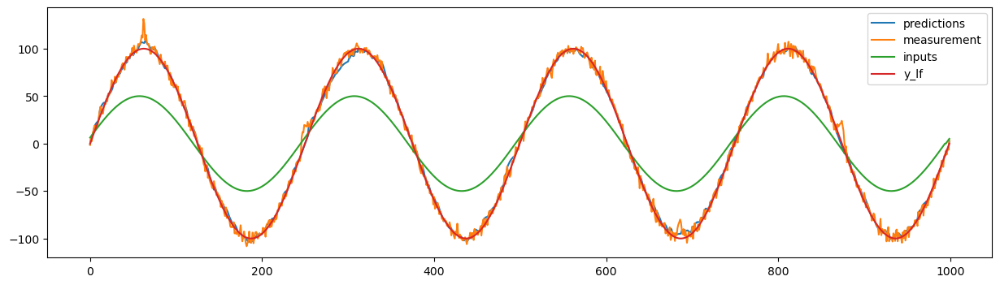

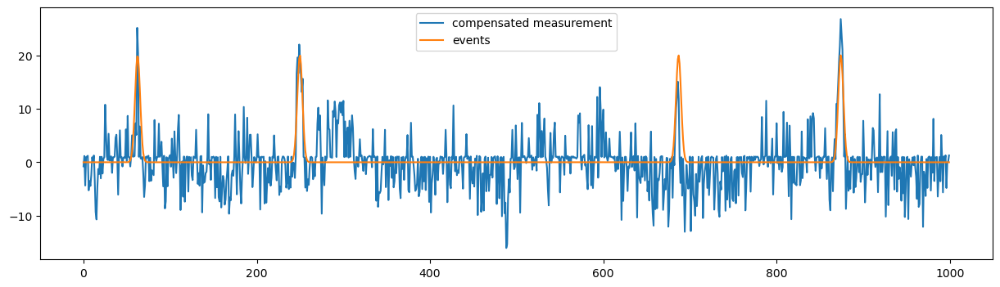

event_to_trend_amplitude: 0.1 , event_length_to_trend_period: 0.1 , time_shift: 0.01
optimal parameters: {'r_measurement_noise': 1.0638010774338111, 'q_process_noise_0': 1.0063049659584178, 'loc': 2.560308181361934}
mse: 11.724779947942286


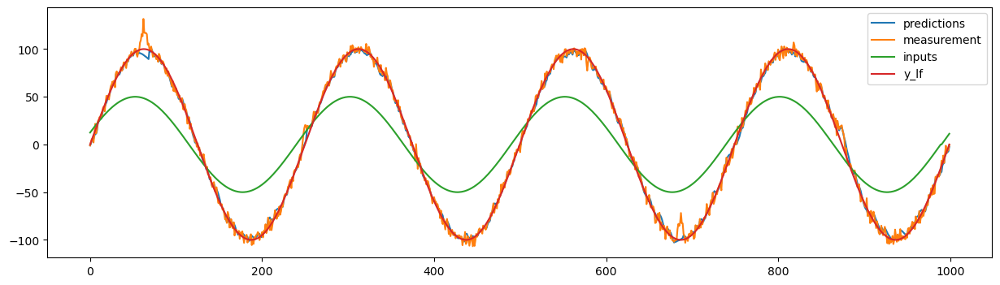

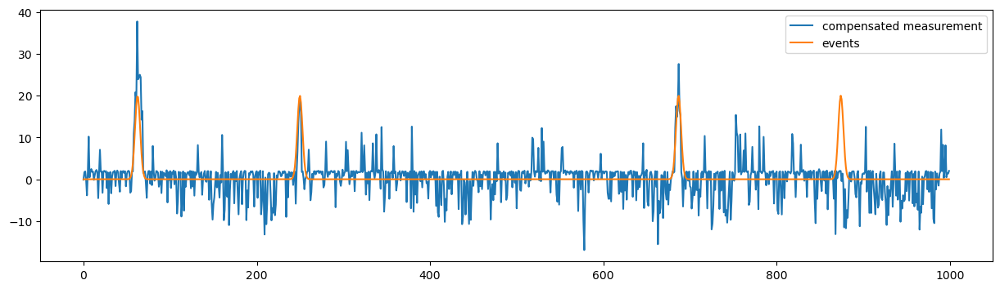

event_to_trend_amplitude: 0.1 , event_length_to_trend_period: 0.1 , time_shift: 0.015
optimal parameters: {'r_measurement_noise': 0.7610182001695288, 'q_process_noise_0': 1.2252071424895996, 'loc': 0.48155786399444284}
mse: 17.19162028318301


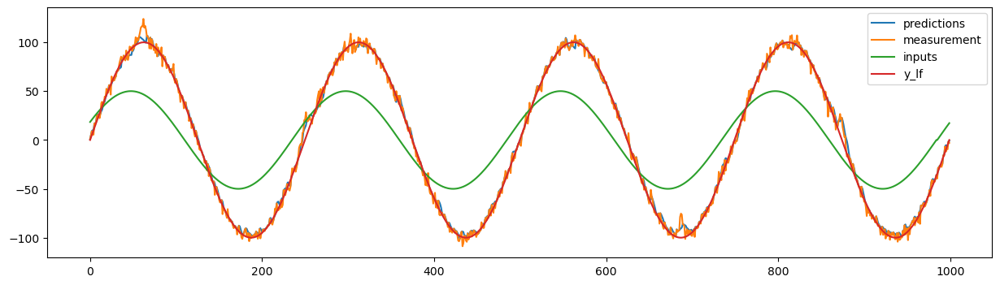

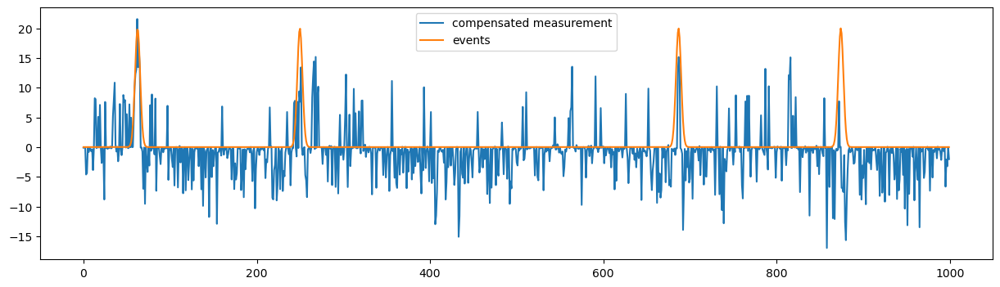

event_to_trend_amplitude: 0.1 , event_length_to_trend_period: 0.1 , time_shift: 0.02
optimal parameters: {'r_measurement_noise': 0.23690237177170184, 'q_process_noise_0': 1.7153832547526304, 'loc': 0.13259632420294584}
mse: 478.15169160785945


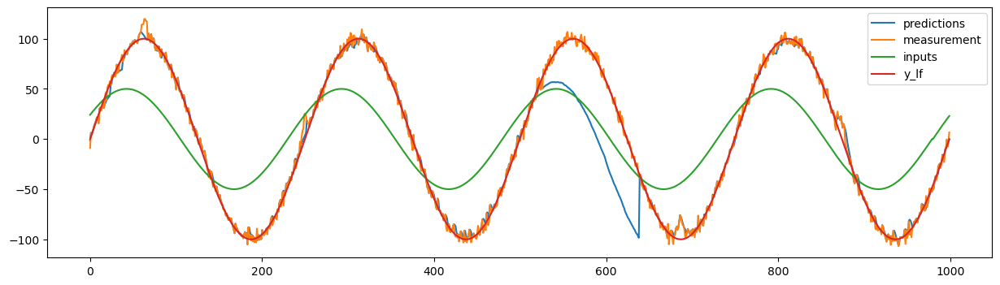

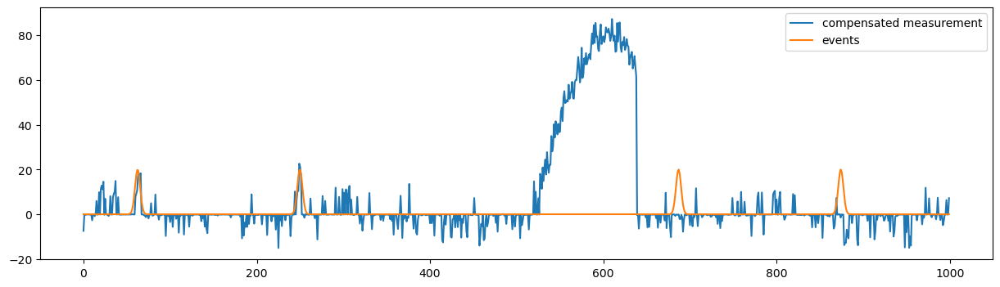

event_to_trend_amplitude: 0.1 , event_length_to_trend_period: 0.2 , time_shift: 0.005
optimal parameters: {'r_measurement_noise': 0.40424134008880475, 'q_process_noise_0': 0.49181142071051726, 'loc': 2.6690252951126636}
mse: 14.475398440299603


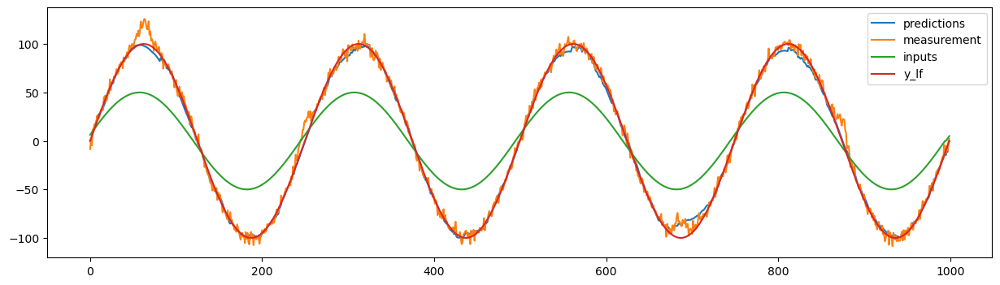

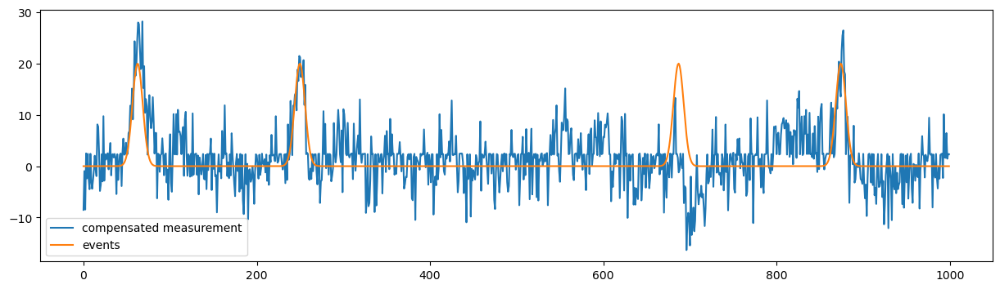

event_to_trend_amplitude: 0.1 , event_length_to_trend_period: 0.2 , time_shift: 0.01
optimal parameters: {'r_measurement_noise': 0.16880851050782913, 'q_process_noise_0': 1.158558954381846, 'loc': 1.8664200934263802}
mse: 25.187279026177205


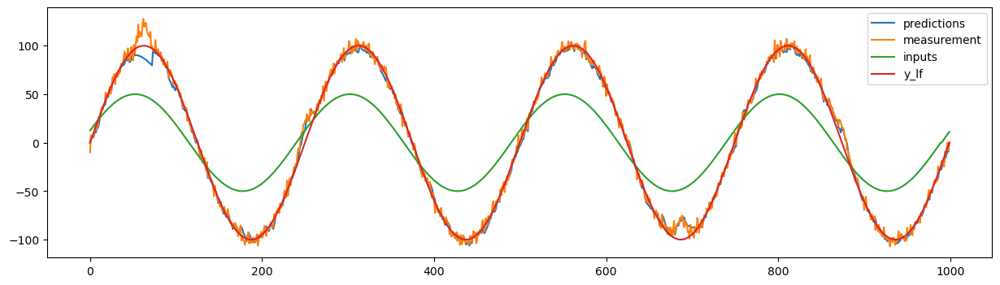

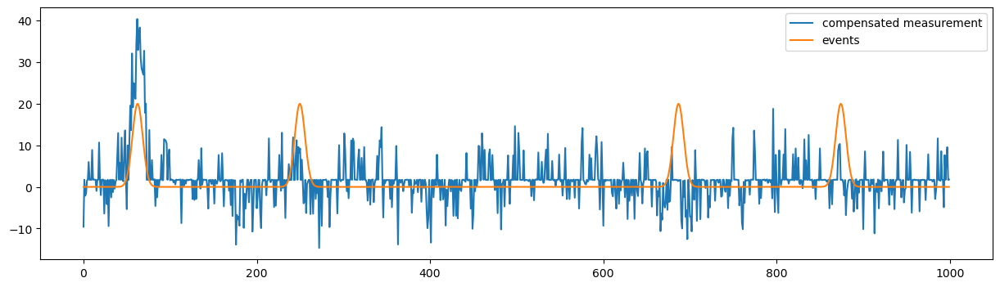

event_to_trend_amplitude: 0.1 , event_length_to_trend_period: 0.2 , time_shift: 0.015
optimal parameters: {'r_measurement_noise': 0.6465967401618349, 'q_process_noise_0': 1.1195481756777077, 'loc': 3.3624713620083995}
mse: 90.22596424060661


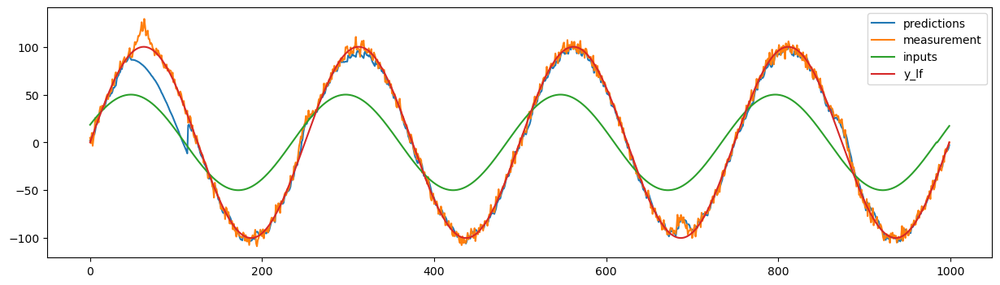

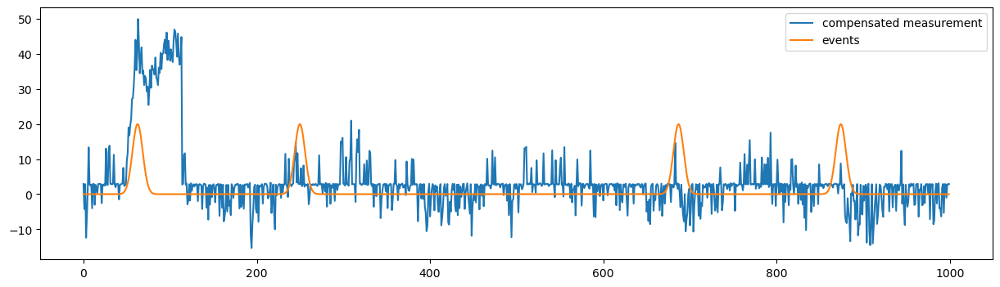

event_to_trend_amplitude: 0.1 , event_length_to_trend_period: 0.2 , time_shift: 0.02
optimal parameters: {'r_measurement_noise': 0.194113834808825, 'q_process_noise_0': 1.957258063376923, 'loc': 1.2587193966082795}
mse: 26.444513474181772


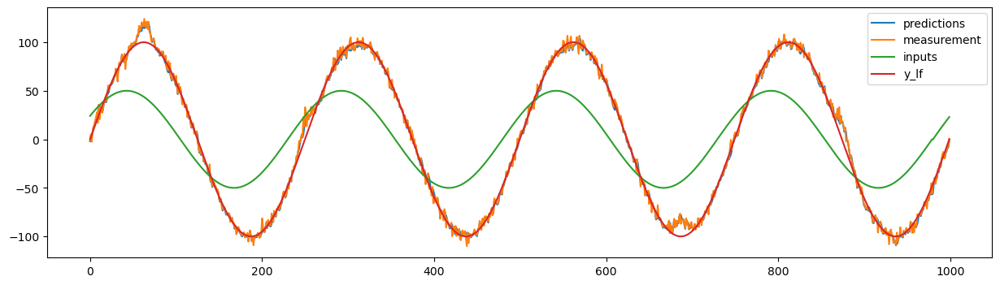

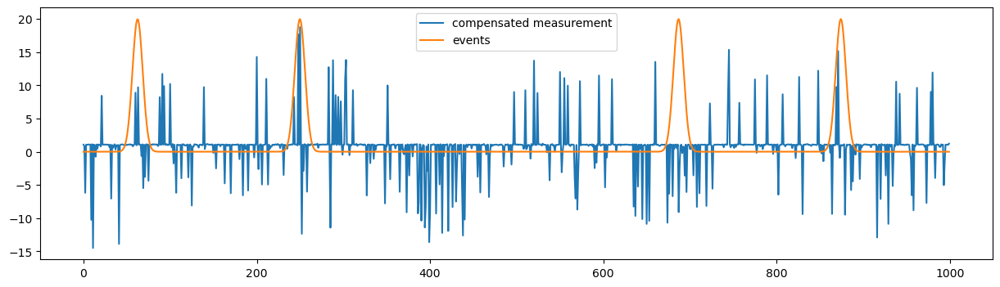

event_to_trend_amplitude: 0.1 , event_length_to_trend_period: 0.30000000000000004 , time_shift: 0.005
optimal parameters: {'r_measurement_noise': 2.4349048602404966, 'q_process_noise_0': 0.3774422431494638, 'loc': 5.480020094662714}
mse: 44.559154294332515


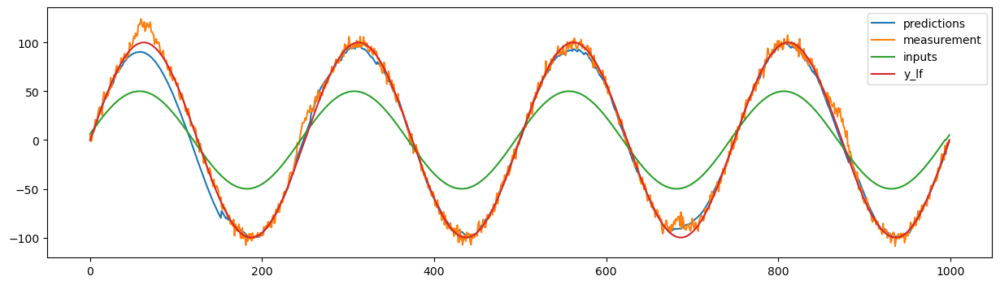

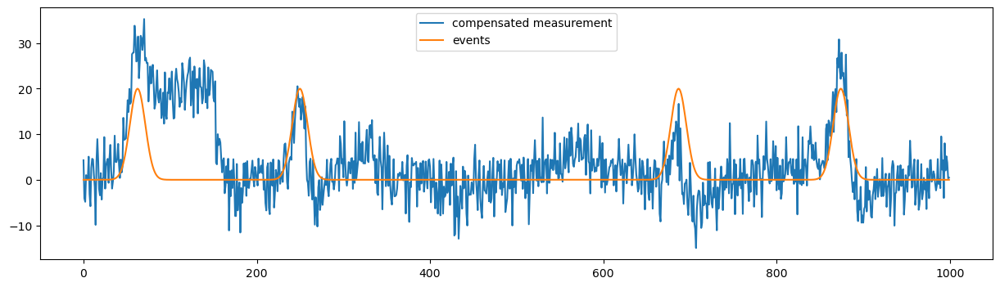

event_to_trend_amplitude: 0.1 , event_length_to_trend_period: 0.30000000000000004 , time_shift: 0.01
optimal parameters: {'r_measurement_noise': 2.7283316022295057, 'q_process_noise_0': 0.7784878336715798, 'loc': 7.397873148751984}
mse: 31.3552546036837


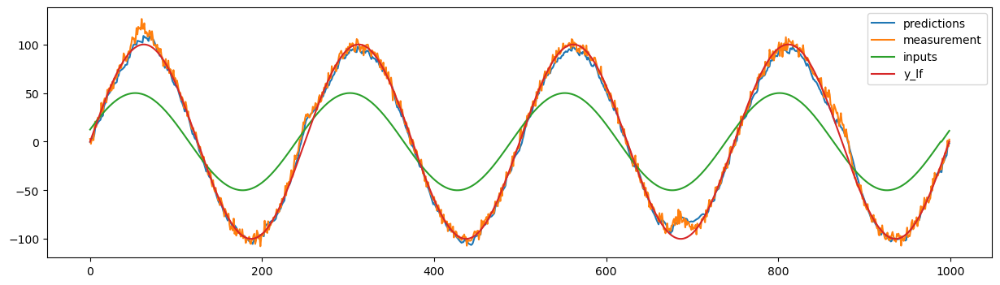

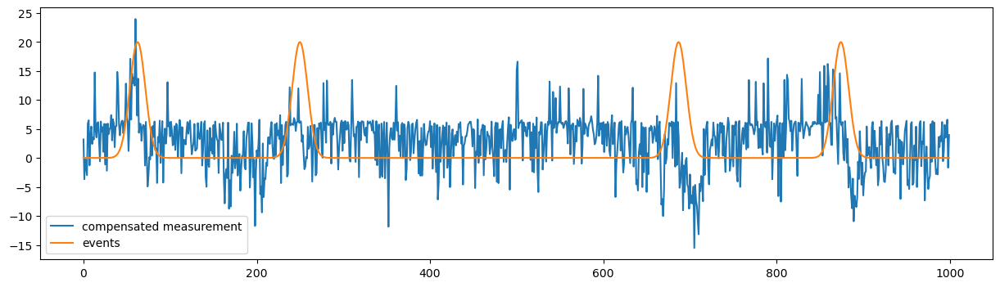

event_to_trend_amplitude: 0.1 , event_length_to_trend_period: 0.30000000000000004 , time_shift: 0.015
optimal parameters: {'r_measurement_noise': 1.5543257109413808, 'q_process_noise_0': 1.1153216277480344, 'loc': 4.108987913529516}
mse: 30.488371504686


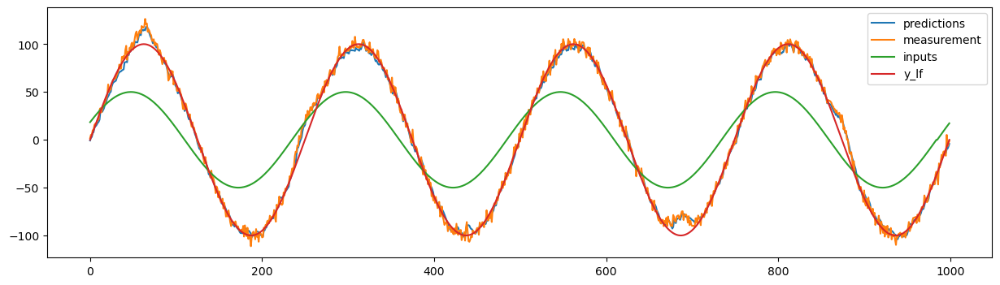

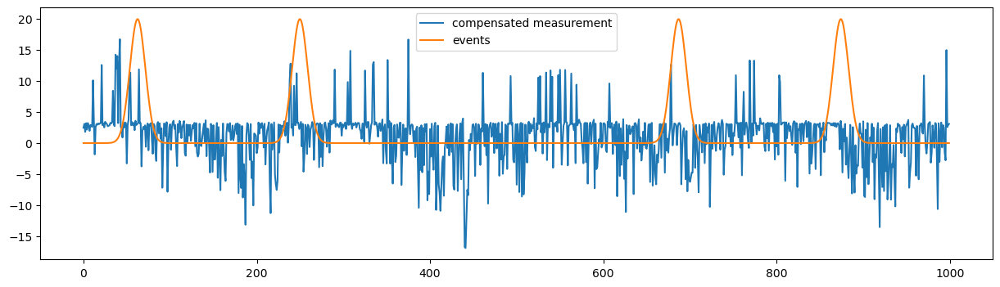

event_to_trend_amplitude: 0.1 , event_length_to_trend_period: 0.30000000000000004 , time_shift: 0.02
optimal parameters: {'r_measurement_noise': 11.378713575442822, 'q_process_noise_0': 1.93118036123448, 'loc': 11.169399446374438}
mse: 28.9689866961876


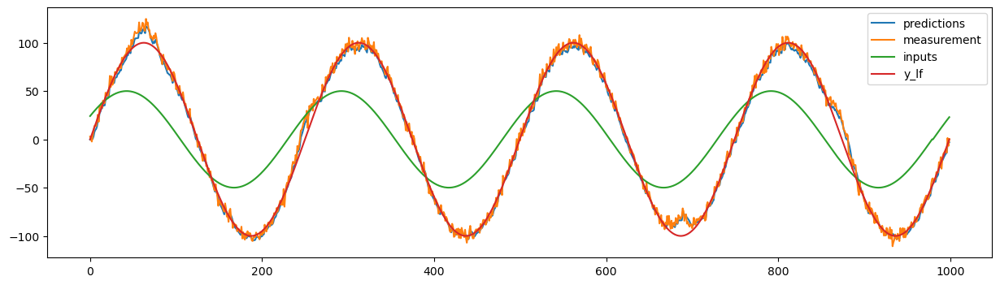

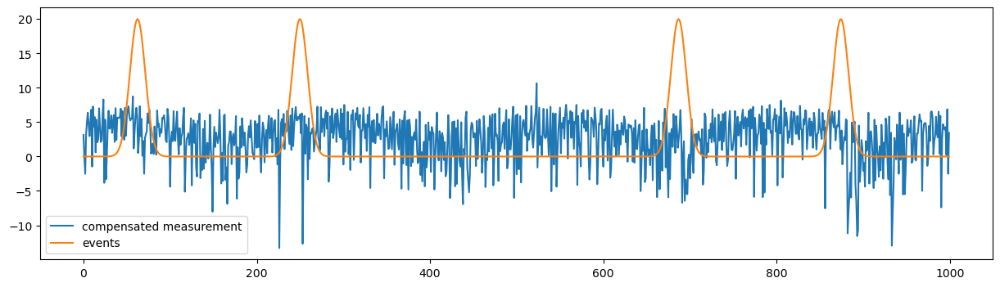

event_to_trend_amplitude: 0.1 , event_length_to_trend_period: 0.4 , time_shift: 0.005
optimal parameters: {'r_measurement_noise': 0.10784605979313684, 'q_process_noise_0': 0.6177177343247255, 'loc': 1.1050016764870356}
mse: 21.039941159610542


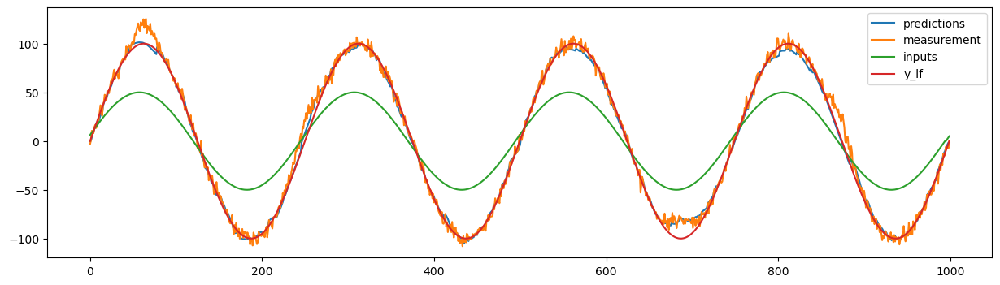

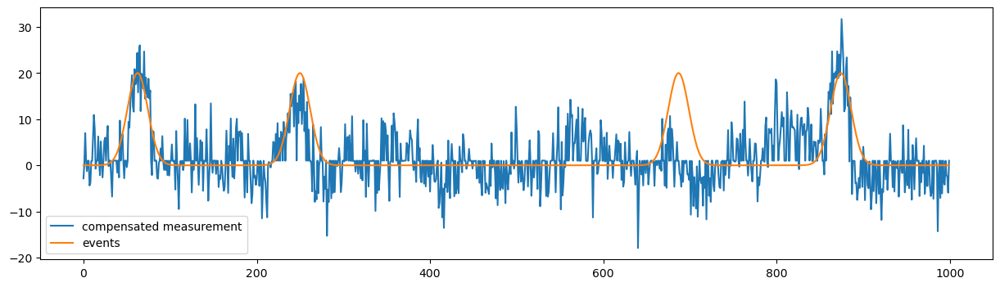

event_to_trend_amplitude: 0.1 , event_length_to_trend_period: 0.4 , time_shift: 0.01
optimal parameters: {'r_measurement_noise': 39.32471590401422, 'q_process_noise_0': 1.8687103495014157, 'loc': 24.089466377656073}
mse: 33.33727418012654


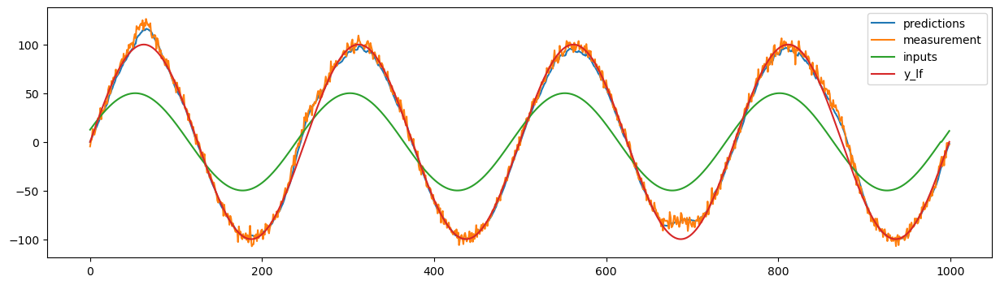

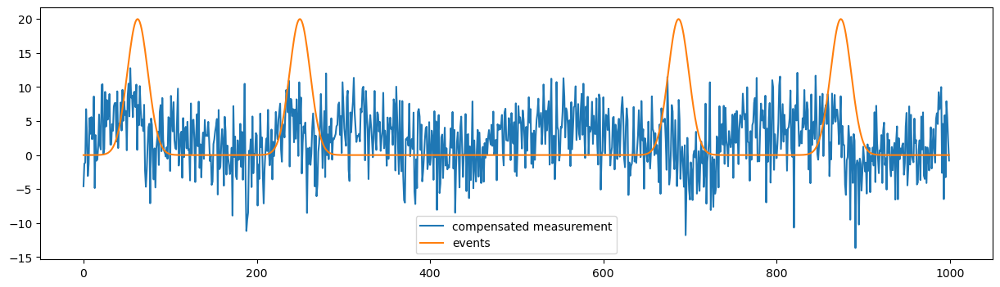

event_to_trend_amplitude: 0.1 , event_length_to_trend_period: 0.4 , time_shift: 0.015
optimal parameters: {'r_measurement_noise': 9.402216667988052, 'q_process_noise_0': 2.215011416295846, 'loc': 10.545542351710653}
mse: 33.53889425351294


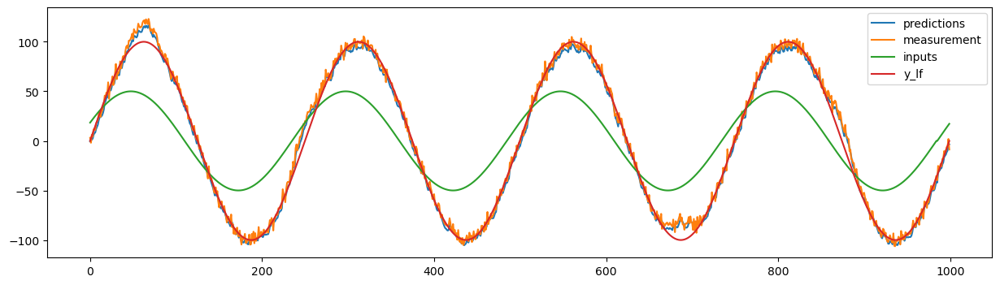

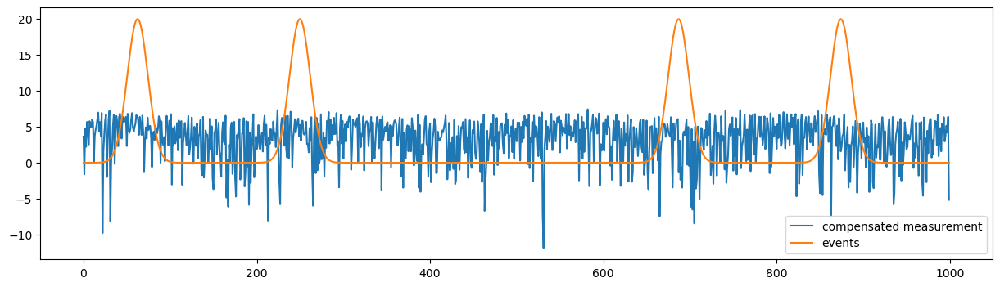

event_to_trend_amplitude: 0.1 , event_length_to_trend_period: 0.4 , time_shift: 0.02
optimal parameters: {'r_measurement_noise': 9.92325590473161, 'q_process_noise_0': 1.7790213023105215, 'loc': 9.544671364848698}
mse: 37.00983781637561


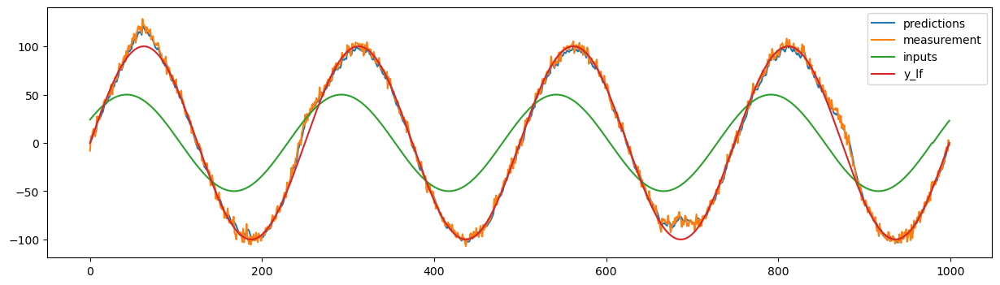

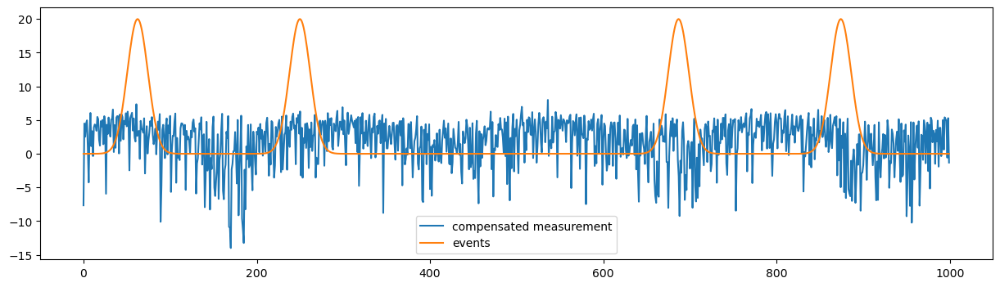

event_to_trend_amplitude: 0.1 , event_length_to_trend_period: 0.5 , time_shift: 0.005
optimal parameters: {'r_measurement_noise': 25.44877876721795, 'q_process_noise_0': 0.5605308789902136, 'loc': 17.128435594745113}
mse: 38.97758149391756


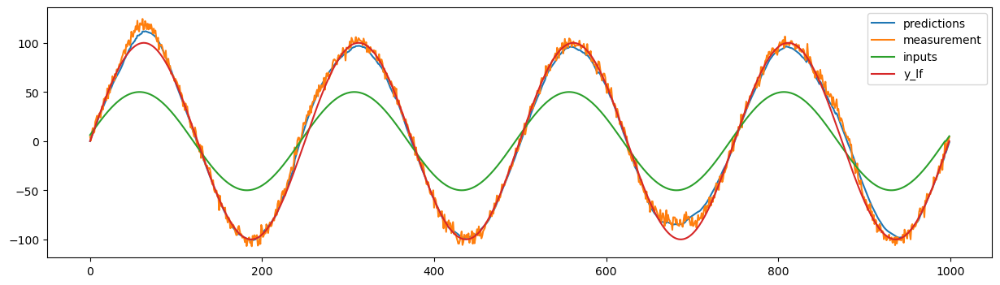

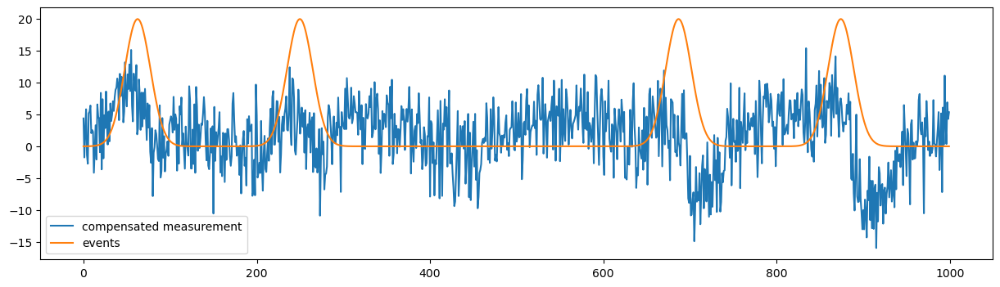

event_to_trend_amplitude: 0.1 , event_length_to_trend_period: 0.5 , time_shift: 0.01
optimal parameters: {'r_measurement_noise': 3.3678275669815805, 'q_process_noise_0': 1.1786682514959055, 'loc': 7.721492515776646}
mse: 39.95421814651649


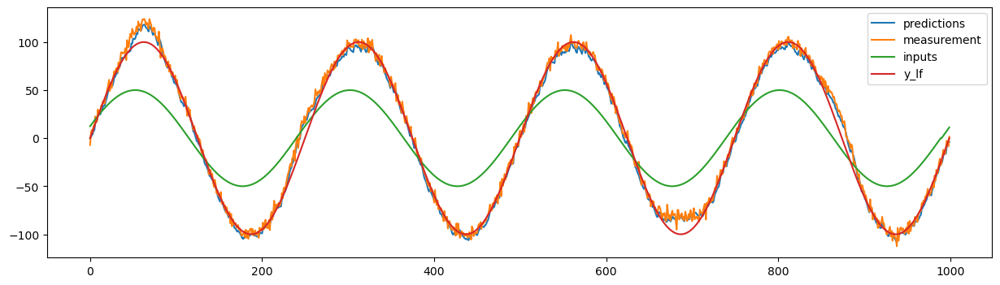

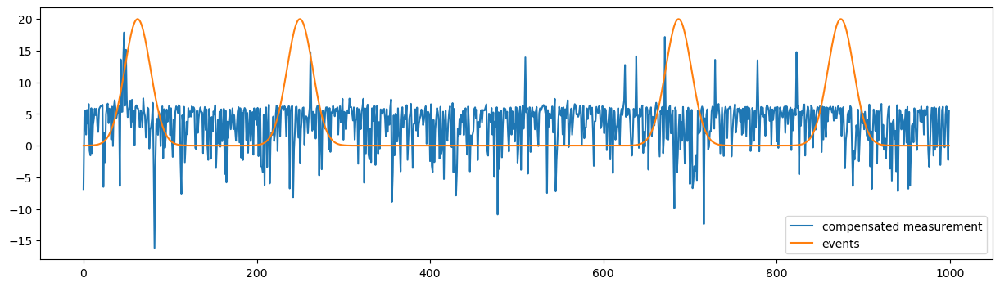

event_to_trend_amplitude: 0.1 , event_length_to_trend_period: 0.5 , time_shift: 0.015
optimal parameters: {'r_measurement_noise': 3.1620140074614533, 'q_process_noise_0': 0.9286585257074146, 'loc': 7.010466015138053}
mse: 40.62346178729062


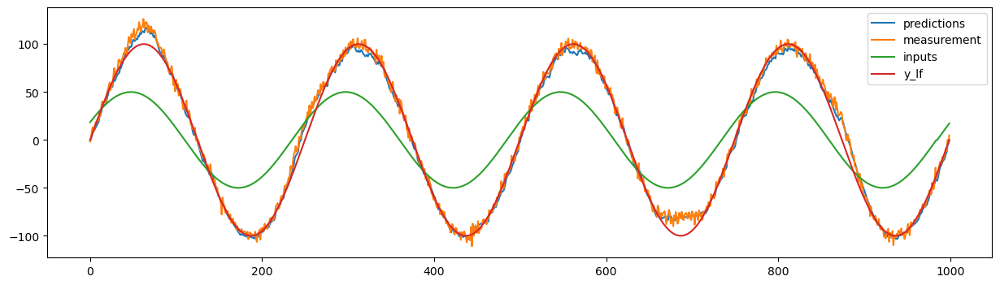

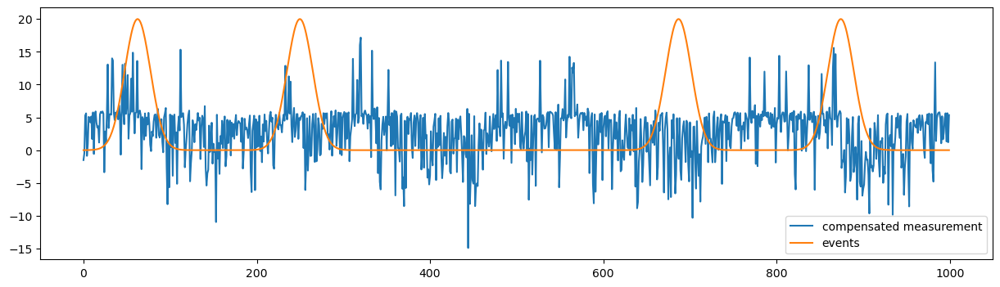

event_to_trend_amplitude: 0.1 , event_length_to_trend_period: 0.5 , time_shift: 0.02
optimal parameters: {'r_measurement_noise': 7.504675248829049, 'q_process_noise_0': 1.7090617578249683, 'loc': 9.97187135513495}
mse: 38.343572218667525


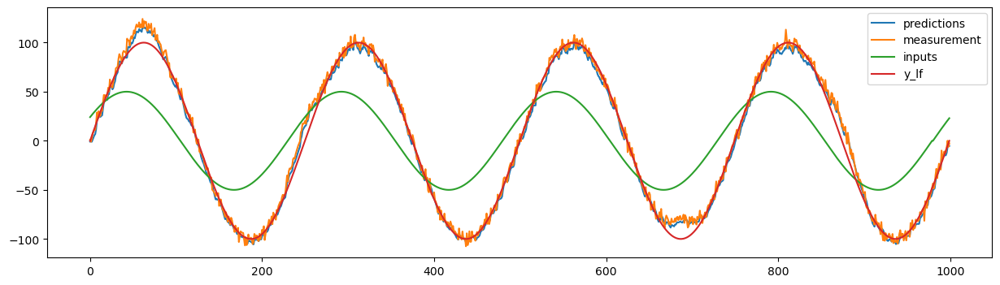

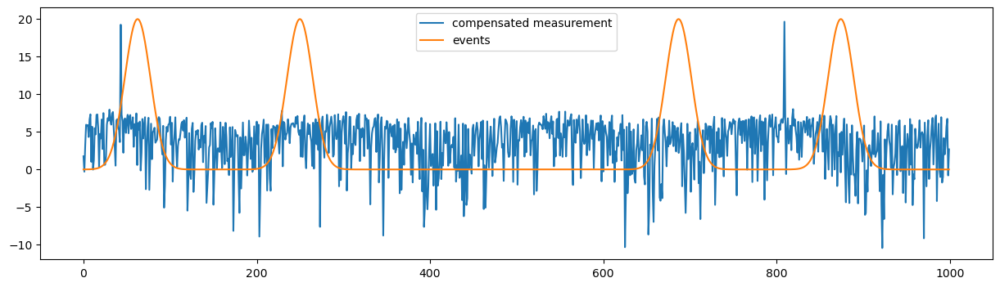

event_to_trend_amplitude: 0.1 , event_length_to_trend_period: 0.6 , time_shift: 0.005
optimal parameters: {'r_measurement_noise': 0.2807952481904351, 'q_process_noise_0': 0.40090278808501767, 'loc': 3.094248940207335}
mse: 37.00563277296924


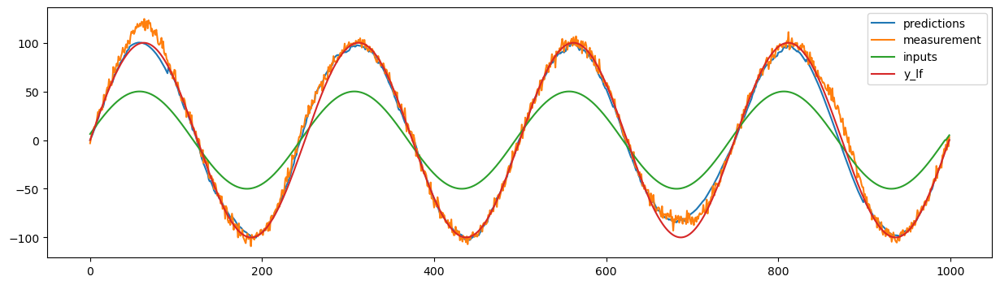

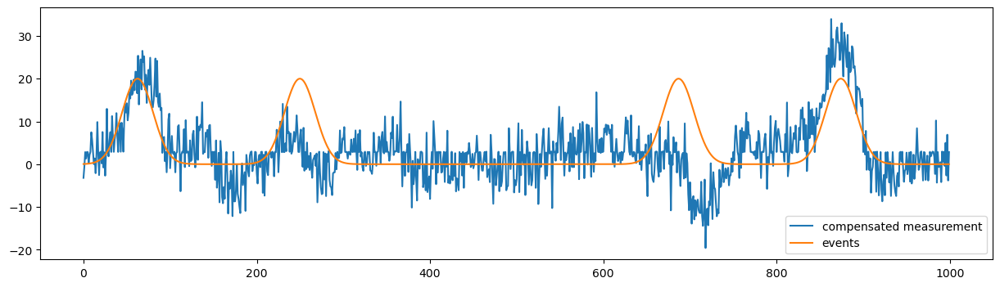

event_to_trend_amplitude: 0.1 , event_length_to_trend_period: 0.6 , time_shift: 0.01
optimal parameters: {'r_measurement_noise': 0.100637401812, 'q_process_noise_0': 0.8521604443377847, 'loc': 4.397394095595484}
mse: 79.81123339973564


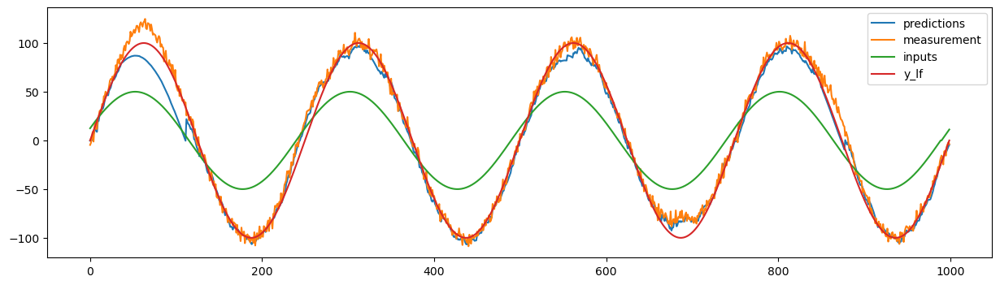

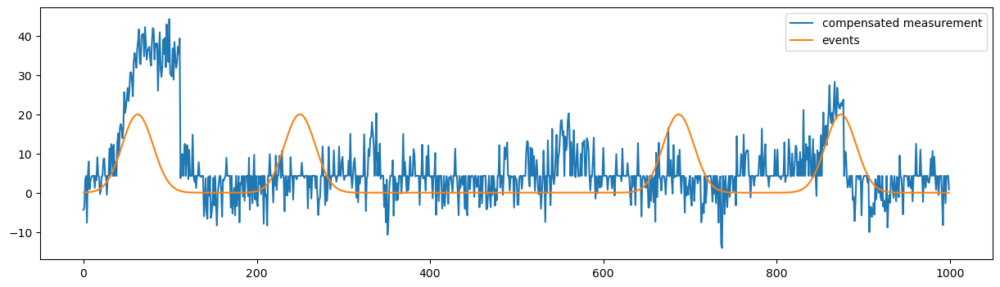

event_to_trend_amplitude: 0.1 , event_length_to_trend_period: 0.6 , time_shift: 0.015
optimal parameters: {'r_measurement_noise': 22.150196830429255, 'q_process_noise_0': 2.240879447887892, 'loc': 17.531771617337373}
mse: 43.48122236801688


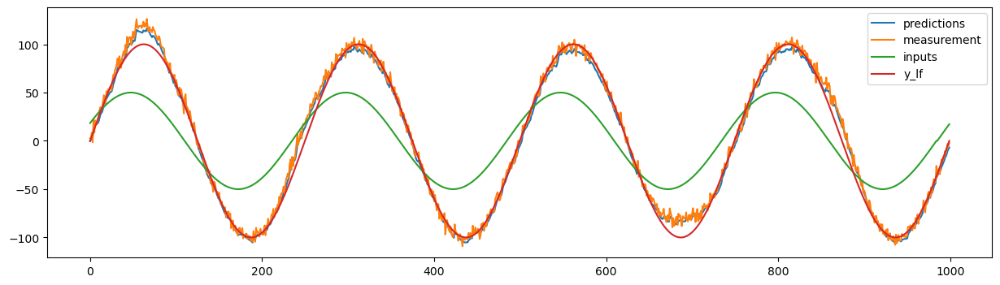

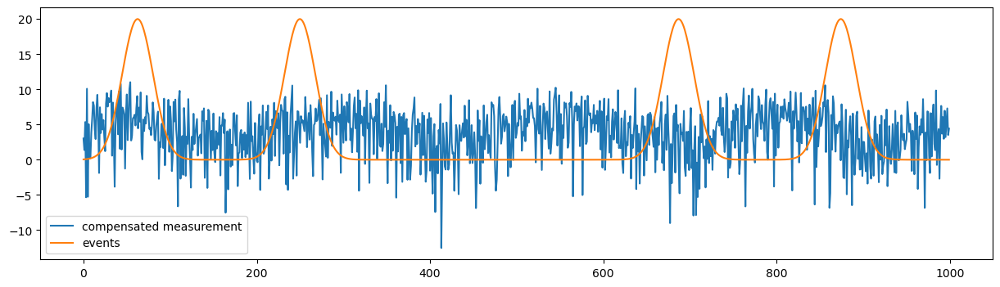

event_to_trend_amplitude: 0.1 , event_length_to_trend_period: 0.6 , time_shift: 0.02
optimal parameters: {'r_measurement_noise': 0.38601480110022546, 'q_process_noise_0': 1.6340133093963438, 'loc': 3.970408784059037}
mse: 41.857444308842375


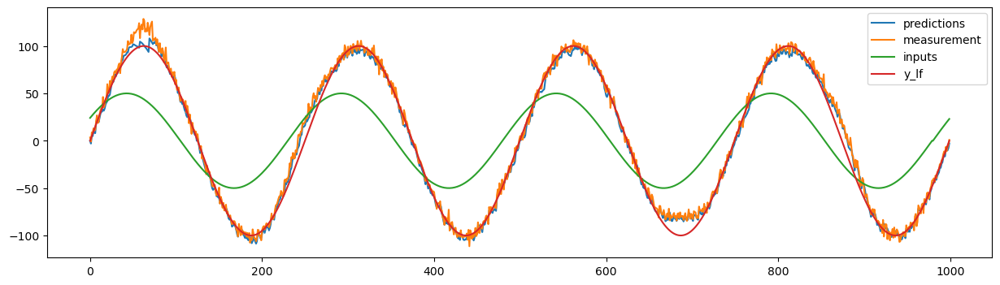

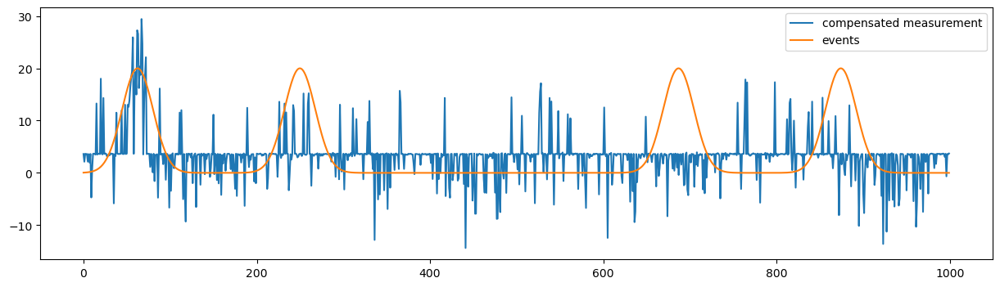

event_to_trend_amplitude: 0.2 , event_length_to_trend_period: 0.1 , time_shift: 0.005
optimal parameters: {'r_measurement_noise': 0.28052833118841397, 'q_process_noise_0': 0.7157996030252438, 'loc': 0.9035543478695044}
mse: 6.799651285466016


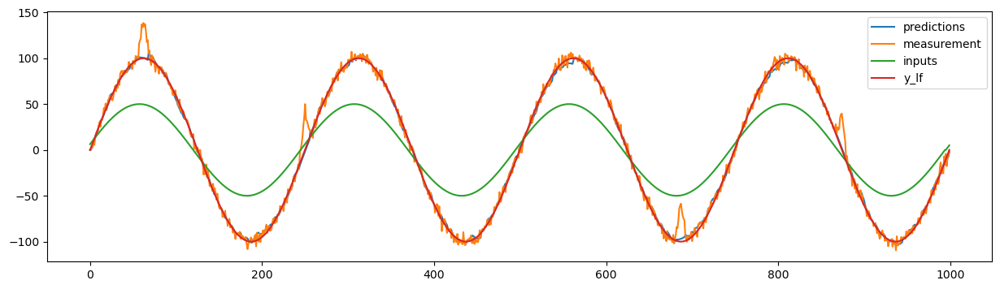

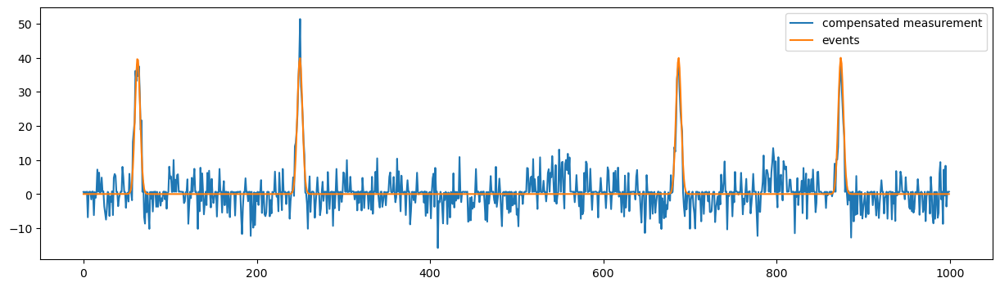

event_to_trend_amplitude: 0.2 , event_length_to_trend_period: 0.1 , time_shift: 0.01
optimal parameters: {'r_measurement_noise': 3.699321742182378, 'q_process_noise_0': 1.0173682050124875, 'loc': 4.311992689162276}
mse: 16.796437984865666


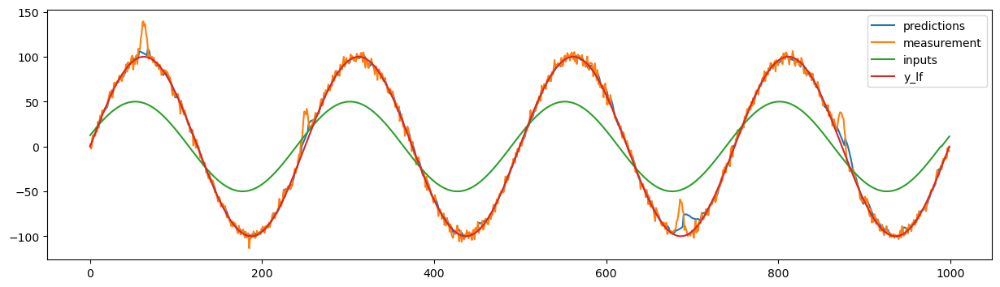

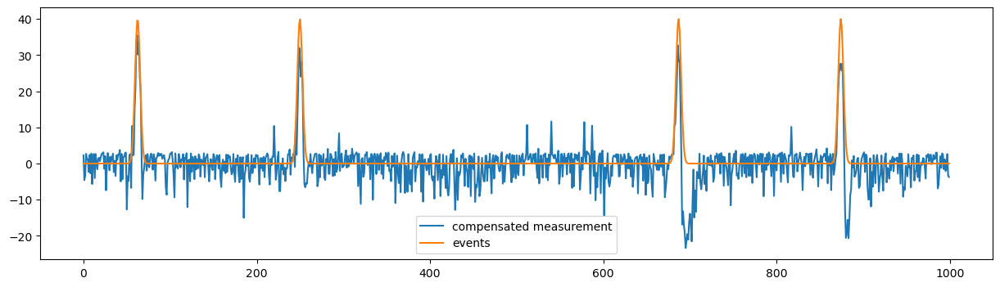

event_to_trend_amplitude: 0.2 , event_length_to_trend_period: 0.1 , time_shift: 0.015
optimal parameters: {'r_measurement_noise': 2.2809056709431874, 'q_process_noise_0': 1.2897650825057787, 'loc': 4.295543437697721}
mse: 13.528004111386426


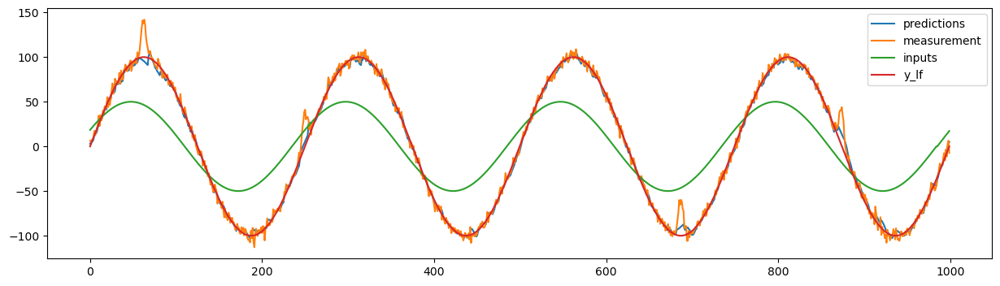

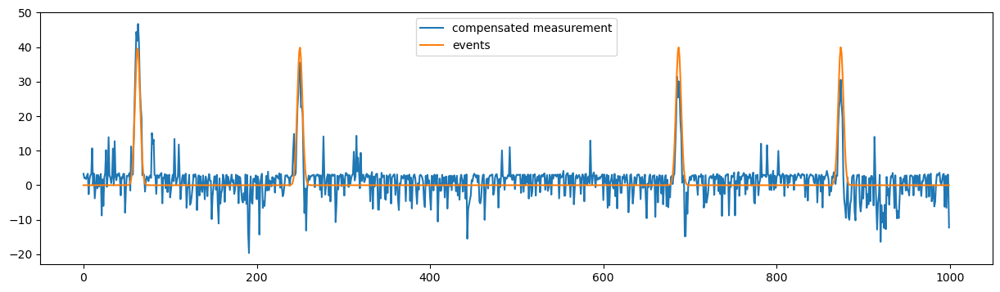

event_to_trend_amplitude: 0.2 , event_length_to_trend_period: 0.1 , time_shift: 0.02
optimal parameters: {'r_measurement_noise': 0.5528798841861577, 'q_process_noise_0': 1.5596114837355672, 'loc': 0.710192421023671}
mse: 28.46517576062257


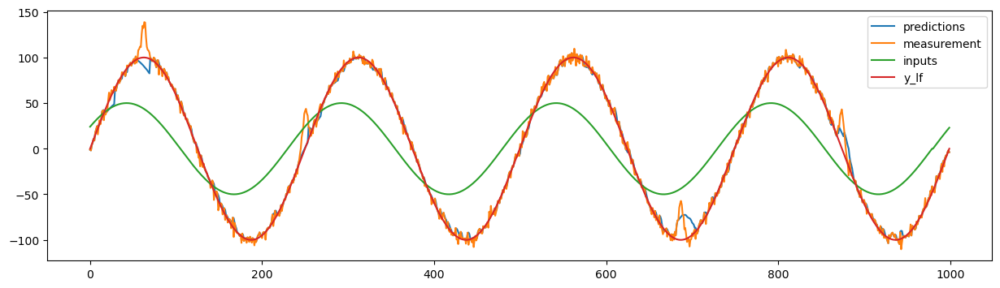

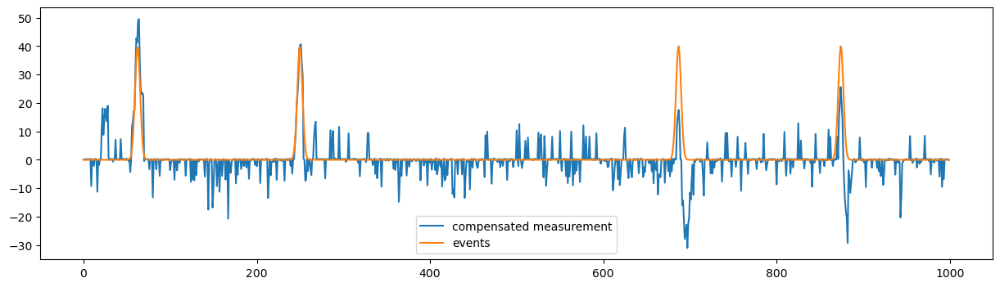

event_to_trend_amplitude: 0.2 , event_length_to_trend_period: 0.2 , time_shift: 0.005
optimal parameters: {'r_measurement_noise': 0.12670766499507136, 'q_process_noise_0': 0.5879544492101275, 'loc': 0.33083615346441175}
mse: 11.95028330221558


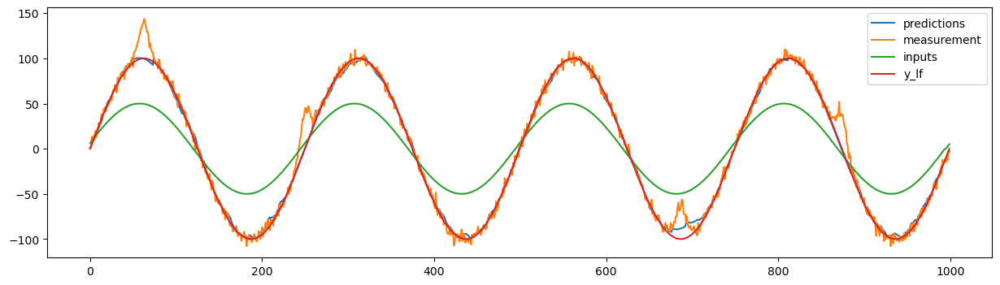

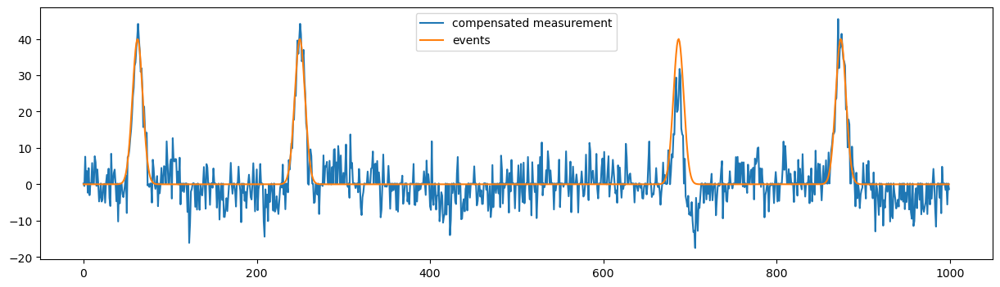

event_to_trend_amplitude: 0.2 , event_length_to_trend_period: 0.2 , time_shift: 0.01
optimal parameters: {'r_measurement_noise': 0.6812881853497331, 'q_process_noise_0': 0.859626051728072, 'loc': 2.750218892623862}
mse: 22.58439107838823


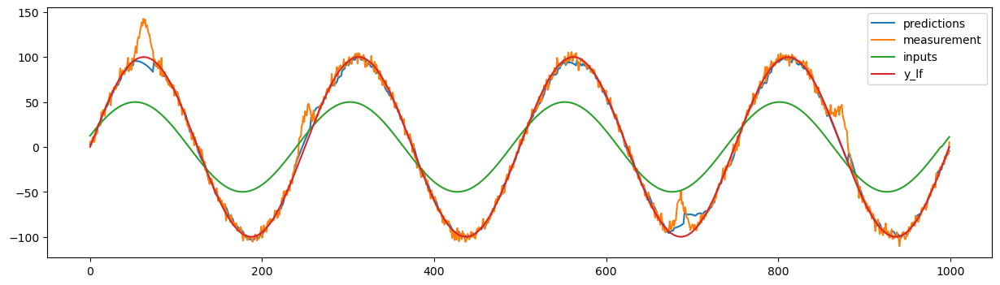

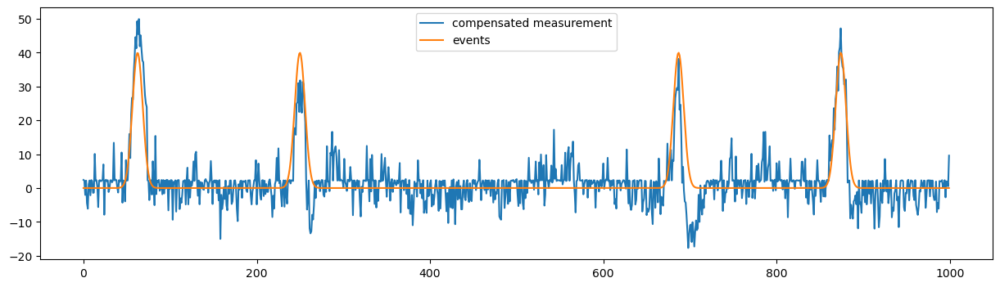

event_to_trend_amplitude: 0.2 , event_length_to_trend_period: 0.2 , time_shift: 0.015
optimal parameters: {'r_measurement_noise': 0.12423225068569023, 'q_process_noise_0': 1.6659668781830836, 'loc': 3.001450274791188}
mse: 40.776789702264


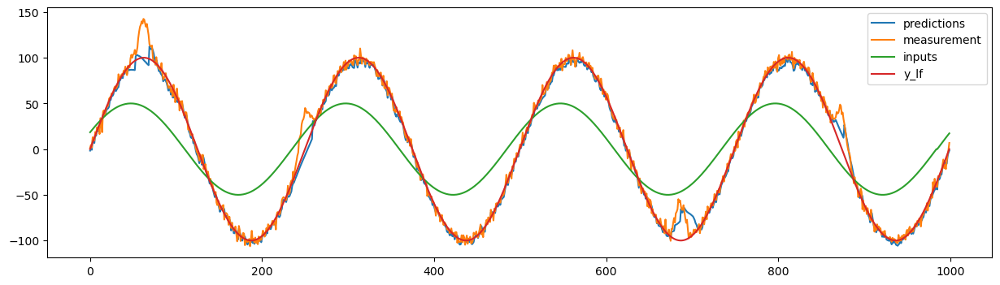

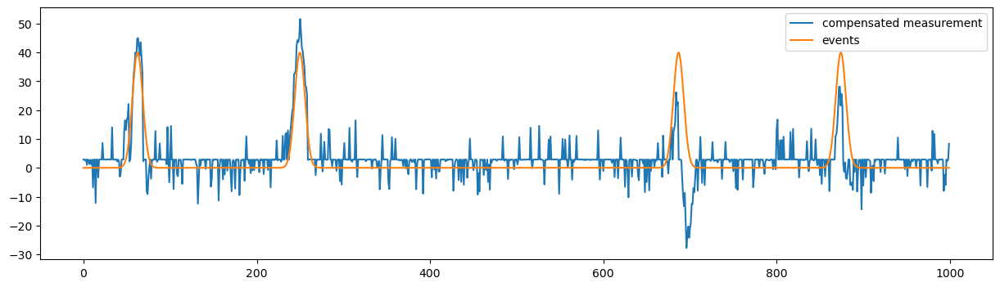

event_to_trend_amplitude: 0.2 , event_length_to_trend_period: 0.2 , time_shift: 0.02
optimal parameters: {'r_measurement_noise': 0.33884593440793936, 'q_process_noise_0': 1.6106911060421758, 'loc': 3.203922541572293}
mse: 63.376367088831564


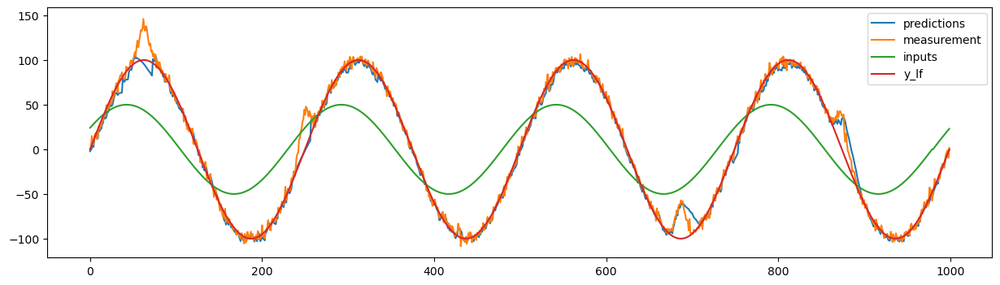

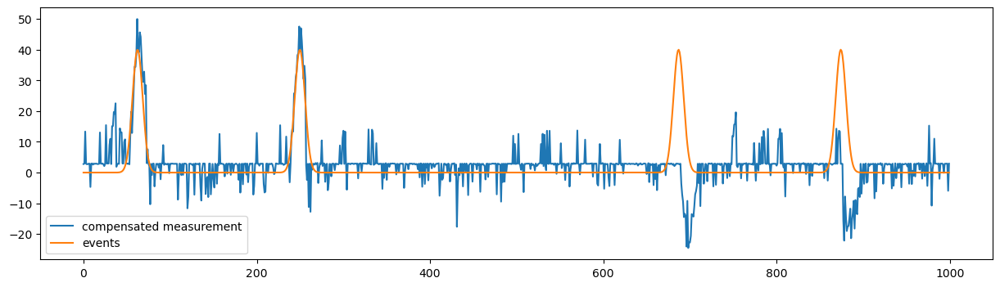

event_to_trend_amplitude: 0.2 , event_length_to_trend_period: 0.30000000000000004 , time_shift: 0.005
optimal parameters: {'r_measurement_noise': 2.468340750690028, 'q_process_noise_0': 0.6131364213011213, 'loc': 5.388567756884899}
mse: 19.738207760562954


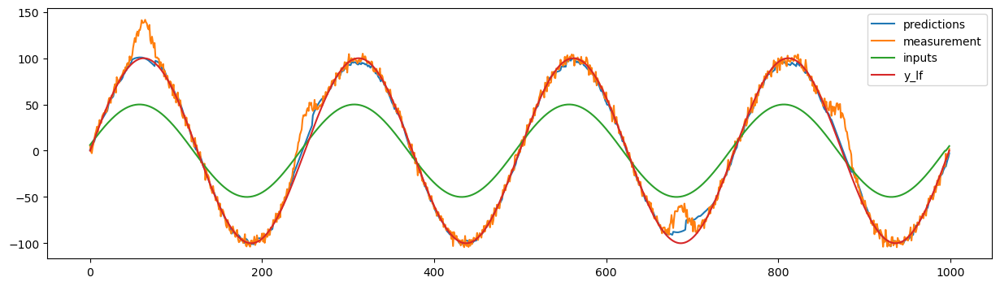

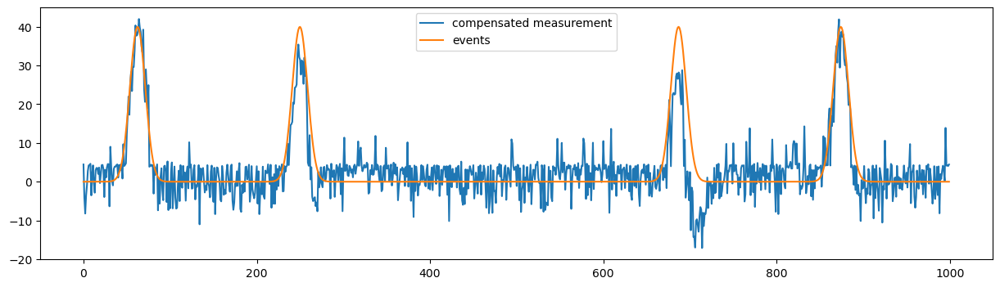

event_to_trend_amplitude: 0.2 , event_length_to_trend_period: 0.30000000000000004 , time_shift: 0.01
optimal parameters: {'r_measurement_noise': 0.13208253934633543, 'q_process_noise_0': 1.0503214696902274, 'loc': 2.9201277707353257}
mse: 39.7820293285888


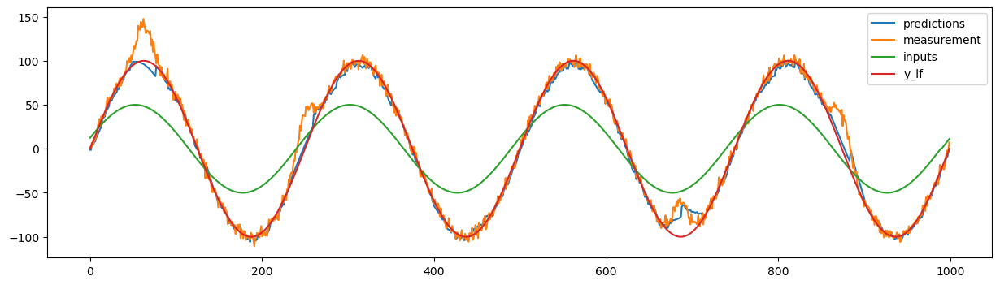

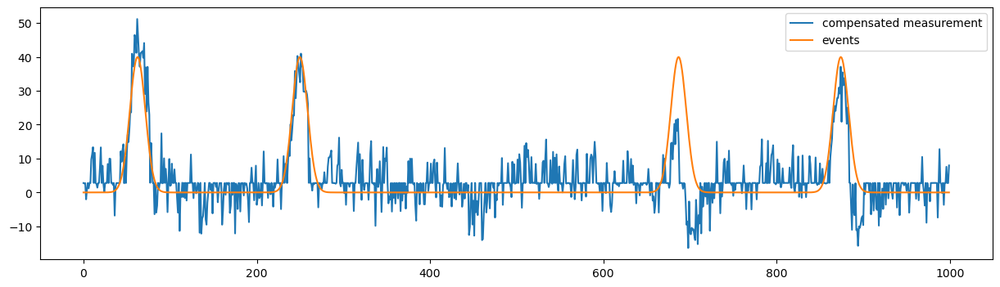

event_to_trend_amplitude: 0.2 , event_length_to_trend_period: 0.30000000000000004 , time_shift: 0.015
optimal parameters: {'r_measurement_noise': 0.17399279584699015, 'q_process_noise_0': 1.61506172286164, 'loc': 5.395863705662704}
mse: 85.49345579880645


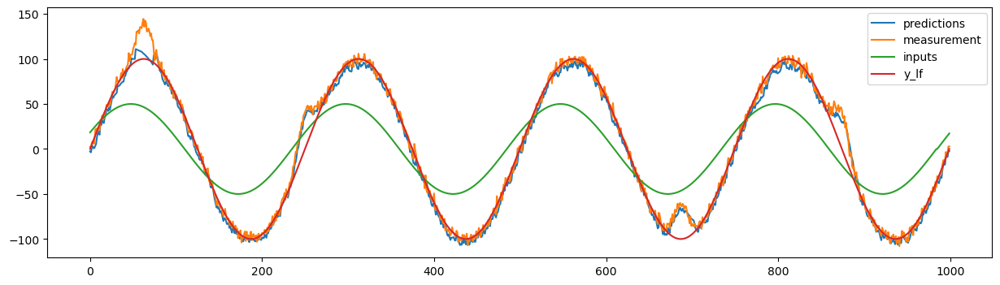

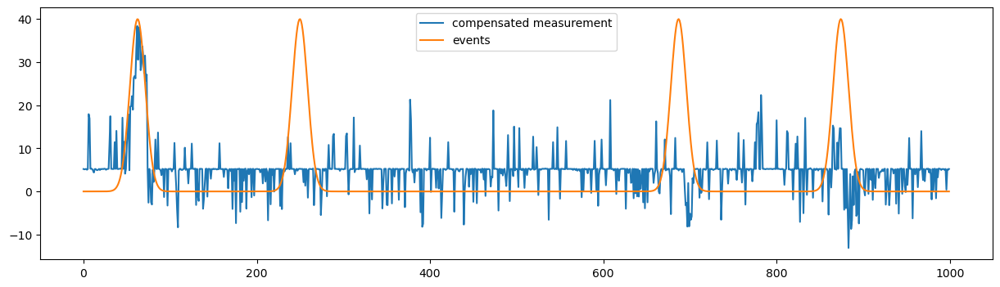

event_to_trend_amplitude: 0.2 , event_length_to_trend_period: 0.30000000000000004 , time_shift: 0.02
optimal parameters: {'r_measurement_noise': 1.3978667510603484, 'q_process_noise_0': 1.4873591443031842, 'loc': 5.6901229573368095}
mse: 87.7419533271555


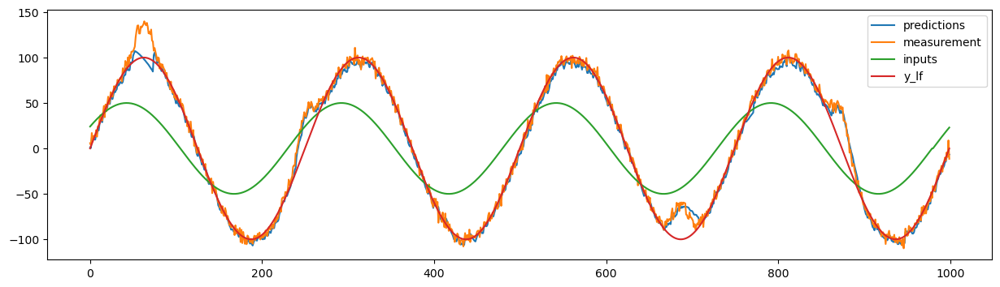

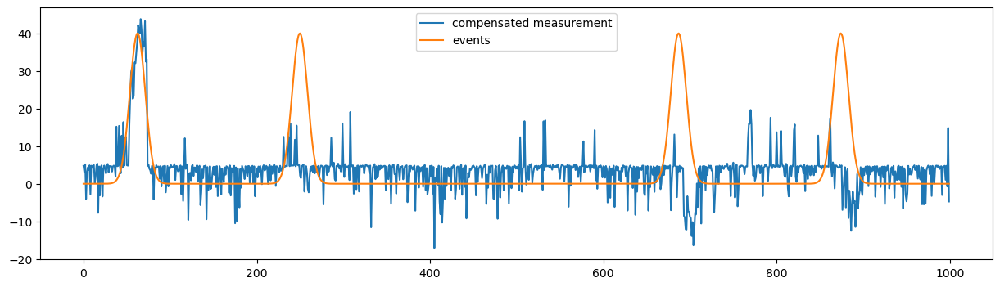

event_to_trend_amplitude: 0.2 , event_length_to_trend_period: 0.4 , time_shift: 0.005
optimal parameters: {'r_measurement_noise': 0.20851690673237783, 'q_process_noise_0': 0.5633741294262884, 'loc': 3.1346127926741683}
mse: 20.28237344413551


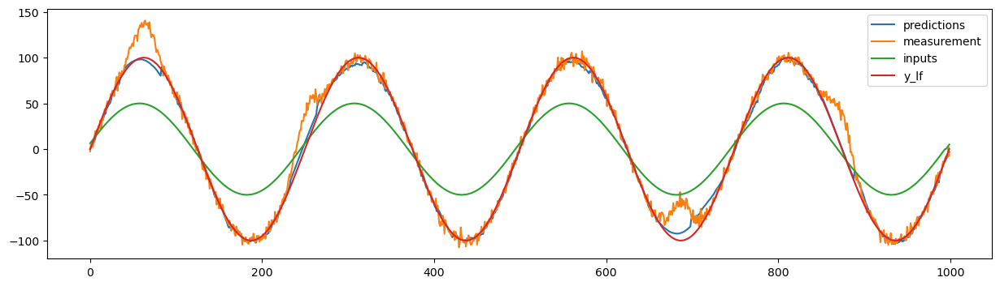

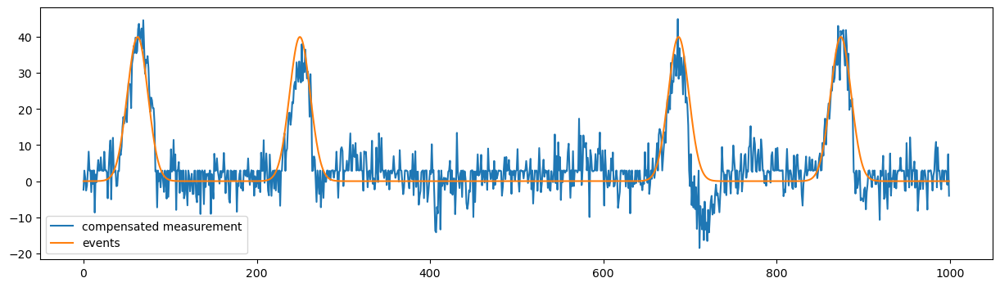

event_to_trend_amplitude: 0.2 , event_length_to_trend_period: 0.4 , time_shift: 0.01
optimal parameters: {'r_measurement_noise': 1.8636435840422434, 'q_process_noise_0': 2.021394854870013, 'loc': 8.155087623820101}
mse: 118.71659772758531


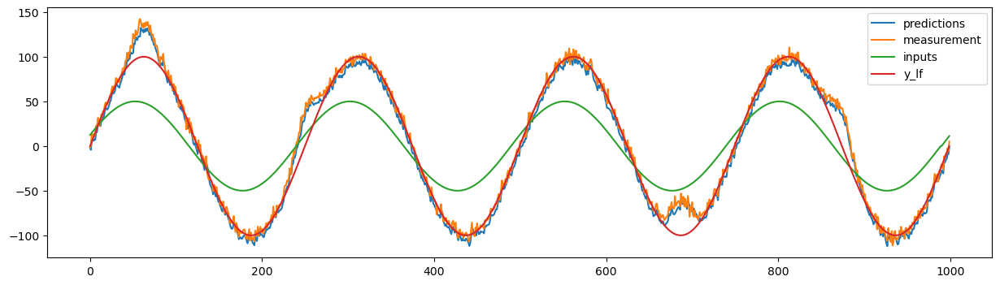

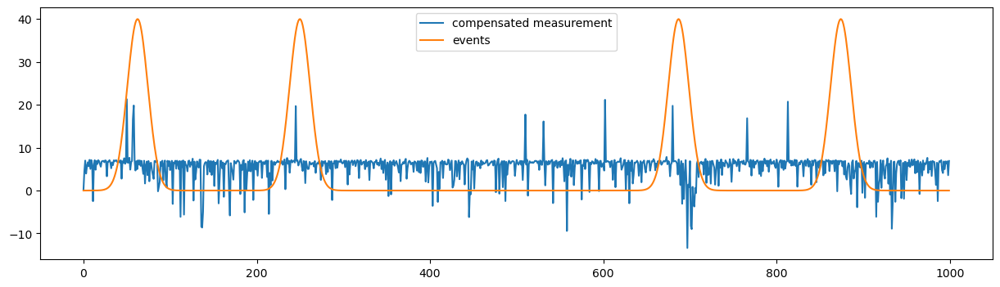

event_to_trend_amplitude: 0.2 , event_length_to_trend_period: 0.4 , time_shift: 0.015
optimal parameters: {'r_measurement_noise': 0.10776036366412808, 'q_process_noise_0': 1.5972149771495292, 'loc': 3.979113835483579}
mse: 105.51006122451514


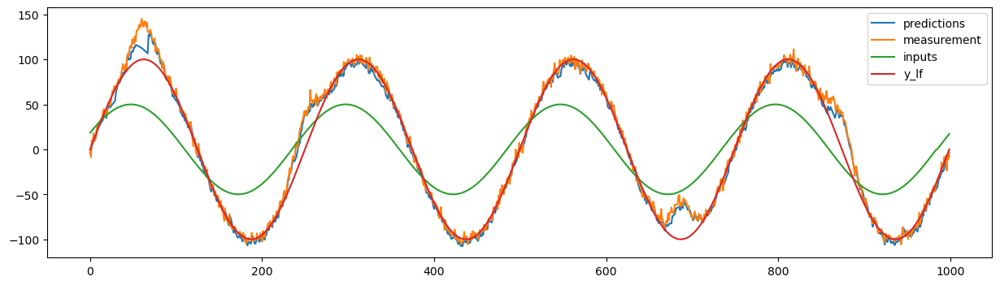

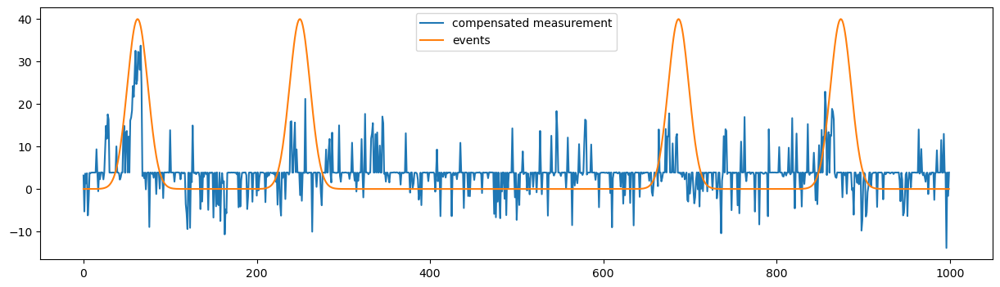

event_to_trend_amplitude: 0.2 , event_length_to_trend_period: 0.4 , time_shift: 0.02
optimal parameters: {'r_measurement_noise': 2.3607635661783384, 'q_process_noise_0': 1.3881642401601326, 'loc': 9.407832990581115}
mse: 201.16284405195958


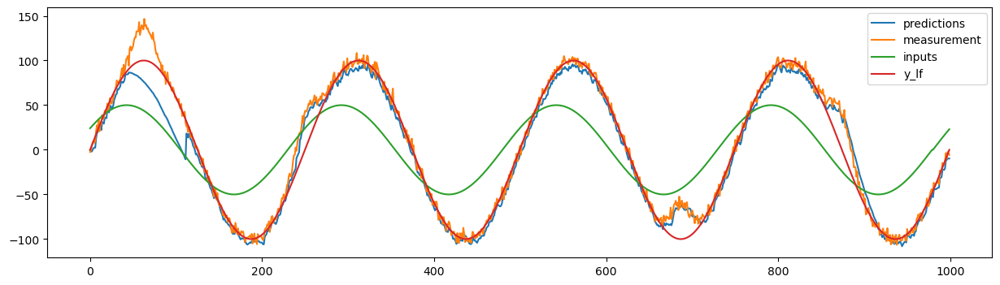

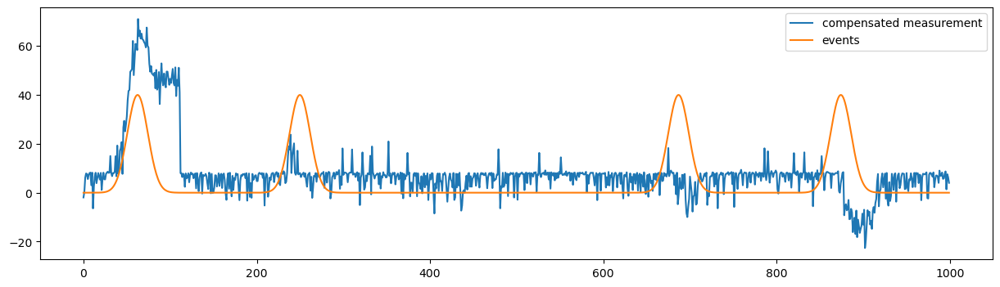

event_to_trend_amplitude: 0.2 , event_length_to_trend_period: 0.5 , time_shift: 0.005
optimal parameters: {'r_measurement_noise': 1.3992385548046007, 'q_process_noise_0': 0.4474454607099835, 'loc': 0.2621625484364286}
mse: 70.55903241822851


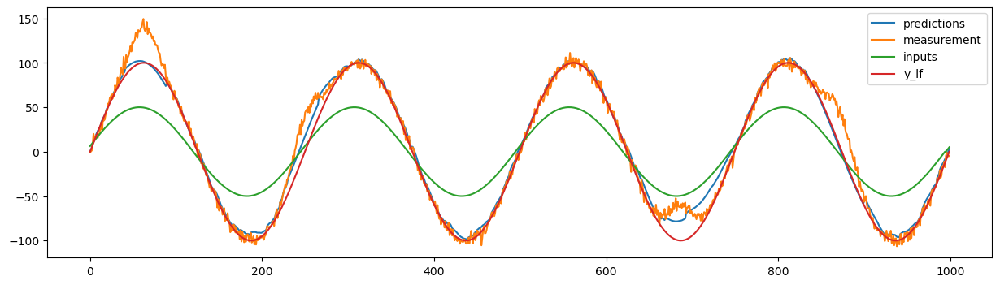

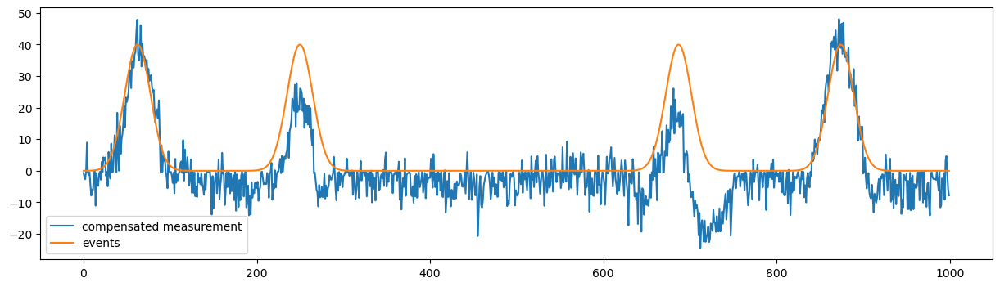

event_to_trend_amplitude: 0.2 , event_length_to_trend_period: 0.5 , time_shift: 0.01
optimal parameters: {'r_measurement_noise': 0.2876955088981667, 'q_process_noise_0': 0.8432935139381372, 'loc': 2.4487180396925092}
mse: 92.09635953494


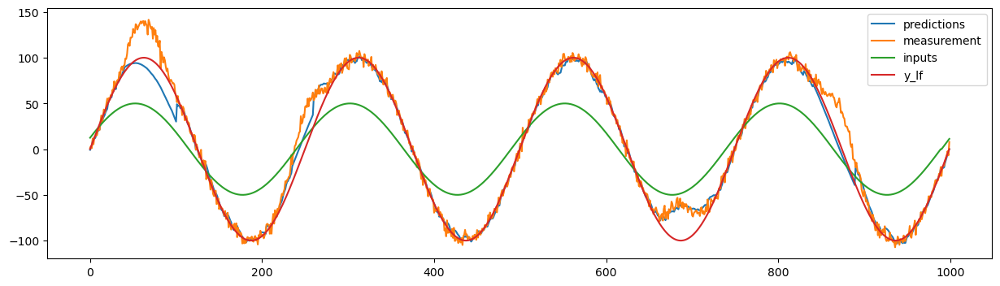

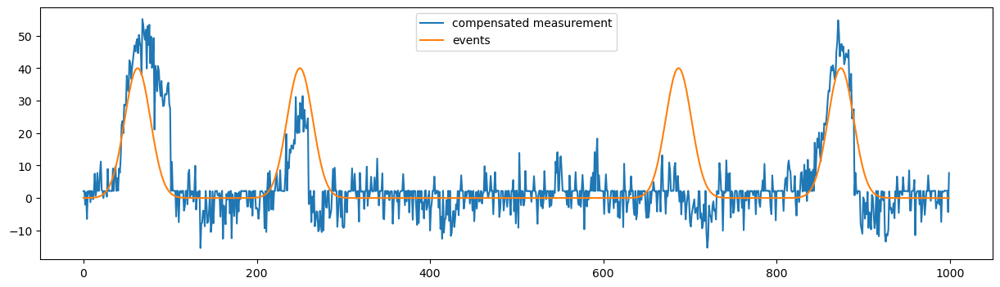

event_to_trend_amplitude: 0.2 , event_length_to_trend_period: 0.5 , time_shift: 0.015
optimal parameters: {'r_measurement_noise': 1.4863825469546146, 'q_process_noise_0': 1.5231178069892666, 'loc': 9.902392188356258}
mse: 151.94894252630615


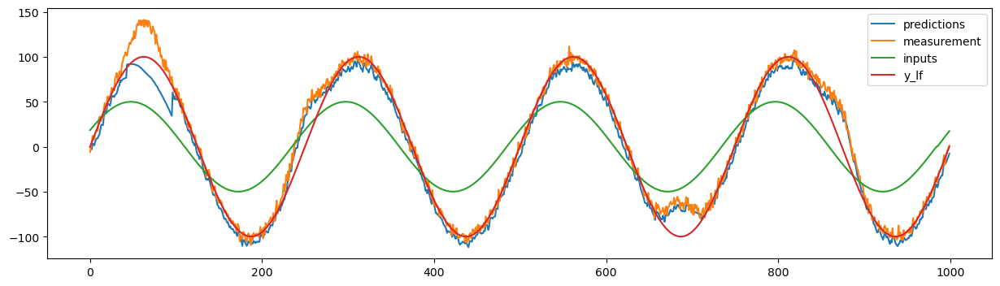

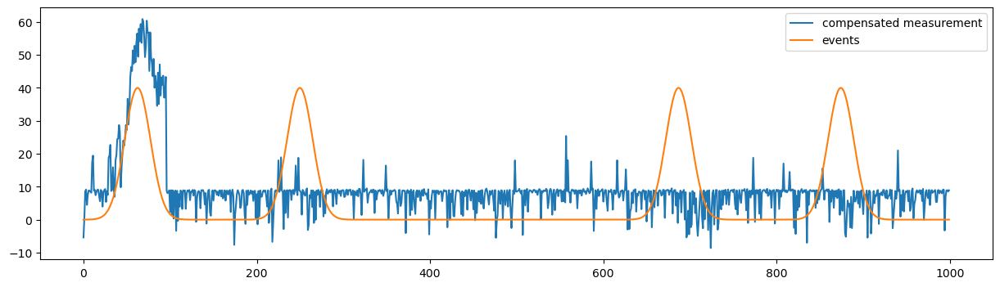

event_to_trend_amplitude: 0.2 , event_length_to_trend_period: 0.5 , time_shift: 0.02
optimal parameters: {'r_measurement_noise': 0.7920312390241486, 'q_process_noise_0': 2.575619689104342, 'loc': 7.430002240742761}
mse: 146.3390156592847


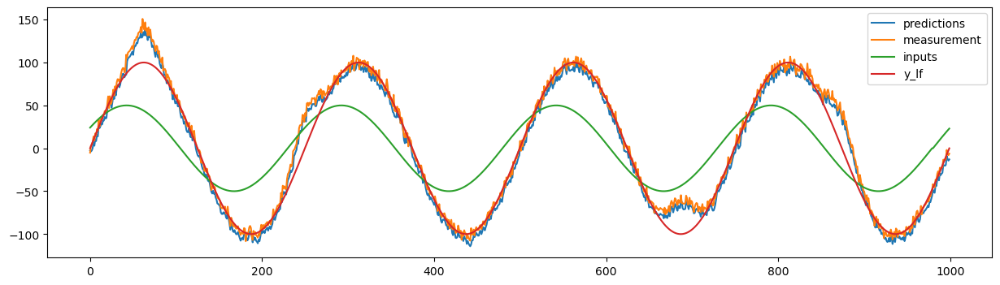

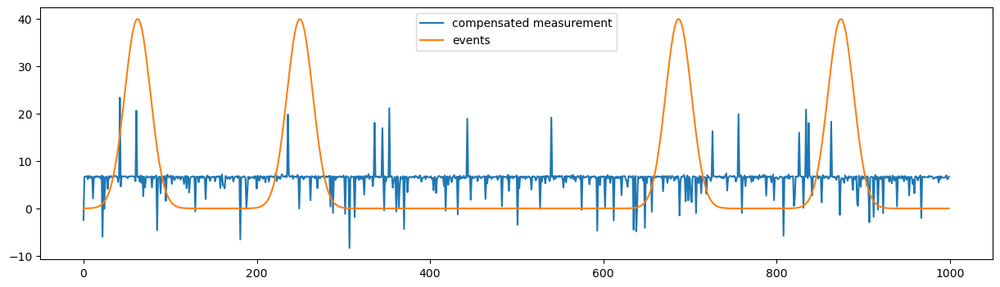

event_to_trend_amplitude: 0.2 , event_length_to_trend_period: 0.6 , time_shift: 0.005
optimal parameters: {'r_measurement_noise': 0.18918752577494014, 'q_process_noise_0': 0.5375043691384516, 'loc': 0.3277161648481221}
mse: 76.74362403081538


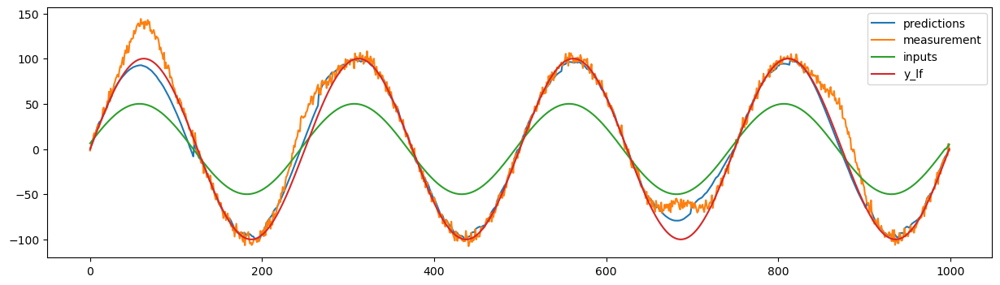

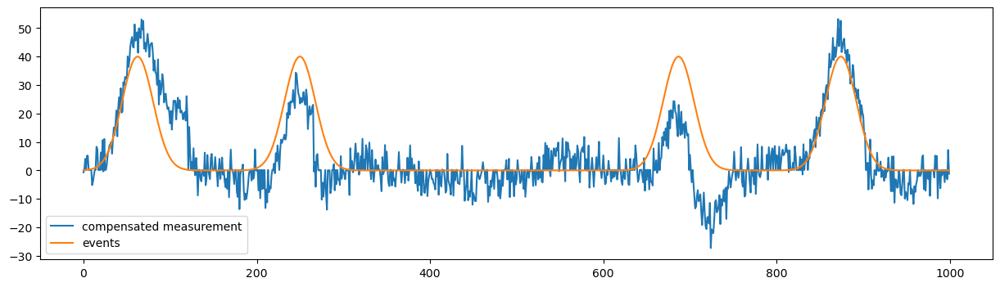

event_to_trend_amplitude: 0.2 , event_length_to_trend_period: 0.6 , time_shift: 0.01
optimal parameters: {'r_measurement_noise': 0.2113272396153487, 'q_process_noise_0': 0.8268622153193615, 'loc': 4.750697643889576}
mse: 147.18458707207722


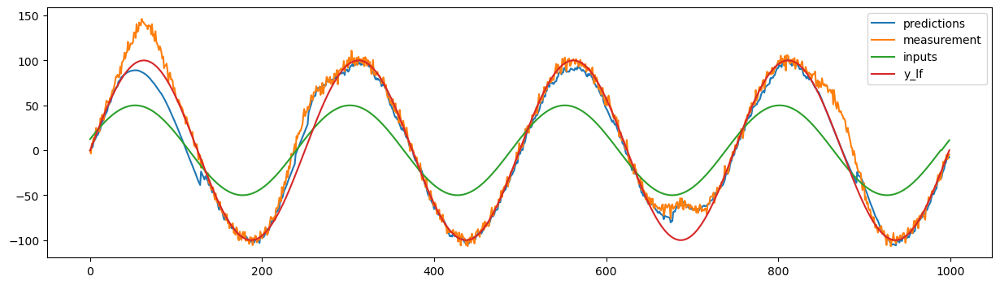

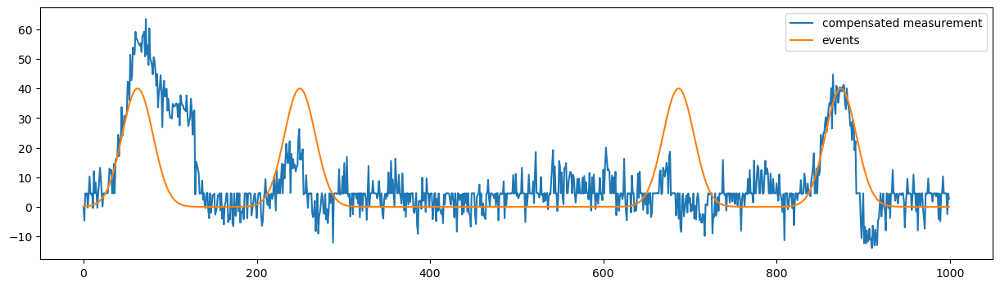

event_to_trend_amplitude: 0.2 , event_length_to_trend_period: 0.6 , time_shift: 0.015
optimal parameters: {'r_measurement_noise': 5.7521446679218124, 'q_process_noise_0': 3.0905333596117592, 'loc': 12.861368746962636}
mse: 163.40162770070543


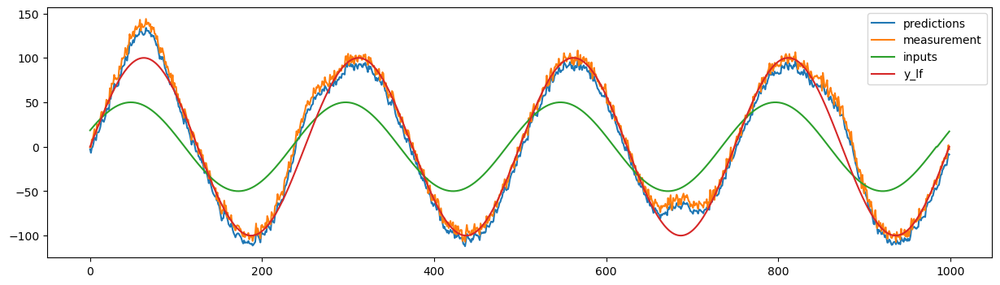

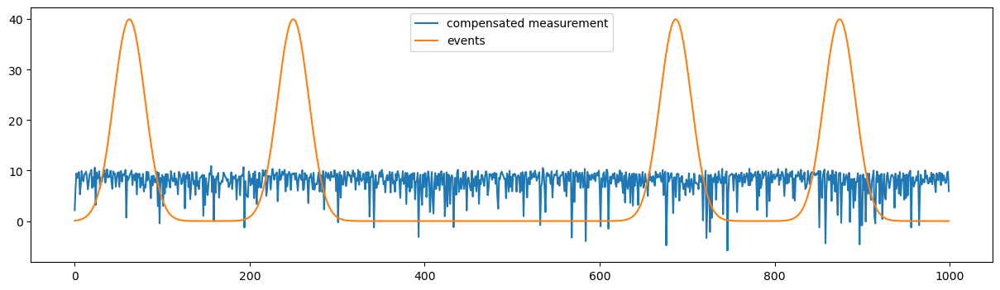

event_to_trend_amplitude: 0.2 , event_length_to_trend_period: 0.6 , time_shift: 0.02
optimal parameters: {'r_measurement_noise': 2.528190449724551, 'q_process_noise_0': 2.597939595592425, 'loc': 11.228751282051991}
mse: 164.11727719806618


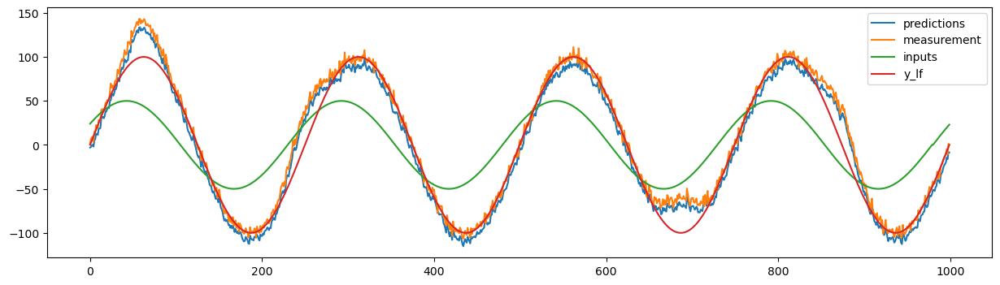

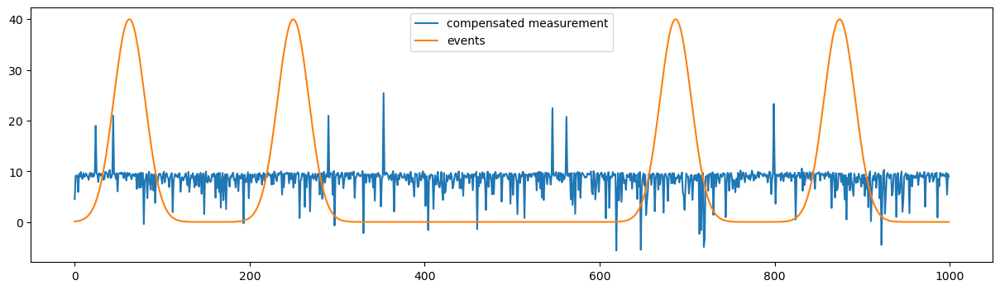

event_to_trend_amplitude: 0.30000000000000004 , event_length_to_trend_period: 0.1 , time_shift: 0.005
optimal parameters: {'r_measurement_noise': 0.18155376599138, 'q_process_noise_0': 0.7719948492522519, 'loc': 0.7233829126923181}
mse: 9.12398152974611


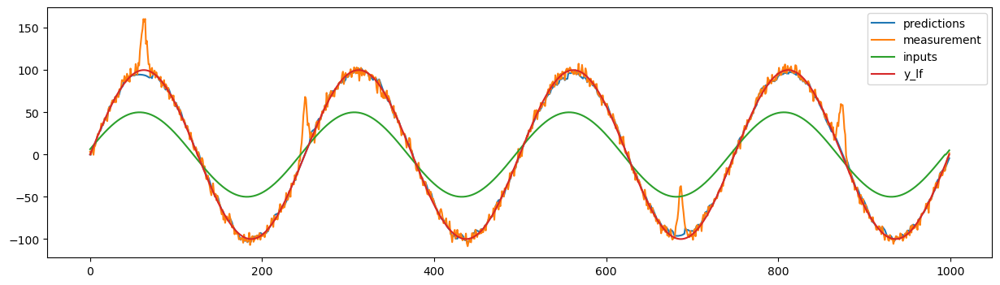

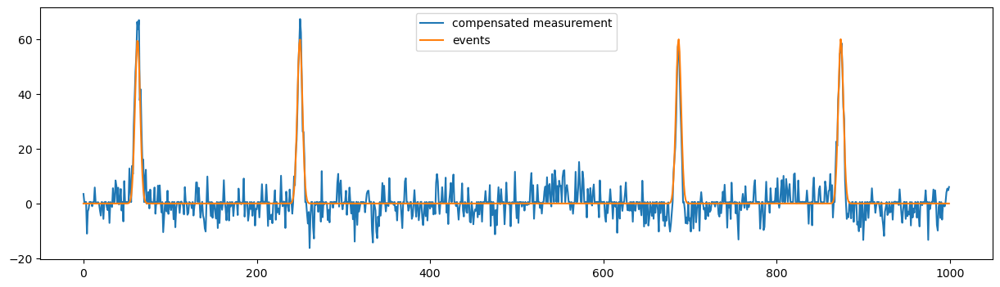

event_to_trend_amplitude: 0.30000000000000004 , event_length_to_trend_period: 0.1 , time_shift: 0.01
optimal parameters: {'r_measurement_noise': 0.37839442062875117, 'q_process_noise_0': 0.8156700839840499, 'loc': 1.265288695190669}
mse: 11.633577511097108


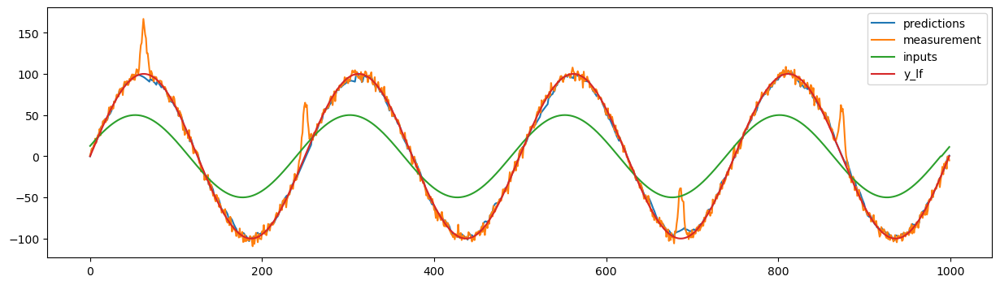

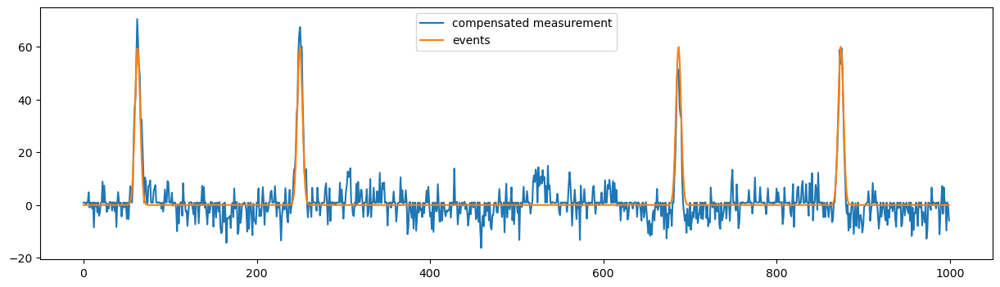

event_to_trend_amplitude: 0.30000000000000004 , event_length_to_trend_period: 0.1 , time_shift: 0.015
optimal parameters: {'r_measurement_noise': 0.20993403261875704, 'q_process_noise_0': 1.483678616765161, 'loc': 0.7241939804760096}
mse: 26.167328502116426


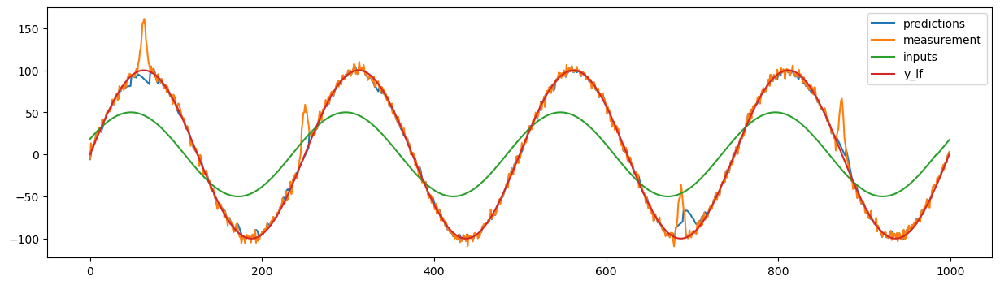

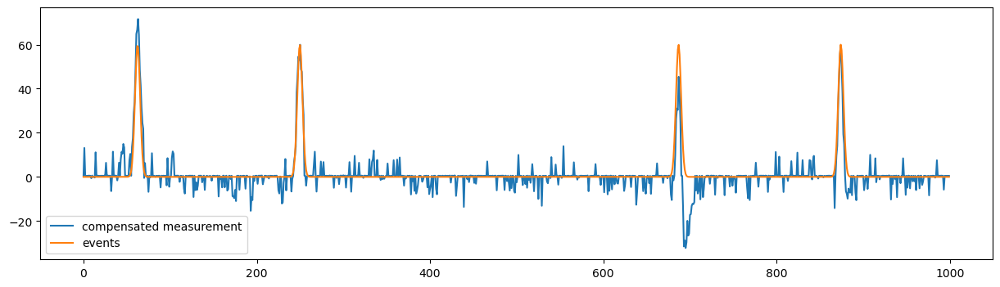

event_to_trend_amplitude: 0.30000000000000004 , event_length_to_trend_period: 0.1 , time_shift: 0.02
optimal parameters: {'r_measurement_noise': 0.20092034232686062, 'q_process_noise_0': 1.4322906800930482, 'loc': 1.0621731422066092}
mse: 18.09517213032557


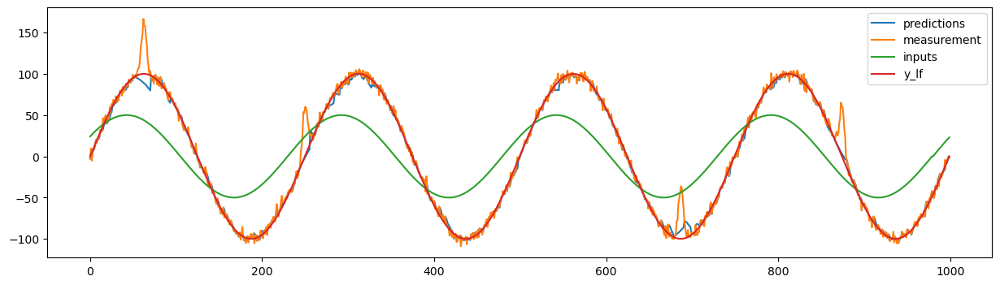

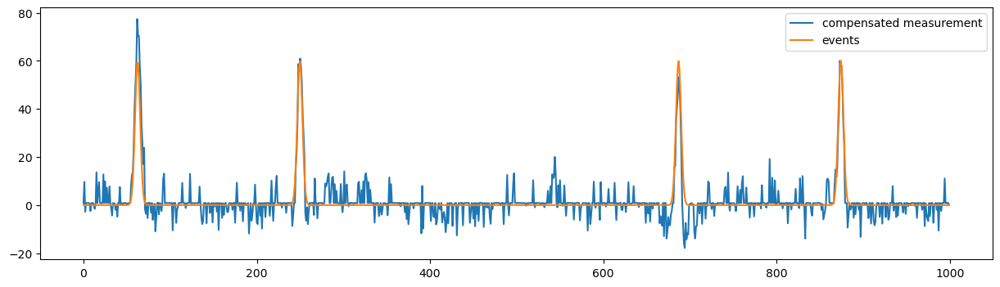

event_to_trend_amplitude: 0.30000000000000004 , event_length_to_trend_period: 0.2 , time_shift: 0.005
optimal parameters: {'r_measurement_noise': 0.13291212628124838, 'q_process_noise_0': 0.7817375862191877, 'loc': 2.202338593158266}
mse: 12.141954017549116


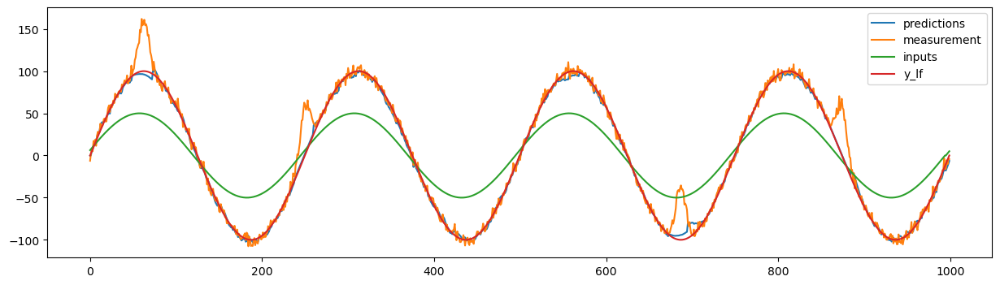

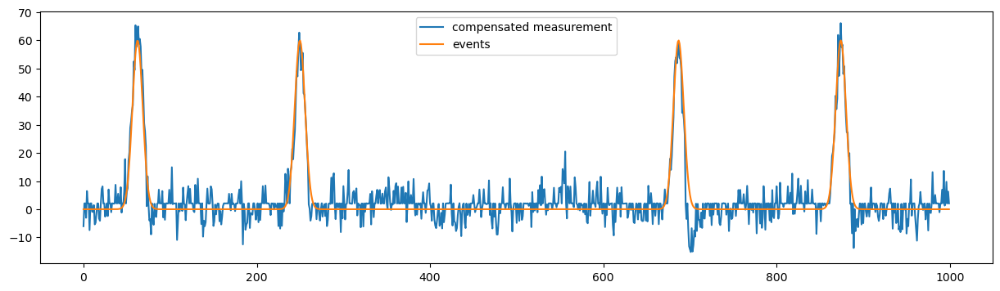

event_to_trend_amplitude: 0.30000000000000004 , event_length_to_trend_period: 0.2 , time_shift: 0.01
optimal parameters: {'r_measurement_noise': 0.2021825471088439, 'q_process_noise_0': 1.0652976517885409, 'loc': 2.0372040973223706}
mse: 35.397983328705315


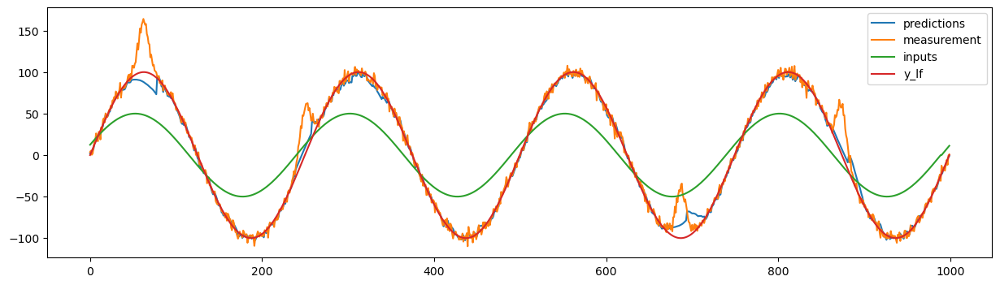

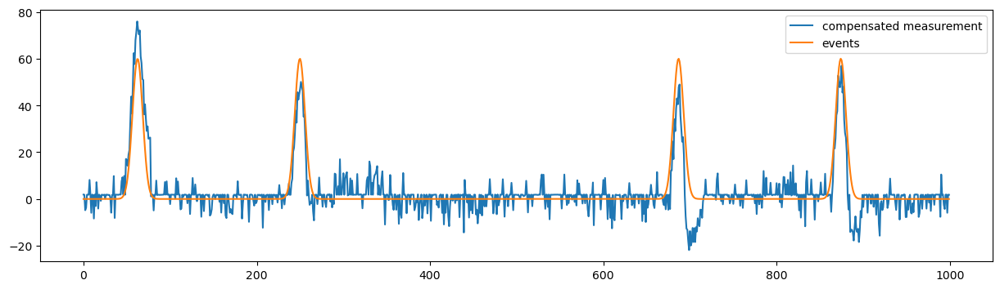

event_to_trend_amplitude: 0.30000000000000004 , event_length_to_trend_period: 0.2 , time_shift: 0.015
optimal parameters: {'r_measurement_noise': 0.10052963128678107, 'q_process_noise_0': 1.358685158671298, 'loc': 0.12706184711044735}
mse: 44.98584043595415


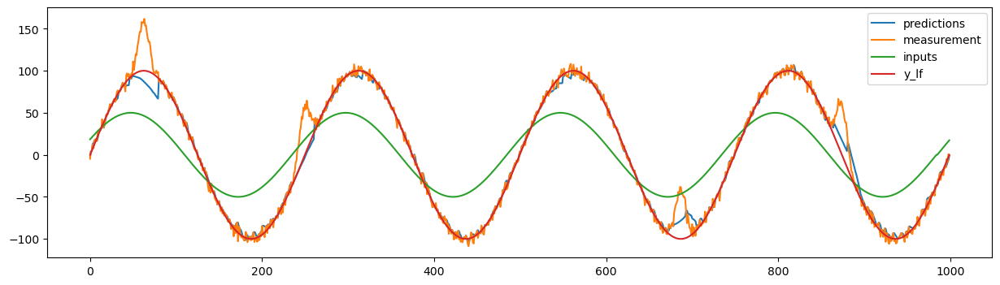

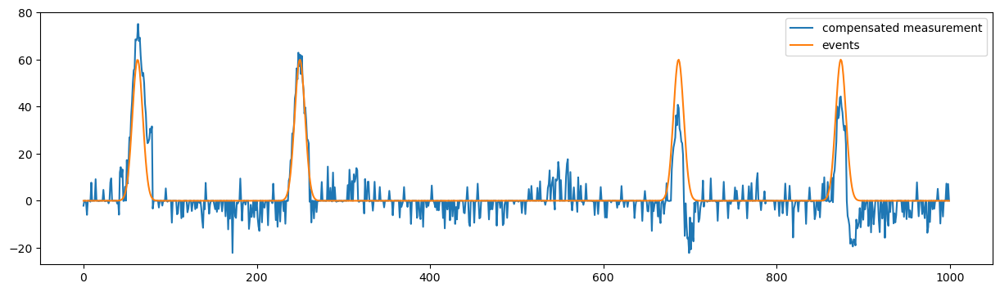

event_to_trend_amplitude: 0.30000000000000004 , event_length_to_trend_period: 0.2 , time_shift: 0.02
optimal parameters: {'r_measurement_noise': 0.14216775468168866, 'q_process_noise_0': 1.5569522825158588, 'loc': 0.6115637391588222}
mse: 66.09015544809593


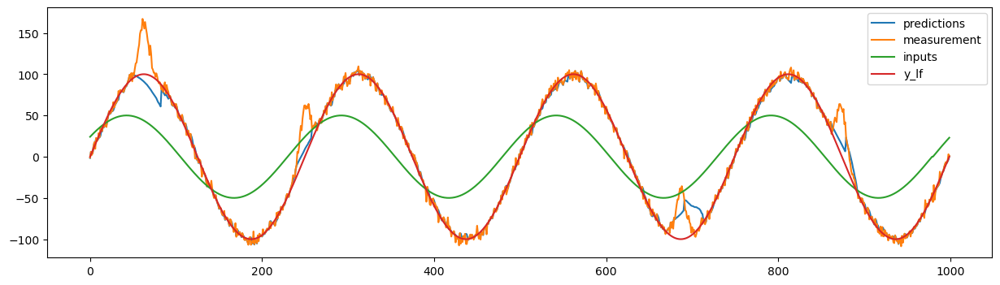

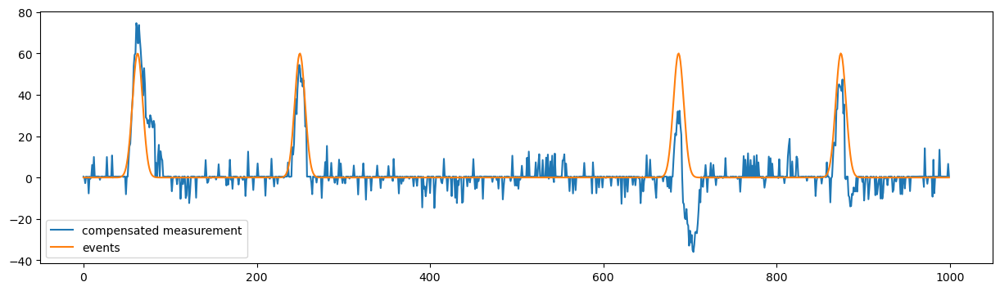

event_to_trend_amplitude: 0.30000000000000004 , event_length_to_trend_period: 0.30000000000000004 , time_shift: 0.005
optimal parameters: {'r_measurement_noise': 0.8579667854034121, 'q_process_noise_0': 0.6906840249821253, 'loc': 3.2937245495934535}
mse: 33.919140443937444


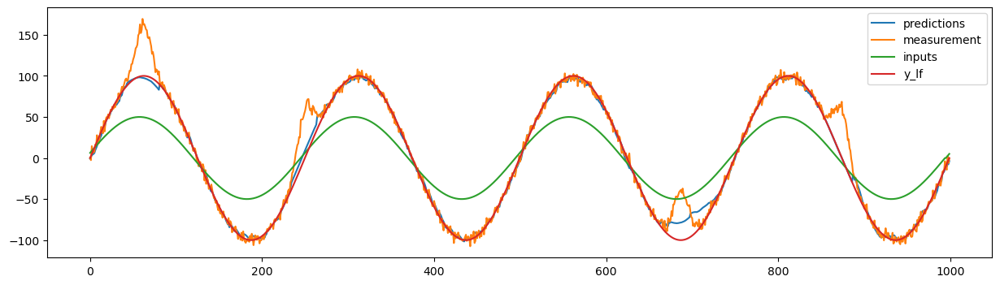

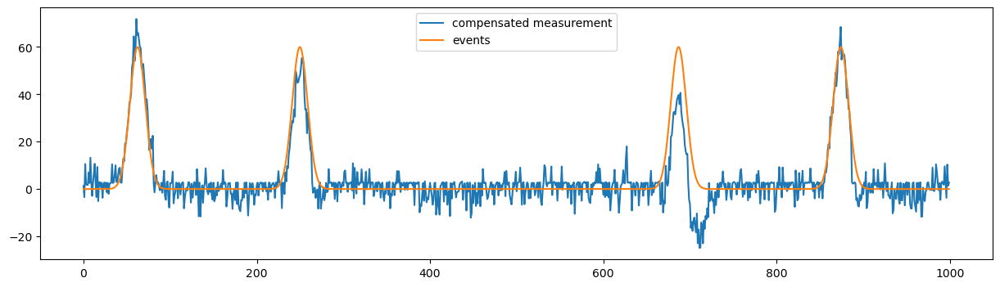

event_to_trend_amplitude: 0.30000000000000004 , event_length_to_trend_period: 0.30000000000000004 , time_shift: 0.01
optimal parameters: {'r_measurement_noise': 0.2942354769941982, 'q_process_noise_0': 1.2301469119660184, 'loc': 2.987971686849719}
mse: 137.98290582537425


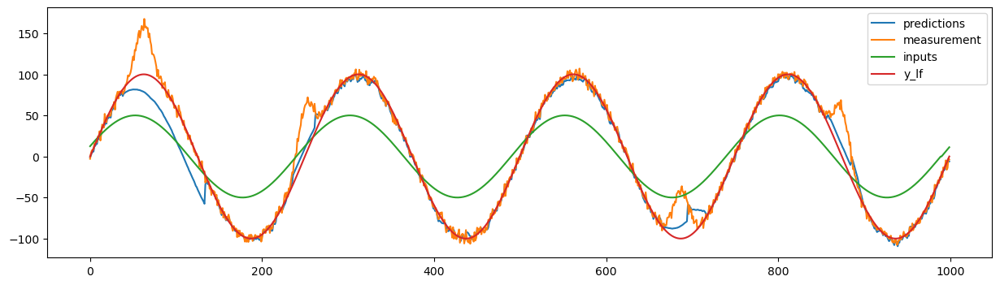

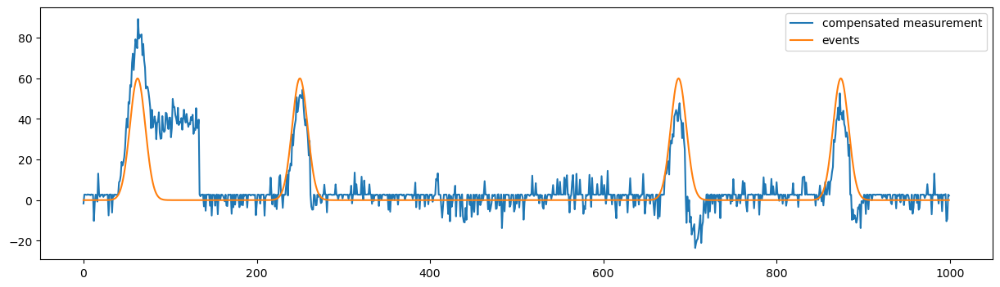

event_to_trend_amplitude: 0.30000000000000004 , event_length_to_trend_period: 0.30000000000000004 , time_shift: 0.015
optimal parameters: {'r_measurement_noise': 0.11757174424126256, 'q_process_noise_0': 1.8629592192173854, 'loc': 3.7950006038815625}
mse: 79.60943942216929


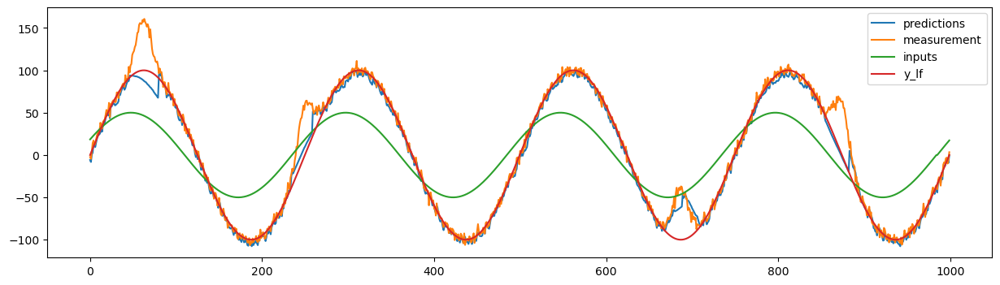

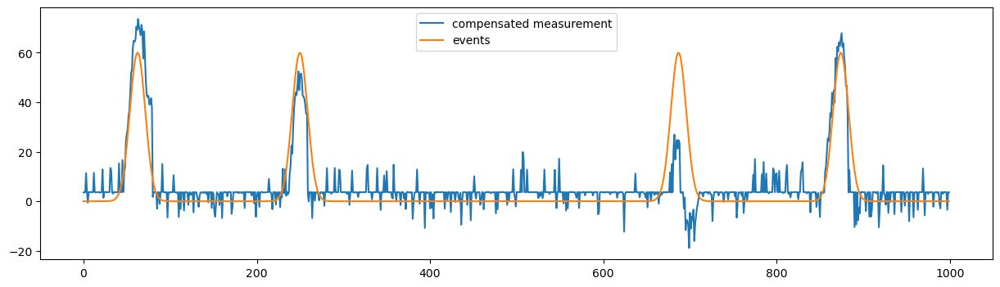

event_to_trend_amplitude: 0.30000000000000004 , event_length_to_trend_period: 0.30000000000000004 , time_shift: 0.02
optimal parameters: {'r_measurement_noise': 0.5326518071550119, 'q_process_noise_0': 1.5268960917222274, 'loc': 1.3640136565261145}
mse: 121.93729422768182


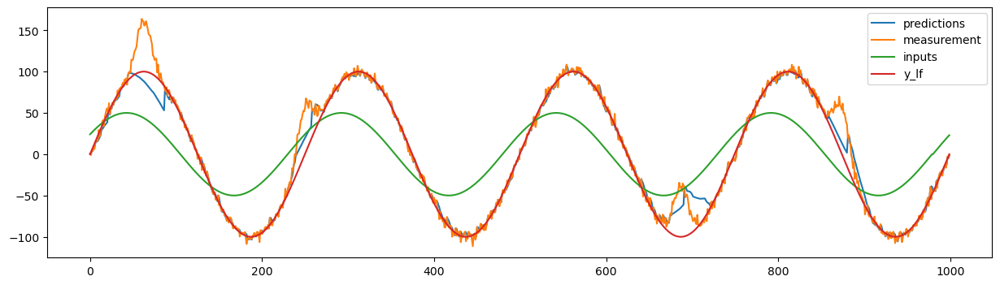

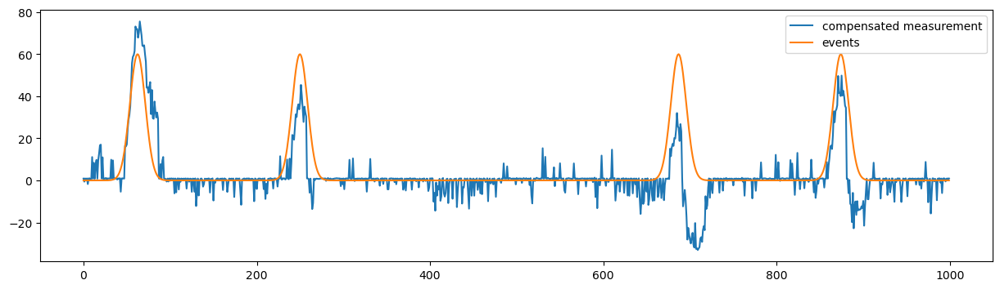

event_to_trend_amplitude: 0.30000000000000004 , event_length_to_trend_period: 0.4 , time_shift: 0.005
optimal parameters: {'r_measurement_noise': 0.5047763547556078, 'q_process_noise_0': 0.7920651678441166, 'loc': 4.235353496874288}
mse: 38.27532527776888


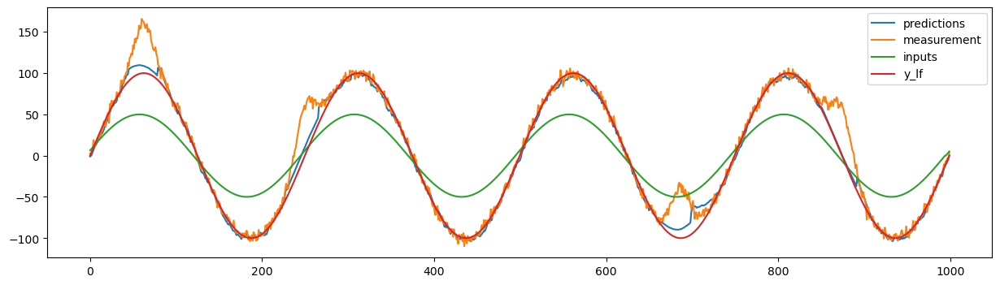

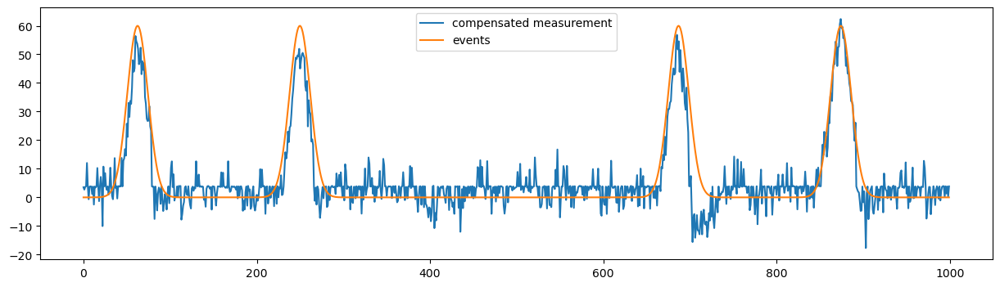

event_to_trend_amplitude: 0.30000000000000004 , event_length_to_trend_period: 0.4 , time_shift: 0.01
optimal parameters: {'r_measurement_noise': 0.20342502346068286, 'q_process_noise_0': 1.2718485182677264, 'loc': 2.1835672578425807}
mse: 78.29444858614461


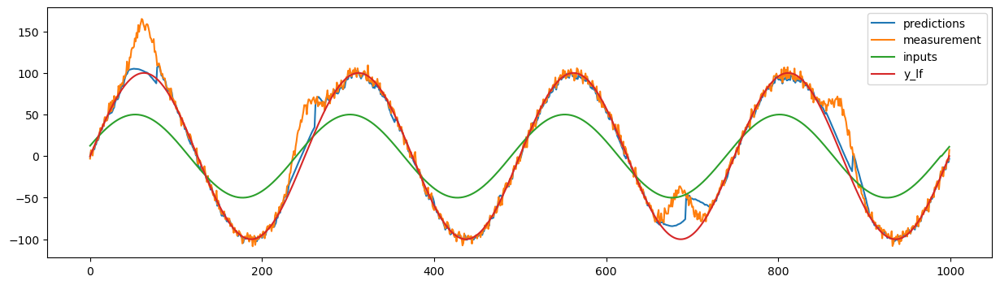

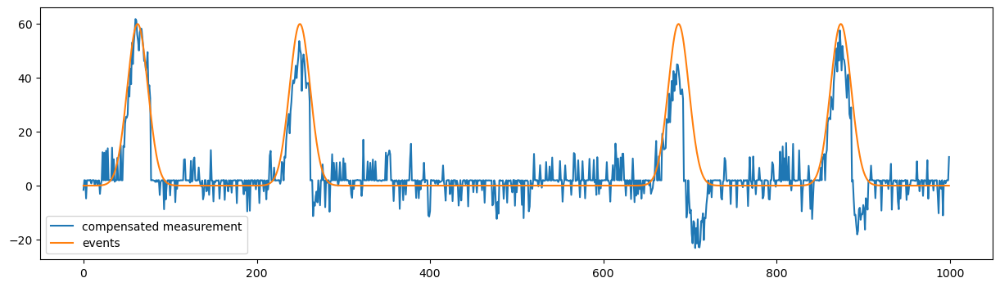

event_to_trend_amplitude: 0.30000000000000004 , event_length_to_trend_period: 0.4 , time_shift: 0.015
optimal parameters: {'r_measurement_noise': 0.176911723147383, 'q_process_noise_0': 1.429959490323771, 'loc': 2.6724201910440257}
mse: 222.74264578948137


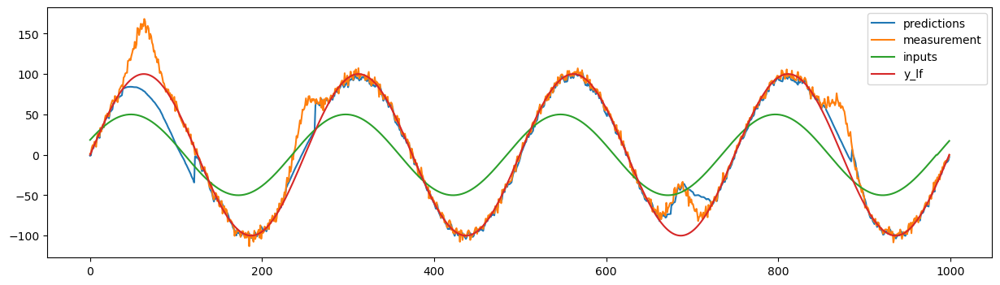

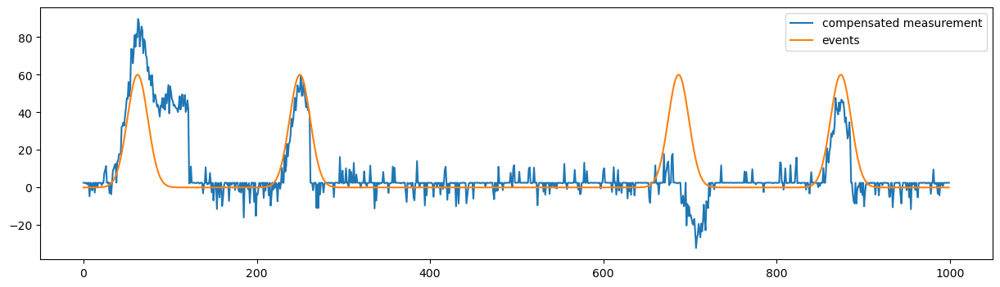

event_to_trend_amplitude: 0.30000000000000004 , event_length_to_trend_period: 0.4 , time_shift: 0.02
optimal parameters: {'r_measurement_noise': 0.5183432571380694, 'q_process_noise_0': 1.6289649760508265, 'loc': 4.9953248061124755}
mse: 136.78299913637974


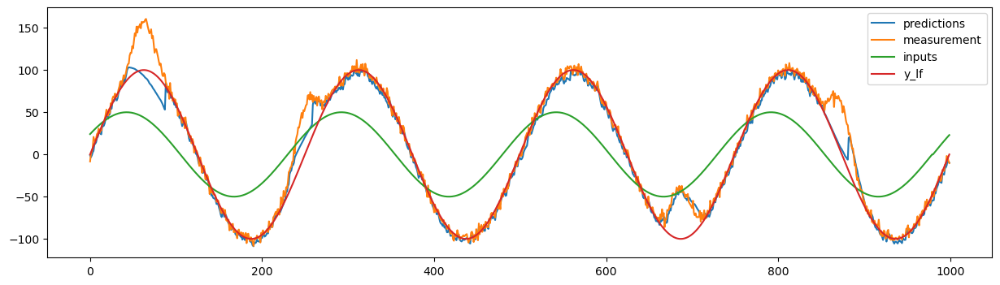

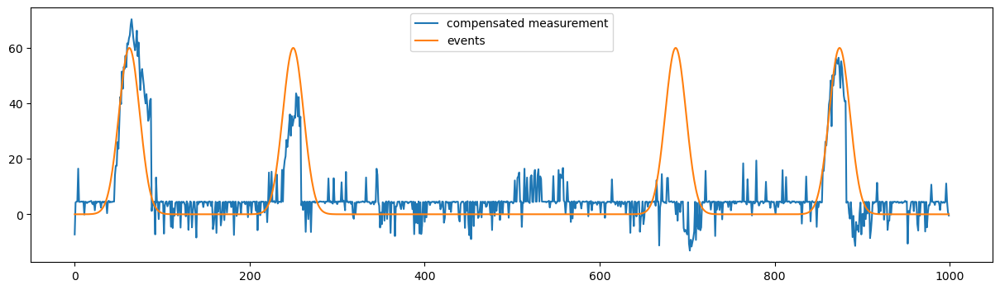

event_to_trend_amplitude: 0.30000000000000004 , event_length_to_trend_period: 0.5 , time_shift: 0.005
optimal parameters: {'r_measurement_noise': 0.37651773982877285, 'q_process_noise_0': 0.44765034509457935, 'loc': 2.6709883095852454}
mse: 56.01568979641427


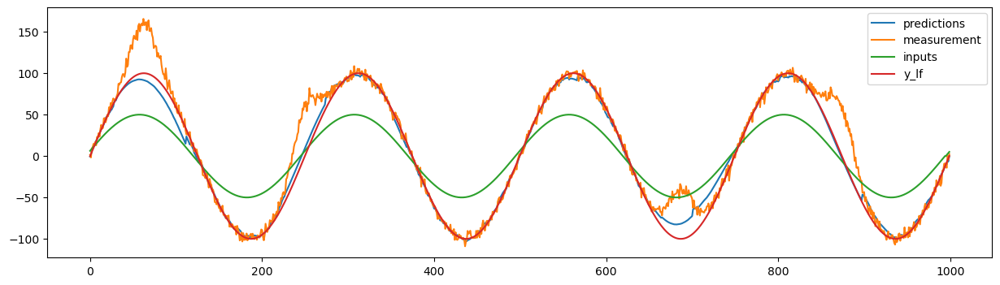

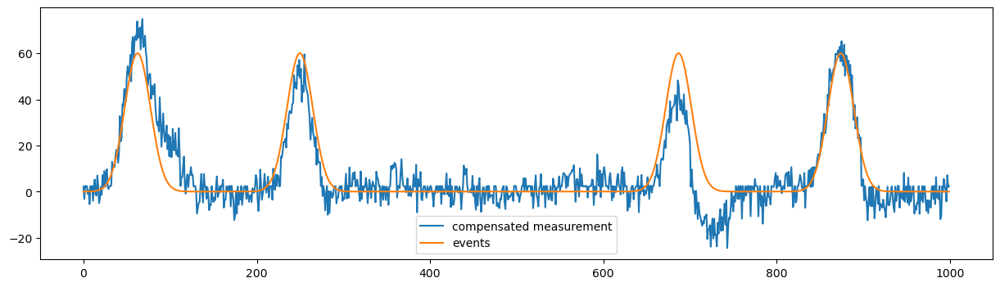

event_to_trend_amplitude: 0.30000000000000004 , event_length_to_trend_period: 0.5 , time_shift: 0.01
optimal parameters: {'r_measurement_noise': 0.11880318606751722, 'q_process_noise_0': 1.080184505652037, 'loc': 1.7689075419375728}
mse: 184.87976356910983


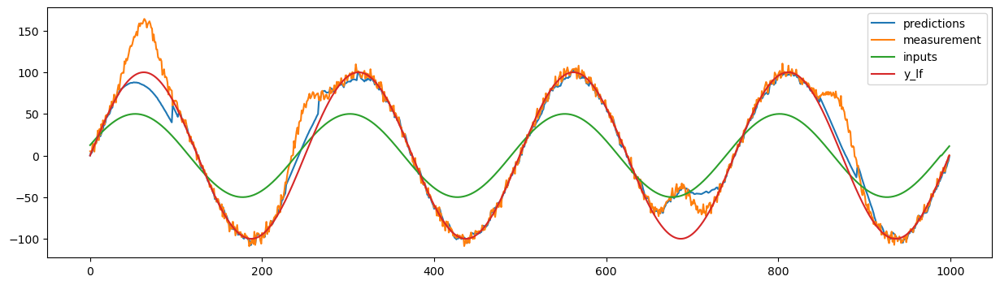

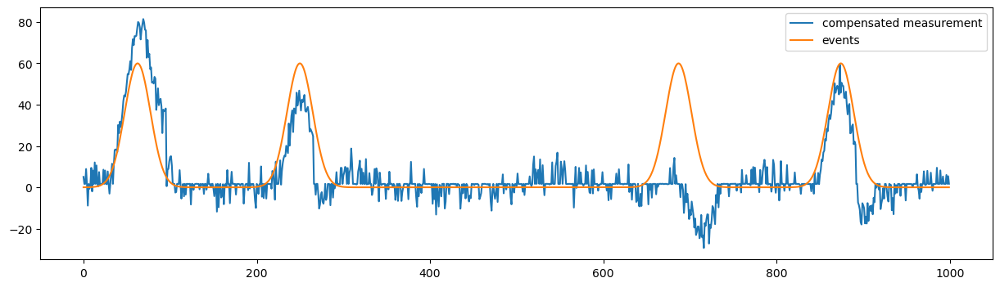

event_to_trend_amplitude: 0.30000000000000004 , event_length_to_trend_period: 0.5 , time_shift: 0.015
optimal parameters: {'r_measurement_noise': 0.24394347464119934, 'q_process_noise_0': 2.7851584836436873, 'loc': 9.148197667452045}
mse: 317.48491072349043


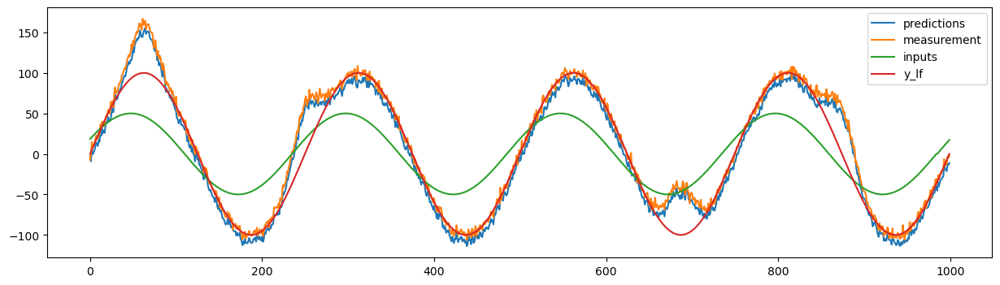

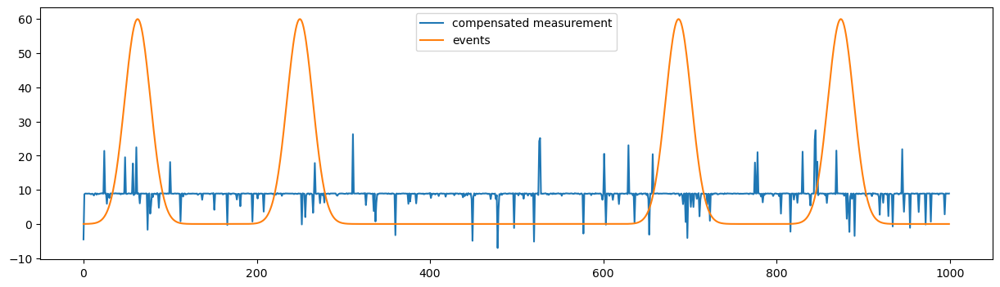

event_to_trend_amplitude: 0.30000000000000004 , event_length_to_trend_period: 0.5 , time_shift: 0.02
optimal parameters: {'r_measurement_noise': 3.199183467113358, 'q_process_noise_0': 1.6727894415575575, 'loc': 15.212398642425063}
mse: 269.505194177084


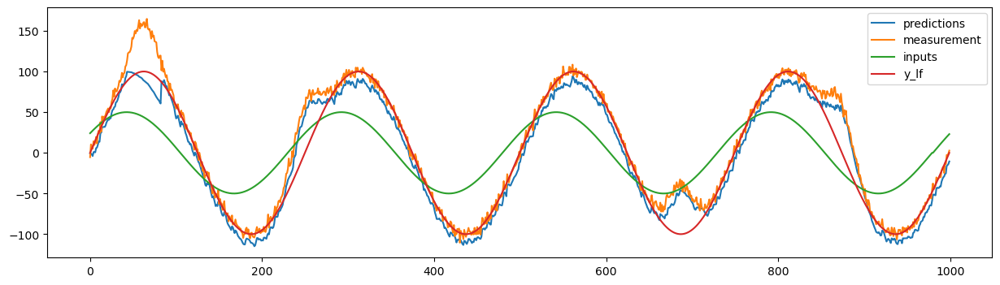

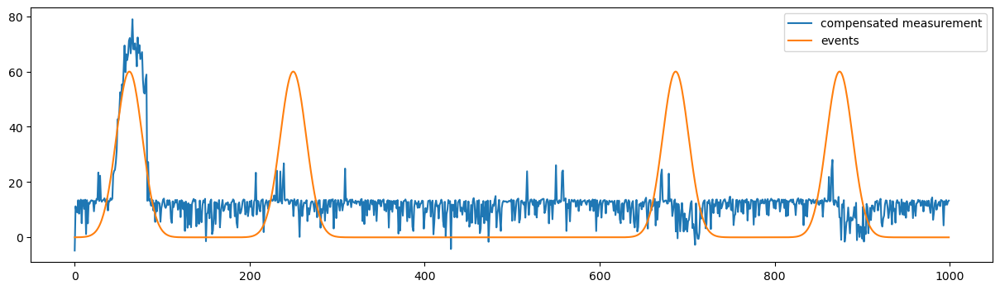

event_to_trend_amplitude: 0.30000000000000004 , event_length_to_trend_period: 0.6 , time_shift: 0.005
optimal parameters: {'r_measurement_noise': 0.15034059667854632, 'q_process_noise_0': 0.7840272521574115, 'loc': 2.340107173777381}
mse: 64.93158686127884


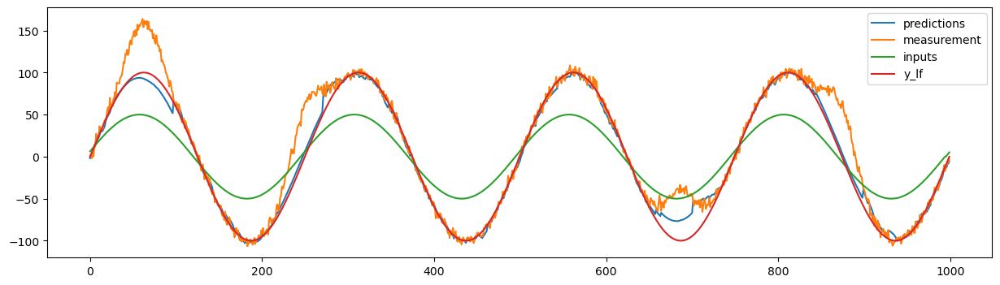

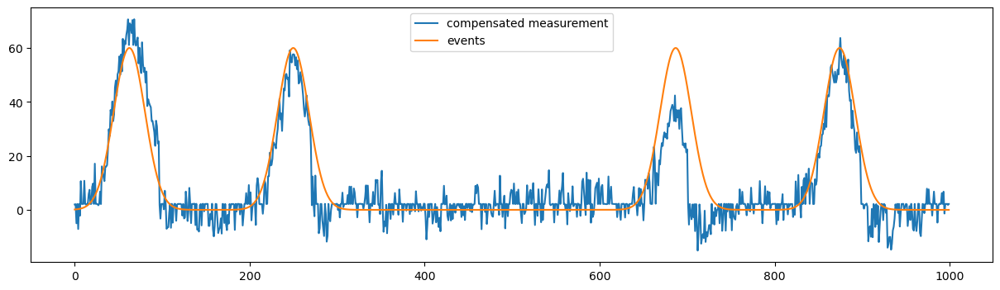

event_to_trend_amplitude: 0.30000000000000004 , event_length_to_trend_period: 0.6 , time_shift: 0.01
optimal parameters: {'r_measurement_noise': 0.26743045916993397, 'q_process_noise_0': 1.070855438762425, 'loc': 4.960708994705799}
mse: 189.1215256503266


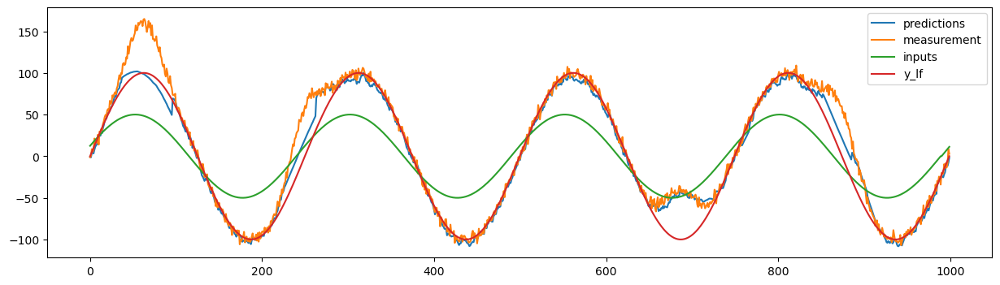

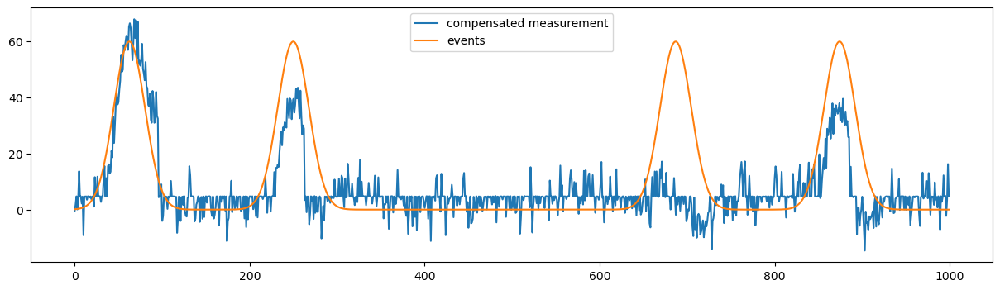

event_to_trend_amplitude: 0.30000000000000004 , event_length_to_trend_period: 0.6 , time_shift: 0.015
optimal parameters: {'r_measurement_noise': 0.10382800080394673, 'q_process_noise_0': 43.89886052583986, 'loc': 11.780680895890004}
mse: 356.11852052018037


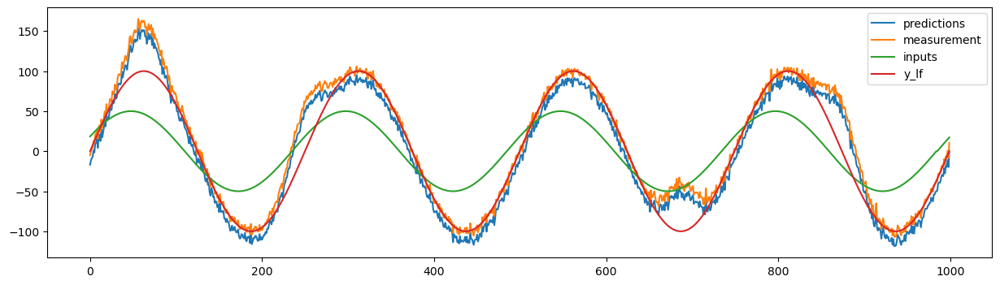

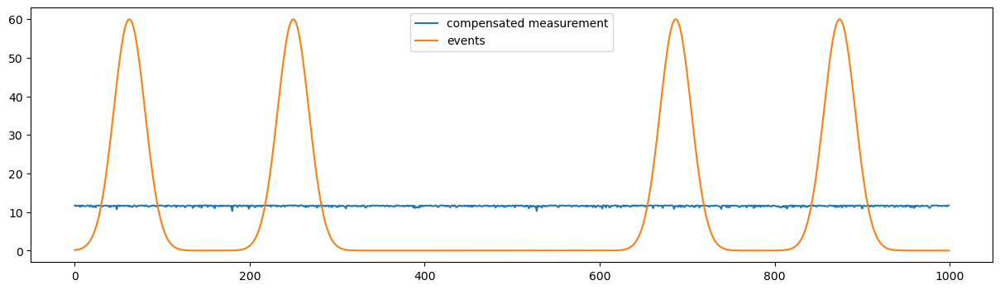

event_to_trend_amplitude: 0.30000000000000004 , event_length_to_trend_period: 0.6 , time_shift: 0.02
optimal parameters: {'r_measurement_noise': 19.987097806540202, 'q_process_noise_0': 14.991728936661515, 'loc': 26.000226759050513}
mse: 345.7891638139874


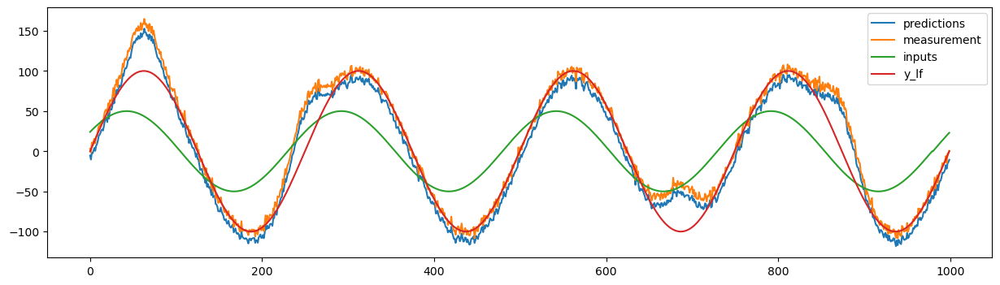

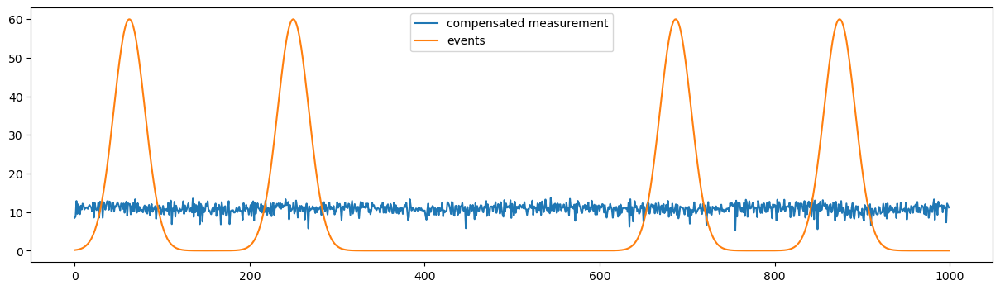

event_to_trend_amplitude: 0.4 , event_length_to_trend_period: 0.1 , time_shift: 0.005
optimal parameters: {'r_measurement_noise': 0.5882853352113793, 'q_process_noise_0': 0.615503065204477, 'loc': 2.299863698666797}
mse: 9.462229384817446


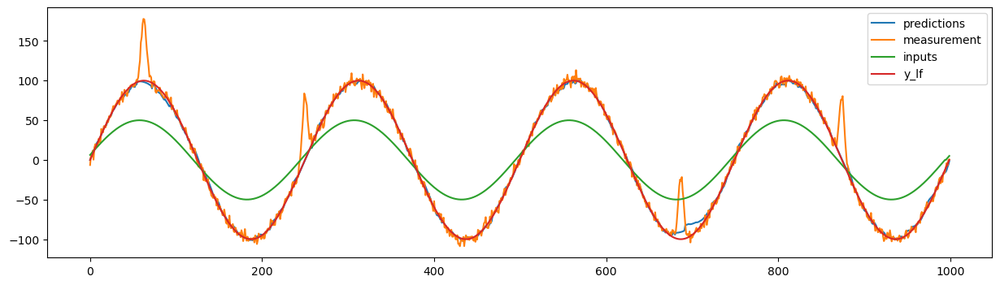

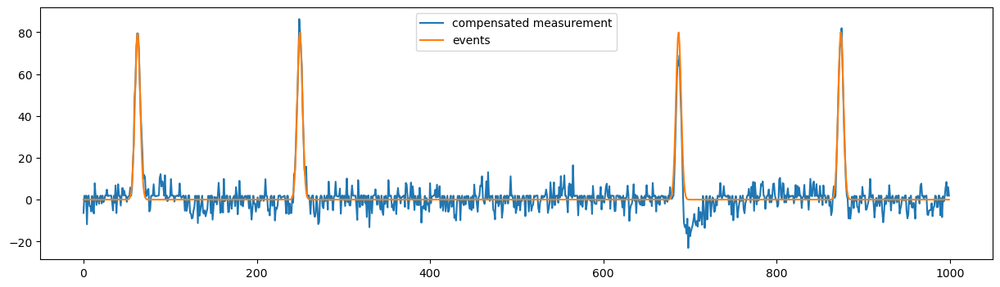

event_to_trend_amplitude: 0.4 , event_length_to_trend_period: 0.1 , time_shift: 0.01
optimal parameters: {'r_measurement_noise': 0.7246217665660041, 'q_process_noise_0': 0.7586641252936768, 'loc': 1.6691357115671541}
mse: 12.58117512071379


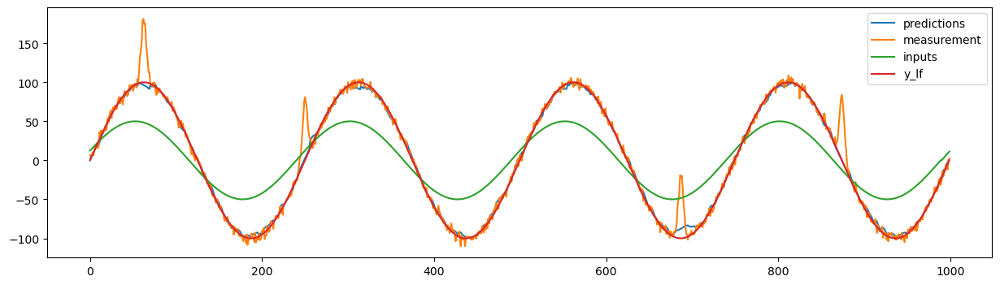

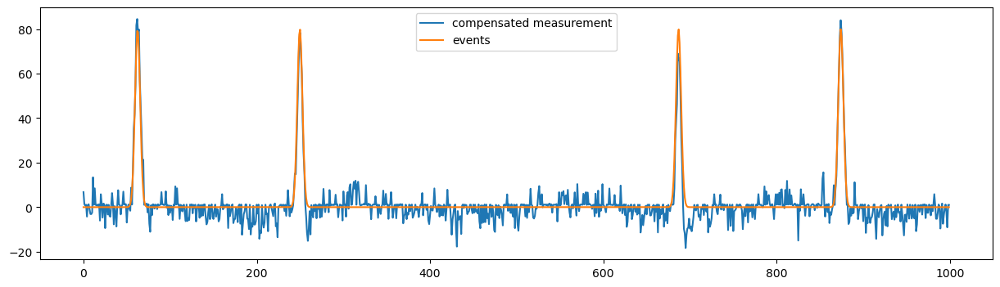

event_to_trend_amplitude: 0.4 , event_length_to_trend_period: 0.1 , time_shift: 0.015
optimal parameters: {'r_measurement_noise': 0.3974219960577246, 'q_process_noise_0': 1.0753311419051907, 'loc': 1.0055897229134998}
mse: 353.0983607340584


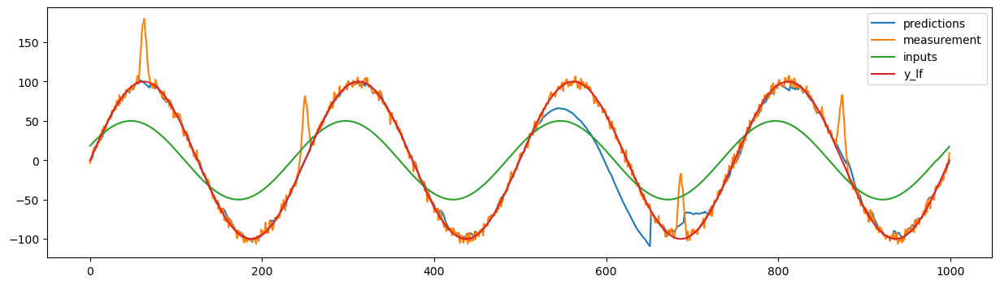

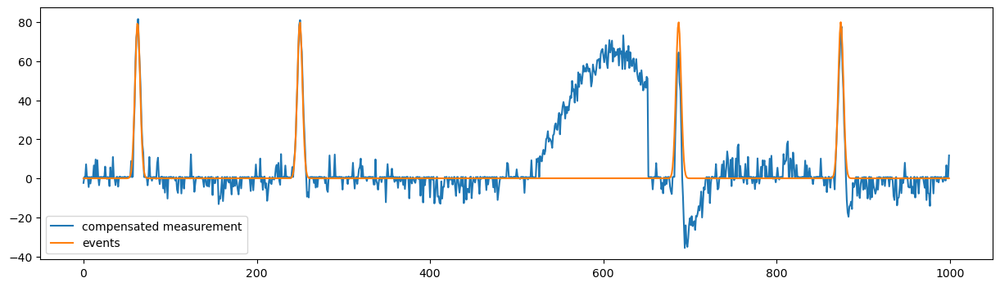

event_to_trend_amplitude: 0.4 , event_length_to_trend_period: 0.1 , time_shift: 0.02
optimal parameters: {'r_measurement_noise': 0.3595236211165817, 'q_process_noise_0': 1.683616049526595, 'loc': 1.0821467498539656}
mse: 49.01364509709343


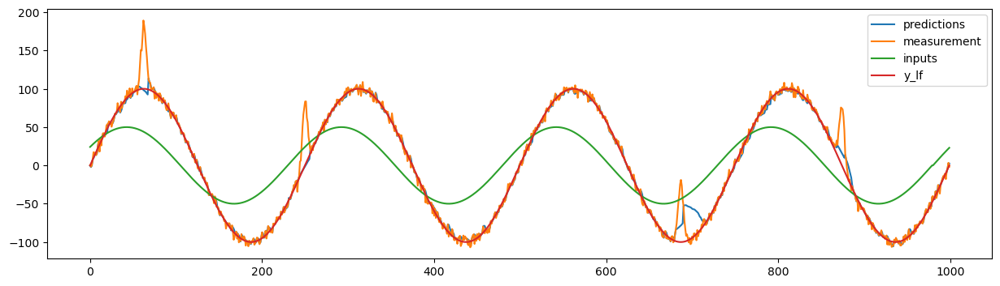

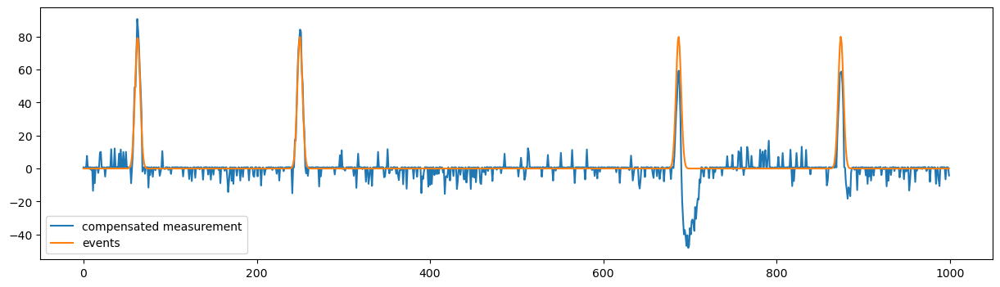

event_to_trend_amplitude: 0.4 , event_length_to_trend_period: 0.2 , time_shift: 0.005
optimal parameters: {'r_measurement_noise': 0.17386462706630113, 'q_process_noise_0': 0.7657649650335437, 'loc': 2.2976280568462832}
mse: 22.565975260972962


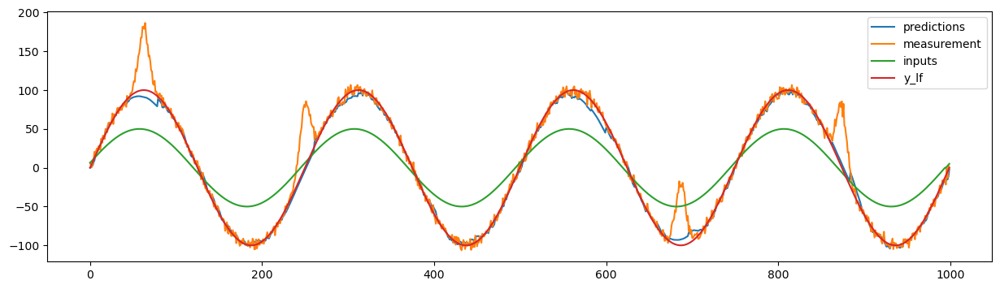

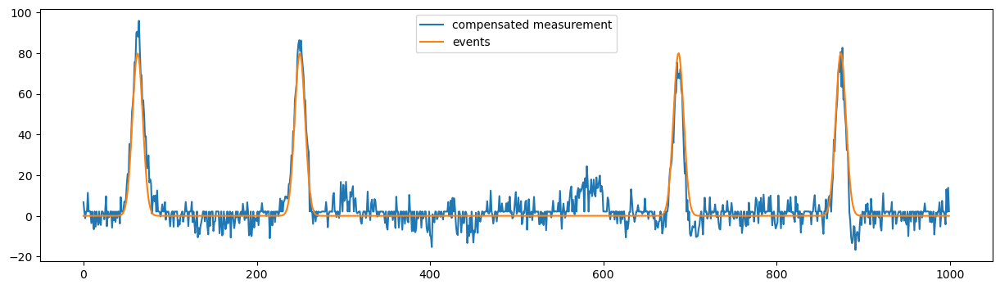

event_to_trend_amplitude: 0.4 , event_length_to_trend_period: 0.2 , time_shift: 0.01
optimal parameters: {'r_measurement_noise': 0.4760472593007058, 'q_process_noise_0': 1.1462647087410345, 'loc': 2.822511924034483}
mse: 26.171843330636747


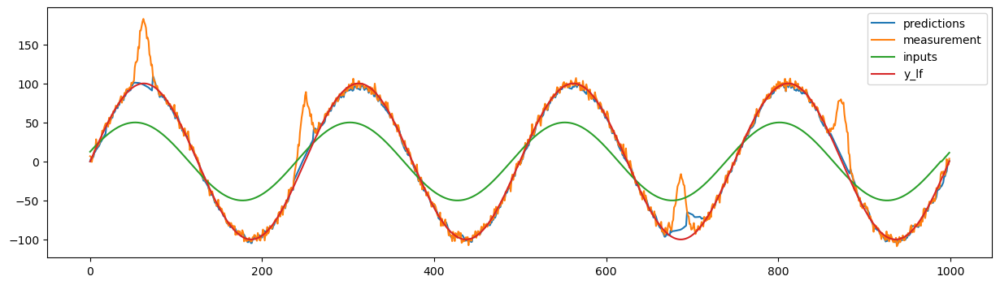

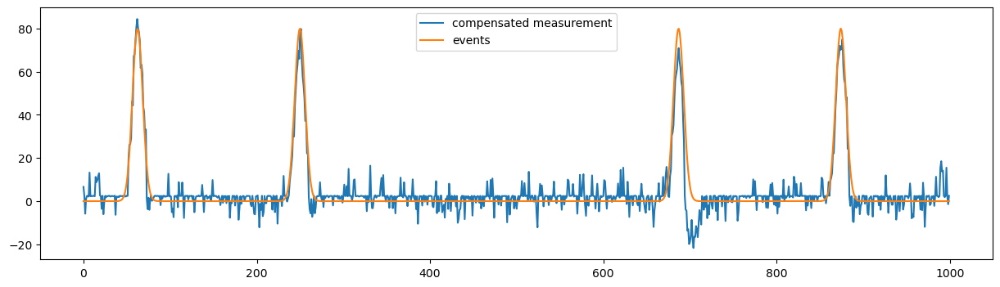

event_to_trend_amplitude: 0.4 , event_length_to_trend_period: 0.2 , time_shift: 0.015
optimal parameters: {'r_measurement_noise': 0.8765823301135509, 'q_process_noise_0': 1.4702609688932198, 'loc': 2.8597110905866034}
mse: 34.95254857038261


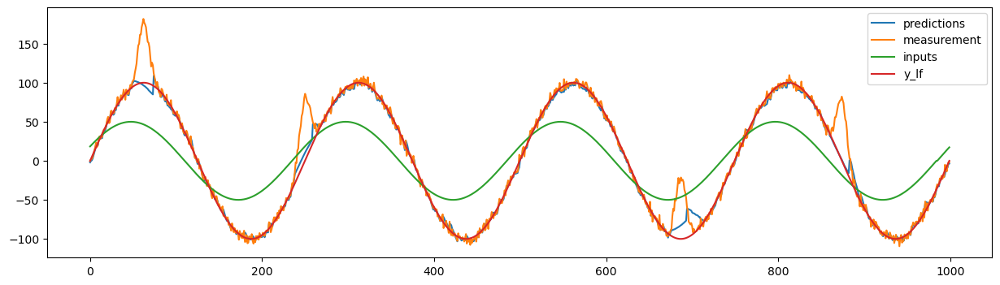

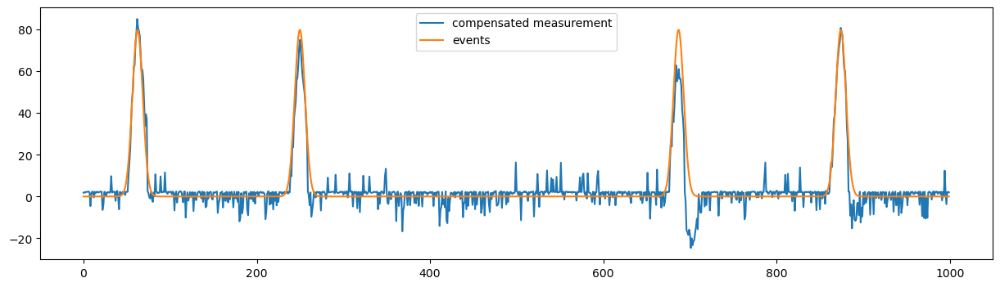

event_to_trend_amplitude: 0.4 , event_length_to_trend_period: 0.2 , time_shift: 0.02
optimal parameters: {'r_measurement_noise': 6.9013766687091955, 'q_process_noise_0': 1.9291662548388413, 'loc': 8.182821457665254}
mse: 211.794758366449


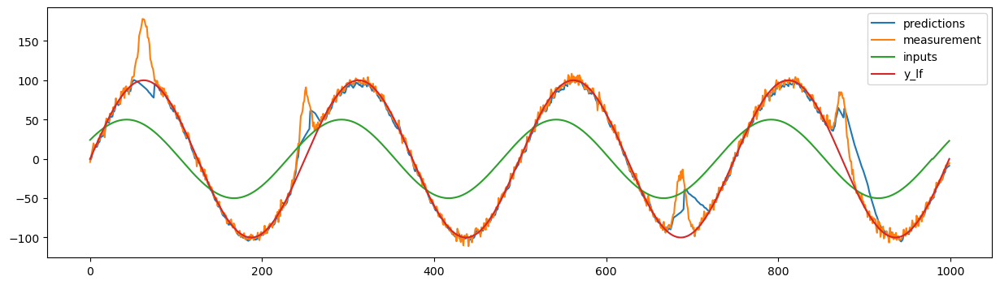

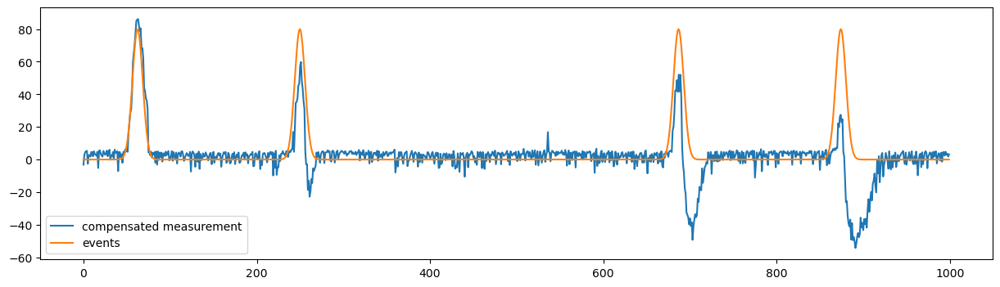

event_to_trend_amplitude: 0.4 , event_length_to_trend_period: 0.30000000000000004 , time_shift: 0.005
optimal parameters: {'r_measurement_noise': 0.18935086378974741, 'q_process_noise_0': 0.6015151472275411, 'loc': 0.2800802256449159}
mse: 30.172407798355984


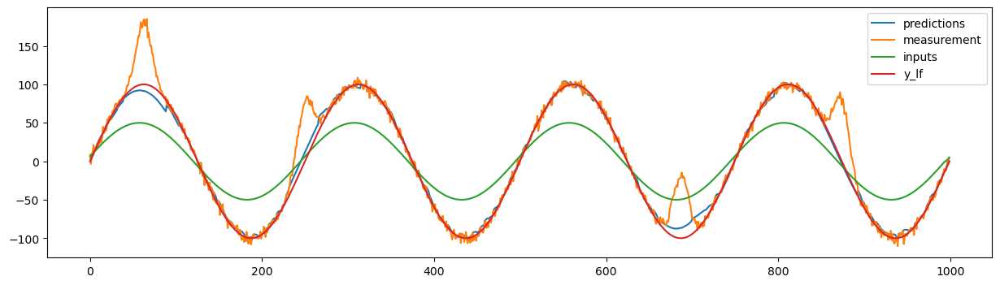

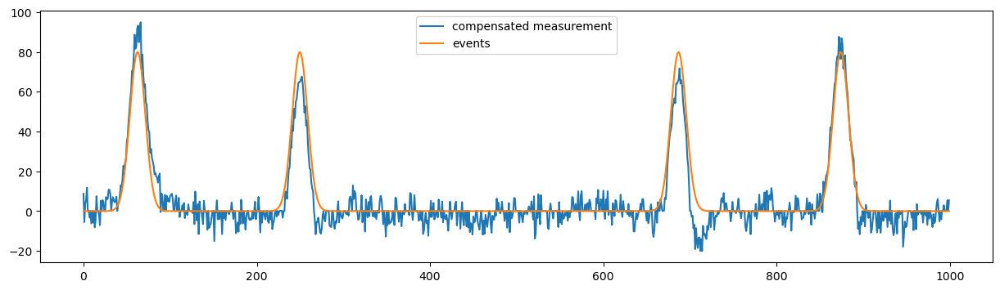

event_to_trend_amplitude: 0.4 , event_length_to_trend_period: 0.30000000000000004 , time_shift: 0.01
optimal parameters: {'r_measurement_noise': 1.7052921255474756, 'q_process_noise_0': 1.2158944502638944, 'loc': 3.944873243924001}
mse: 76.88325502848207


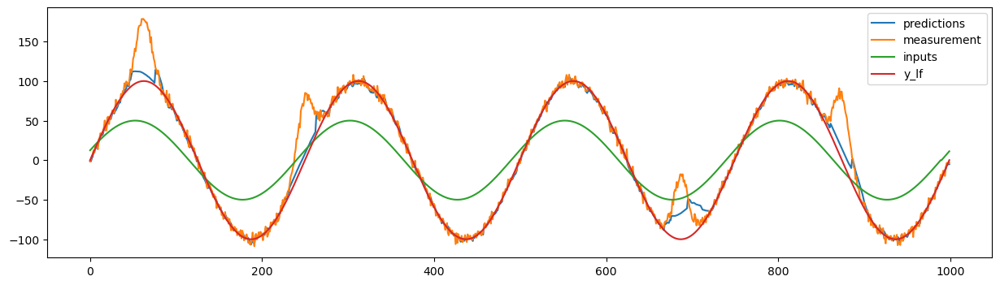

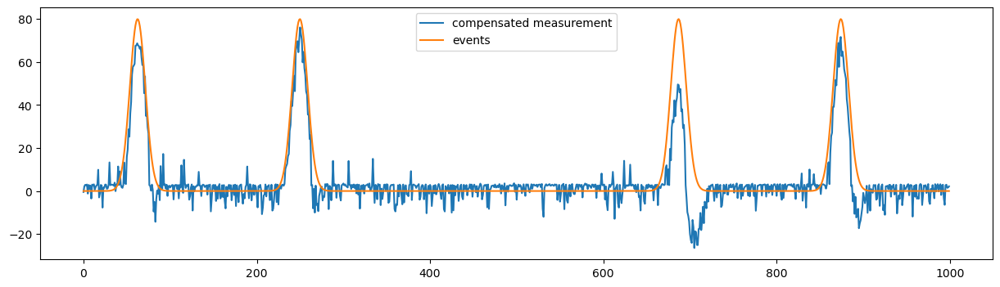

event_to_trend_amplitude: 0.4 , event_length_to_trend_period: 0.30000000000000004 , time_shift: 0.015
optimal parameters: {'r_measurement_noise': 0.3396178797017218, 'q_process_noise_0': 1.2790315852614795, 'loc': 0.12731769767288134}
mse: 139.737733259671


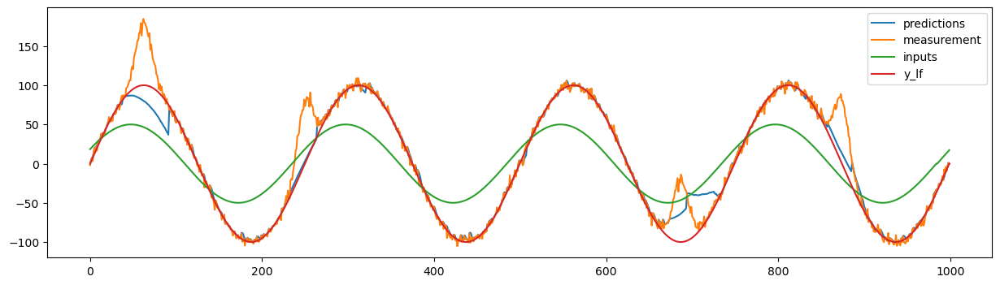

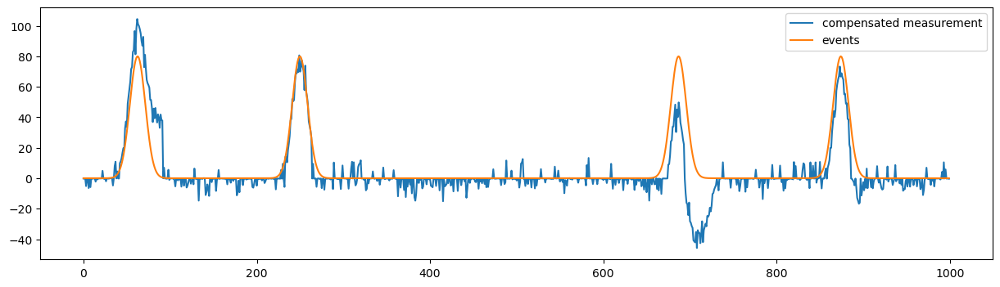

event_to_trend_amplitude: 0.4 , event_length_to_trend_period: 0.30000000000000004 , time_shift: 0.02
optimal parameters: {'r_measurement_noise': 0.18514124135098411, 'q_process_noise_0': 1.6507782517732819, 'loc': 3.0812581908867918}
mse: 148.9077101456242


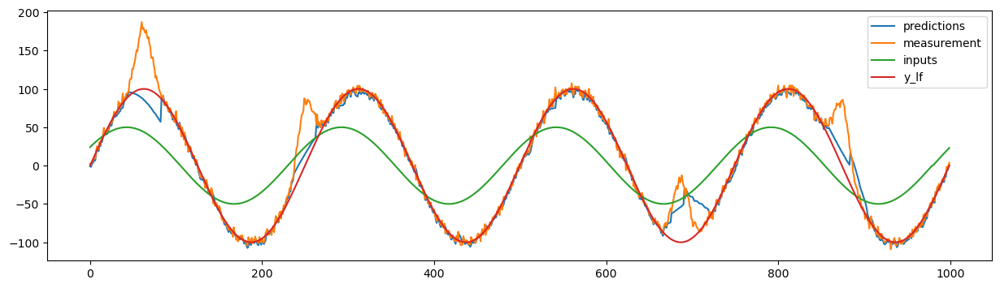

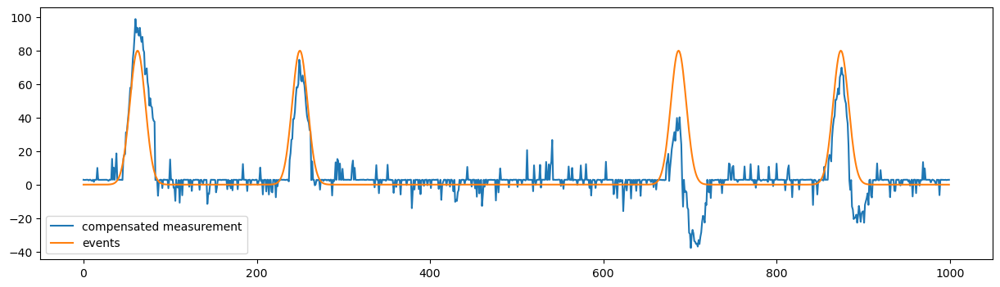

event_to_trend_amplitude: 0.4 , event_length_to_trend_period: 0.4 , time_shift: 0.005
optimal parameters: {'r_measurement_noise': 0.2553436078341195, 'q_process_noise_0': 0.8865868498354555, 'loc': 0.5753568872424842}
mse: 45.54219200835417


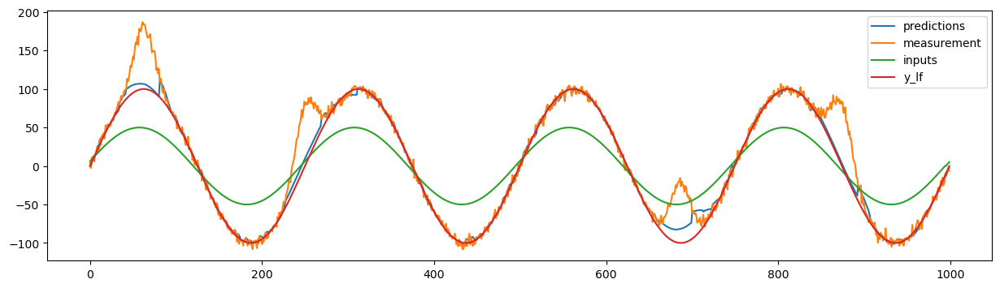

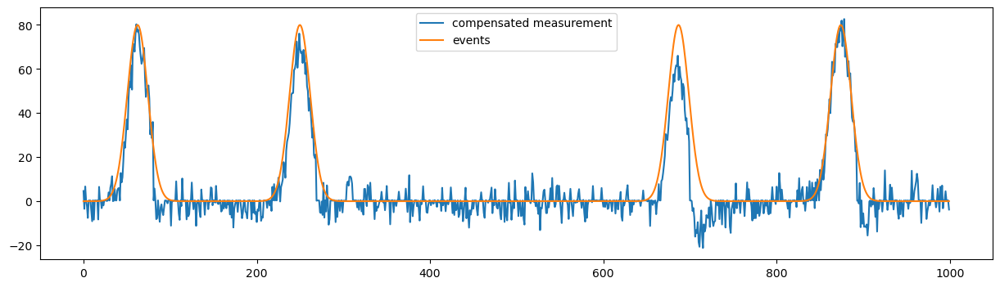

event_to_trend_amplitude: 0.4 , event_length_to_trend_period: 0.4 , time_shift: 0.01
optimal parameters: {'r_measurement_noise': 1.3823118955102576, 'q_process_noise_0': 1.0377441819700532, 'loc': 6.114608709738727}
mse: 225.41683047071797


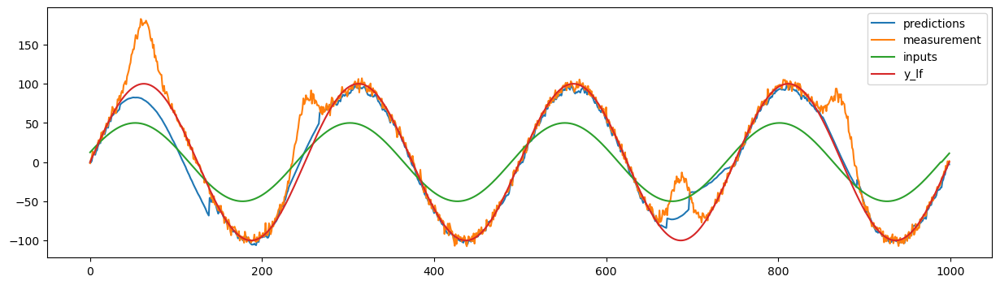

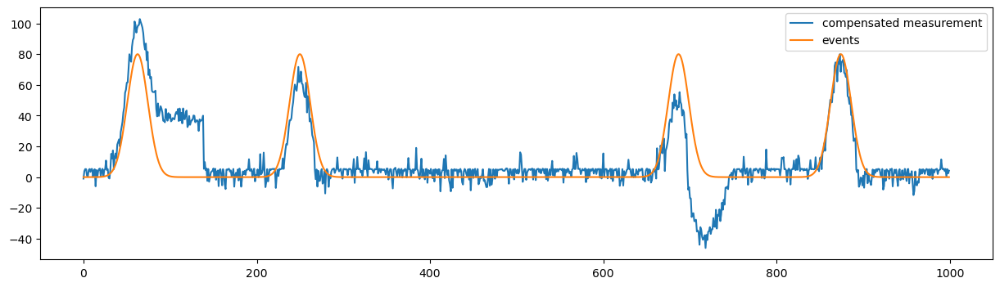

event_to_trend_amplitude: 0.4 , event_length_to_trend_period: 0.4 , time_shift: 0.015
optimal parameters: {'r_measurement_noise': 0.6182382799434974, 'q_process_noise_0': 1.4303372357099482, 'loc': 3.8248248889079144}
mse: 209.2970001410746


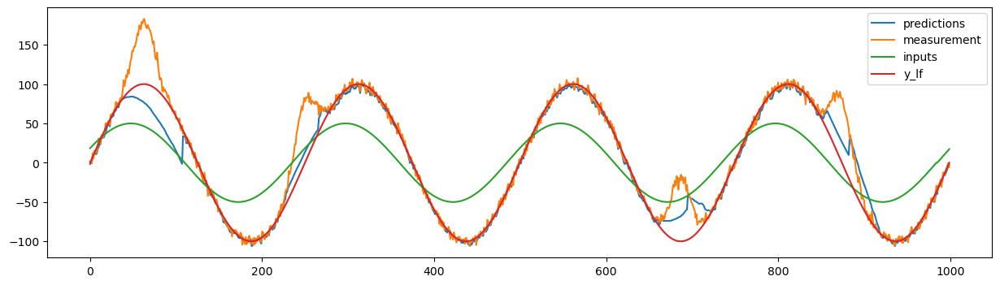

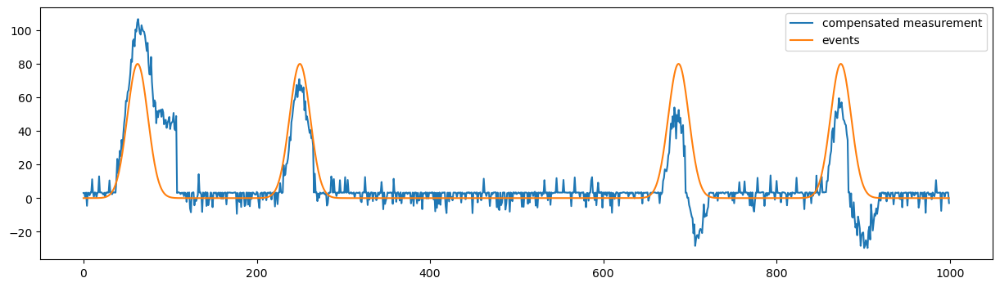

event_to_trend_amplitude: 0.4 , event_length_to_trend_period: 0.4 , time_shift: 0.02
optimal parameters: {'r_measurement_noise': 0.21978271908636354, 'q_process_noise_0': 1.9063029236910451, 'loc': 0.49755188775976966}
mse: 255.41164130653678


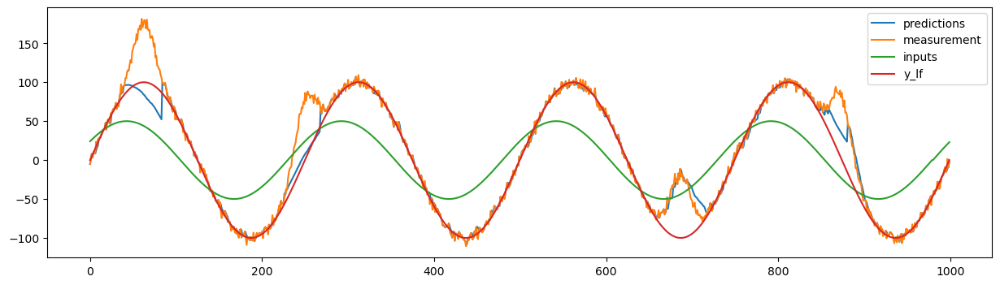

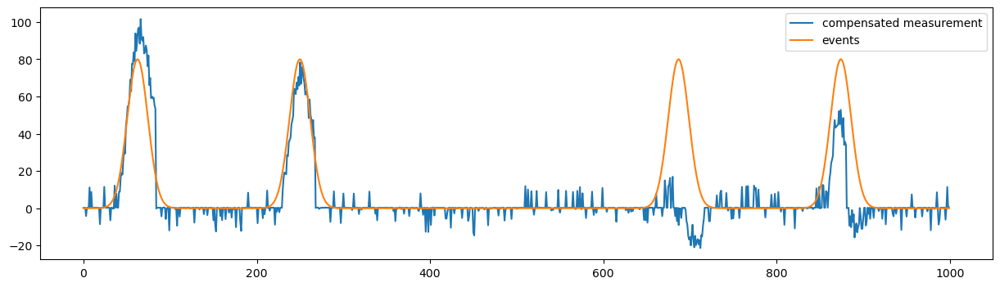

event_to_trend_amplitude: 0.4 , event_length_to_trend_period: 0.5 , time_shift: 0.005
optimal parameters: {'r_measurement_noise': 0.10068861198964245, 'q_process_noise_0': 0.6973718553444657, 'loc': 3.3187851633990126}
mse: 54.827706521550496


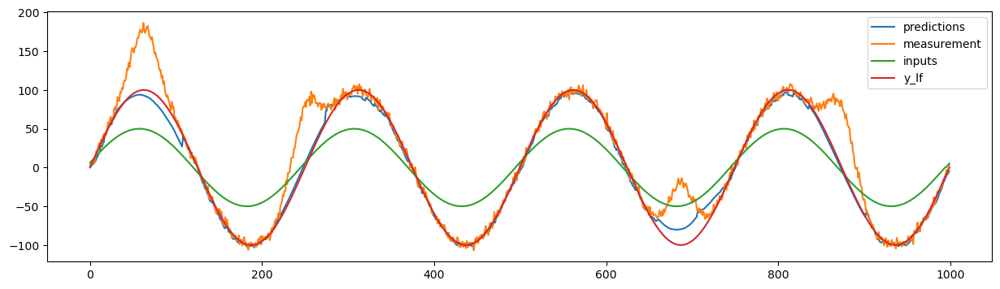

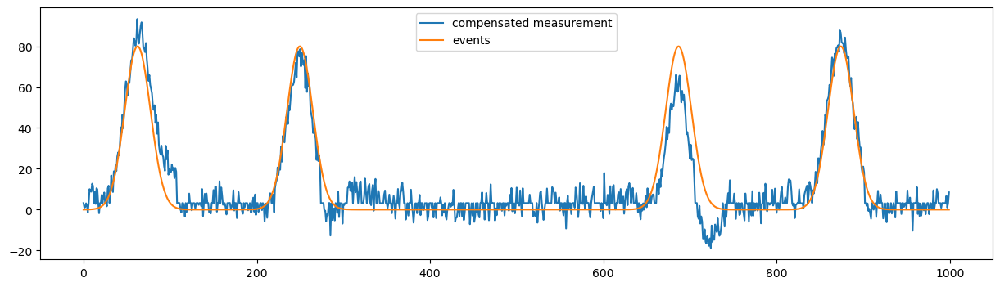

event_to_trend_amplitude: 0.4 , event_length_to_trend_period: 0.5 , time_shift: 0.01
optimal parameters: {'r_measurement_noise': 0.9666263853674906, 'q_process_noise_0': 0.8483764443004784, 'loc': 6.141703717249554}
mse: 310.60815555182165


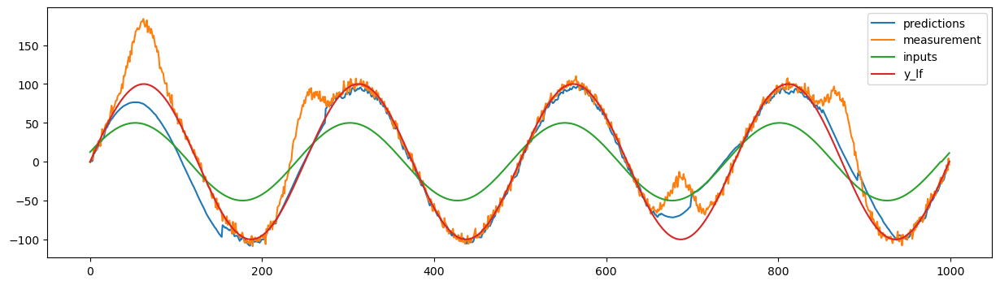

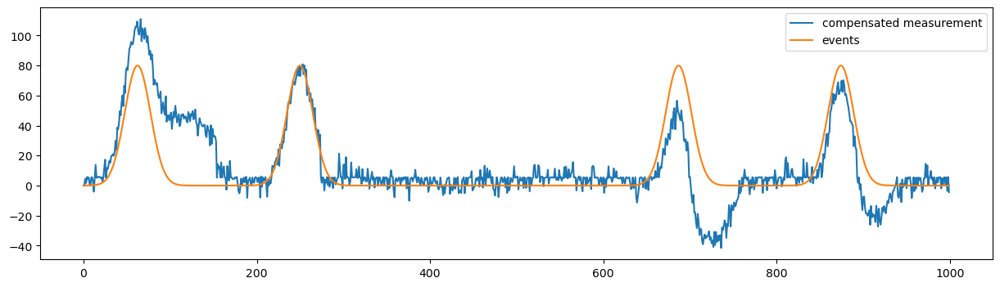

event_to_trend_amplitude: 0.4 , event_length_to_trend_period: 0.5 , time_shift: 0.015
optimal parameters: {'r_measurement_noise': 0.17788462775023095, 'q_process_noise_0': 1.691343662493645, 'loc': 9.296920378704094}
mse: 410.1032727180664


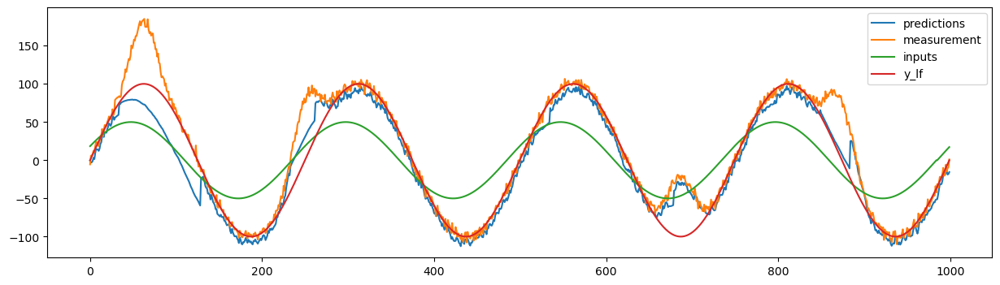

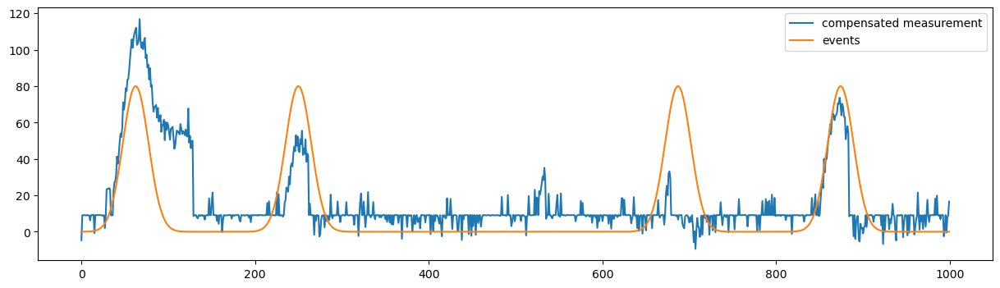

event_to_trend_amplitude: 0.4 , event_length_to_trend_period: 0.5 , time_shift: 0.02
optimal parameters: {'r_measurement_noise': 1.6160002847124875, 'q_process_noise_0': 1.169708647768822, 'loc': 9.520006858586918}
mse: 1328.5568973382553


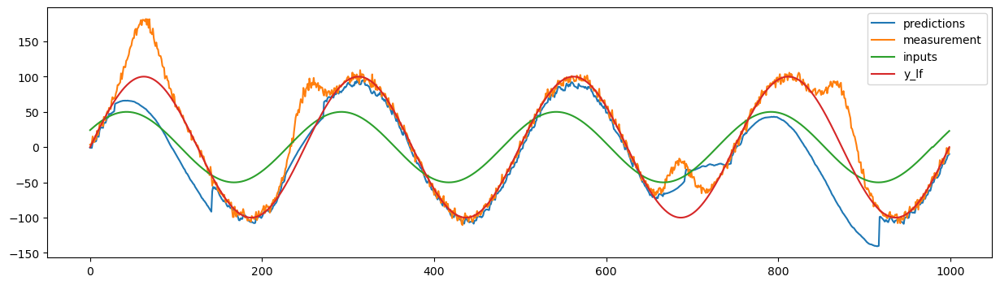

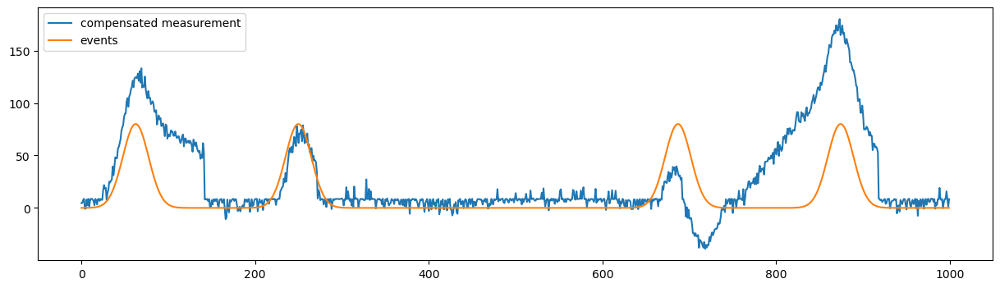

event_to_trend_amplitude: 0.4 , event_length_to_trend_period: 0.6 , time_shift: 0.005
optimal parameters: {'r_measurement_noise': 0.35912639850697853, 'q_process_noise_0': 0.4198650638844666, 'loc': 4.171236941044194}
mse: 142.52411348542626


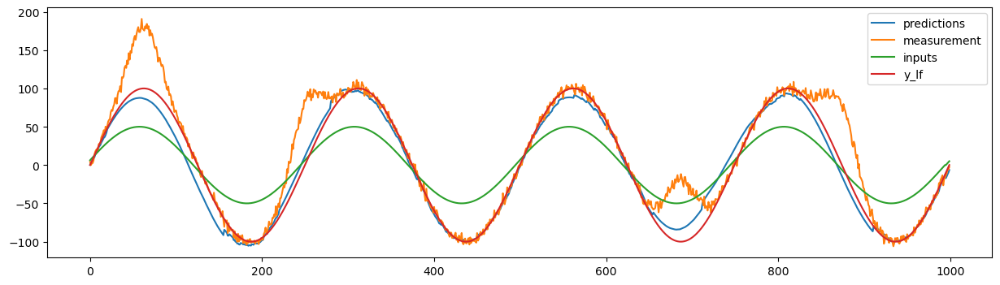

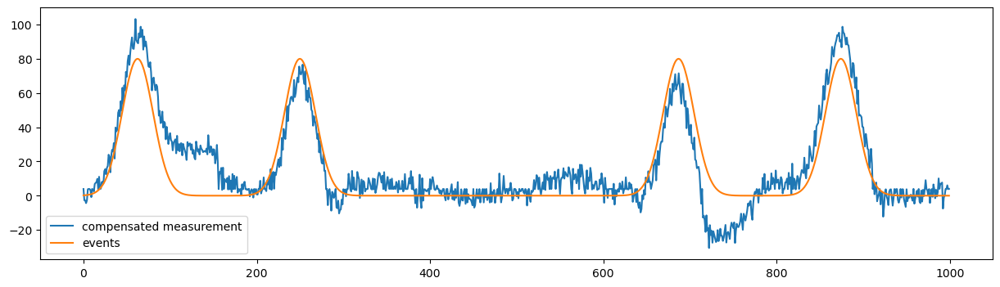

event_to_trend_amplitude: 0.4 , event_length_to_trend_period: 0.6 , time_shift: 0.01
optimal parameters: {'r_measurement_noise': 0.293898199366334, 'q_process_noise_0': 0.9891472284903297, 'loc': 2.2363415351332256}
mse: 322.74493289920935


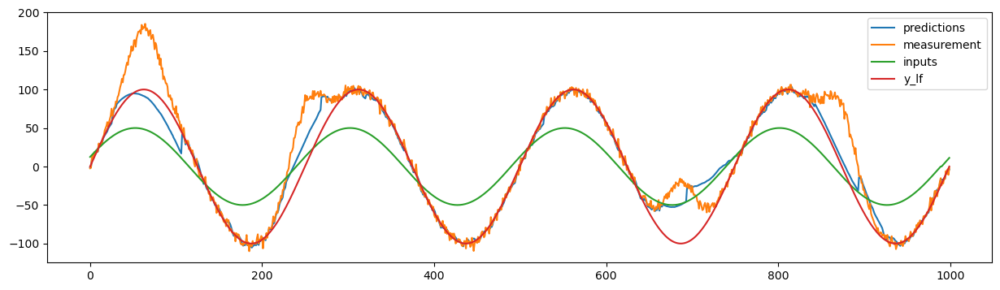

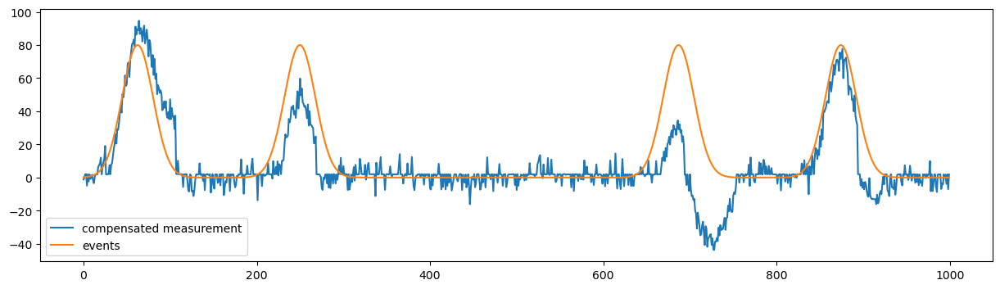

event_to_trend_amplitude: 0.4 , event_length_to_trend_period: 0.6 , time_shift: 0.015
optimal parameters: {'r_measurement_noise': 0.17959689907093293, 'q_process_noise_0': 1.2235275238492365, 'loc': 6.564106046657888}
mse: 320.91520751230405


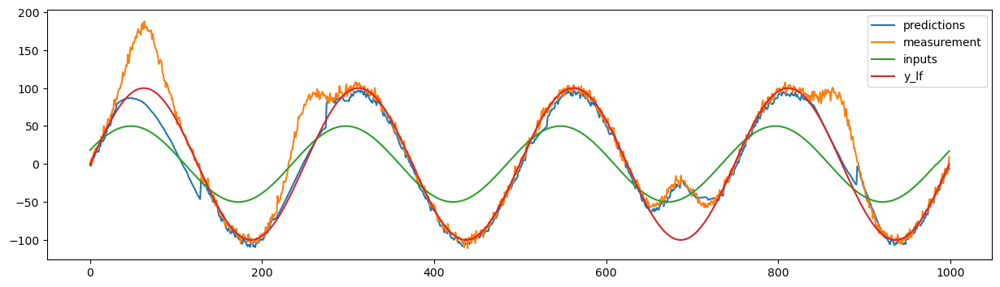

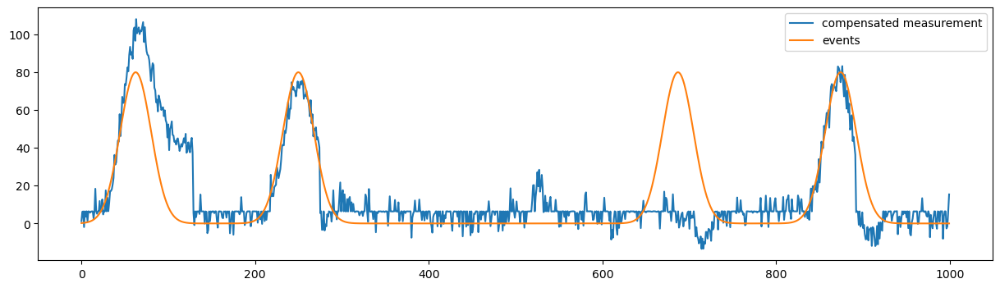

event_to_trend_amplitude: 0.4 , event_length_to_trend_period: 0.6 , time_shift: 0.02
optimal parameters: {'r_measurement_noise': 0.17713520693551113, 'q_process_noise_0': 1.990794337047713, 'loc': 0.2649320745716573}
mse: 548.3085919666543


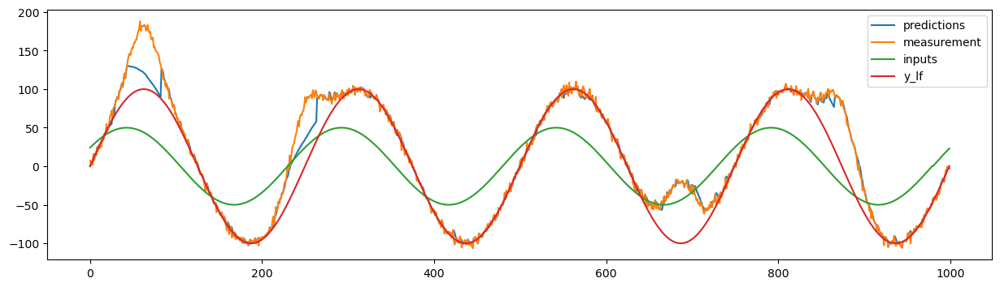

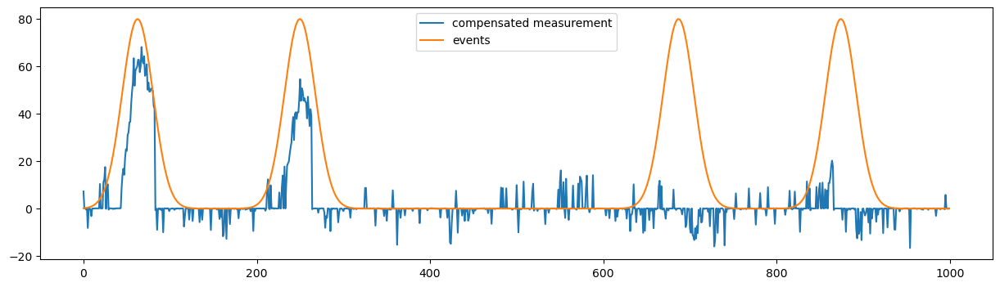

event_to_trend_amplitude: 0.5 , event_length_to_trend_period: 0.1 , time_shift: 0.005
optimal parameters: {'r_measurement_noise': 1.3079974882067884, 'q_process_noise_0': 0.6928914400239832, 'loc': 3.391744358516168}
mse: 7.9868402308189586


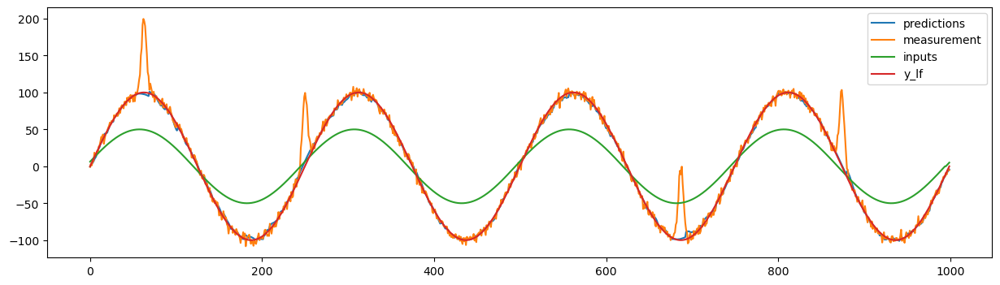

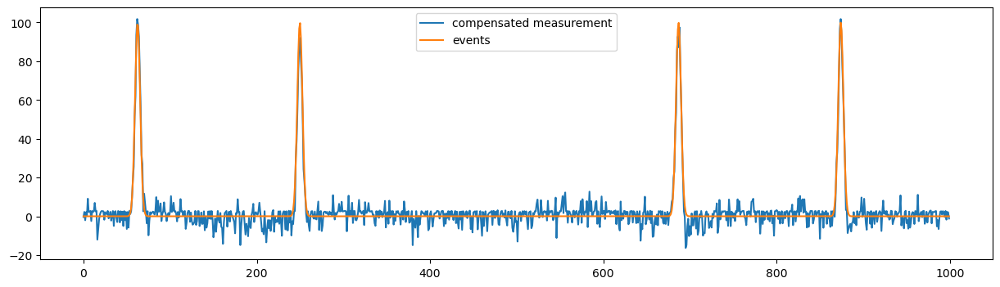

event_to_trend_amplitude: 0.5 , event_length_to_trend_period: 0.1 , time_shift: 0.01
optimal parameters: {'r_measurement_noise': 0.3570123964995665, 'q_process_noise_0': 0.9975505801829943, 'loc': 1.3471643812607672}
mse: 9.882105431004671


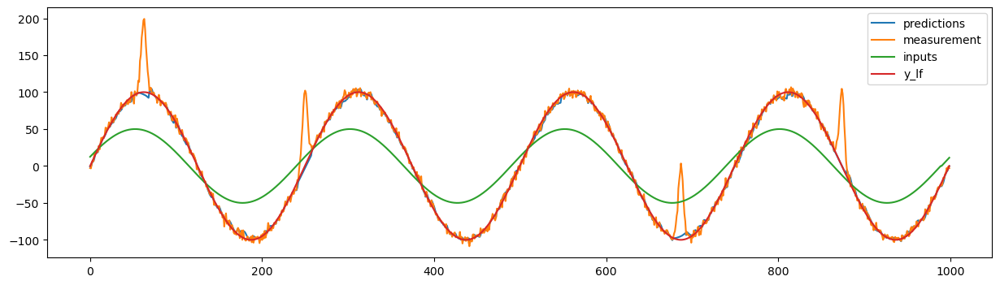

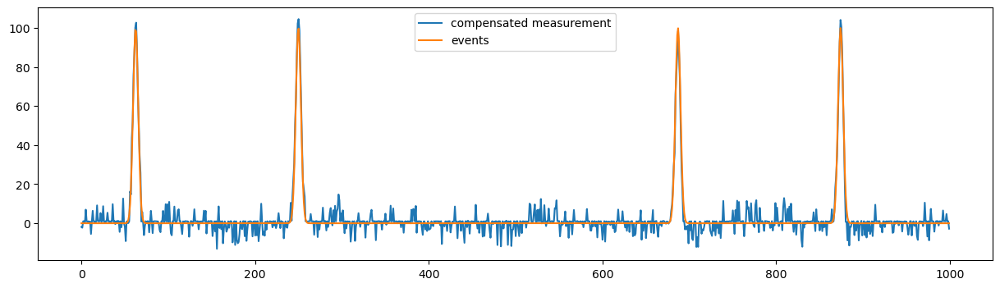

event_to_trend_amplitude: 0.5 , event_length_to_trend_period: 0.1 , time_shift: 0.015
optimal parameters: {'r_measurement_noise': 0.5937697944517161, 'q_process_noise_0': 1.4050083559402717, 'loc': 1.6124472840788469}
mse: 14.056622420095602


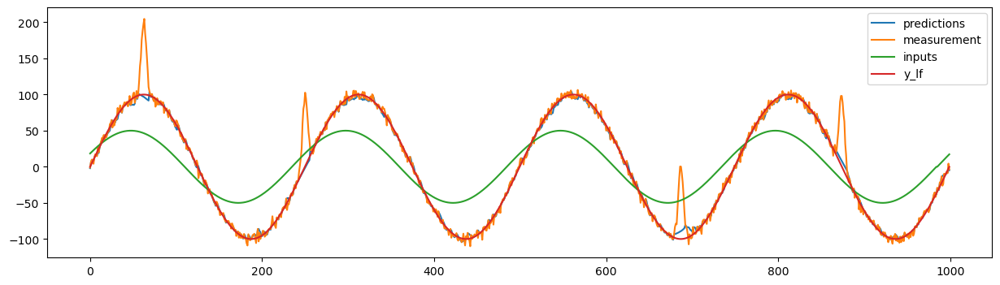

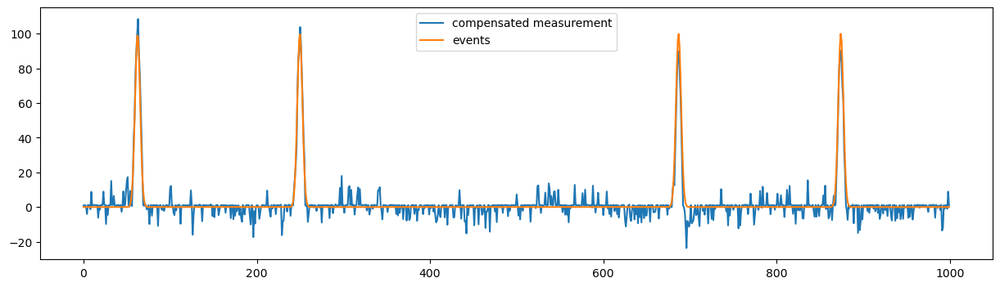

event_to_trend_amplitude: 0.5 , event_length_to_trend_period: 0.1 , time_shift: 0.02
optimal parameters: {'r_measurement_noise': 0.1602955482875498, 'q_process_noise_0': 2.196892115760162, 'loc': 0.7215583485681817}
mse: 21.84723532197461


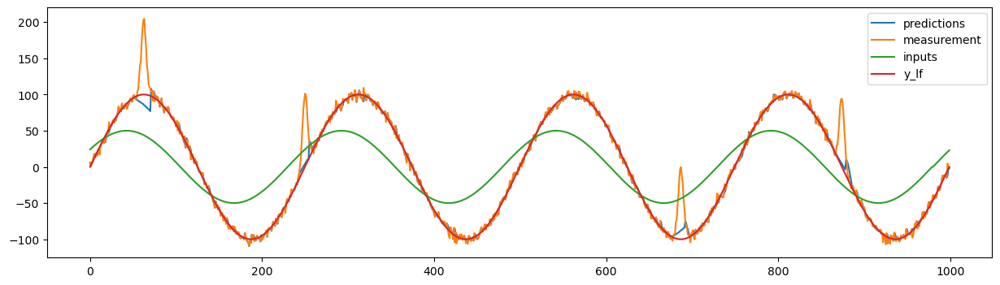

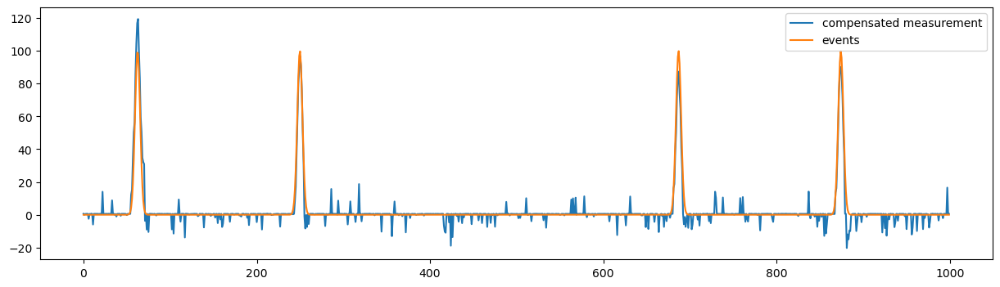

event_to_trend_amplitude: 0.5 , event_length_to_trend_period: 0.2 , time_shift: 0.005
optimal parameters: {'r_measurement_noise': 0.3236716893014266, 'q_process_noise_0': 0.9720283304322133, 'loc': 2.279245409637158}
mse: 13.225993112473235


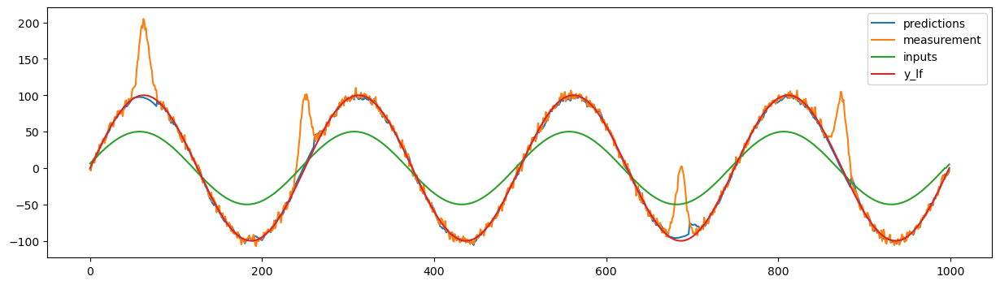

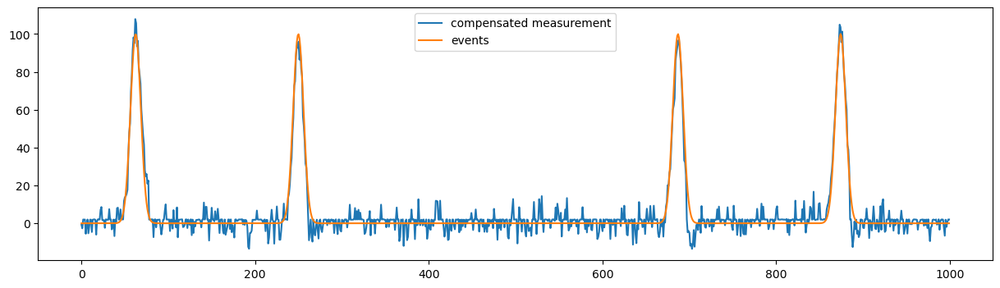

event_to_trend_amplitude: 0.5 , event_length_to_trend_period: 0.2 , time_shift: 0.01
optimal parameters: {'r_measurement_noise': 0.11651276922590113, 'q_process_noise_0': 1.449097811275117, 'loc': 0.20456266787866617}
mse: 40.9163353621621


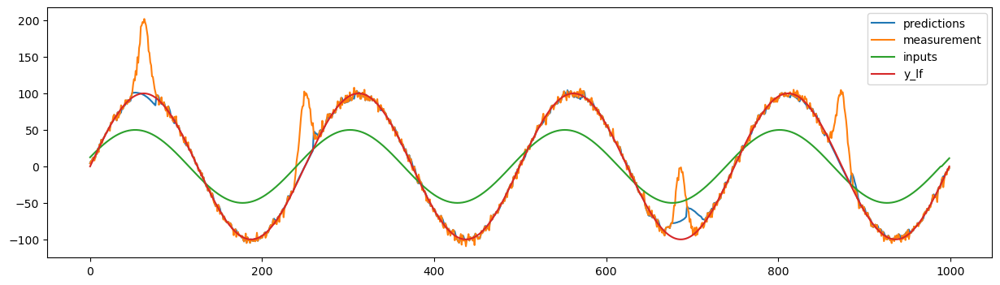

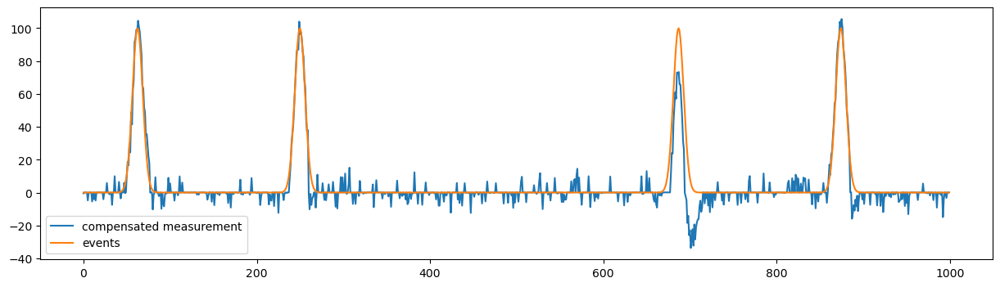

event_to_trend_amplitude: 0.5 , event_length_to_trend_period: 0.2 , time_shift: 0.015
optimal parameters: {'r_measurement_noise': 0.5424213019938406, 'q_process_noise_0': 1.4847330510432466, 'loc': 1.527871510526617}
mse: 69.26160020469429


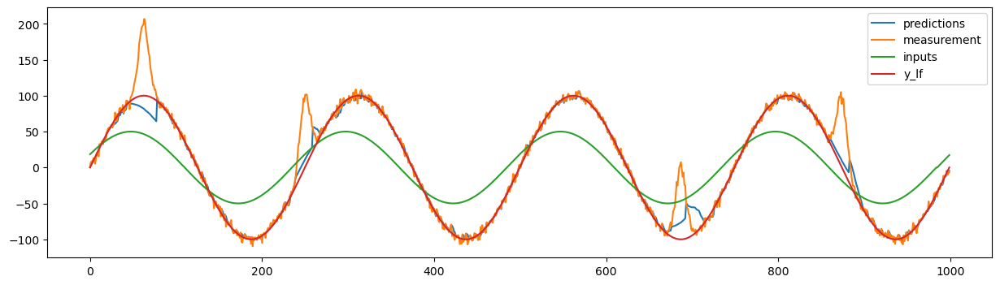

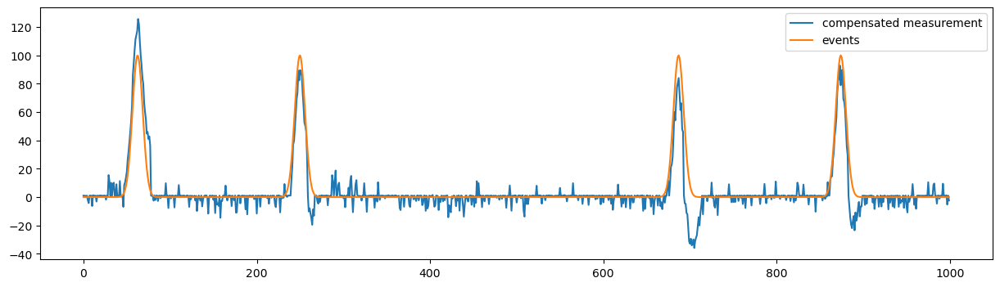

event_to_trend_amplitude: 0.5 , event_length_to_trend_period: 0.2 , time_shift: 0.02
optimal parameters: {'r_measurement_noise': 0.5681061551172579, 'q_process_noise_0': 1.7029931551657842, 'loc': 0.14969726473303177}
mse: 82.33339775833764


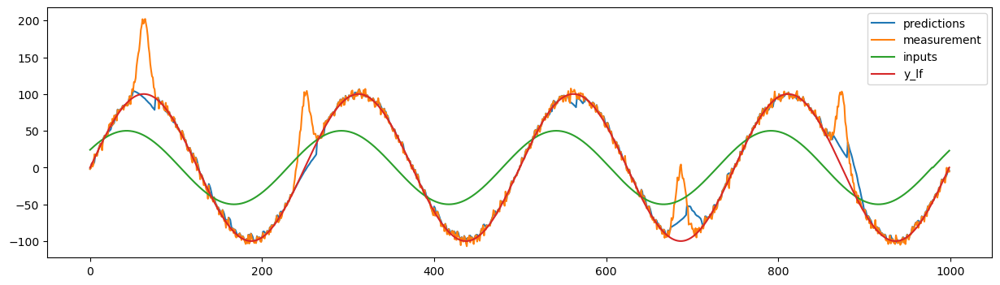

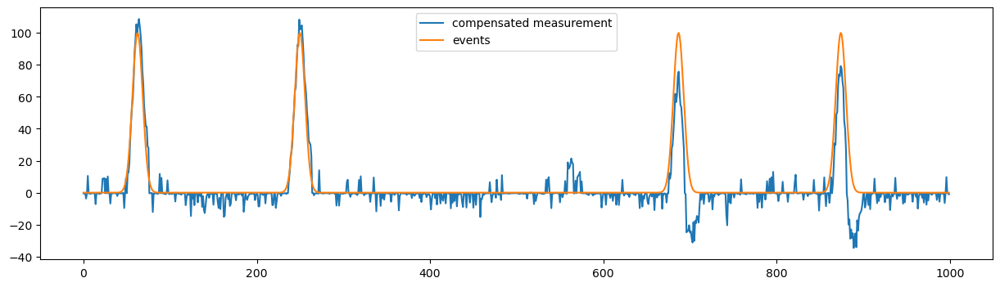

event_to_trend_amplitude: 0.5 , event_length_to_trend_period: 0.30000000000000004 , time_shift: 0.005
optimal parameters: {'r_measurement_noise': 3.526374190727623, 'q_process_noise_0': 0.7287327333036501, 'loc': 5.145832246606063}
mse: 26.368570493579977


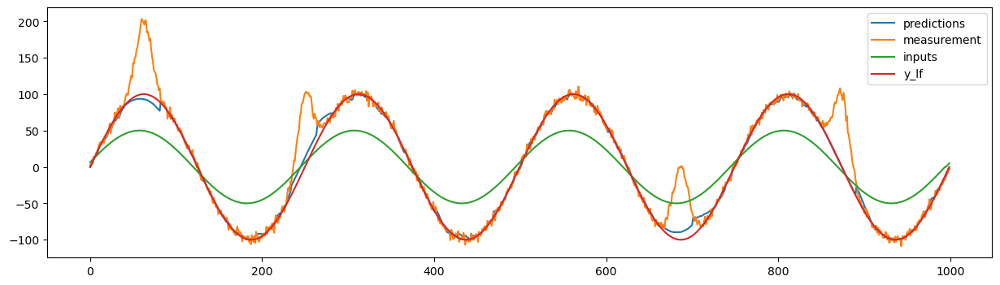

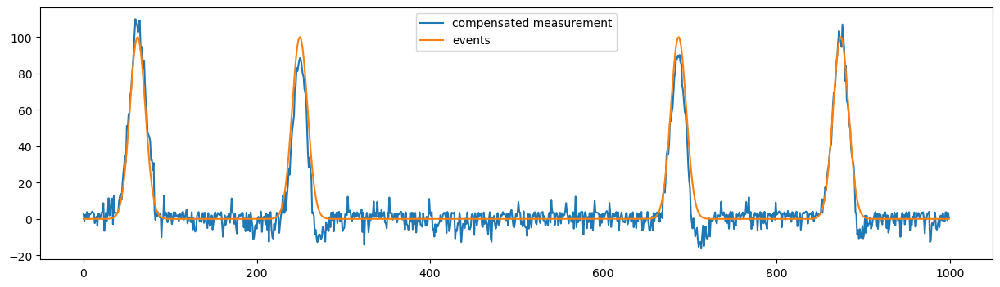

event_to_trend_amplitude: 0.5 , event_length_to_trend_period: 0.30000000000000004 , time_shift: 0.01
optimal parameters: {'r_measurement_noise': 0.5339676037593428, 'q_process_noise_0': 0.9802401876196485, 'loc': 3.288626903458449}
mse: 70.42716670264483


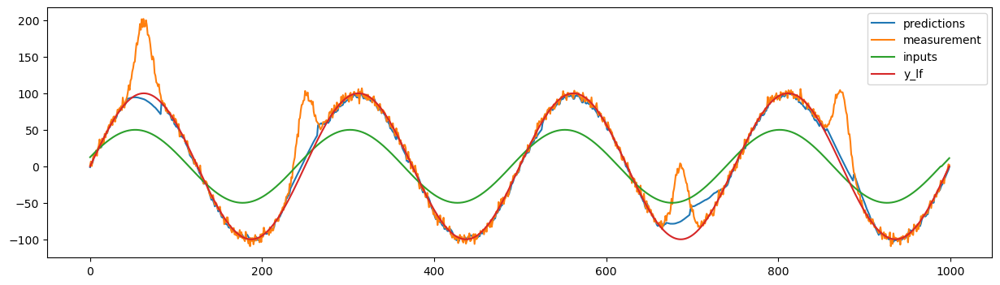

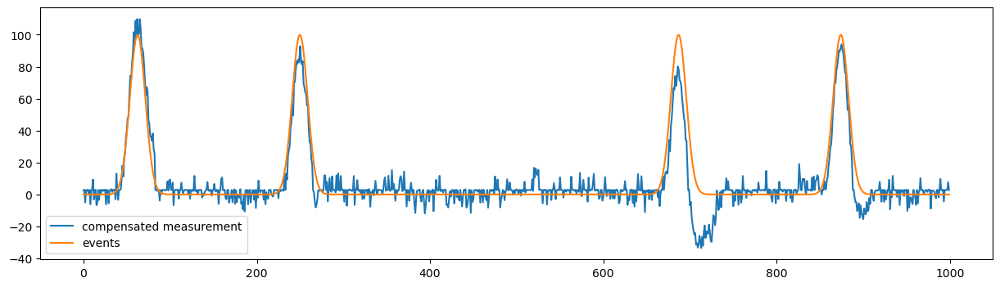

event_to_trend_amplitude: 0.5 , event_length_to_trend_period: 0.30000000000000004 , time_shift: 0.015
optimal parameters: {'r_measurement_noise': 0.7763192824164005, 'q_process_noise_0': 1.6510932523131159, 'loc': 7.418264605166897}
mse: 124.08208540522162


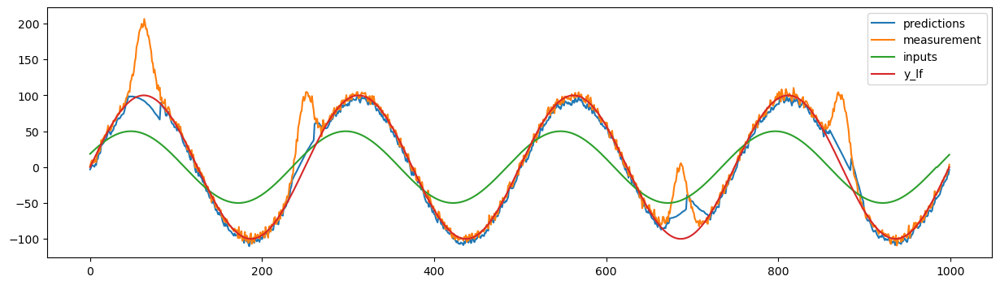

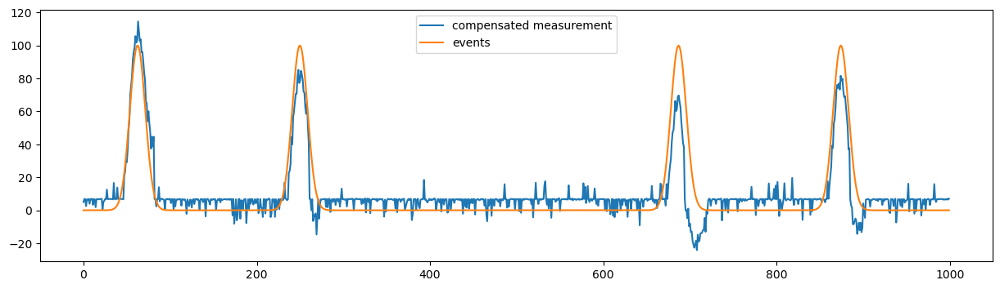

event_to_trend_amplitude: 0.5 , event_length_to_trend_period: 0.30000000000000004 , time_shift: 0.02
optimal parameters: {'r_measurement_noise': 0.17859987402186978, 'q_process_noise_0': 1.8592752245184554, 'loc': 0.582574021253437}
mse: 121.39715258152792


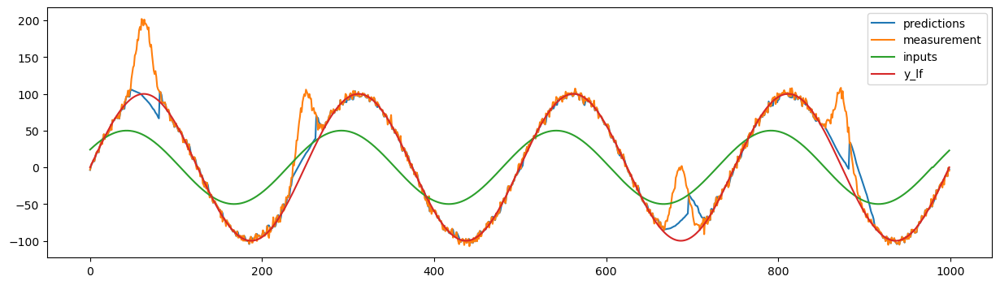

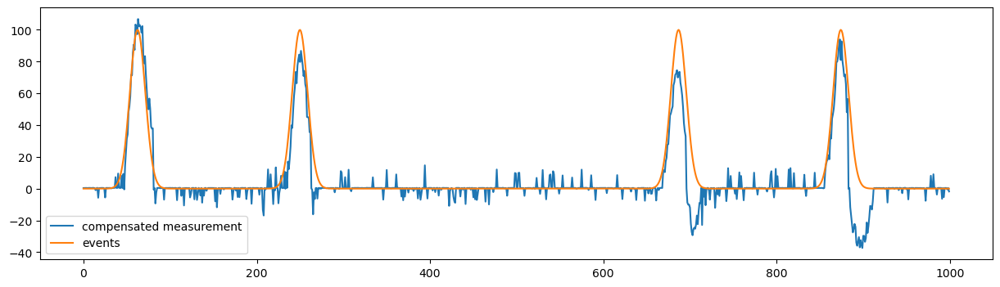

event_to_trend_amplitude: 0.5 , event_length_to_trend_period: 0.4 , time_shift: 0.005
optimal parameters: {'r_measurement_noise': 0.11910363213626037, 'q_process_noise_0': 0.9704398430783094, 'loc': 1.613139169476791}
mse: 40.53727037540265


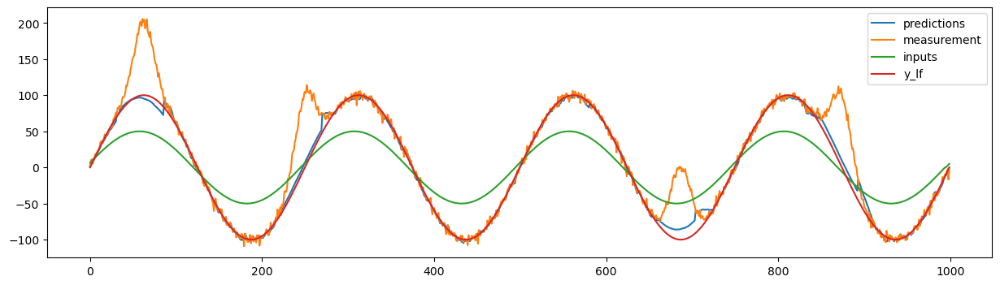

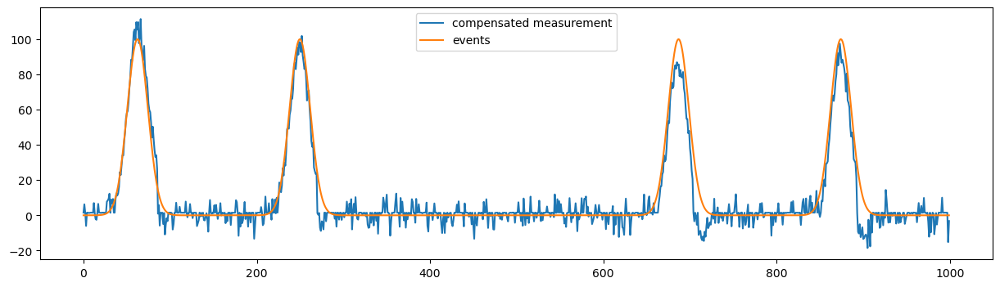

event_to_trend_amplitude: 0.5 , event_length_to_trend_period: 0.4 , time_shift: 0.01
optimal parameters: {'r_measurement_noise': 0.21675062451131138, 'q_process_noise_0': 1.3522847093129478, 'loc': 4.372308666107012}
mse: 216.423304971799


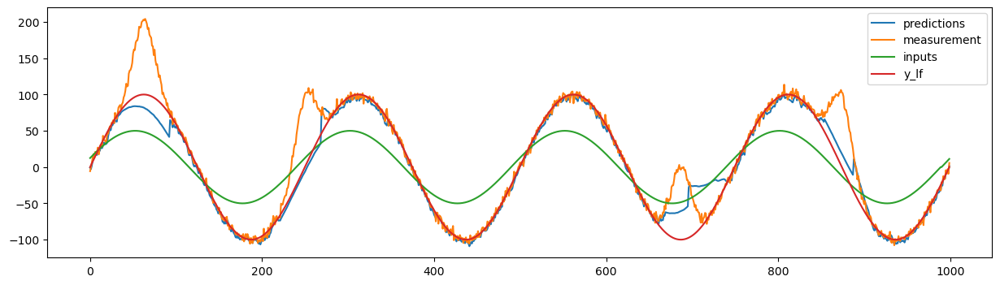

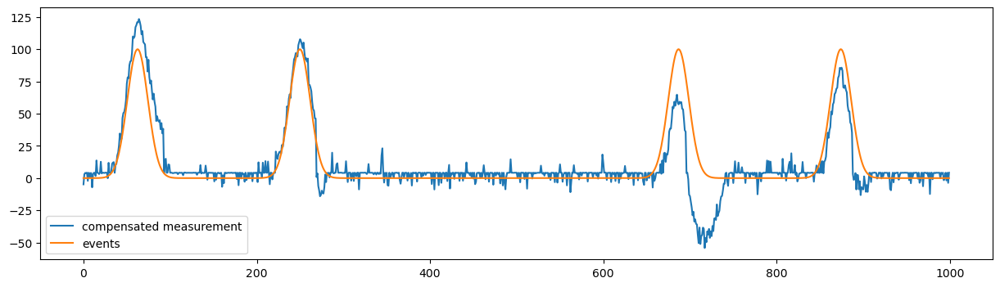

event_to_trend_amplitude: 0.5 , event_length_to_trend_period: 0.4 , time_shift: 0.015
optimal parameters: {'r_measurement_noise': 0.1986909249687881, 'q_process_noise_0': 2.0322698945312903, 'loc': 6.350702115697626}
mse: 326.813021825584


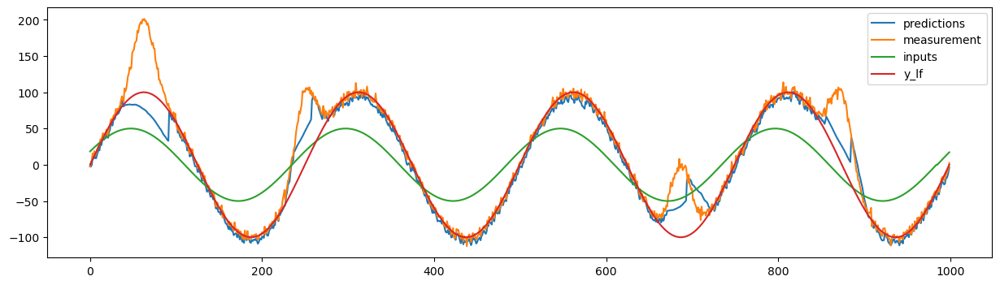

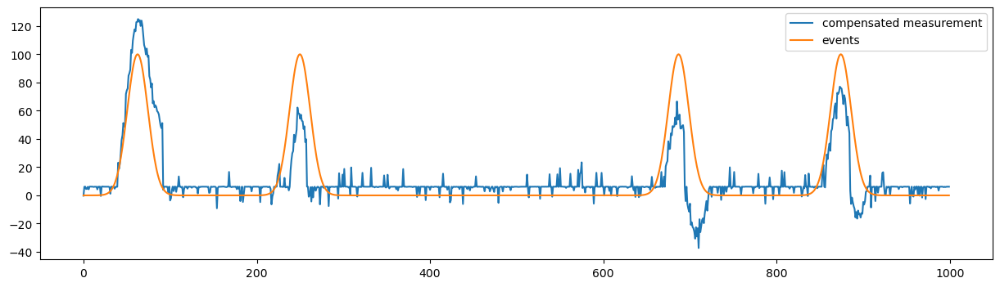

event_to_trend_amplitude: 0.5 , event_length_to_trend_period: 0.4 , time_shift: 0.02
optimal parameters: {'r_measurement_noise': 1.0850609947783756, 'q_process_noise_0': 2.2307453764038225, 'loc': 10.406028589388116}
mse: 434.1804990931952


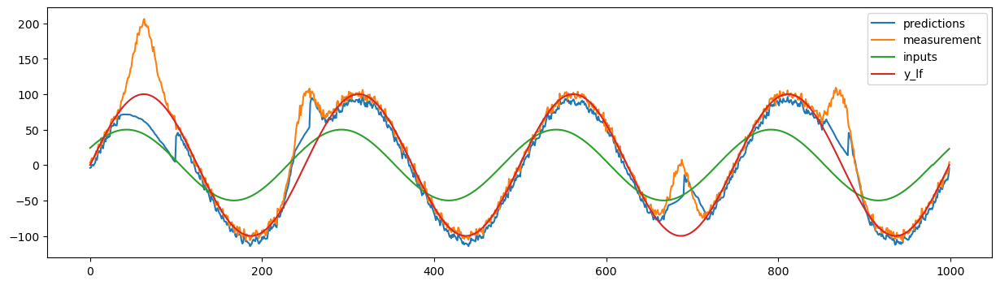

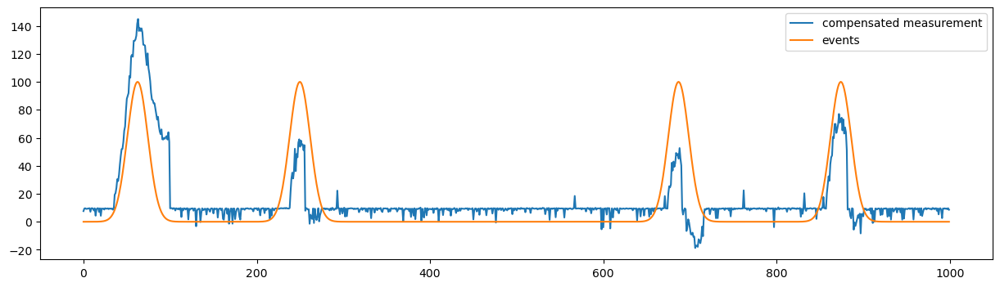

event_to_trend_amplitude: 0.5 , event_length_to_trend_period: 0.5 , time_shift: 0.005
optimal parameters: {'r_measurement_noise': 0.1926169090032749, 'q_process_noise_0': 0.6842798859734293, 'loc': 0.38732030253823857}
mse: 51.0733410759495


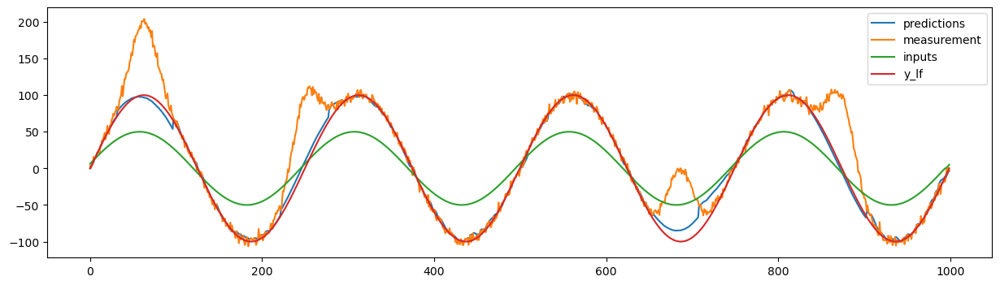

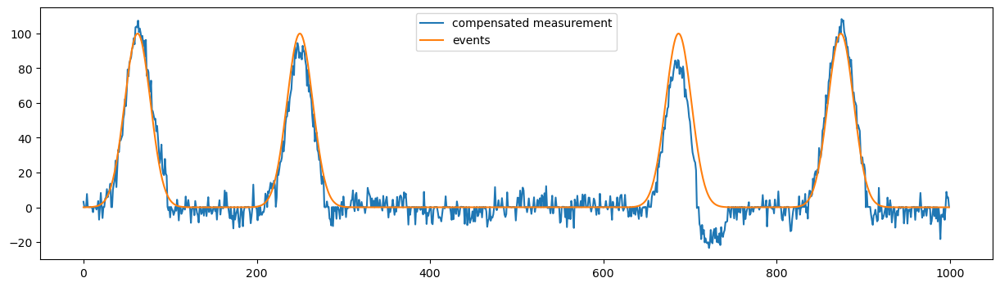

event_to_trend_amplitude: 0.5 , event_length_to_trend_period: 0.5 , time_shift: 0.01
optimal parameters: {'r_measurement_noise': 0.2056043444105409, 'q_process_noise_0': 0.919945389849495, 'loc': 2.7954733821177995}
mse: 223.48968054180983


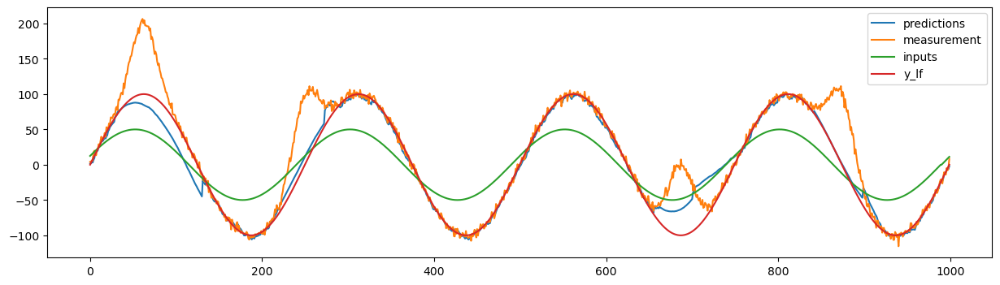

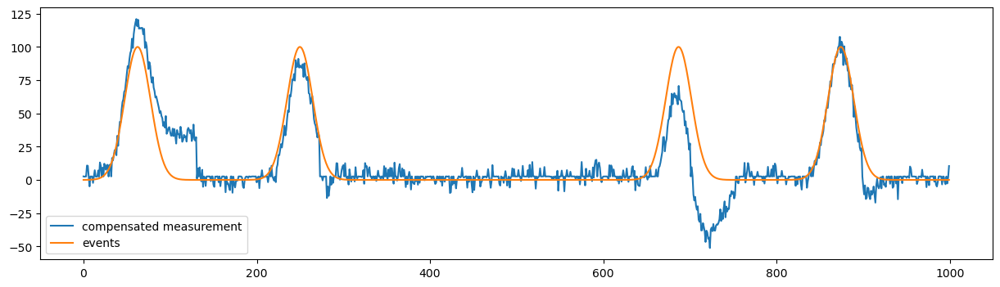

event_to_trend_amplitude: 0.5 , event_length_to_trend_period: 0.5 , time_shift: 0.015
optimal parameters: {'r_measurement_noise': 0.14223890810687798, 'q_process_noise_0': 1.280287977777569, 'loc': 0.12064592959270436}
mse: 332.1285500171095


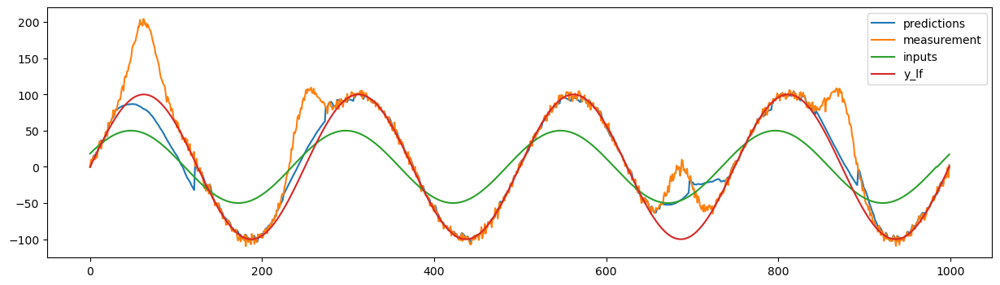

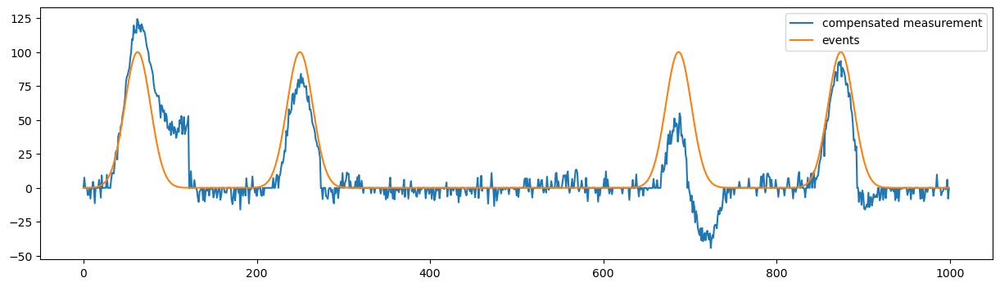

event_to_trend_amplitude: 0.5 , event_length_to_trend_period: 0.5 , time_shift: 0.02
optimal parameters: {'r_measurement_noise': 0.23725836257279323, 'q_process_noise_0': 1.6206759229315342, 'loc': 7.777024360232356}
mse: 620.2222286400483


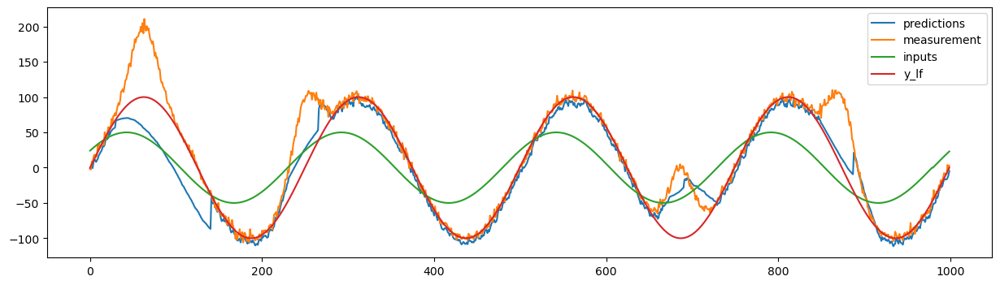

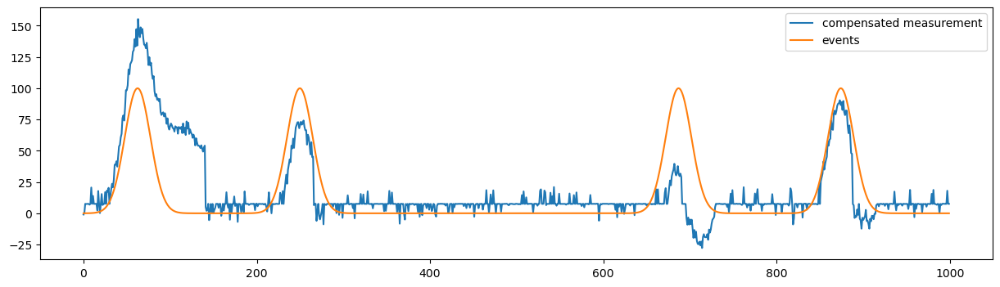

event_to_trend_amplitude: 0.5 , event_length_to_trend_period: 0.6 , time_shift: 0.005
optimal parameters: {'r_measurement_noise': 0.411592481466586, 'q_process_noise_0': 0.7509674860462943, 'loc': 6.212645214824484}
mse: 82.49580126009502


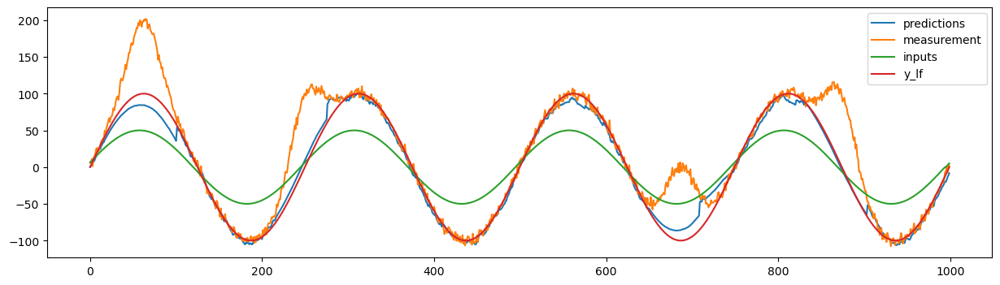

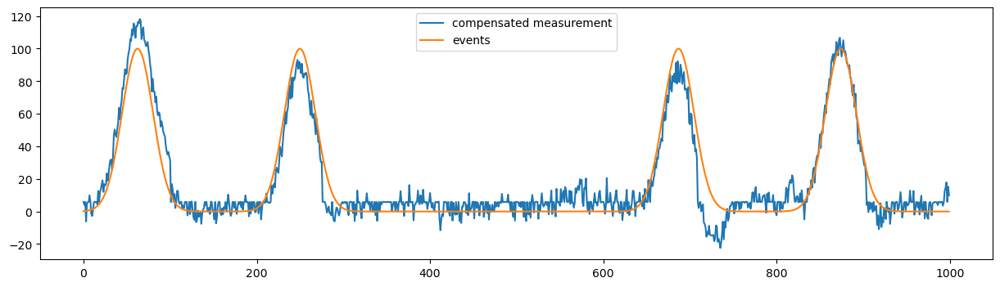

event_to_trend_amplitude: 0.5 , event_length_to_trend_period: 0.6 , time_shift: 0.01
optimal parameters: {'r_measurement_noise': 0.7057027367274141, 'q_process_noise_0': 1.412629538773851, 'loc': 4.368544956673789}
mse: 447.1730446144535


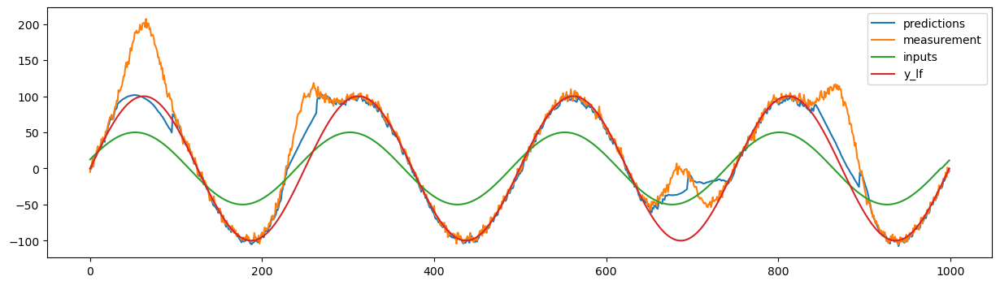

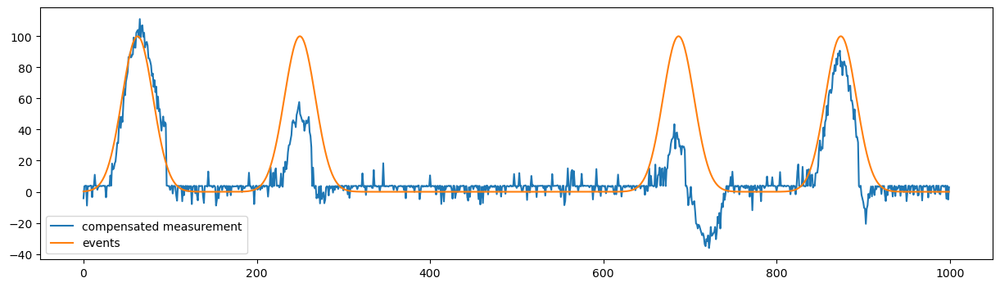

event_to_trend_amplitude: 0.5 , event_length_to_trend_period: 0.6 , time_shift: 0.015
optimal parameters: {'r_measurement_noise': 6.425083284215649, 'q_process_noise_0': 0.4905685351516981, 'loc': 3.76922754399916}
mse: 717.3323379438095


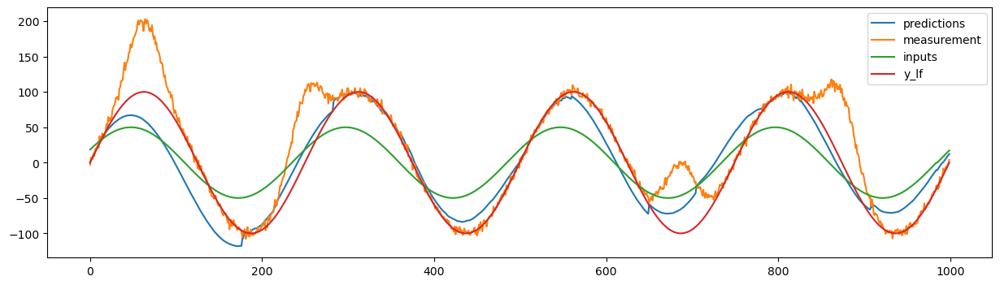

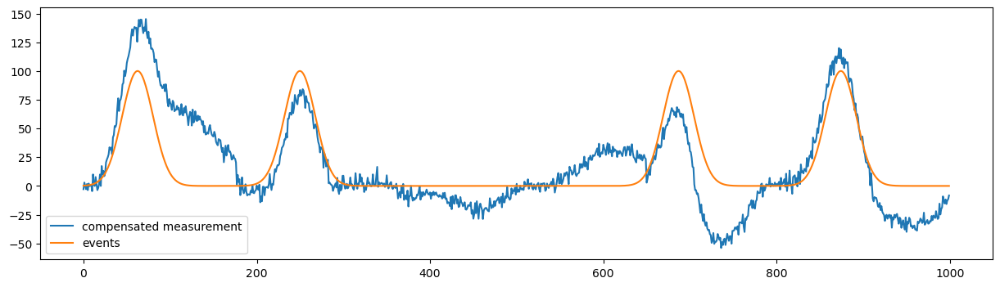

event_to_trend_amplitude: 0.5 , event_length_to_trend_period: 0.6 , time_shift: 0.02
optimal parameters: {'r_measurement_noise': 0.16944130114298595, 'q_process_noise_0': 1.8466225601109723, 'loc': 4.755881086389716}
mse: 819.017631309211


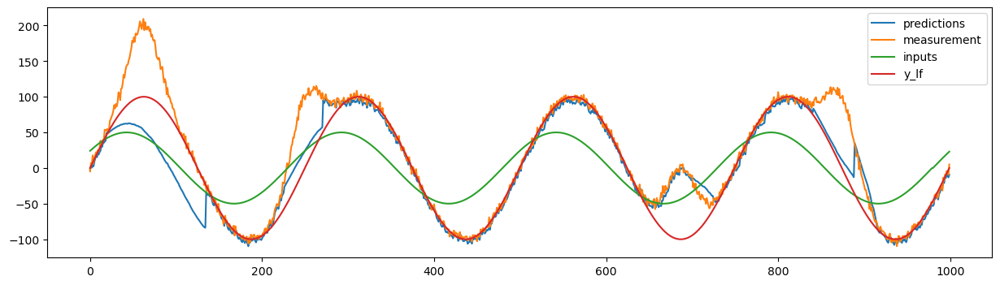

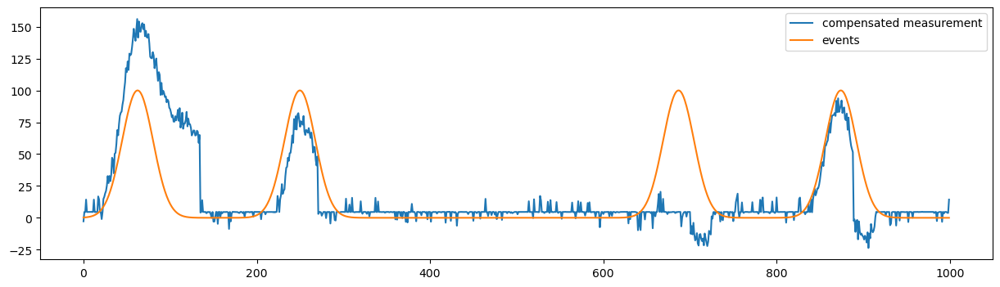

event_to_trend_amplitude: 0.6 , event_length_to_trend_period: 0.1 , time_shift: 0.005
optimal parameters: {'r_measurement_noise': 2.6675874255432857, 'q_process_noise_0': 0.4021451898151242, 'loc': 5.200301862402358}
mse: 6.492936388648


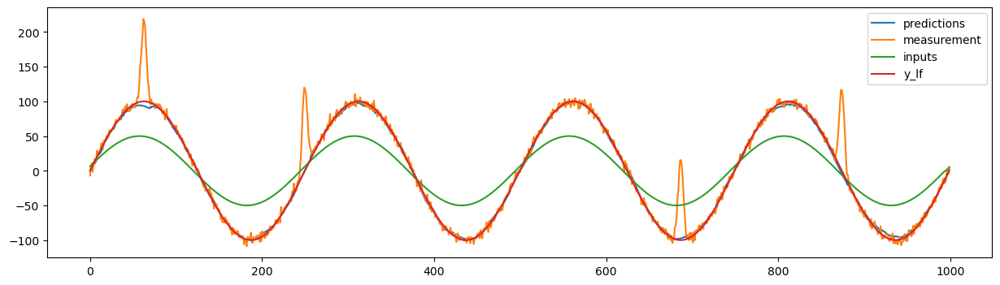

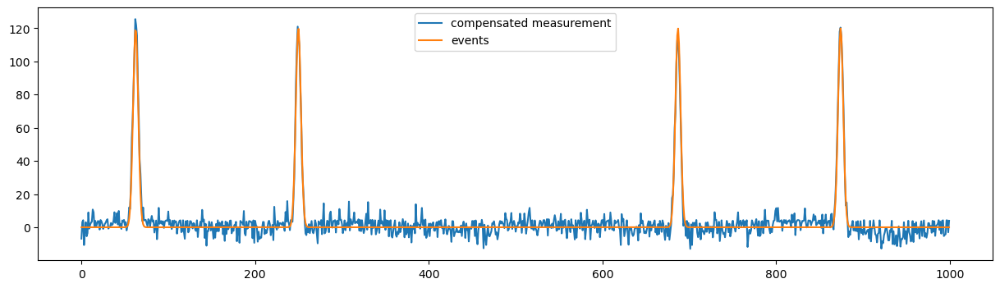

event_to_trend_amplitude: 0.6 , event_length_to_trend_period: 0.1 , time_shift: 0.01
optimal parameters: {'r_measurement_noise': 0.14746139214888196, 'q_process_noise_0': 1.071573754988131, 'loc': 0.5696726961425118}
mse: 79.4072832735248


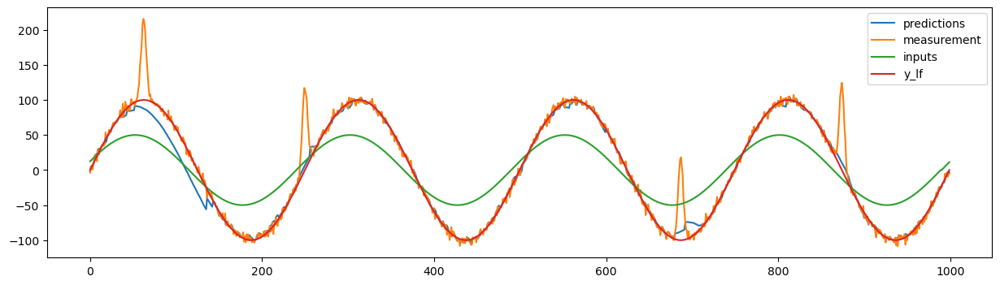

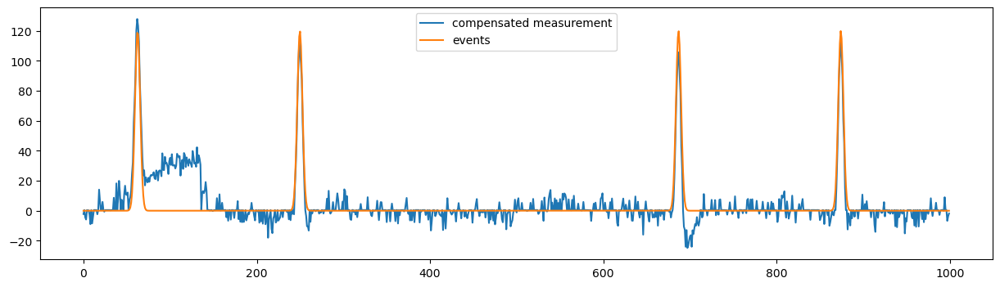

event_to_trend_amplitude: 0.6 , event_length_to_trend_period: 0.1 , time_shift: 0.015
optimal parameters: {'r_measurement_noise': 1.6675596432598632, 'q_process_noise_0': 1.479847436545582, 'loc': 2.859415972606016}
mse: 16.481028223755825


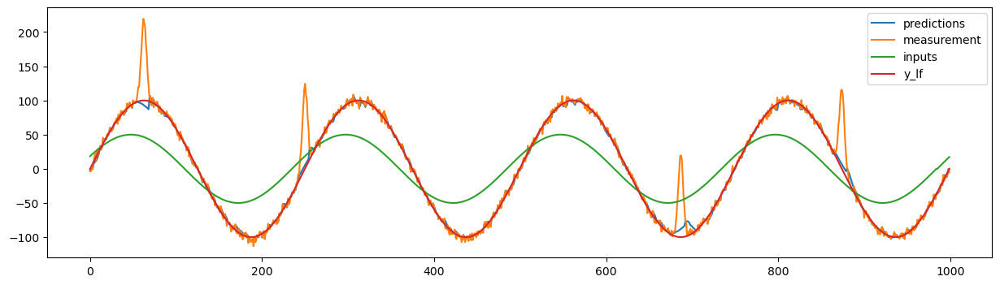

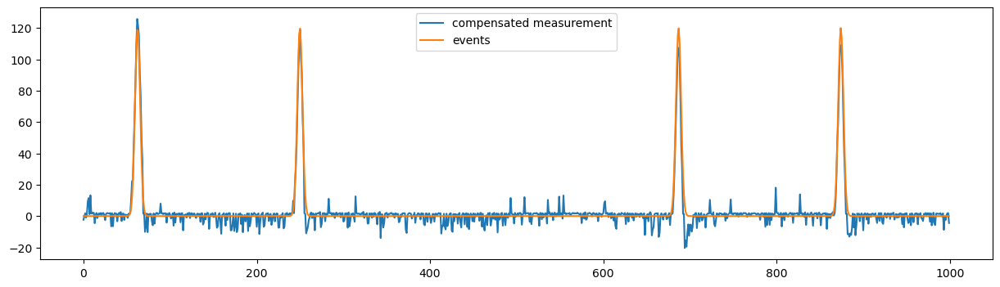

event_to_trend_amplitude: 0.6 , event_length_to_trend_period: 0.1 , time_shift: 0.02
optimal parameters: {'r_measurement_noise': 0.6487913243286235, 'q_process_noise_0': 1.6519754376985145, 'loc': 2.9546135412335404}
mse: 28.89975133851286


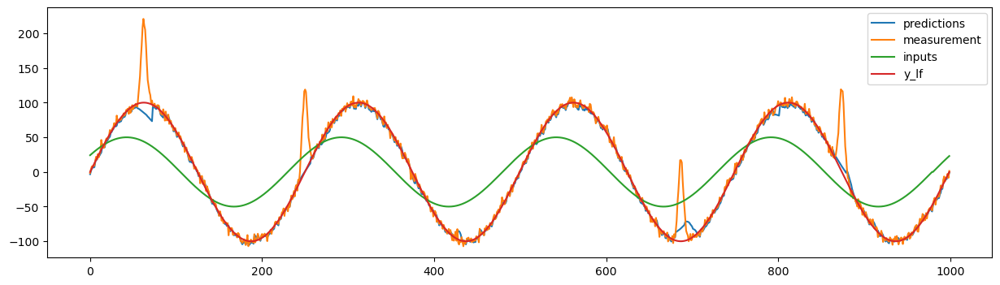

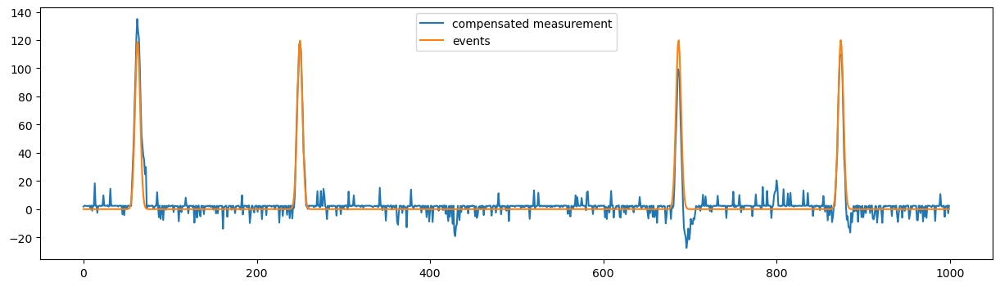

event_to_trend_amplitude: 0.6 , event_length_to_trend_period: 0.2 , time_shift: 0.005
optimal parameters: {'r_measurement_noise': 0.25253256797507995, 'q_process_noise_0': 0.5462324121516384, 'loc': 1.96375490308277}
mse: 29.21729995126255


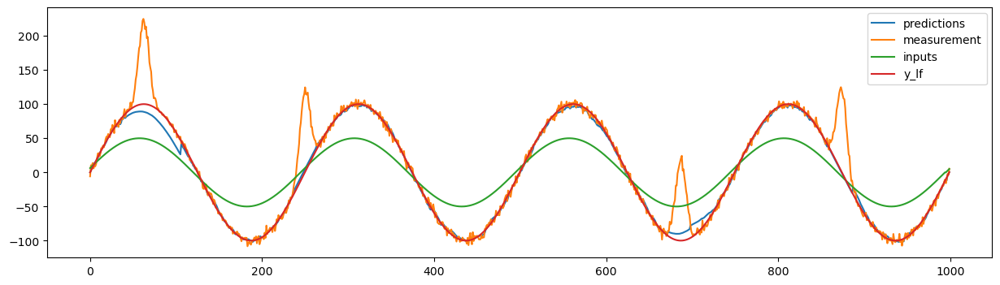

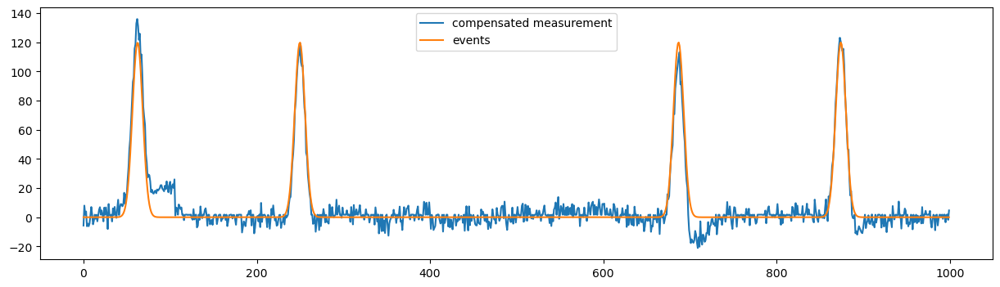

event_to_trend_amplitude: 0.6 , event_length_to_trend_period: 0.2 , time_shift: 0.01
optimal parameters: {'r_measurement_noise': 0.2280478544206397, 'q_process_noise_0': 1.3746188744549834, 'loc': 2.5602315117600387}
mse: 36.14203364687647


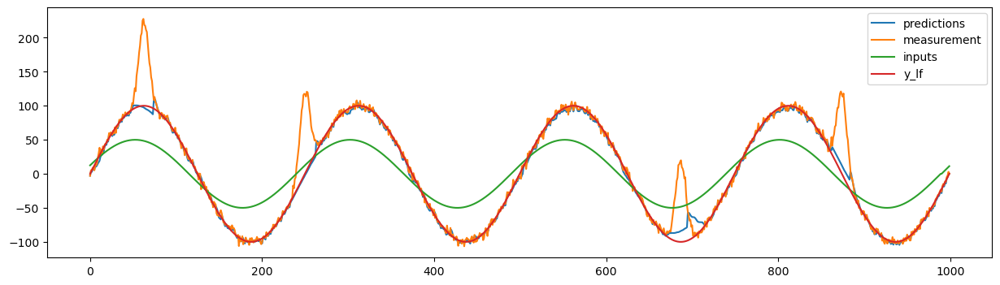

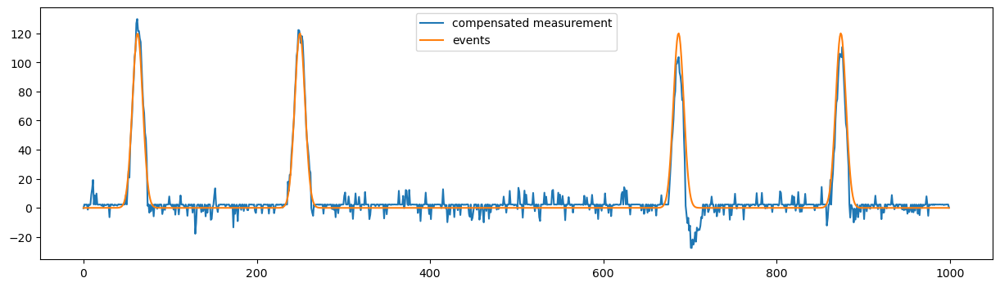

event_to_trend_amplitude: 0.6 , event_length_to_trend_period: 0.2 , time_shift: 0.015
optimal parameters: {'r_measurement_noise': 0.45752948695119494, 'q_process_noise_0': 1.2305706280709607, 'loc': 1.7618831643092328}
mse: 60.268714920903314


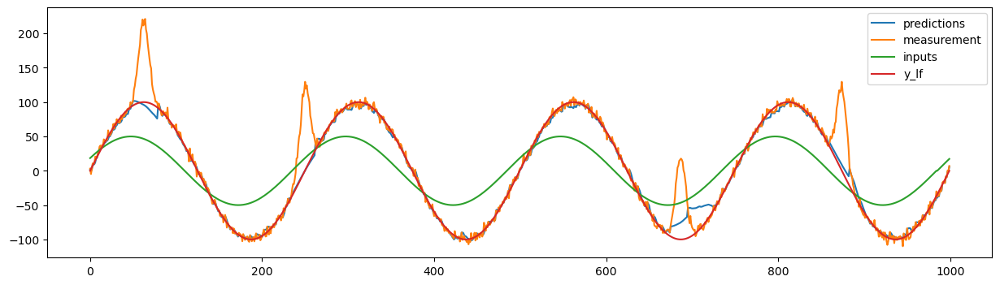

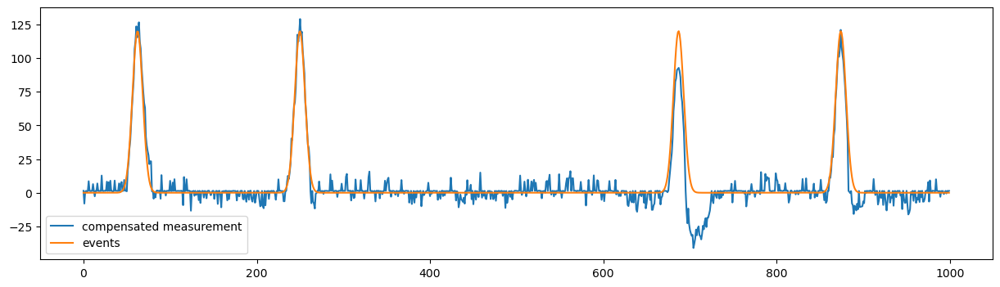

event_to_trend_amplitude: 0.6 , event_length_to_trend_period: 0.2 , time_shift: 0.02
optimal parameters: {'r_measurement_noise': 0.1806153768874763, 'q_process_noise_0': 2.414858725537287, 'loc': 3.7722450559933973}
mse: 149.3227283785433


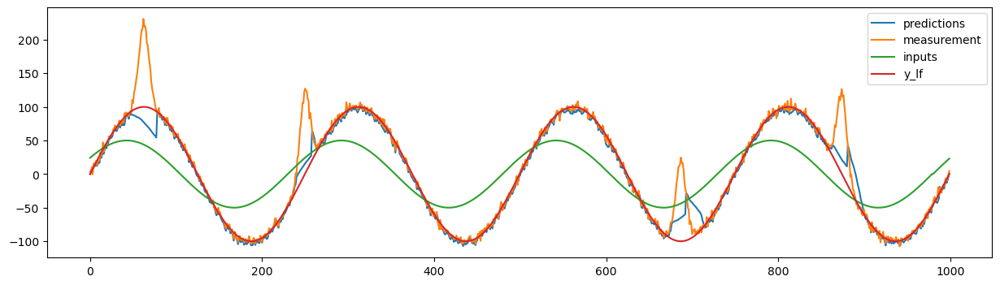

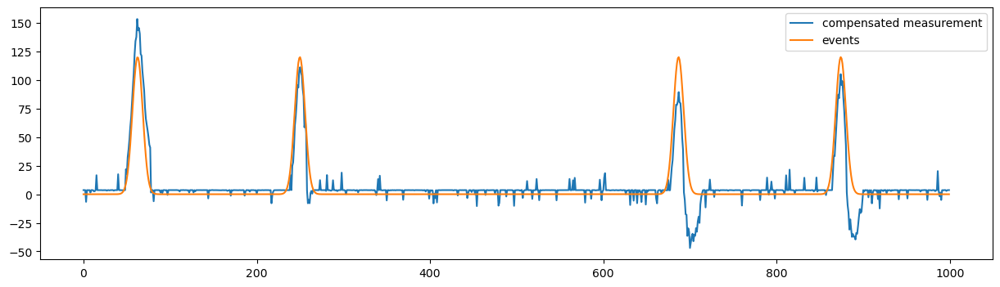

event_to_trend_amplitude: 0.6 , event_length_to_trend_period: 0.30000000000000004 , time_shift: 0.005
optimal parameters: {'r_measurement_noise': 0.4047535163083651, 'q_process_noise_0': 0.580484142105055, 'loc': 1.8942840579308453}
mse: 17.68402842778997


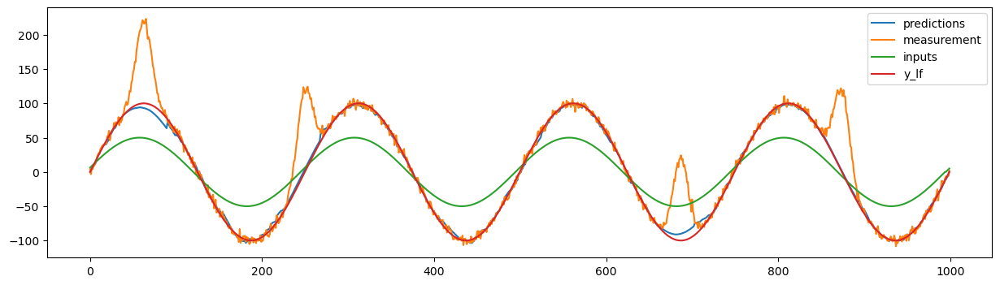

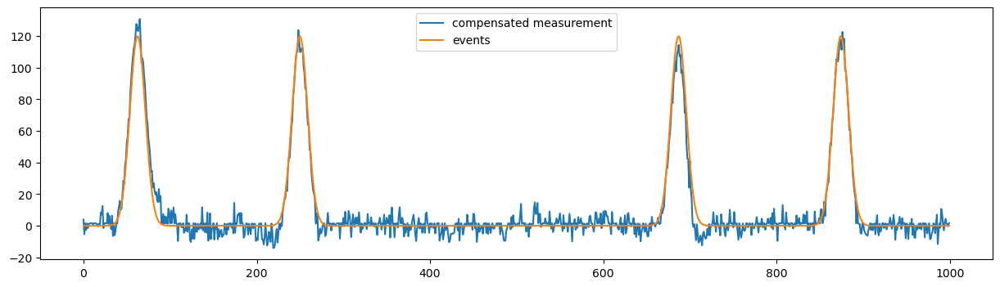

event_to_trend_amplitude: 0.6 , event_length_to_trend_period: 0.30000000000000004 , time_shift: 0.01
optimal parameters: {'r_measurement_noise': 1.0114655069220828, 'q_process_noise_0': 1.1112278187718907, 'loc': 3.927750254965902}
mse: 89.67247647376868


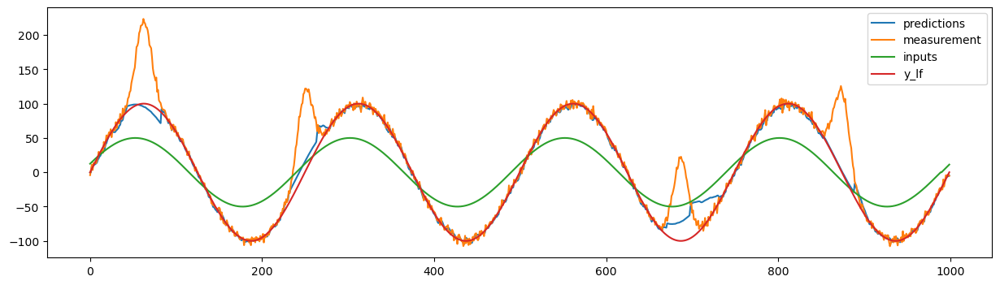

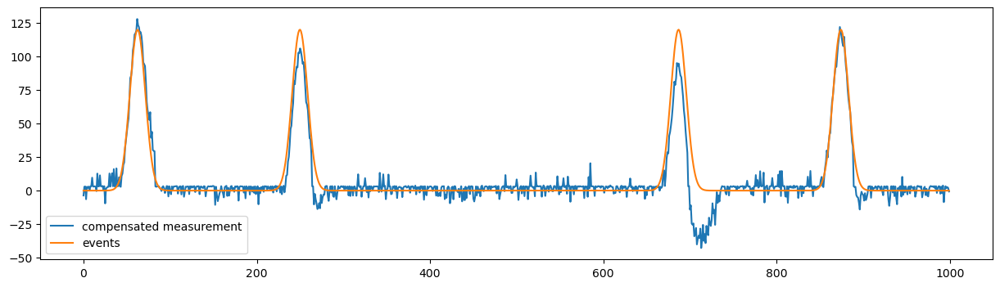

event_to_trend_amplitude: 0.6 , event_length_to_trend_period: 0.30000000000000004 , time_shift: 0.015
optimal parameters: {'r_measurement_noise': 0.17622410960156543, 'q_process_noise_0': 1.6100089988962774, 'loc': 3.6238355622618226}
mse: 226.0866381580657


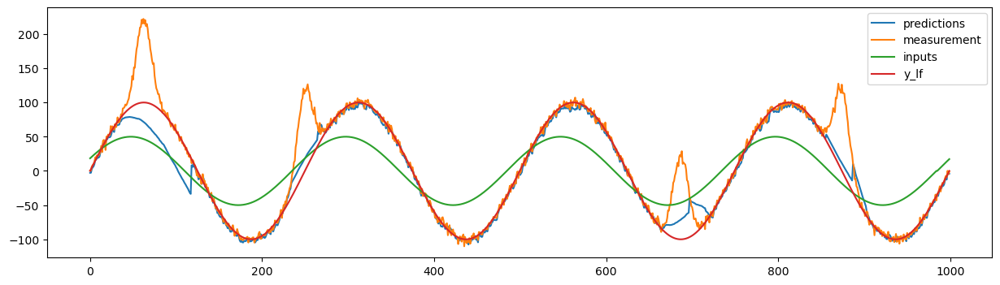

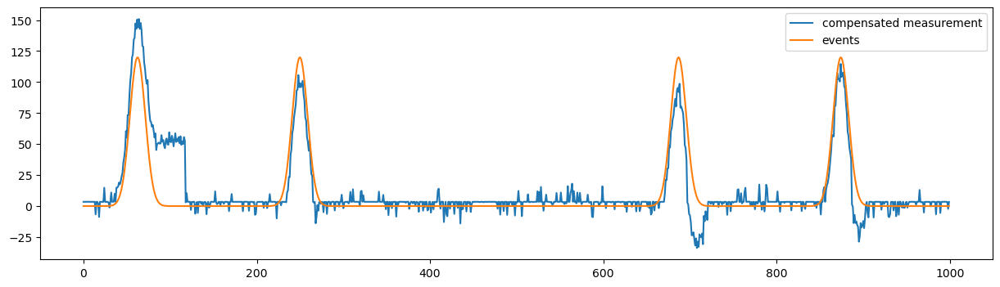

event_to_trend_amplitude: 0.6 , event_length_to_trend_period: 0.30000000000000004 , time_shift: 0.02
optimal parameters: {'r_measurement_noise': 0.19540392735483042, 'q_process_noise_0': 1.4448526327122961, 'loc': 0.25338884550840635}
mse: 202.49288689083448


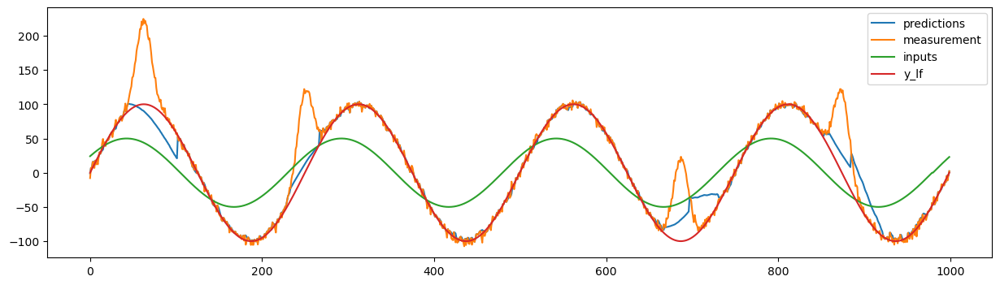

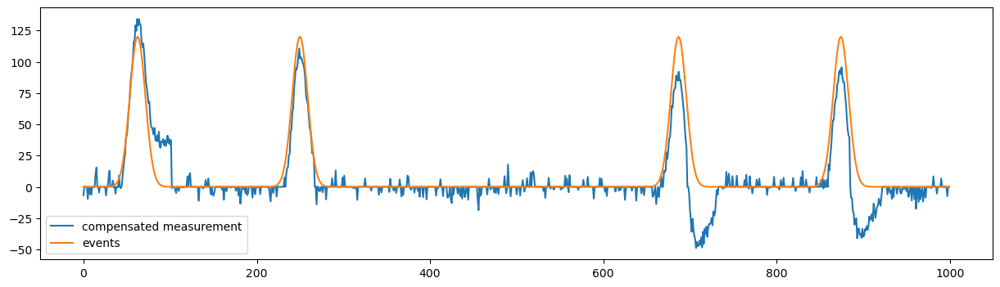

event_to_trend_amplitude: 0.6 , event_length_to_trend_period: 0.4 , time_shift: 0.005
optimal parameters: {'r_measurement_noise': 0.16410192982151195, 'q_process_noise_0': 0.9332835515012214, 'loc': 2.5453373442833005}
mse: 40.95574441477684


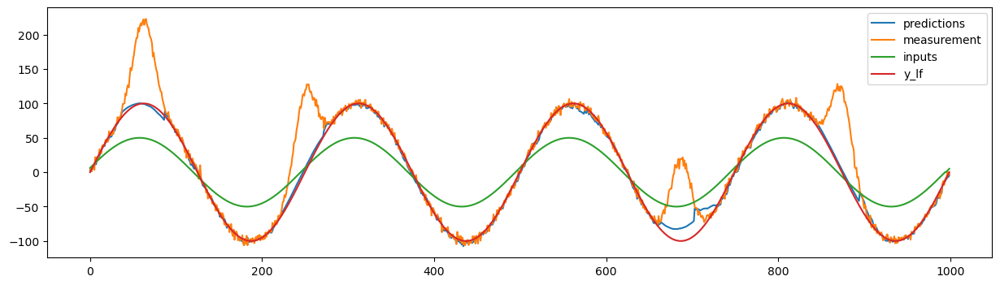

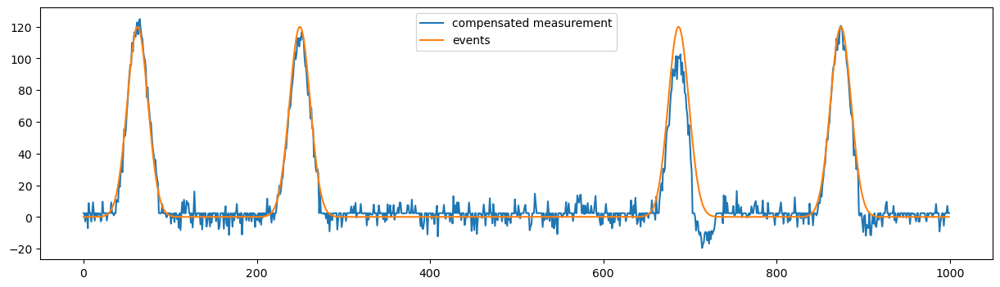

event_to_trend_amplitude: 0.6 , event_length_to_trend_period: 0.4 , time_shift: 0.01
optimal parameters: {'r_measurement_noise': 0.10582600639061684, 'q_process_noise_0': 1.2319714013915155, 'loc': 0.39811956876162957}
mse: 130.900206248713


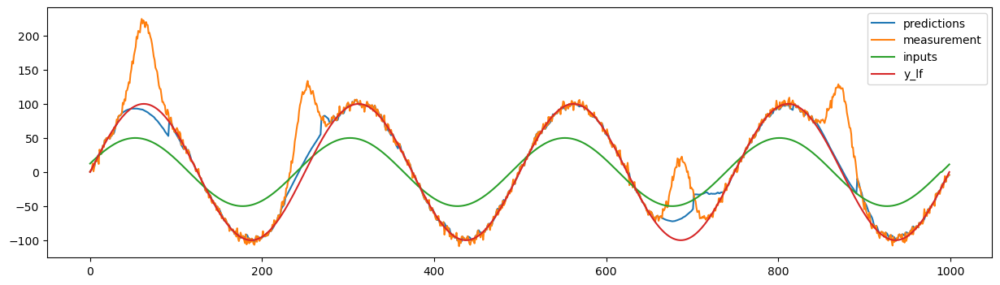

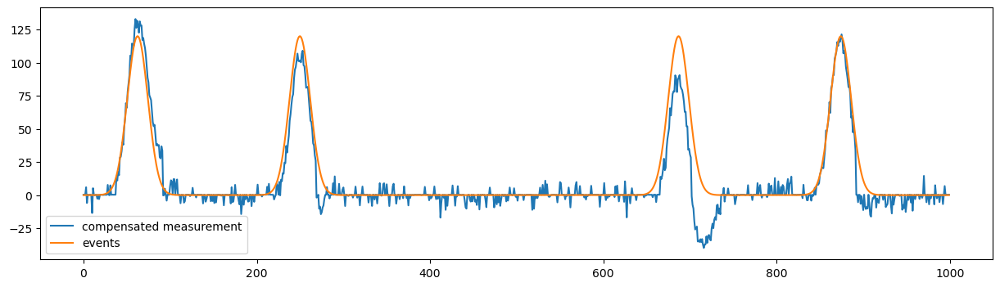

event_to_trend_amplitude: 0.6 , event_length_to_trend_period: 0.4 , time_shift: 0.015
optimal parameters: {'r_measurement_noise': 0.16555170124543964, 'q_process_noise_0': 1.569484323460892, 'loc': 8.463034887230885}
mse: 249.80754747046456


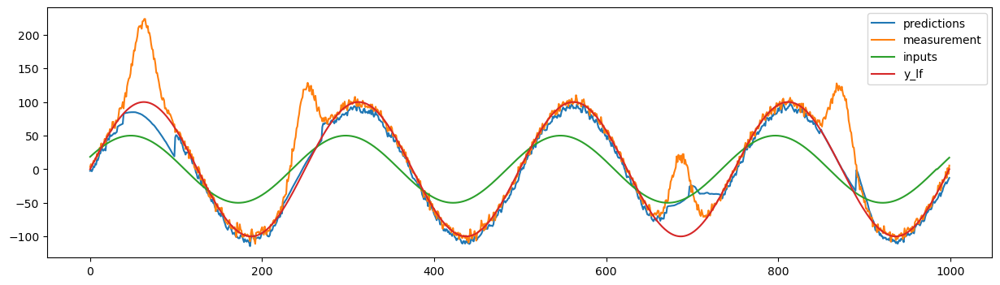

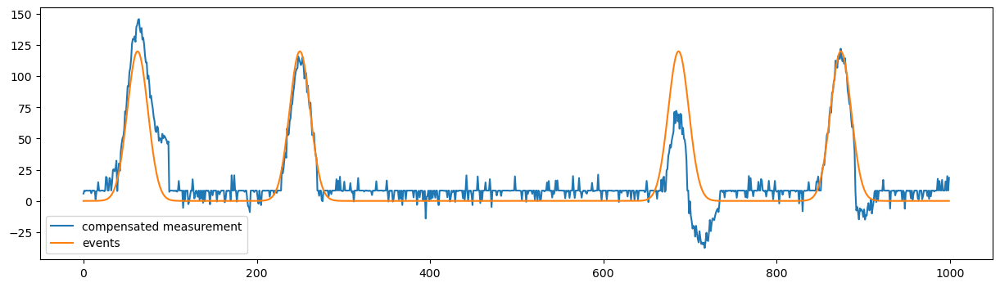

event_to_trend_amplitude: 0.6 , event_length_to_trend_period: 0.4 , time_shift: 0.02
optimal parameters: {'r_measurement_noise': 0.14662691300370528, 'q_process_noise_0': 1.7351509467070465, 'loc': 3.431325983645966}
mse: 338.6160477234095


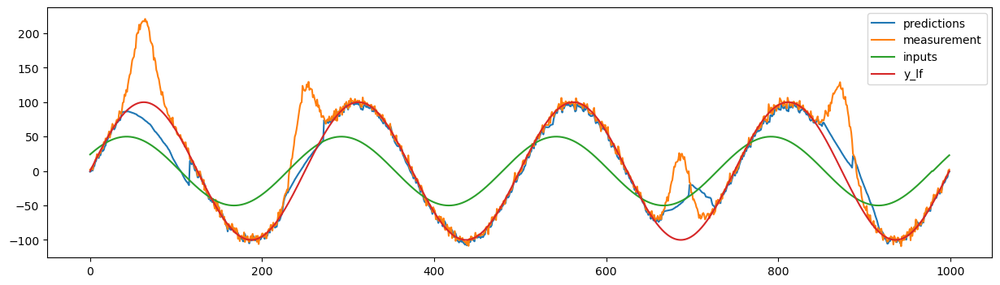

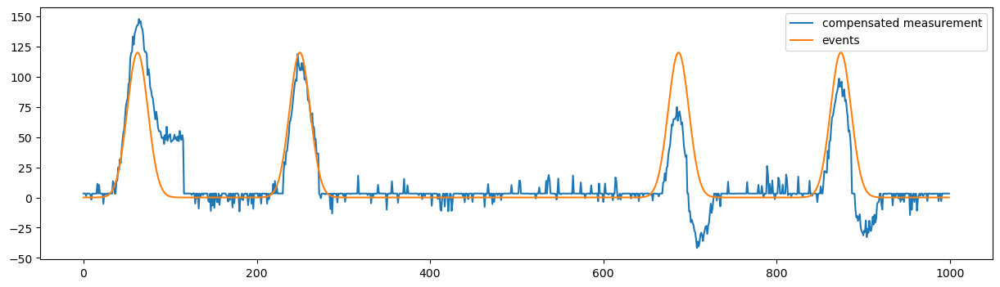

event_to_trend_amplitude: 0.6 , event_length_to_trend_period: 0.5 , time_shift: 0.005
optimal parameters: {'r_measurement_noise': 4.665721527294261, 'q_process_noise_0': 0.3853147008970546, 'loc': 7.8409597917053055}
mse: 83.20230779506814


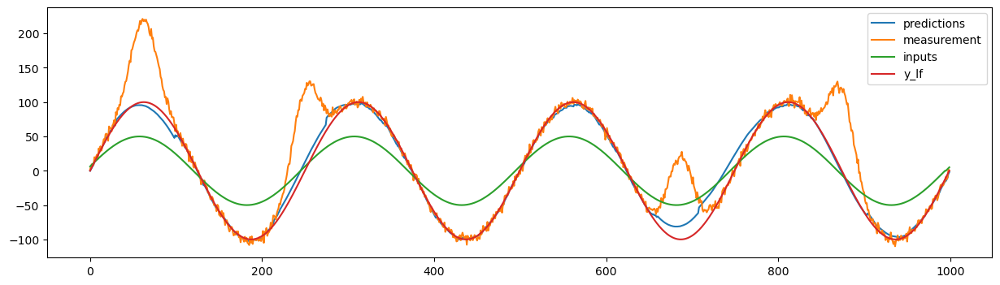

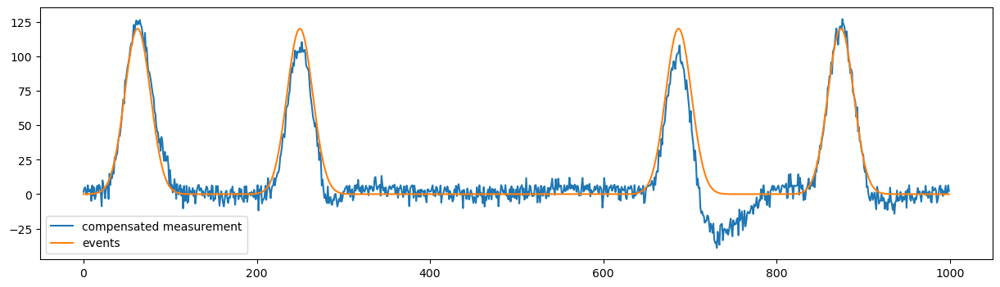

event_to_trend_amplitude: 0.6 , event_length_to_trend_period: 0.5 , time_shift: 0.01
optimal parameters: {'r_measurement_noise': 0.17256172954926796, 'q_process_noise_0': 0.9052800341893005, 'loc': 2.215467884850351}
mse: 203.7774159093406


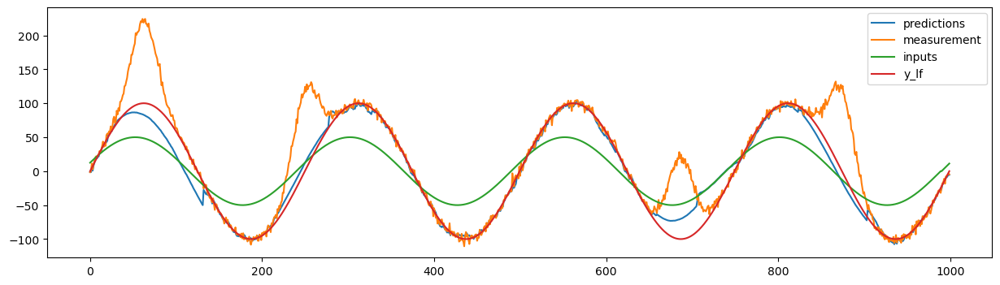

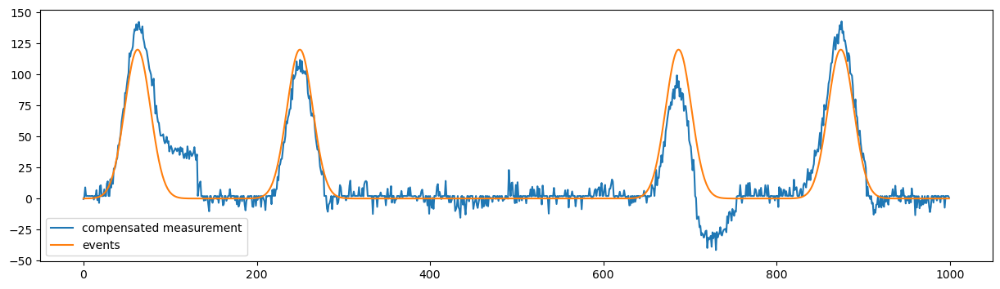

event_to_trend_amplitude: 0.6 , event_length_to_trend_period: 0.5 , time_shift: 0.015
optimal parameters: {'r_measurement_noise': 0.1495135302638419, 'q_process_noise_0': 1.2176971351022041, 'loc': 9.390066837162315}
mse: 737.3859291808808


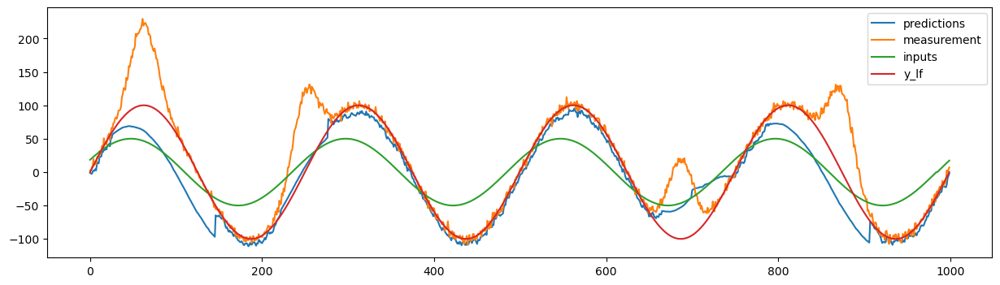

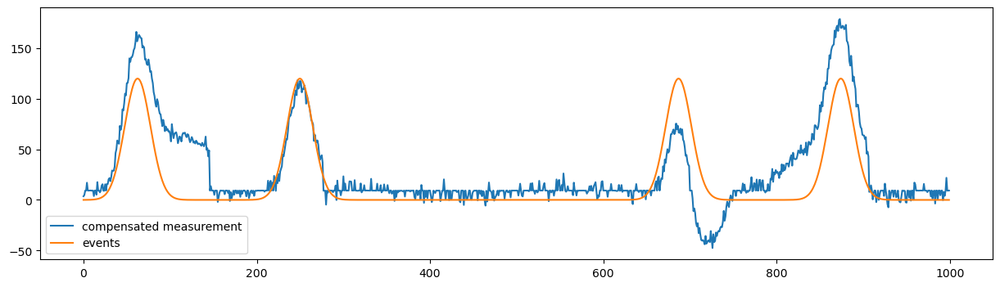

event_to_trend_amplitude: 0.6 , event_length_to_trend_period: 0.5 , time_shift: 0.02
optimal parameters: {'r_measurement_noise': 0.33791828047871053, 'q_process_noise_0': 1.9563375123657012, 'loc': 8.318599262259657}
mse: 598.767317609301


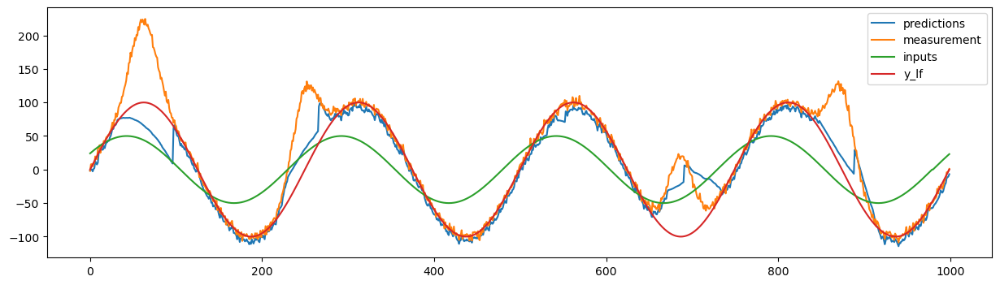

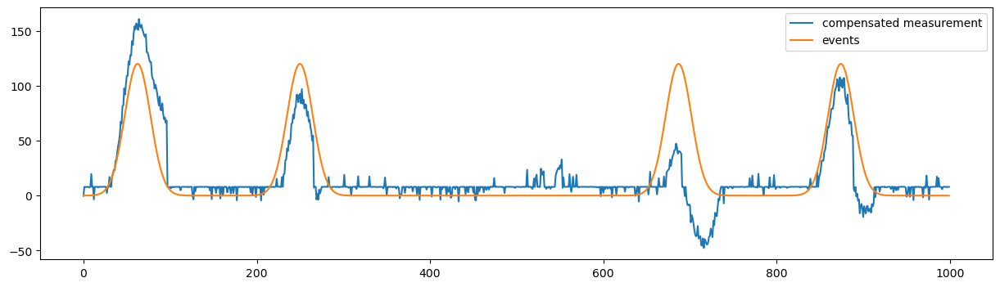

event_to_trend_amplitude: 0.6 , event_length_to_trend_period: 0.6 , time_shift: 0.005
optimal parameters: {'r_measurement_noise': 0.4177665348109878, 'q_process_noise_0': 0.5921015227987424, 'loc': 2.2796374285436394}
mse: 81.94642129277652


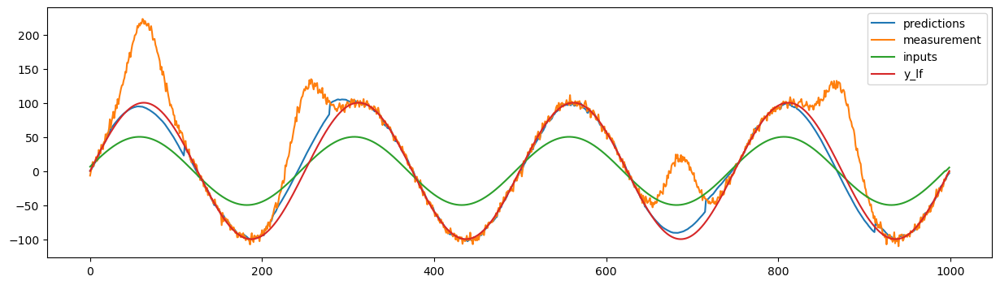

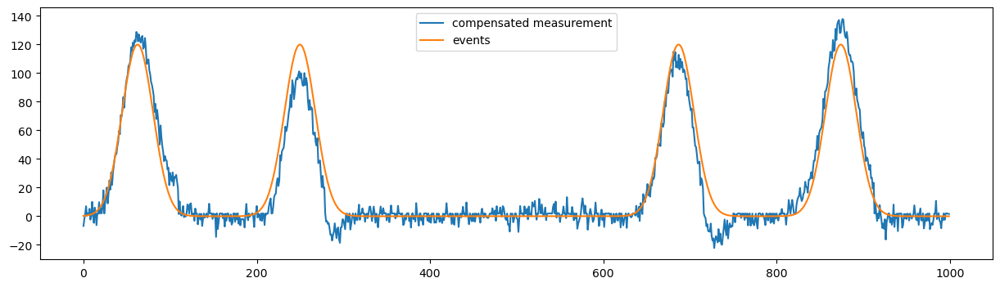

event_to_trend_amplitude: 0.6 , event_length_to_trend_period: 0.6 , time_shift: 0.01
optimal parameters: {'r_measurement_noise': 0.16693682499517526, 'q_process_noise_0': 1.1649183012001123, 'loc': 1.4304927589534253}
mse: 272.80368728267973


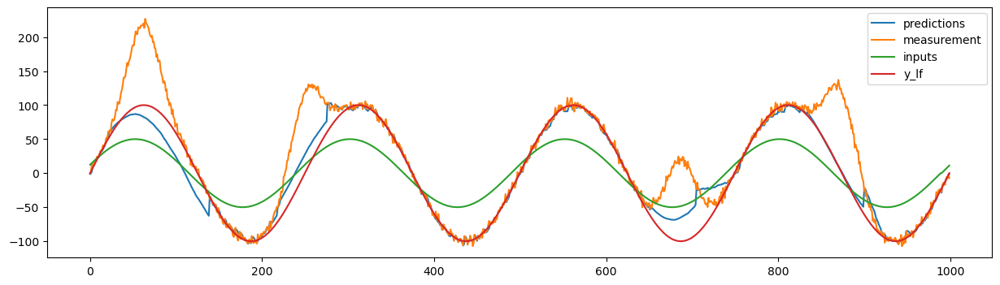

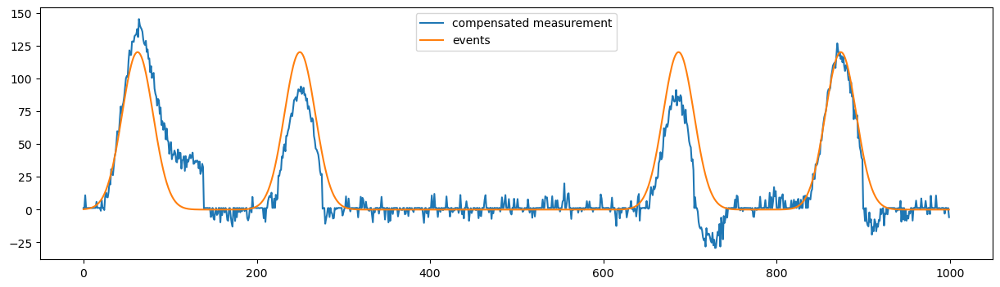

event_to_trend_amplitude: 0.6 , event_length_to_trend_period: 0.6 , time_shift: 0.015
optimal parameters: {'r_measurement_noise': 0.10116049432128052, 'q_process_noise_0': 1.092032341410601, 'loc': 0.30356369807179334}
mse: 541.4467018215415


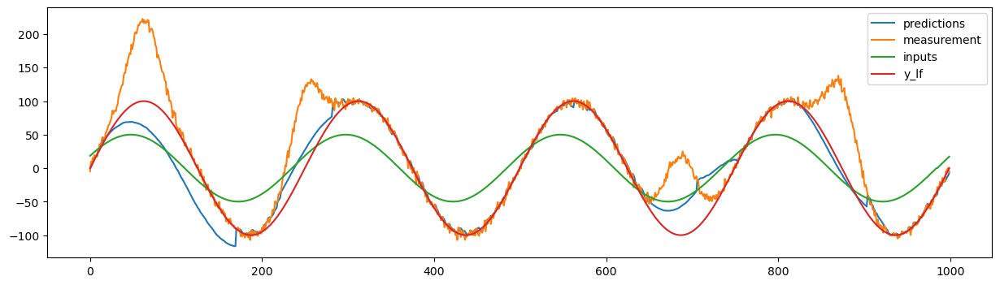

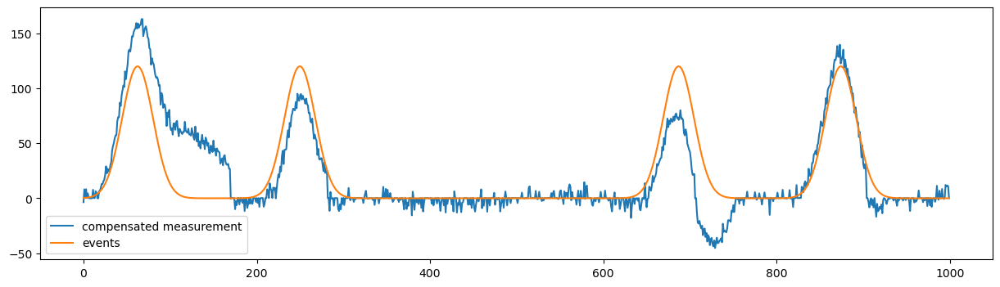

event_to_trend_amplitude: 0.6 , event_length_to_trend_period: 0.6 , time_shift: 0.02
optimal parameters: {'r_measurement_noise': 0.38284274294964843, 'q_process_noise_0': 1.634823615875177, 'loc': 4.246351899480616}
mse: 907.5856314719566


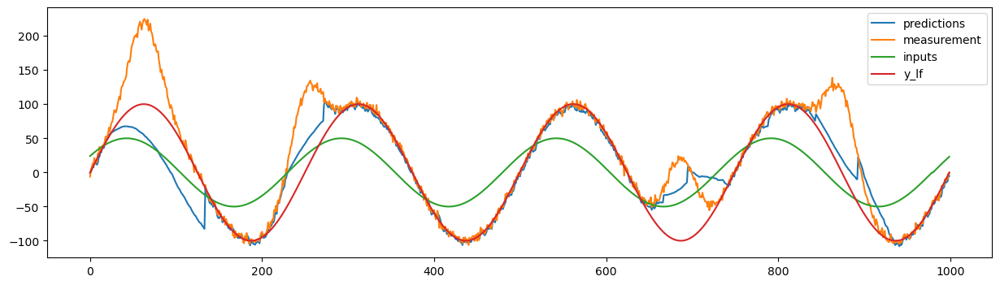

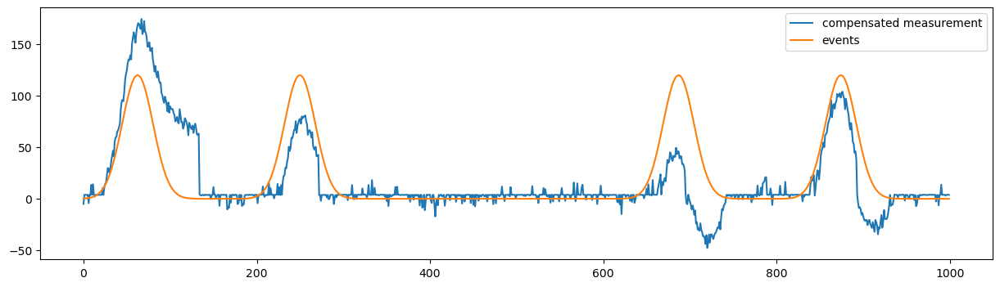

In [ ]:
for key in best_params.keys():
    print('event_to_trend_amplitude:', key[0], ', event_length_to_trend_period:', key[1], ', time_shift:', key[2])
    print('optimal parameters:', best_params[key])

    inputs = np.vstack([datasets[key]['input_'], np.insert(np.diff(datasets[key]['input_']),0,0)])
    measurement = datasets[key]['y_measurements']
    y_lf = datasets[key]['y_lf']
    
    pf_alpha = learn_alpha(inputs[0].reshape(-1, 1), measurement)
    # Suggest values for the hyperparameters
    num_particles = 1000 # best_params[key]['num_particles']
    r_measurement_noise = best_params[key]['r_measurement_noise']
    q_process_noise_0 = best_params[key]['q_process_noise_0']
    loc = best_params[key]['loc']
    
    pf = ParticleFilter(
        num_particles=num_particles,
        r_measurement_noise=r_measurement_noise,
        q_process_noise=np.array([q_process_noise_0, 1]),
        loc=-loc,
        alpha=pf_alpha
    )
    predictions = pf.filter(measurement, inputs, loading=loading)
    print('mse:', mean_squared_error(predictions, y_lf))
    plt.figure(figsize=(15, 4))
    plt.plot(predictions, label='predictions')
    plt.plot(measurement, label='measurement')
    plt.plot(inputs[0], label='inputs')
    plt.plot(y_lf, label='y_lf')
    plt.legend()
    plt.show()
    plt.close()
    plt.figure(figsize=(15, 4))
    plt.plot(measurement-predictions, label='compensated measurement')
    plt.plot(datasets[key]['y_events'], label='events')
    plt.legend()
    plt.show()
    plt.close()

In [ ]:
import pandas as pd
parameters = pd.DataFrame(index=[i for i in range(len(list(best_params.keys())))],
                          columns=['event_to_trend_amplitude', 'event_length_to_trend_period', 'time_shift', 'r_measurement_noise', 'q_process_noise_0', 'loc', 'mse'])
for i, key in enumerate(list(best_params.keys())):
    parameters['event_to_trend_amplitude'][i] = key[0]
    parameters['event_length_to_trend_period'][i] = key[1]
    parameters['time_shift'][i] = key[2]
    #parameters['num_particles'][i] = best_params[key]['num_particles']
    parameters['r_measurement_noise'][i] = best_params[key]['r_measurement_noise']
    parameters['q_process_noise_0'][i] = best_params[key]['q_process_noise_0']
    parameters['loc'][i] = best_params[key]['loc']
    parameters['mse'][i] = studies[key].best_trial.values[0]

In [ ]:
parameters

,event_to_trend_amplitude,event_length_to_trend_period,time_shift,r_measurement_noise,q_process_noise_0,loc,mse
0,0.1,0.1,0.005,0.522455,0.723059,1.407954,7.758659
1,0.1,0.1,0.01,1.063801,1.006305,2.560308,11.799496
2,0.1,0.1,0.015,0.761018,1.225207,0.481558,13.850824
3,0.1,0.1,0.02,0.236902,1.715383,0.132596,19.258526
4,0.1,0.2,0.005,0.404241,0.491811,2.669025,10.384706
...,...,...,...,...,...,...,...
139,0.6,0.5,0.02,0.337918,1.956338,8.318599,475.678377
140,0.6,0.6,0.005,0.417767,0.592102,2.279637,47.72232
141,0.6,0.6,0.01,0.166937,1.164918,1.430493,203.998039
142,0.6,0.6,0.015,0.10116,1.092032,0.303564,324.252481


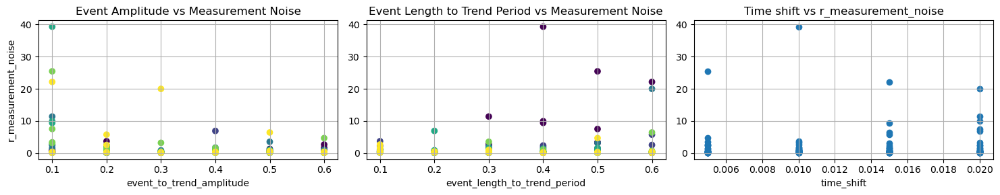

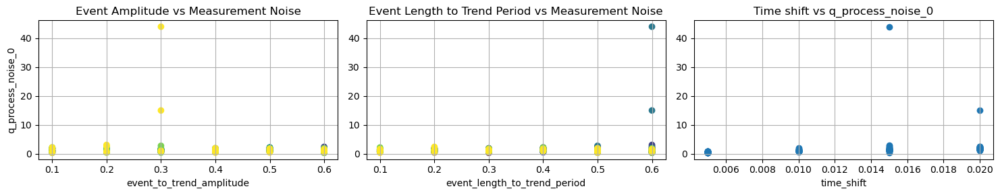

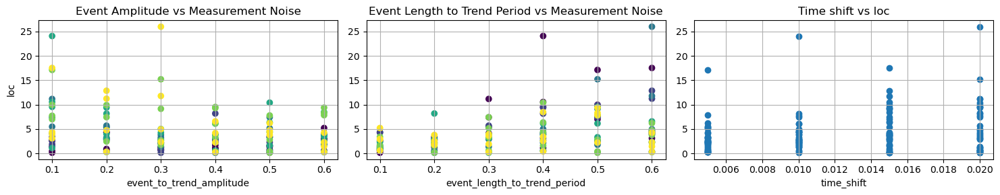

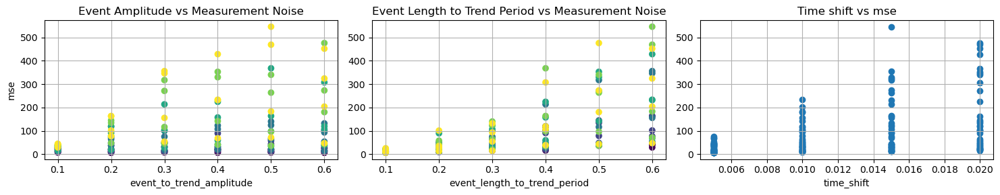

In [ ]:
# Create a figure and a set of subplots
y_param = 'r_measurement_noise'
fig, axs = plt.subplots(1, 3, figsize=(15, 3))  # 1 row, 2 columns, optional figure size
# First subplot
axs[0].scatter(parameters['event_to_trend_amplitude'], parameters[y_param], 
               marker='o', c=parameters['event_length_to_trend_period'])
axs[0].set_xlabel('event_to_trend_amplitude')
axs[0].set_ylabel(y_param)
axs[0].set_title('Event Amplitude vs Measurement Noise')
axs[0].grid()
# Second subplot
axs[1].scatter(parameters['event_length_to_trend_period'], parameters[y_param], 
               marker='o', c=parameters['event_to_trend_amplitude'])
axs[1].set_xlabel('event_length_to_trend_period')
axs[1].set_title('Event Length to Trend Period vs Measurement Noise')
axs[1].grid()
# Third subplot
axs[2].scatter(parameters['time_shift'], parameters[y_param], 
               marker='o')
axs[2].set_xlabel('time_shift')
axs[2].set_title('Time shift vs '+ y_param)
axs[2].grid()
# Display the figure
plt.tight_layout()  # Adjusts the subplots to fit into the figure area
plt.show()

# Create a figure and a set of subplots
y_param = 'q_process_noise_0'
fig, axs = plt.subplots(1, 3, figsize=(15, 3))  # 1 row, 2 columns, optional figure size
# First subplot
axs[0].scatter(parameters['event_to_trend_amplitude'], parameters[y_param], 
               marker='o', c=parameters['event_length_to_trend_period'])
axs[0].set_xlabel('event_to_trend_amplitude')
axs[0].set_ylabel(y_param)
axs[0].set_title('Event Amplitude vs Measurement Noise')
axs[0].grid()
# Second subplot
axs[1].scatter(parameters['event_length_to_trend_period'], parameters[y_param], 
               marker='o', c=parameters['event_to_trend_amplitude'])
axs[1].set_xlabel('event_length_to_trend_period')
axs[1].set_title('Event Length to Trend Period vs Measurement Noise')
axs[1].grid()
# Third subplot
axs[2].scatter(parameters['time_shift'], parameters[y_param], 
               marker='o')
axs[2].set_xlabel('time_shift')
axs[2].set_title('Time shift vs '+ y_param)
axs[2].grid()
# Display the figure
plt.tight_layout()  # Adjusts the subplots to fit into the figure area
plt.show()

# Create a figure and a set of subplots
y_param = 'loc'
fig, axs = plt.subplots(1, 3, figsize=(15, 3))  # 1 row, 2 columns, optional figure size
# First subplot
axs[0].scatter(parameters['event_to_trend_amplitude'], parameters[y_param], 
               marker='o', c=parameters['event_length_to_trend_period'])
axs[0].set_xlabel('event_to_trend_amplitude')
axs[0].set_ylabel(y_param)
axs[0].set_title('Event Amplitude vs Measurement Noise')
axs[0].grid()
# Second subplot
axs[1].scatter(parameters['event_length_to_trend_period'], parameters[y_param], 
               marker='o', c=parameters['event_to_trend_amplitude'])
axs[1].set_xlabel('event_length_to_trend_period')
axs[1].set_title('Event Length to Trend Period vs Measurement Noise')
axs[1].grid()
# Third subplot
axs[2].scatter(parameters['time_shift'], parameters[y_param], 
               marker='o')
axs[2].set_xlabel('time_shift')
axs[2].set_title('Time shift vs '+y_param)
axs[2].grid()
# Display the figure
plt.tight_layout()  # Adjusts the subplots to fit into the figure area
plt.show()

# Create a figure and a set of subplots
y_param = 'mse'
fig, axs = plt.subplots(1, 3, figsize=(15, 3))  # 1 row, 2 columns, optional figure size
# First subplot
axs[0].scatter(parameters['event_to_trend_amplitude'], parameters[y_param], 
               marker='o', c=parameters['event_length_to_trend_period'])
axs[0].set_xlabel('event_to_trend_amplitude')
axs[0].set_ylabel(y_param)
axs[0].set_title('Event Amplitude vs Measurement Noise')
axs[0].grid()
# Second subplot
axs[1].scatter(parameters['event_length_to_trend_period'], parameters[y_param], 
               marker='o', c=parameters['event_to_trend_amplitude'])
axs[1].set_xlabel('event_length_to_trend_period')
axs[1].set_title('Event Length to Trend Period vs Measurement Noise')
axs[1].grid()
# Third subplot
axs[2].scatter(parameters['time_shift'], parameters[y_param], 
               marker='o')
axs[2].set_xlabel('time_shift')
axs[2].set_title('Time shift vs '+ y_param)
axs[2].grid()
# Display the figure
plt.tight_layout()  # Adjusts the subplots to fit into the figure area
plt.show()

In [ ]:
from optuna.visualization import *
for key in studies.keys():
    print('event_to_trend_amplitude:', key[0], 'event_length_to_trend_period:', key[1])
    print('optimal parameters:', best_params[key])
    plot_slice(studies[key])
    plt.show()

,event_to_trend_amplitude,event_length_to_trend_period,r_measurement_noise,q_process_noise_0,loc
0,0.3,0.1,1.651107,0.862494,3.095094
1,0.3,0.3,1.243617,0.447421,5.218049
2,0.3,0.5,0.452229,0.595277,1.39311
3,0.4,0.1,1.969914,0.461497,4.124245
4,0.4,0.3,0.199891,0.942541,2.313925
5,0.4,0.5,0.295874,0.617152,1.473362
6,0.5,0.1,0.155953,0.694951,1.484701
7,0.5,0.3,0.130648,0.833474,0.10013
8,0.5,0.5,6.068431,0.323138,10.530466
